# TASK :Use the below data created to train and develop an algorithm to come up with a line that separates the data into discrete classes with minimal error

# Manually Implementing Sigmoid,Cross Entropy,Gradient Descent

In [1]:



import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

n_pts=100
np.random.seed(0)
random_x1=np.random.normal(10,2,n_pts)   #mean=10,SD=2
print(random_x1,end='\n') #for x1 coordinate(horizontal)



[13.52810469 10.80031442 11.95747597 14.4817864  13.73511598  8.04544424
 11.90017684  9.69728558  9.7935623  10.821197   10.28808714 12.90854701
 11.52207545 10.24335003 10.88772647 10.66734865 12.98815815  9.58968347
 10.6261354   8.29180852  4.89402037 11.30723719 11.7288724   8.51566996
 14.53950925  7.09126865 10.09151703  9.6256323  13.06555843 12.93871754
 10.30989485 10.75632504  8.2244285   6.03840706  9.3041757  10.31269794
 12.46058136 12.4047597   9.22534637  9.3953945   7.90289407  7.15996413
  6.58745962 13.90155079  8.98069564  9.1238514   7.49440928 11.55498071
  6.7722043   9.57451944  8.20906688 10.773805    8.97838972  7.63873563
  9.94363554 10.85666374 10.13303444 10.6049438   8.73135581  9.27451767
  8.6550791   9.28089368  8.37370744  6.5474348  10.35485228  9.19643813
  6.73960331 10.92556451  8.18540327 10.10389079 11.45818112 10.25796582
 12.27880137  7.53034836 10.80468328  8.63037982  8.2584057   8.84230067
  9.37689494 10.11233068  7.66970032 11.80165297 10

In [2]:
np.random.seed(0)
random_x2=np.random.normal(12,2,n_pts) #for x2 coordinate(verticaltal)
print(random_x2,end='\n')




[15.52810469 12.80031442 13.95747597 16.4817864  15.73511598 10.04544424
 13.90017684 11.69728558 11.7935623  12.821197   12.28808714 14.90854701
 13.52207545 12.24335003 12.88772647 12.66734865 14.98815815 11.58968347
 12.6261354  10.29180852  6.89402037 13.30723719 13.7288724  10.51566996
 16.53950925  9.09126865 12.09151703 11.6256323  15.06555843 14.93871754
 12.30989485 12.75632504 10.2244285   8.03840706 11.3041757  12.31269794
 14.46058136 14.4047597  11.22534637 11.3953945   9.90289407  9.15996413
  8.58745962 15.90155079 10.98069564 11.1238514   9.49440928 13.55498071
  8.7722043  11.57451944 10.20906688 12.773805   10.97838972  9.63873563
 11.94363554 12.85666374 12.13303444 12.6049438  10.73135581 11.27451767
 10.6550791  11.28089368 10.37370744  8.5474348  12.35485228 11.19643813
  8.73960331 12.92556451 10.18540327 12.10389079 13.45818112 12.25796582
 14.27880137  9.53034836 12.80468328 10.63037982 10.2584057  10.84230067
 11.37689494 12.11233068  9.66970032 13.80165297 12

In [3]:
np.random.seed(0)
top_region=np.array([random_x1, random_x2])
print(top_region)
print(top_region.shape)

# we need to do matrix multiplication.Horizontal coordinate and its corressponding verticalcoordinates are in different row.
#So ,we need horizontal and vertical coordinates for each element in same row .We need to take transpose.

[[13.52810469 10.80031442 11.95747597 14.4817864  13.73511598  8.04544424
  11.90017684  9.69728558  9.7935623  10.821197   10.28808714 12.90854701
  11.52207545 10.24335003 10.88772647 10.66734865 12.98815815  9.58968347
  10.6261354   8.29180852  4.89402037 11.30723719 11.7288724   8.51566996
  14.53950925  7.09126865 10.09151703  9.6256323  13.06555843 12.93871754
  10.30989485 10.75632504  8.2244285   6.03840706  9.3041757  10.31269794
  12.46058136 12.4047597   9.22534637  9.3953945   7.90289407  7.15996413
   6.58745962 13.90155079  8.98069564  9.1238514   7.49440928 11.55498071
   6.7722043   9.57451944  8.20906688 10.773805    8.97838972  7.63873563
   9.94363554 10.85666374 10.13303444 10.6049438   8.73135581  9.27451767
   8.6550791   9.28089368  8.37370744  6.5474348  10.35485228  9.19643813
   6.73960331 10.92556451  8.18540327 10.10389079 11.45818112 10.25796582
  12.27880137  7.53034836 10.80468328  8.63037982  8.2584057   8.84230067
   9.37689494 10.11233068  7.66970032 

In [4]:
np.random.seed(0)
random_x3=np.random.normal(5,2,n_pts)
print(random_x3,end='\n') #horizontal


[ 8.52810469  5.80031442  6.95747597  9.4817864   8.73511598  3.04544424
  6.90017684  4.69728558  4.7935623   5.821197    5.28808714  7.90854701
  6.52207545  5.24335003  5.88772647  5.66734865  7.98815815  4.58968347
  5.6261354   3.29180852 -0.10597963  6.30723719  6.7288724   3.51566996
  9.53950925  2.09126865  5.09151703  4.6256323   8.06555843  7.93871754
  5.30989485  5.75632504  3.2244285   1.03840706  4.3041757   5.31269794
  7.46058136  7.4047597   4.22534637  4.3953945   2.90289407  2.15996413
  1.58745962  8.90155079  3.98069564  4.1238514   2.49440928  6.55498071
  1.7722043   4.57451944  3.20906688  5.773805    3.97838972  2.63873563
  4.94363554  5.85666374  5.13303444  5.6049438   3.73135581  4.27451767
  3.6550791   4.28089368  3.37370744  1.5474348   5.35485228  4.19643813
  1.73960331  5.92556451  3.18540327  5.10389079  6.45818112  5.25796582
  7.27880137  2.53034836  5.80468328  3.63037982  3.2584057   3.84230067
  4.37689494  5.11233068  2.66970032  6.80165297  5

In [5]:
np.random.seed(0)
random_x4=np.random.normal(6,2,n_pts) #vertical
print(random_x4,end='\n')


[ 9.52810469  6.80031442  7.95747597 10.4817864   9.73511598  4.04544424
  7.90017684  5.69728558  5.7935623   6.821197    6.28808714  8.90854701
  7.52207545  6.24335003  6.88772647  6.66734865  8.98815815  5.58968347
  6.6261354   4.29180852  0.89402037  7.30723719  7.7288724   4.51566996
 10.53950925  3.09126865  6.09151703  5.6256323   9.06555843  8.93871754
  6.30989485  6.75632504  4.2244285   2.03840706  5.3041757   6.31269794
  8.46058136  8.4047597   5.22534637  5.3953945   3.90289407  3.15996413
  2.58745962  9.90155079  4.98069564  5.1238514   3.49440928  7.55498071
  2.7722043   5.57451944  4.20906688  6.773805    4.97838972  3.63873563
  5.94363554  6.85666374  6.13303444  6.6049438   4.73135581  5.27451767
  4.6550791   5.28089368  4.37370744  2.5474348   6.35485228  5.19643813
  2.73960331  6.92556451  4.18540327  6.10389079  7.45818112  6.25796582
  8.27880137  3.53034836  6.80468328  4.63037982  4.2584057   4.84230067
  5.37689494  6.11233068  3.66970032  7.80165297  6

In [6]:
np.random.seed(0)
bottom_region= np.array([random_x3, random_x4])
print(bottom_region)
print(bottom_region.shape)

[[ 8.52810469  5.80031442  6.95747597  9.4817864   8.73511598  3.04544424
   6.90017684  4.69728558  4.7935623   5.821197    5.28808714  7.90854701
   6.52207545  5.24335003  5.88772647  5.66734865  7.98815815  4.58968347
   5.6261354   3.29180852 -0.10597963  6.30723719  6.7288724   3.51566996
   9.53950925  2.09126865  5.09151703  4.6256323   8.06555843  7.93871754
   5.30989485  5.75632504  3.2244285   1.03840706  4.3041757   5.31269794
   7.46058136  7.4047597   4.22534637  4.3953945   2.90289407  2.15996413
   1.58745962  8.90155079  3.98069564  4.1238514   2.49440928  6.55498071
   1.7722043   4.57451944  3.20906688  5.773805    3.97838972  2.63873563
   4.94363554  5.85666374  5.13303444  5.6049438   3.73135581  4.27451767
   3.6550791   4.28089368  3.37370744  1.5474348   5.35485228  4.19643813
   1.73960331  5.92556451  3.18540327  5.10389079  6.45818112  5.25796582
   7.27880137  2.53034836  5.80468328  3.63037982  3.2584057   3.84230067
   4.37689494  5.11233068  2.66970032 

In [7]:
#we need horizontal and vertical coordinate in same row. So we are taking trasnpose

np.random.seed(0)
top_region=np.array([random_x1, random_x2]).T
print(top_region)
print()
bottom_region= np.array([random_x3, random_x4]).T
print(bottom_region)
print()

[[13.52810469 15.52810469]
 [10.80031442 12.80031442]
 [11.95747597 13.95747597]
 [14.4817864  16.4817864 ]
 [13.73511598 15.73511598]
 [ 8.04544424 10.04544424]
 [11.90017684 13.90017684]
 [ 9.69728558 11.69728558]
 [ 9.7935623  11.7935623 ]
 [10.821197   12.821197  ]
 [10.28808714 12.28808714]
 [12.90854701 14.90854701]
 [11.52207545 13.52207545]
 [10.24335003 12.24335003]
 [10.88772647 12.88772647]
 [10.66734865 12.66734865]
 [12.98815815 14.98815815]
 [ 9.58968347 11.58968347]
 [10.6261354  12.6261354 ]
 [ 8.29180852 10.29180852]
 [ 4.89402037  6.89402037]
 [11.30723719 13.30723719]
 [11.7288724  13.7288724 ]
 [ 8.51566996 10.51566996]
 [14.53950925 16.53950925]
 [ 7.09126865  9.09126865]
 [10.09151703 12.09151703]
 [ 9.6256323  11.6256323 ]
 [13.06555843 15.06555843]
 [12.93871754 14.93871754]
 [10.30989485 12.30989485]
 [10.75632504 12.75632504]
 [ 8.2244285  10.2244285 ]
 [ 6.03840706  8.03840706]
 [ 9.3041757  11.3041757 ]
 [10.31269794 12.31269794]
 [12.46058136 14.46058136]
 

In [8]:
top_region.shape


(100, 2)

In [9]:
bottom_region.shape

(100, 2)

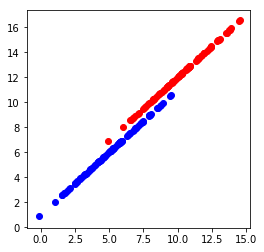

In [10]:
_, ax= plt.subplots(figsize=(4,4)) #4 inches wide ,4 inches height .We are not using fig variable. Sowe left it as _
ax.scatter(top_region[:,0], top_region[:,1], color='r') 
#top_region[:,0]=accessing all horizontalcoordinates which are in 1st row
#top_region[:,1]=accessing all horizontalcoordinates which are in 2nd row

ax.scatter(bottom_region[:,0], bottom_region[:,1], color='b')
#bottom_region[:,0]=accessing all horizontalcoordinates which are in 1st row
#bottom_region[:,1]=accessing all horizontalcoordinates which are in 2nd row
plt.show()

# How to calculate the error

# Sigmoid Implementation

In [11]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
 
 
def draw(x1,x2):
  ln=plt.plot(x1,x2)
 
def sigmoid(score): # toconvert ourlinear values intoprobability
  return 1/(1+np.exp(-score))
  
n_pts=100
np.random.seed(0)
bias= np.ones(n_pts) #sigmoid(w1x1+w2x2+b*bias)
top_region=np.array([np.random.normal(10,2,n_pts), np.random.normal(12,2,n_pts), bias]).T #Adding a bias value for each point
bottom_region= np.array([np.random.normal(5,2, n_pts), np.random.normal(6,2, n_pts), bias]).T #Adding a bias value for each point
all_points=np.vstack((top_region, bottom_region))
print('shape of all_points: ',all_points.shape)

#w1,w2 are random weights and b is random bias
w1=-0.2
w2=-0.35
b=3.5

line_paramters = np.matrix([w1,w2,b]).T  # we are taking atranspose to have no of columns of 1st matrix=no of rows of second matrix to perform multiplication 
print('shape of line_paramters: ',line_paramters.shape)

x1=np.array([bottom_region[:,0].min(), top_region[:,0].max()])  #horizontally we will go from farthest point on left to farthest point on right
#w1x1+w2x2+b=0
x2= -b/w2 + (x1*(-w1/w2))
print('value of x1 is {} and value of x2 is {}'.format(x1,x2))
#for horizontal coordinate -0.54518551 ,corresponding vertical coordinate is 10.31153458  
#for horizontal coordinate 14.53950925 ,corresponding vertical coordinate is 1.691709  


linear_combination= all_points*line_paramters  # we are doing w1x1+w2x2.....

probabilities= sigmoid(linear_combination) # calling sigmoid activatin function
print(probabilities)   


shape of all_points:  (200, 3)
shape of line_paramters:  (3, 1)
value of x1 is [-0.54518551 14.53950925] and value of x2 is [10.31153458  1.691709  ]
[[0.00880295]
 [0.12823766]
 [0.09955707]
 [0.01372204]
 [0.067494  ]
 [0.02485266]
 [0.05783959]
 [0.10752849]
 [0.01790212]
 [0.01982865]
 [0.01687491]
 [0.01953267]
 [0.08305404]
 [0.01653317]
 [0.06356942]
 [0.03244615]
 [0.01869352]
 [0.07519977]
 [0.03714468]
 [0.04724971]
 [0.12539518]
 [0.10048323]
 [0.03716405]
 [0.03450275]
 [0.0422208 ]
 [0.11779179]
 [0.08213426]
 [0.01946251]
 [0.02223247]
 [0.0273059 ]
 [0.09770069]
 [0.03809842]
 [0.13321197]
 [0.1267547 ]
 [0.10757609]
 [0.03783167]
 [0.02670777]
 [0.04586325]
 [0.05613233]
 [0.14016312]
 [0.22501118]
 [0.08020485]
 [0.1058204 ]
 [0.01936312]
 [0.01530217]
 [0.03969957]
 [0.17366009]
 [0.02203358]
 [0.24355157]
 [0.09180481]
 [0.09161742]
 [0.01705515]
 [0.12192247]
 [0.16121167]
 [0.06787429]
 [0.0826482 ]
 [0.02888137]
 [0.1125418 ]
 [0.16205141]
 [0.09548502]
 [0.110819

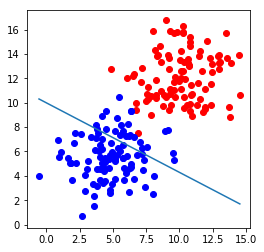

In [12]:

_, ax= plt.subplots(figsize=(4,4))
ax.scatter(top_region[:,0], top_region[:,1], color='r')
ax.scatter(bottom_region[:,0], bottom_region[:,1], color='b')
draw(x1,x2) #calling the draw function
plt.show()

# How did computer determine which model  is best to classify our data?


# Cross Entropy-To find best classification 

How does the computer determine which liner model classify our data better 

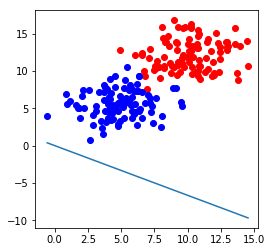

error value is [[0.81775297]]


In [13]:
#entire code including cross entropy
#calculating totl error using cross entropy

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
 
 
def draw(x1,x2):
  ln=plt.plot(x1,x2)
 
def sigmoid(score):
  return 1/(1+np.exp(-score))
 
#when points are corretly classified , then we have small error penalty
#when points are misclassified ,we have big error penalty
#this is calculated by cross entropy

def calculate_error(line_parameters, points , y):
  n=points.shape[0]
  p= sigmoid(points*line_parameters)
  cross_entropy=-(1/n)*(np.log(p).T*y + np.log(1-p).T*(1-y))
  return cross_entropy
  
n_pts=100
np.random.seed(0)
bias= np.ones(n_pts)
top_region=np.array([np.random.normal(10,2,n_pts), np.random.normal(12,2,n_pts), bias]).T
bottom_region= np.array([np.random.normal(5,2, n_pts), np.random.normal(6,2, n_pts), bias]).T
all_points=np.vstack((top_region, bottom_region))
w1=-0.1
w2=-0.15
b=0 # random weight and bias values
line_parameters = np.matrix([w1,w2,b]).T
x1=np.array([bottom_region[:,0].min(), top_region[:,0].max()])
x2= -b/w2 + (x1*(-w1/w2))
y=np.array([np.zeros(n_pts), np.ones(n_pts)]).reshape(n_pts*2, 1)#y is label.here it is 0 or 1.Top 10 rows have label 0. Below 10 rows have label 1.
 
_, ax= plt.subplots(figsize=(4,4))
ax.scatter(top_region[:,0], top_region[:,1], color='r')
ax.scatter(bottom_region[:,0], bottom_region[:,1], color='b')
draw(x1,x2)
plt.show()
 
print("error value is",(calculate_error(line_parameters, all_points, y))) #y is label.here it is 0 or 1

# Gradient Descent to minimise error and find the better model

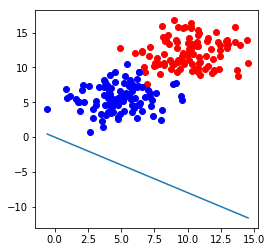

error value is [[0.70217988]]


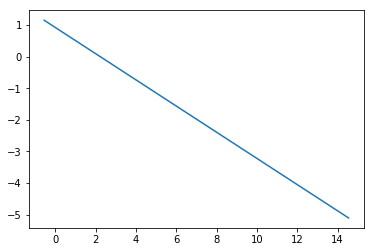

error value is [[0.65793319]]


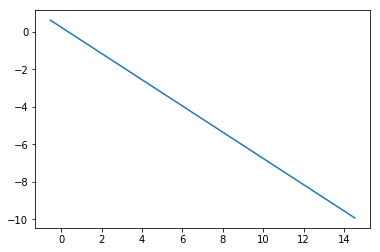

error value is [[0.66053464]]


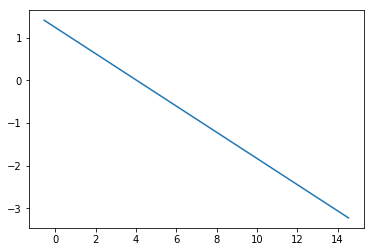

error value is [[0.64635232]]


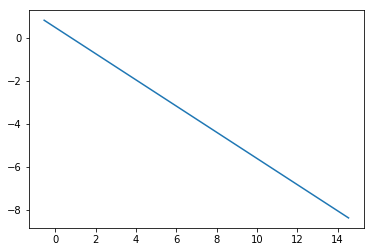

error value is [[0.6471553]]


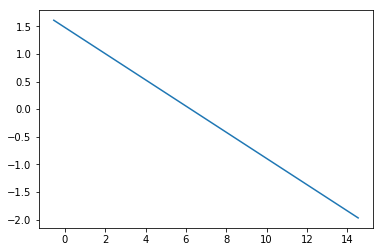

error value is [[0.63883102]]


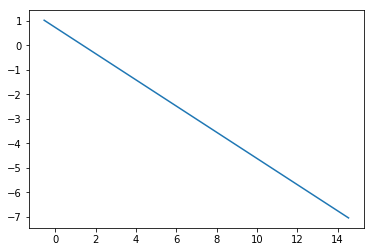

error value is [[0.6387613]]


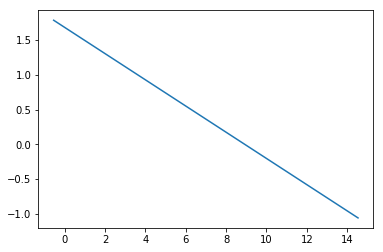

error value is [[0.63297426]]


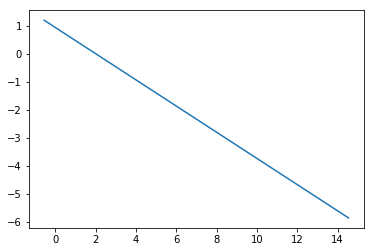

error value is [[0.632404]]


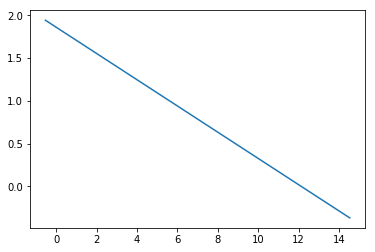

error value is [[0.62800492]]


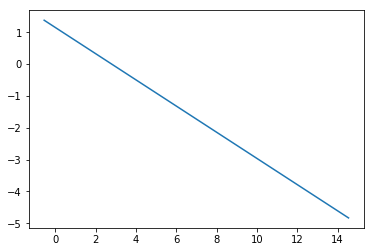

error value is [[0.62712321]]


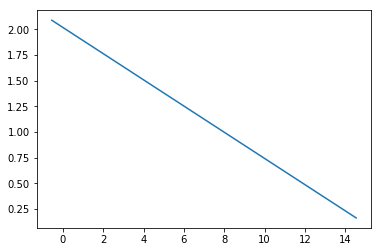

error value is [[0.62358427]]


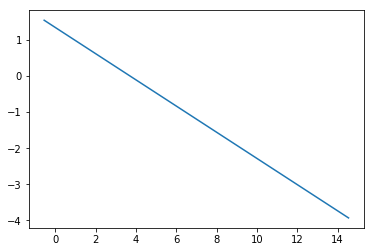

error value is [[0.62250097]]


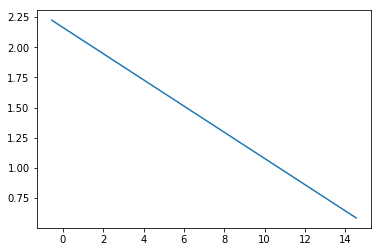

error value is [[0.61953818]]


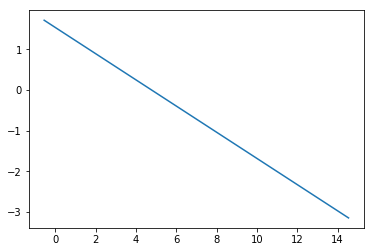

error value is [[0.61832296]]


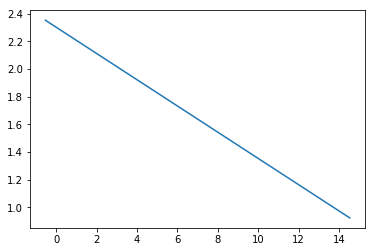

error value is [[0.61576673]]


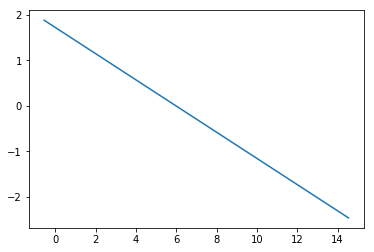

error value is [[0.6144664]]


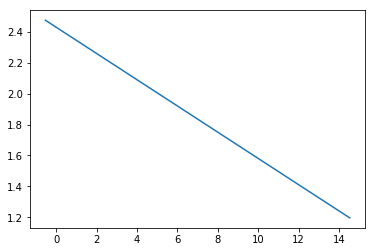

error value is [[0.61220769]]


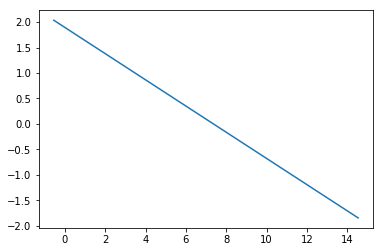

error value is [[0.6108549]]


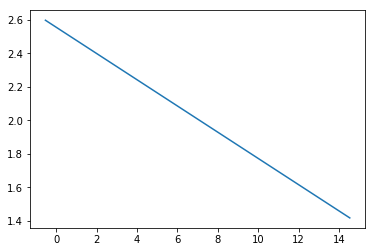

error value is [[0.60881964]]


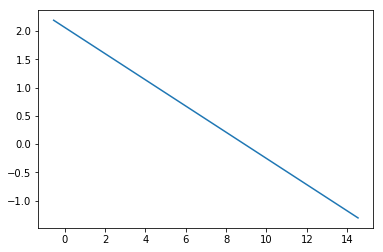

error value is [[0.60743761]]


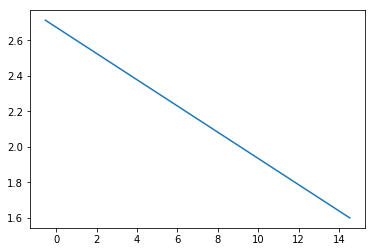

error value is [[0.60557341]]


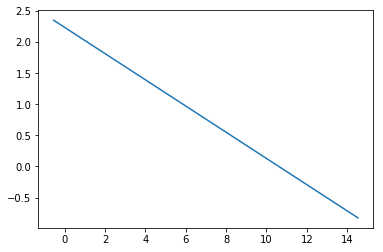

error value is [[0.60417872]]


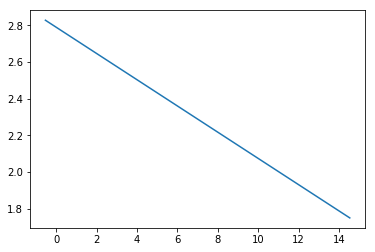

error value is [[0.60244733]]


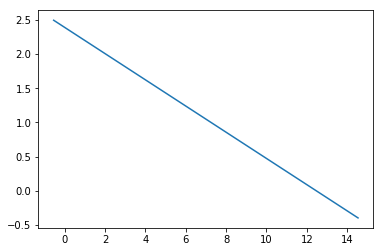

error value is [[0.60105173]]


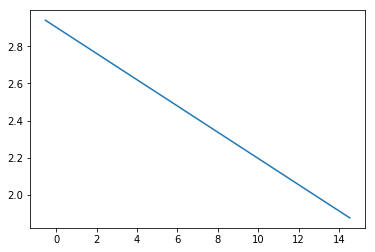

error value is [[0.5994246]]


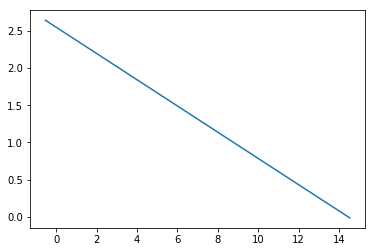

error value is [[0.59803619]]


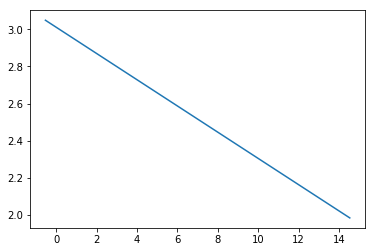

error value is [[0.59649166]]


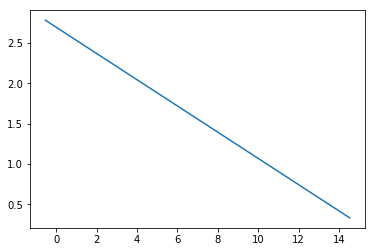

error value is [[0.59511578]]


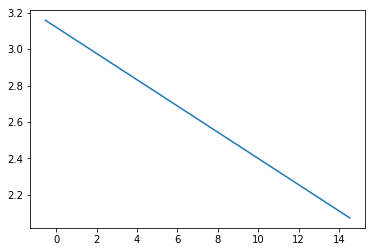

error value is [[0.59363719]]


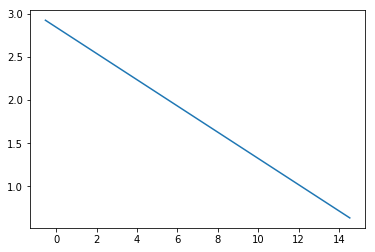

error value is [[0.5922771]]


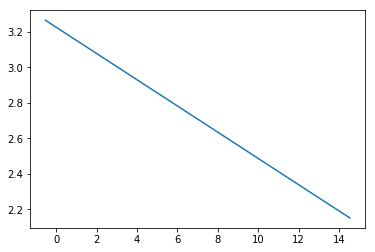

error value is [[0.59085157]]


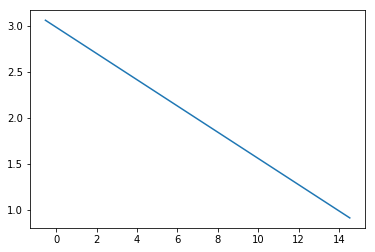

error value is [[0.58950899]]


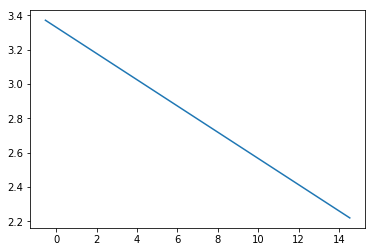

error value is [[0.58812649]]


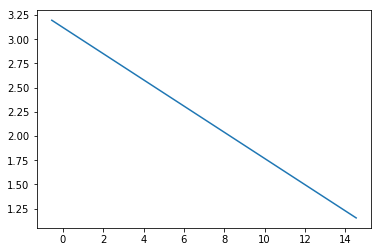

error value is [[0.58680201]]


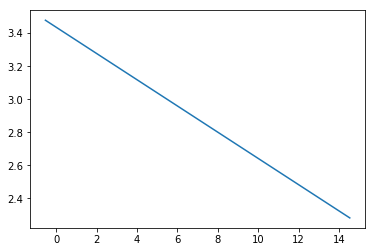

error value is [[0.58545473]]


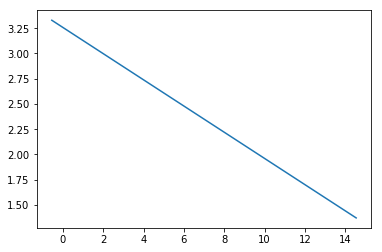

error value is [[0.58414817]]


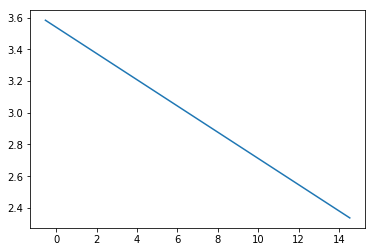

error value is [[0.58283002]]


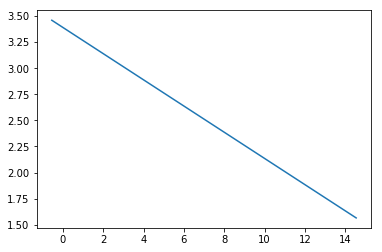

error value is [[0.58154072]]


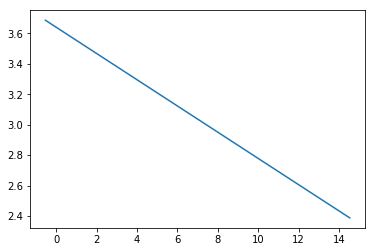

error value is [[0.58024696]]


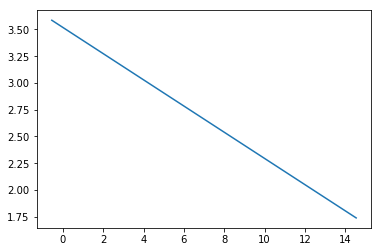

error value is [[0.57897398]]


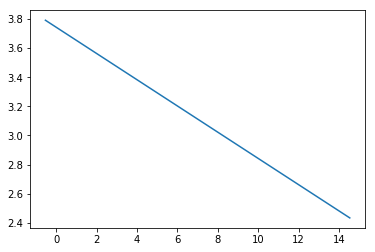

error value is [[0.57770092]]


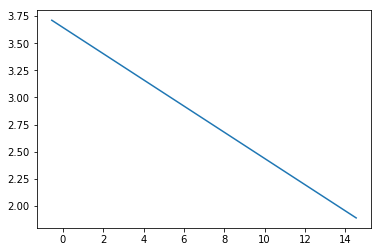

error value is [[0.57644321]]


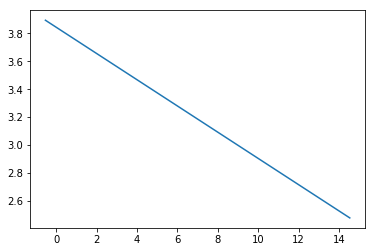

error value is [[0.57518799]]


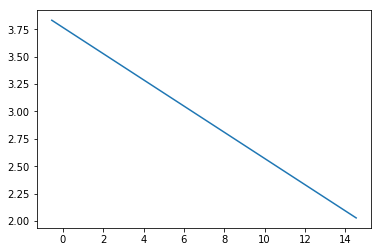

error value is [[0.57394449]]


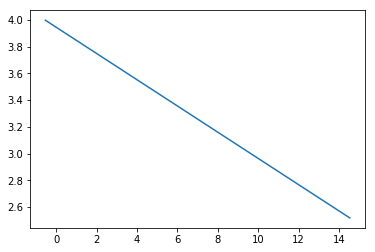

error value is [[0.5727049]]


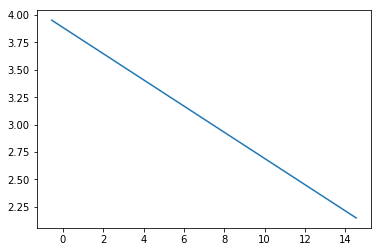

error value is [[0.57147462]]


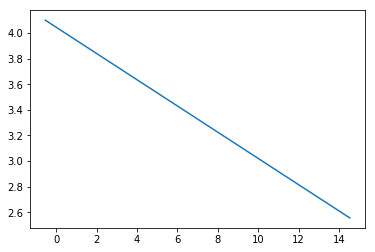

error value is [[0.57024898]]


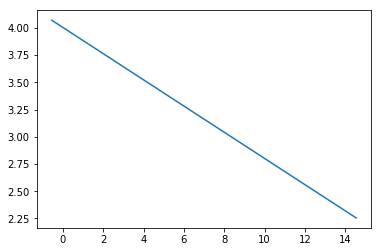

error value is [[0.56903104]]


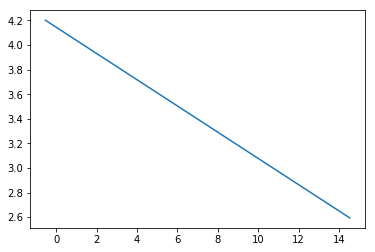

error value is [[0.56781804]]


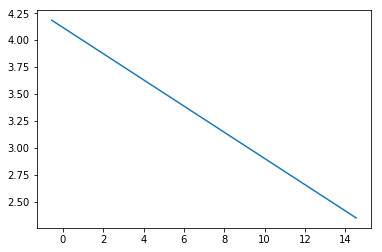

error value is [[0.56661167]]


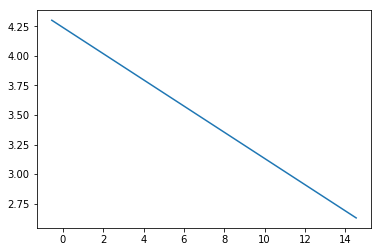

error value is [[0.56541033]]


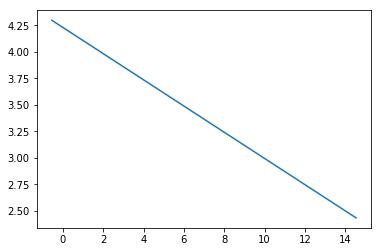

error value is [[0.5642149]]


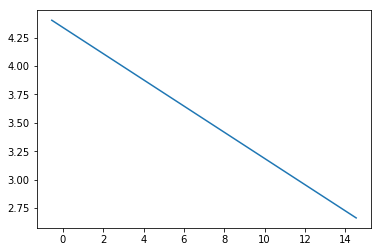

error value is [[0.56302446]]


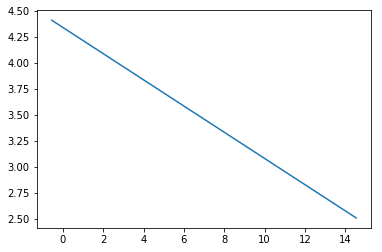

error value is [[0.56183945]]


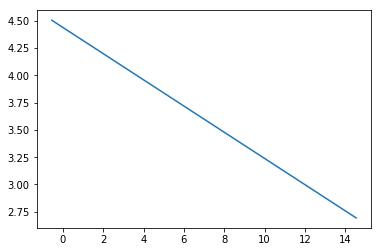

error value is [[0.56065933]]


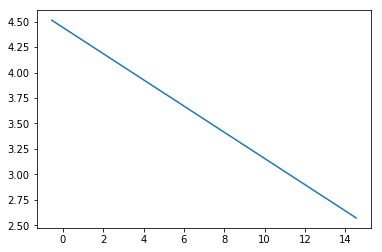

error value is [[0.55948432]]


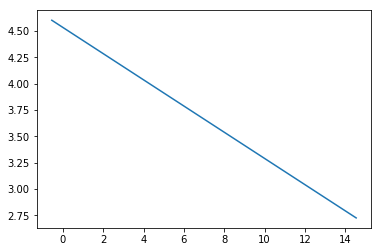

error value is [[0.55831409]]


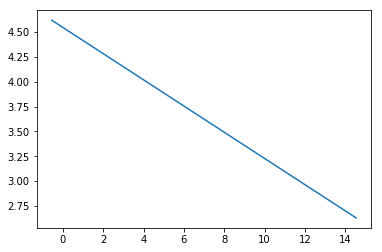

error value is [[0.55714873]]


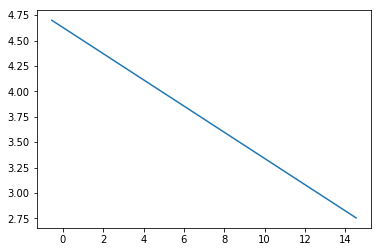

error value is [[0.55598806]]


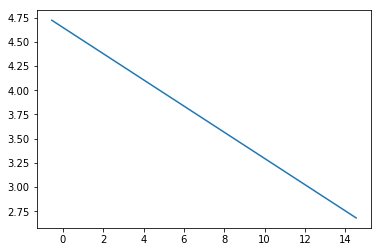

error value is [[0.55483209]]


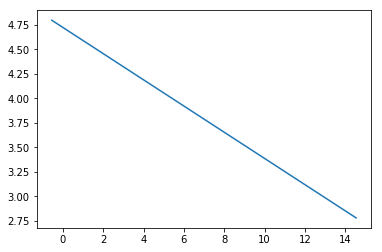

error value is [[0.55368071]]


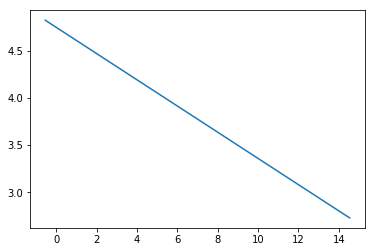

error value is [[0.55253392]]


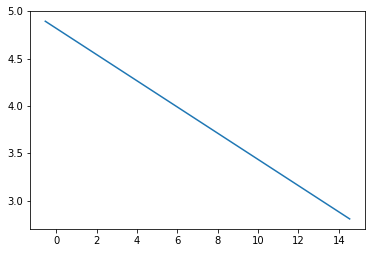

error value is [[0.55139163]]


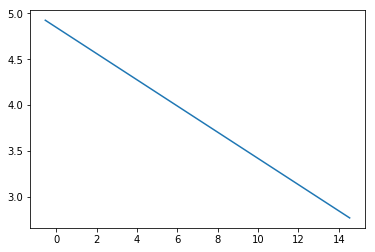

error value is [[0.55025382]]


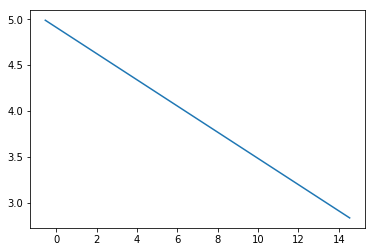

error value is [[0.54912045]]


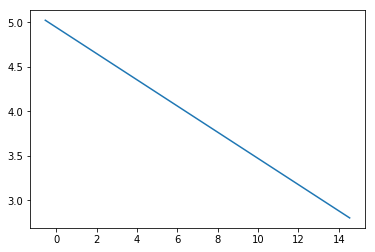

error value is [[0.54799149]]


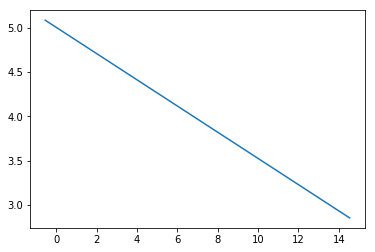

error value is [[0.54686691]]


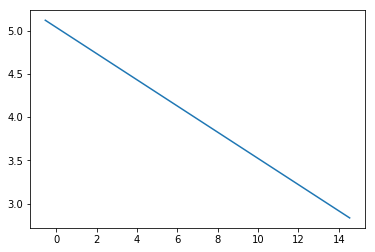

error value is [[0.54574668]]


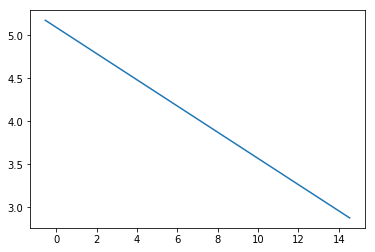

error value is [[0.54463076]]


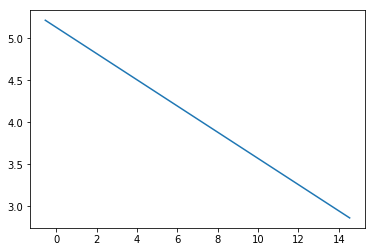

error value is [[0.54351914]]


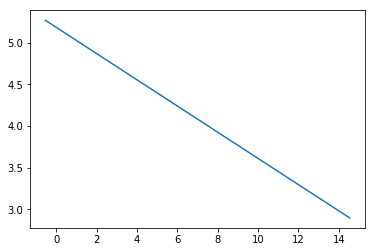

error value is [[0.54241179]]


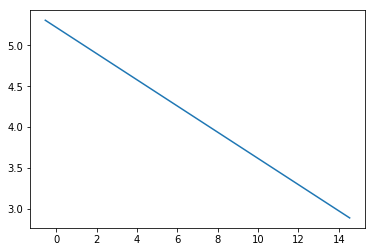

error value is [[0.54130868]]


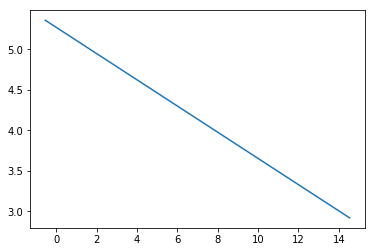

error value is [[0.5402098]]


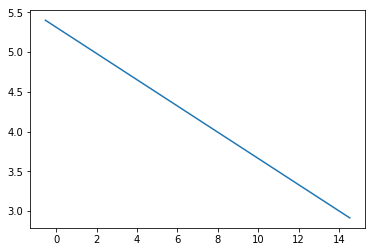

error value is [[0.53911512]]


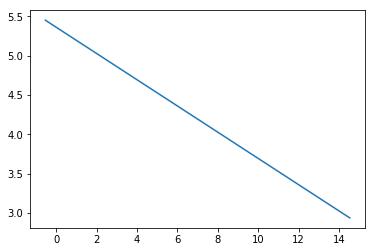

error value is [[0.53802462]]


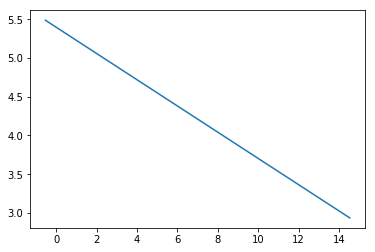

error value is [[0.53693829]]


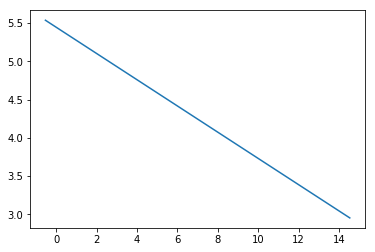

error value is [[0.5358561]]


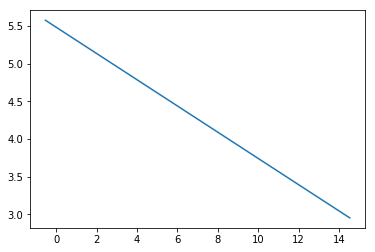

error value is [[0.53477803]]


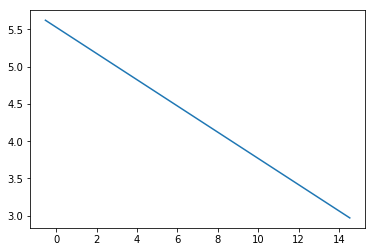

error value is [[0.53370406]]


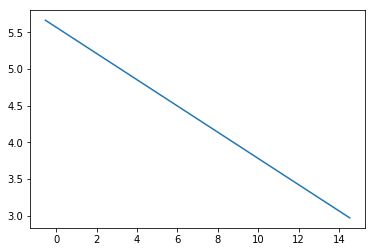

error value is [[0.53263417]]


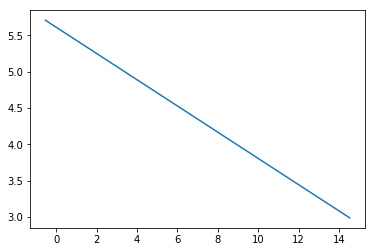

error value is [[0.53156835]]


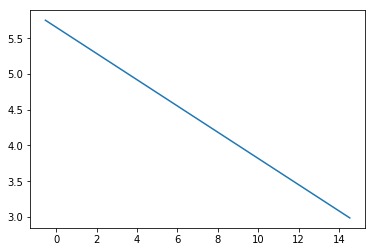

error value is [[0.53050658]]


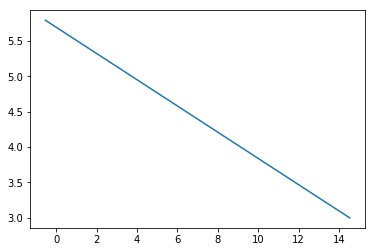

error value is [[0.52944884]]


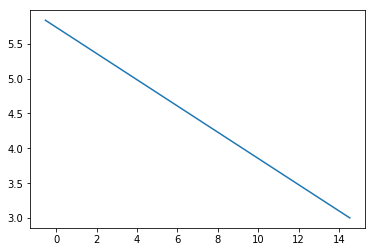

error value is [[0.52839511]]


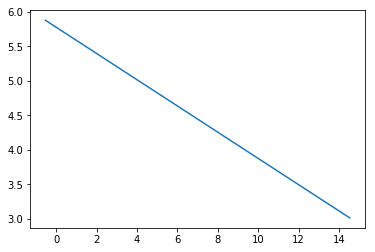

error value is [[0.52734537]]


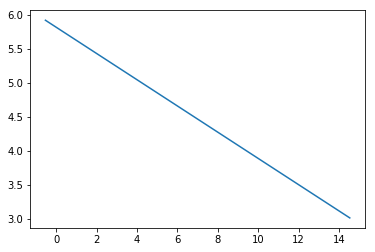

error value is [[0.52629961]]


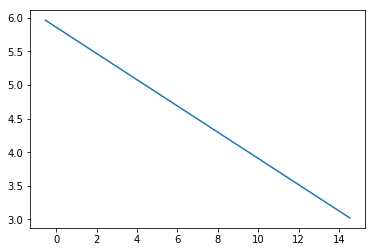

error value is [[0.5252578]]


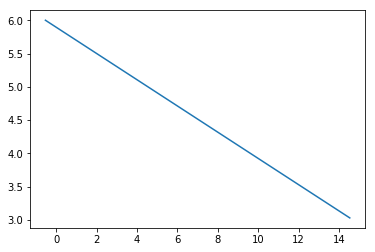

error value is [[0.52421994]]


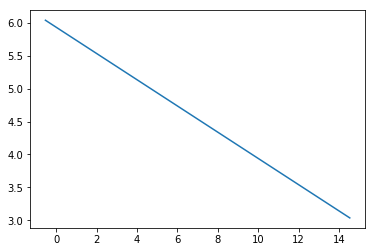

error value is [[0.52318599]]


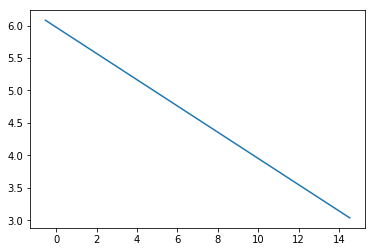

error value is [[0.52215596]]


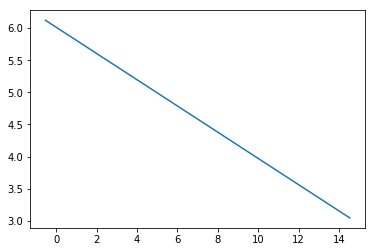

error value is [[0.52112981]]


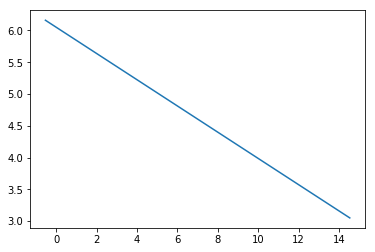

error value is [[0.52010753]]


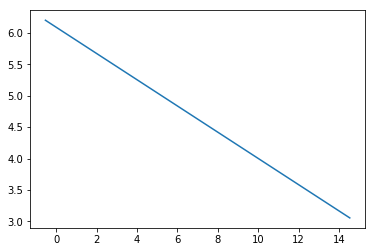

error value is [[0.5190891]]


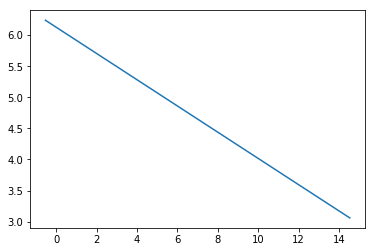

error value is [[0.51807452]]


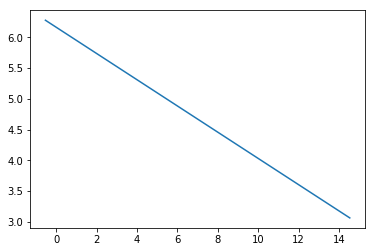

error value is [[0.51706375]]


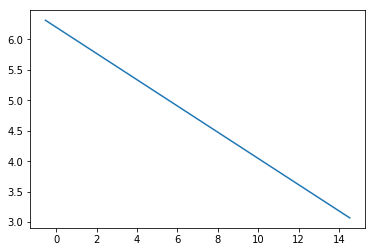

error value is [[0.51605679]]


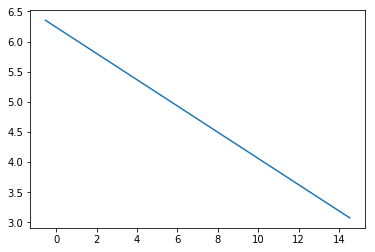

error value is [[0.51505361]]


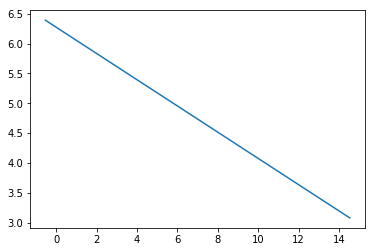

error value is [[0.5140542]]


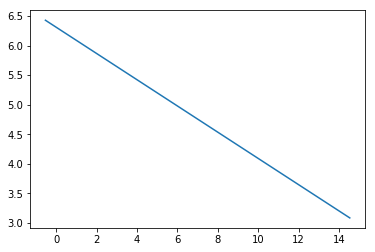

error value is [[0.51305855]]


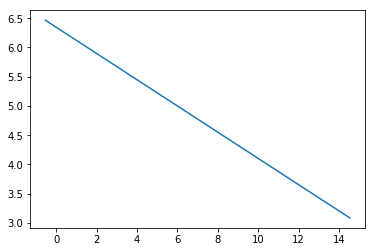

error value is [[0.51206663]]


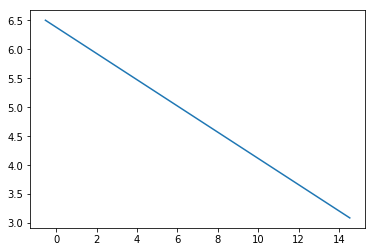

error value is [[0.51107844]]


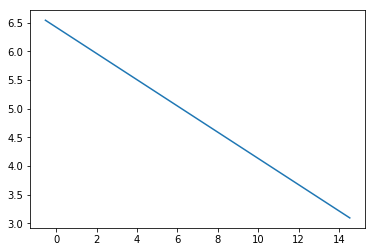

error value is [[0.51009395]]


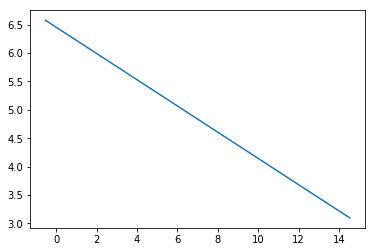

error value is [[0.50911314]]


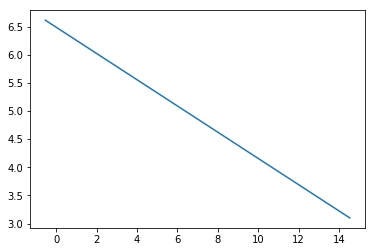

error value is [[0.50813601]]


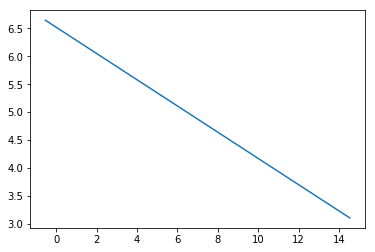

error value is [[0.50716253]]


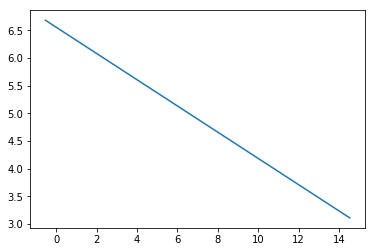

error value is [[0.5061927]]


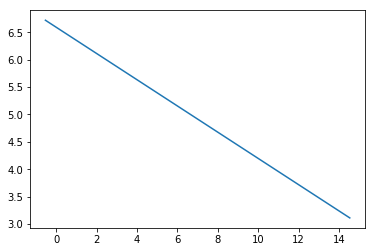

error value is [[0.50522648]]


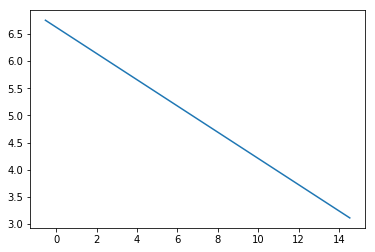

error value is [[0.50426388]]


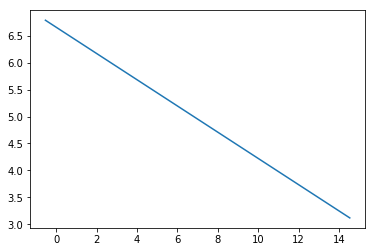

error value is [[0.50330486]]


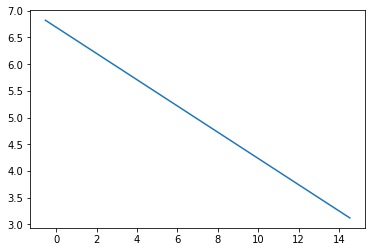

error value is [[0.50234942]]


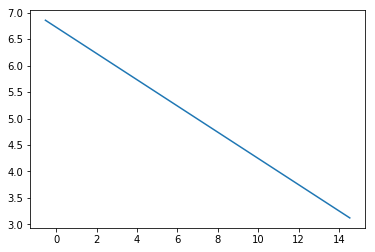

error value is [[0.50139754]]


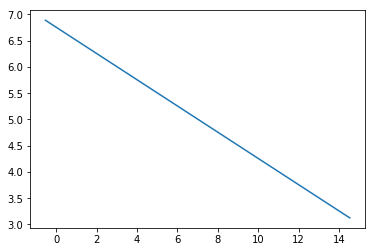

error value is [[0.50044921]]


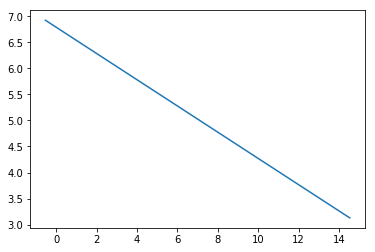

error value is [[0.4995044]]


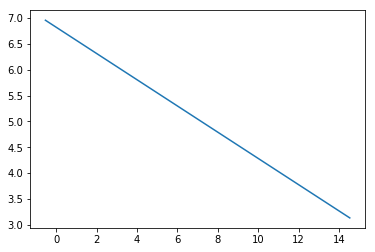

error value is [[0.4985631]]


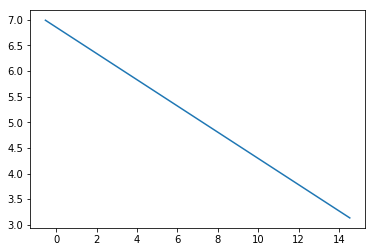

error value is [[0.49762531]]


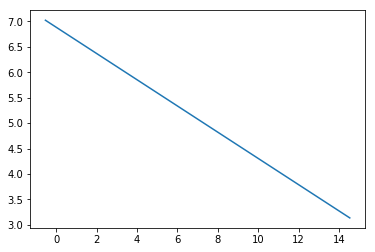

error value is [[0.49669099]]


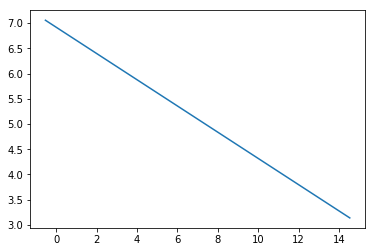

error value is [[0.49576014]]


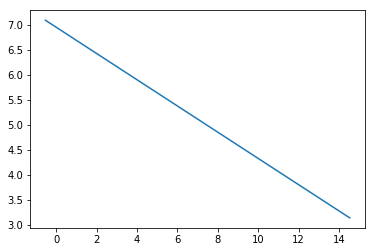

error value is [[0.49483274]]


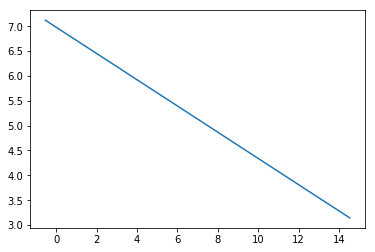

error value is [[0.49390878]]


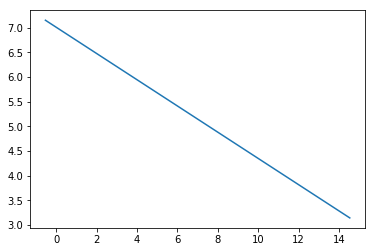

error value is [[0.49298824]]


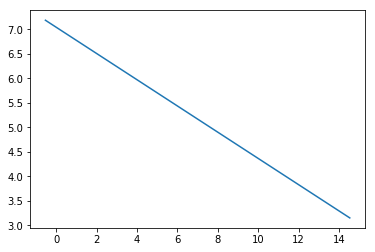

error value is [[0.4920711]]


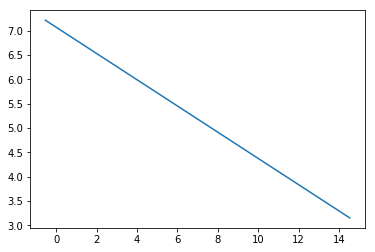

error value is [[0.49115736]]


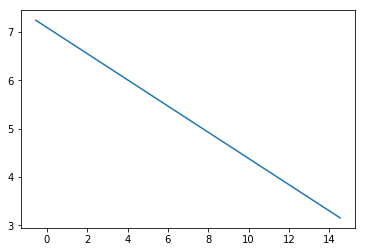

error value is [[0.49024698]]


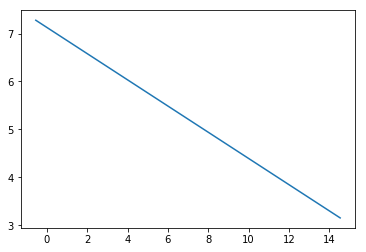

error value is [[0.48933997]]


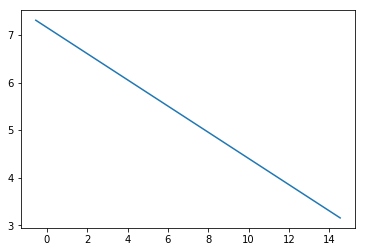

error value is [[0.48843631]]


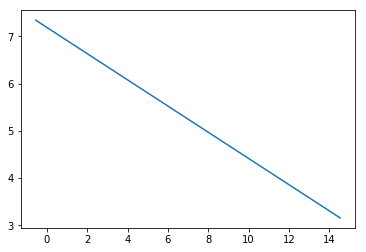

error value is [[0.48753597]]


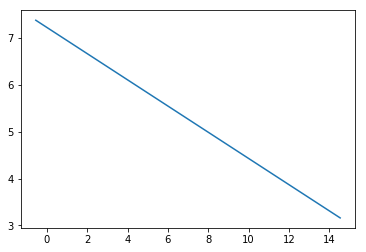

error value is [[0.48663895]]


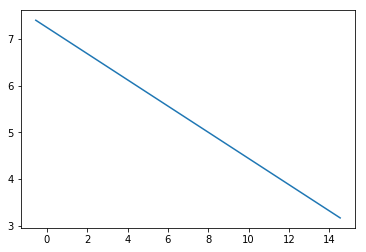

error value is [[0.48574523]]


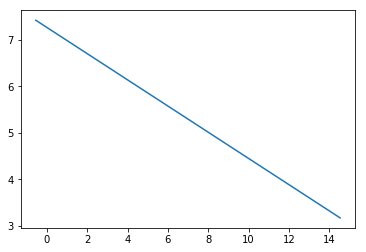

error value is [[0.4848548]]


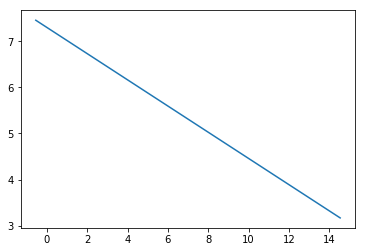

error value is [[0.48396763]]


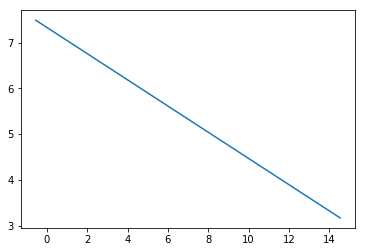

error value is [[0.48308373]]


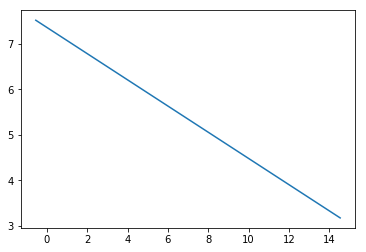

error value is [[0.48220307]]


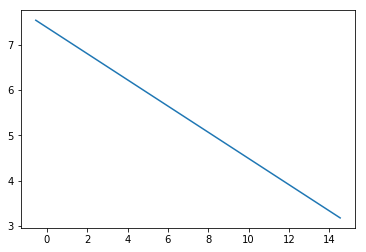

error value is [[0.48132563]]


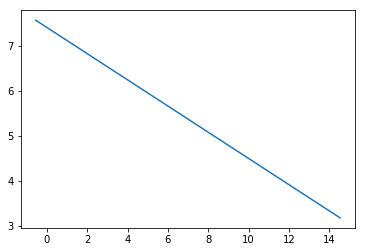

error value is [[0.48045141]]


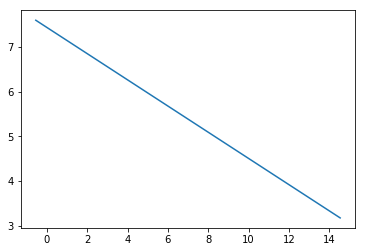

error value is [[0.47958039]]


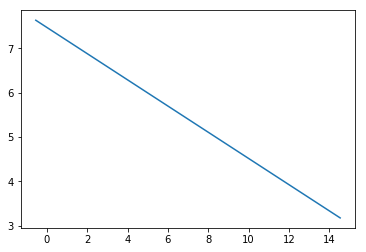

error value is [[0.47871255]]


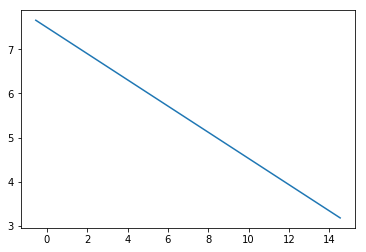

error value is [[0.47784788]]


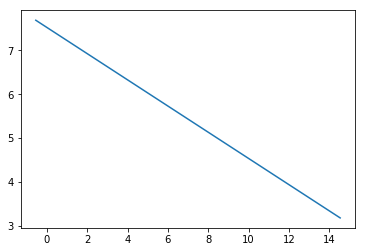

error value is [[0.47698637]]


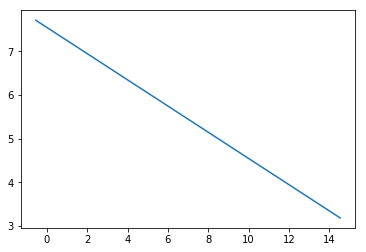

error value is [[0.476128]]


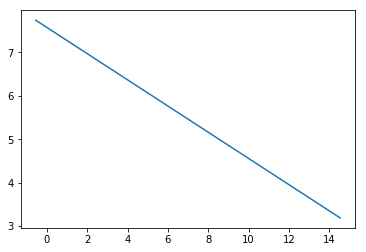

error value is [[0.47527276]]


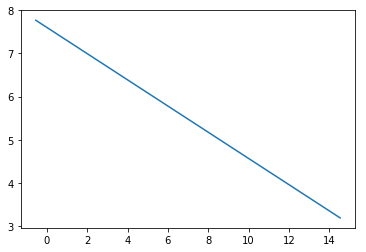

error value is [[0.47442063]]


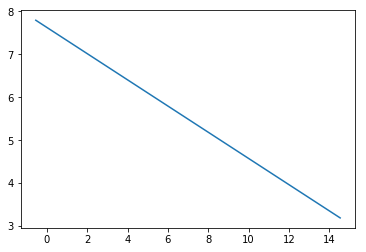

error value is [[0.47357161]]


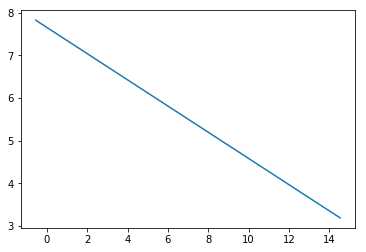

error value is [[0.47272567]]


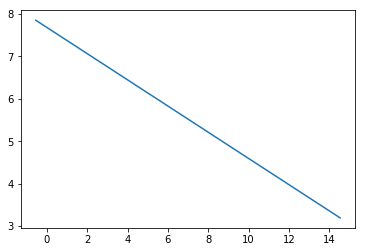

error value is [[0.4718828]]


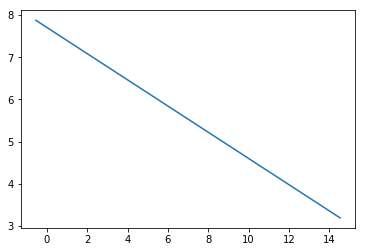

error value is [[0.47104299]]


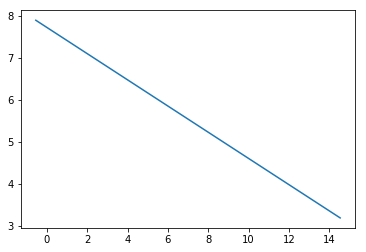

error value is [[0.47020623]]


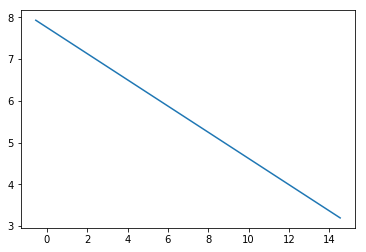

error value is [[0.4693725]]


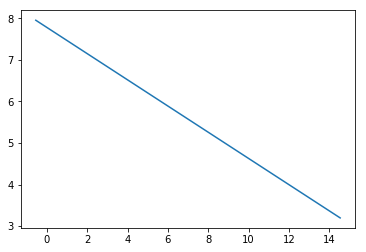

error value is [[0.46854179]]


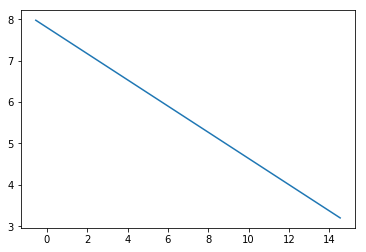

error value is [[0.46771408]]


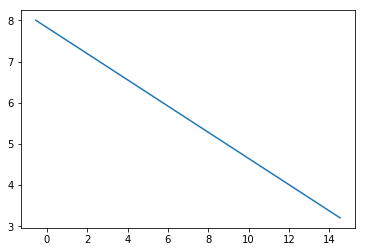

error value is [[0.46688936]]


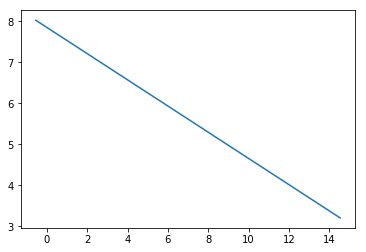

error value is [[0.46606762]]


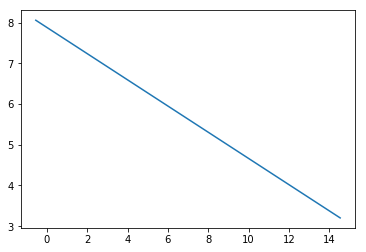

error value is [[0.46524885]]


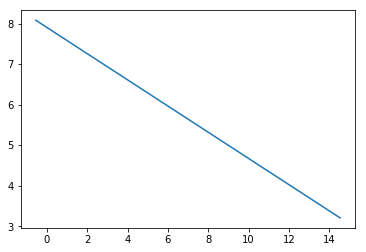

error value is [[0.46443302]]


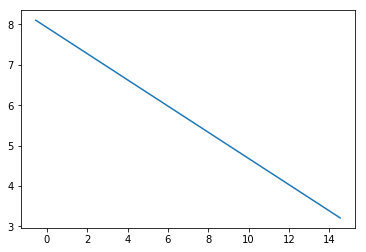

error value is [[0.46362013]]


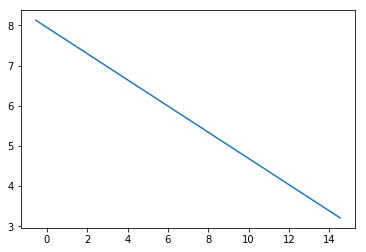

error value is [[0.46281017]]


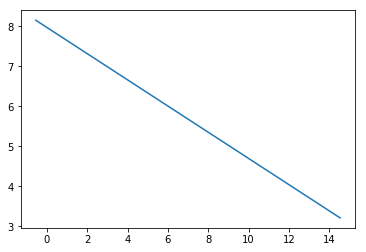

error value is [[0.46200312]]


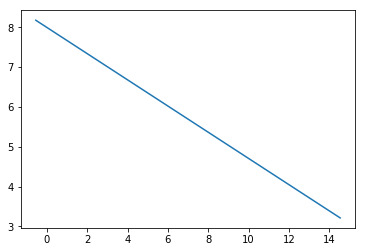

error value is [[0.46119897]]


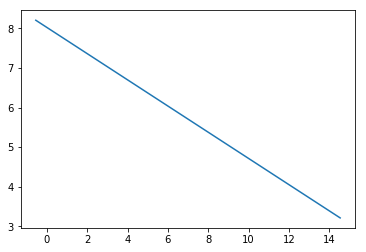

error value is [[0.4603977]]


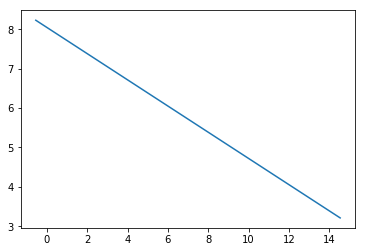

error value is [[0.4595993]]


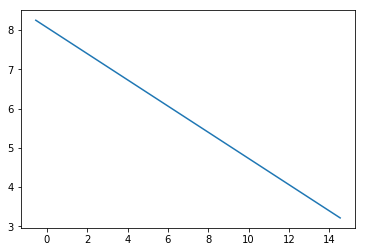

error value is [[0.45880377]]


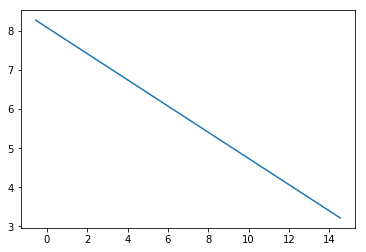

error value is [[0.45801108]]


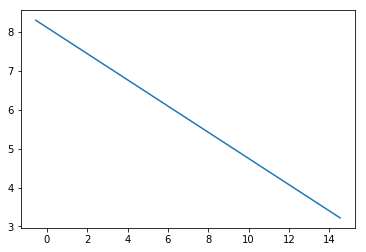

error value is [[0.45722122]]


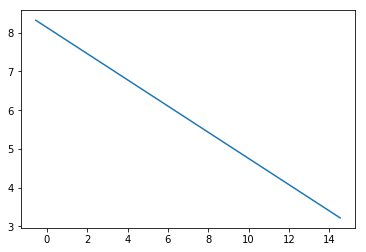

error value is [[0.45643419]]


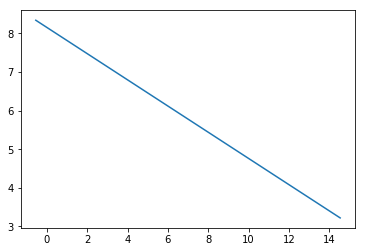

error value is [[0.45564996]]


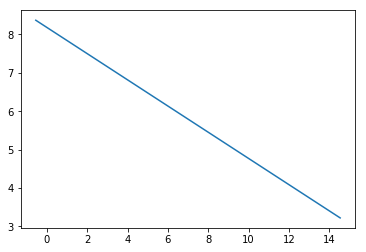

error value is [[0.45486854]]


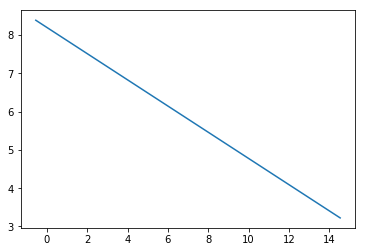

error value is [[0.45408989]]


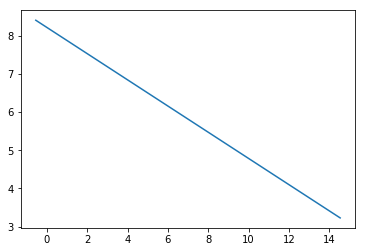

error value is [[0.45331401]]


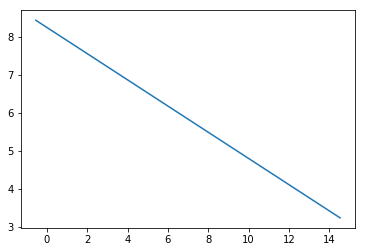

error value is [[0.4525409]]


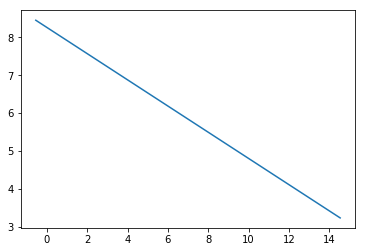

error value is [[0.45177052]]


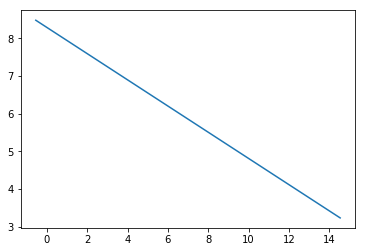

error value is [[0.45100289]]


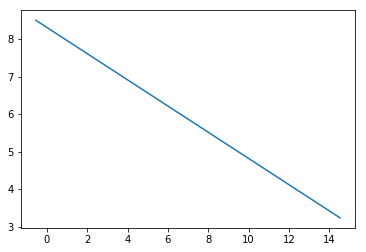

error value is [[0.45023797]]


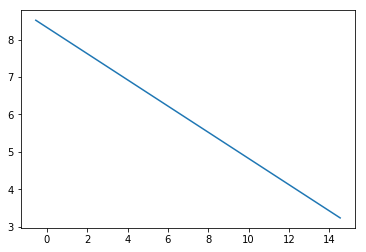

error value is [[0.44947576]]


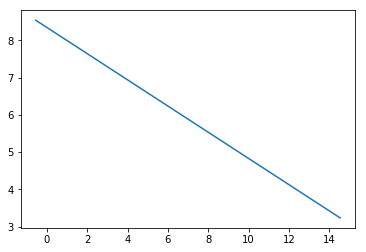

error value is [[0.44871625]]


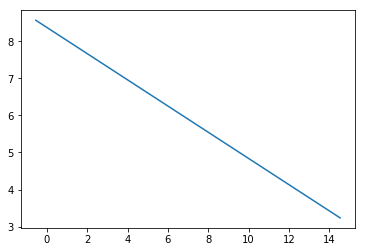

error value is [[0.44795943]]


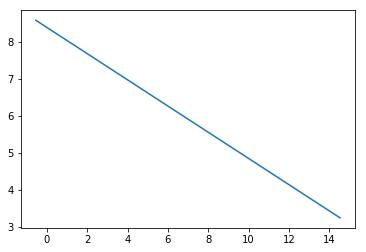

error value is [[0.44720528]]


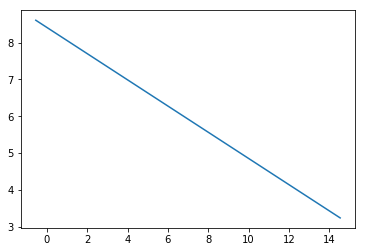

error value is [[0.44645378]]


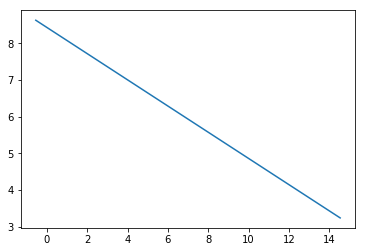

error value is [[0.44570494]]


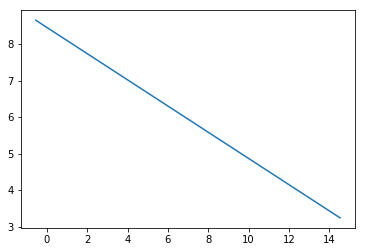

error value is [[0.44495874]]


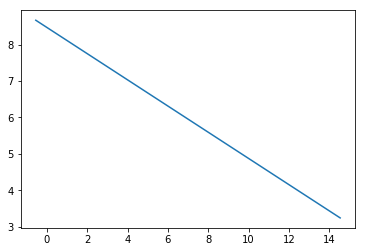

error value is [[0.44421515]]


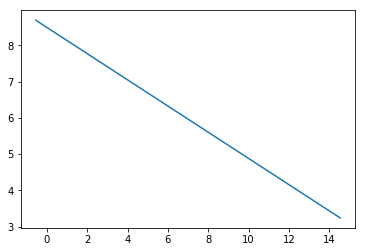

error value is [[0.44347419]]


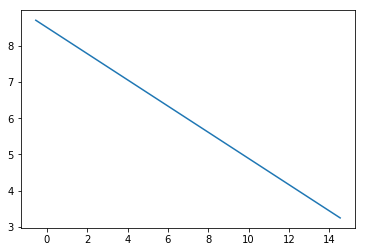

error value is [[0.44273582]]


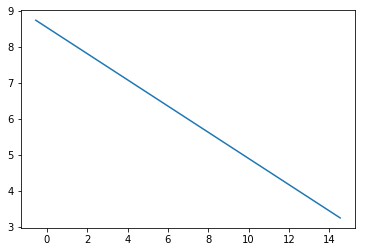

error value is [[0.44200005]]


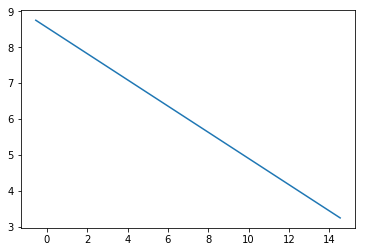

error value is [[0.44126685]]


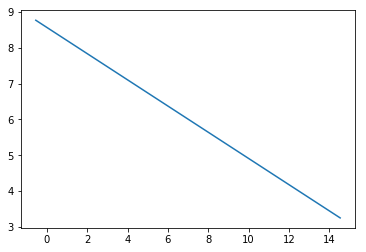

error value is [[0.44053622]]


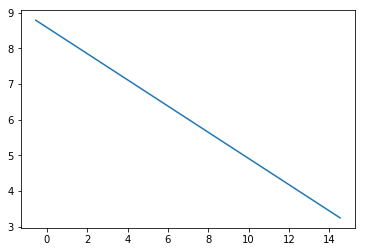

error value is [[0.43980814]]


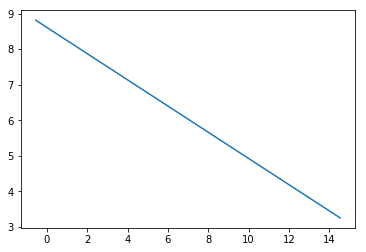

error value is [[0.43908261]]


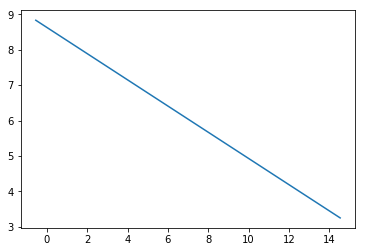

error value is [[0.43835961]]


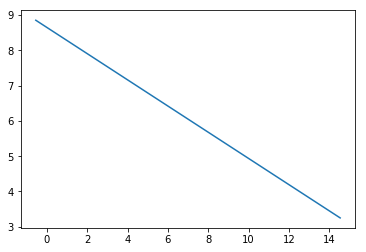

error value is [[0.43763913]]


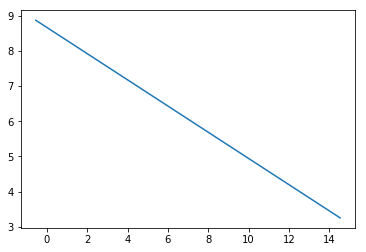

error value is [[0.43692117]]


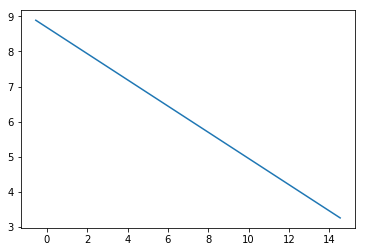

error value is [[0.4362057]]


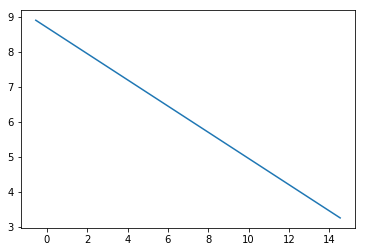

error value is [[0.43549271]]


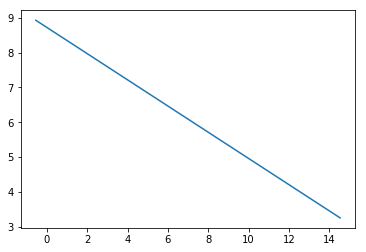

error value is [[0.43478221]]


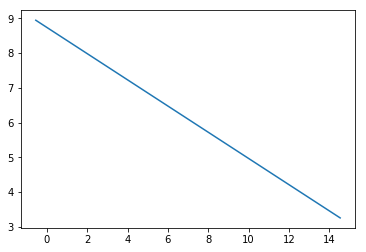

error value is [[0.43407416]]


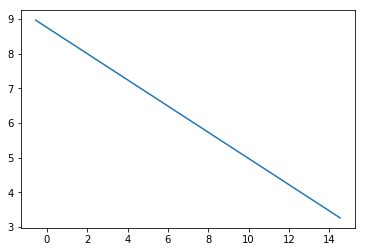

error value is [[0.43336858]]


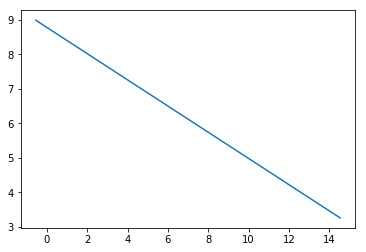

error value is [[0.43266543]]


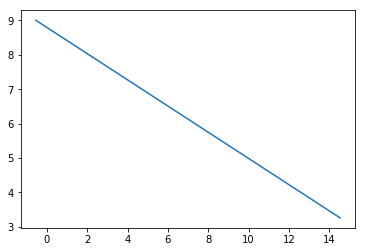

error value is [[0.43196472]]


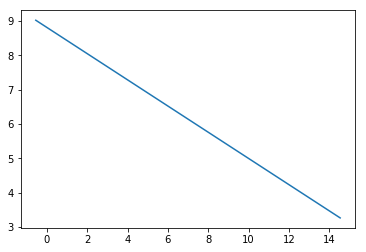

error value is [[0.43126643]]


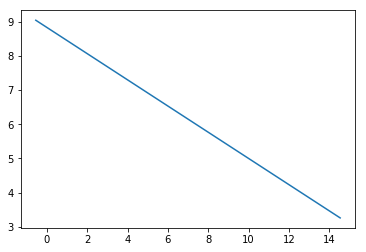

error value is [[0.43057055]]


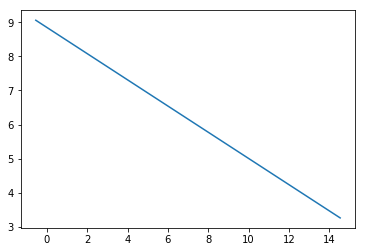

error value is [[0.42987707]]


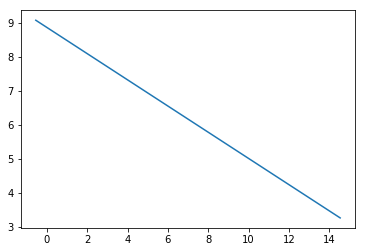

error value is [[0.42918597]]


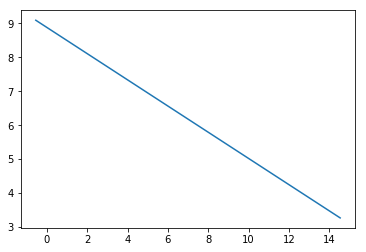

error value is [[0.42849726]]


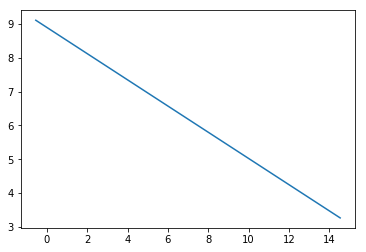

error value is [[0.42781091]]


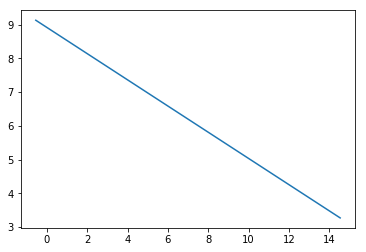

error value is [[0.42712692]]


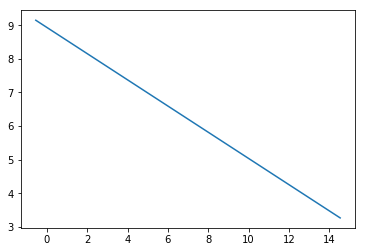

error value is [[0.42644528]]


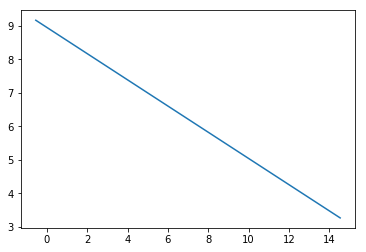

error value is [[0.42576597]]


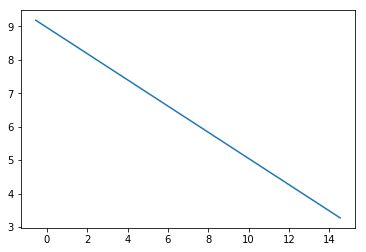

error value is [[0.42508899]]


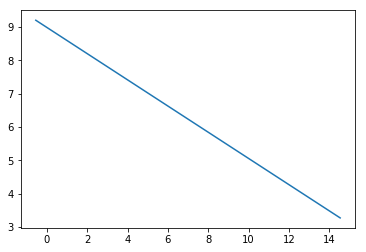

error value is [[0.42441432]]


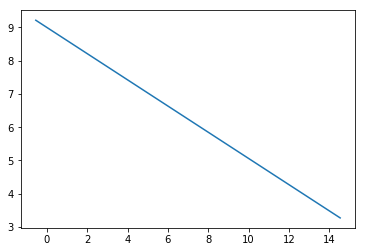

error value is [[0.42374196]]


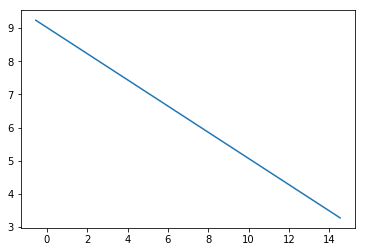

error value is [[0.42307189]]


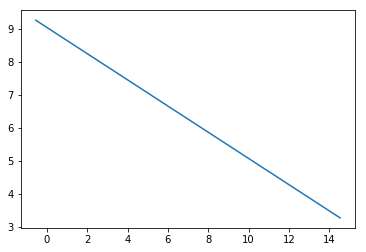

error value is [[0.4224041]]


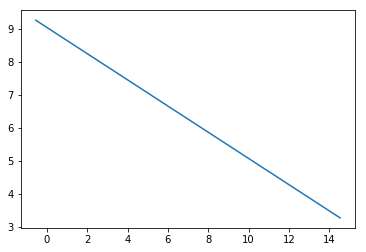

error value is [[0.4217386]]


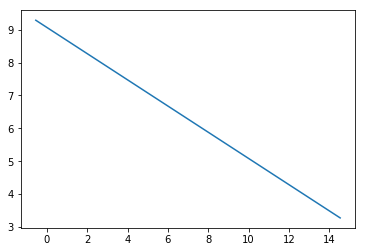

error value is [[0.42107535]]


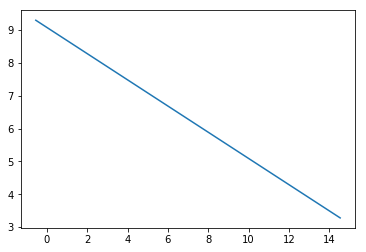

error value is [[0.42041436]]


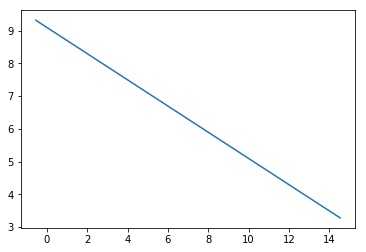

error value is [[0.41975561]]


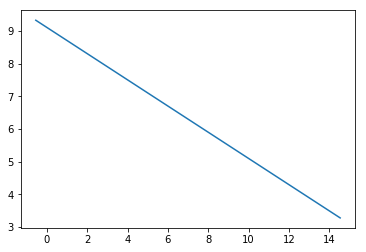

error value is [[0.41909909]]


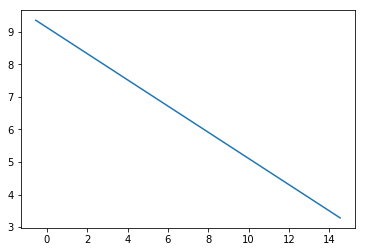

error value is [[0.4184448]]


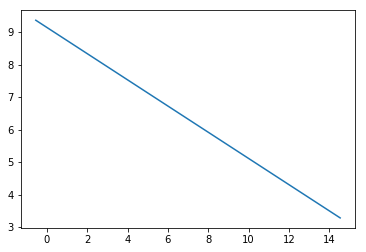

error value is [[0.41779273]]


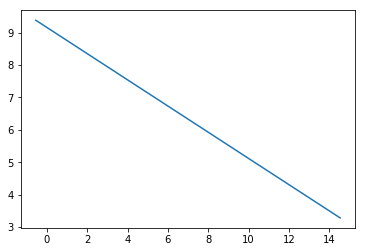

error value is [[0.41714285]]


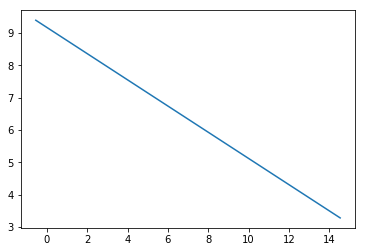

error value is [[0.41649518]]


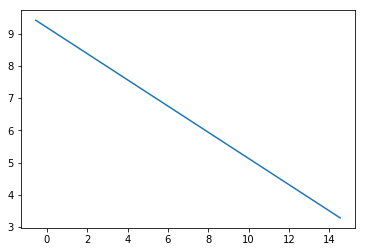

error value is [[0.41584968]]


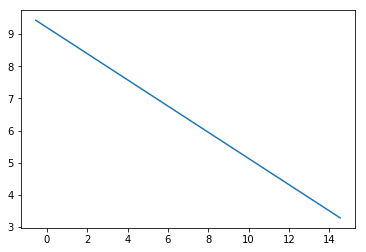

error value is [[0.41520636]]


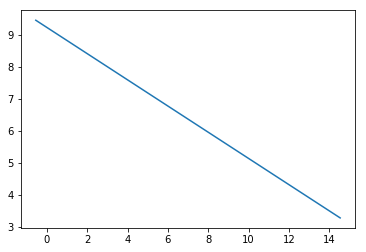

error value is [[0.41456521]]


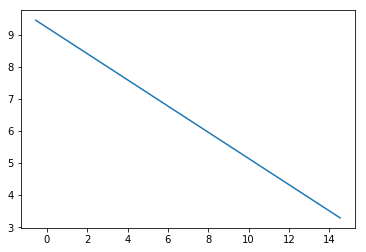

error value is [[0.41392621]]


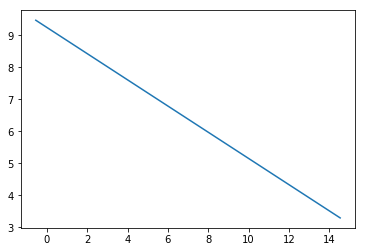

error value is [[0.41328936]]


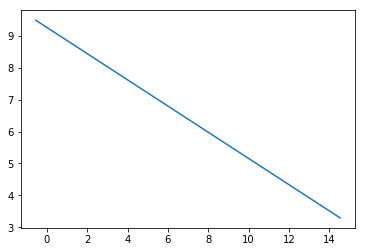

error value is [[0.41265464]]


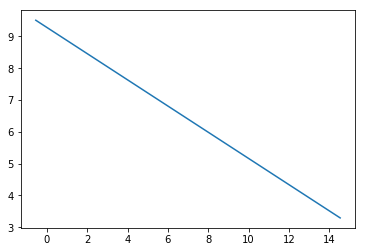

error value is [[0.41202206]]


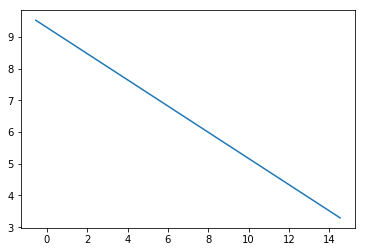

error value is [[0.41139159]]


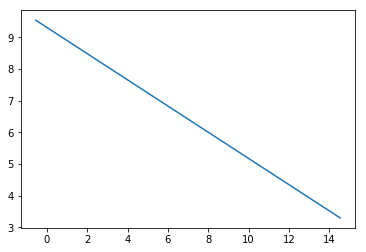

error value is [[0.41076322]]


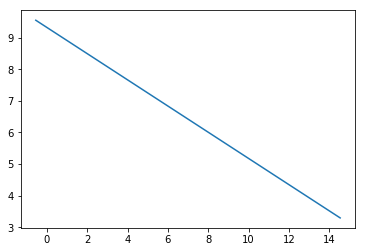

error value is [[0.41013696]]


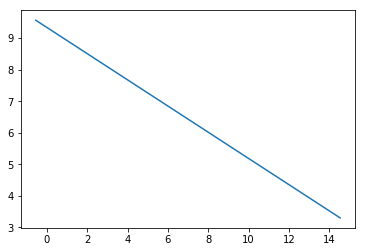

error value is [[0.40951278]]


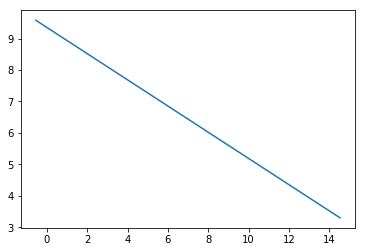

error value is [[0.40889069]]


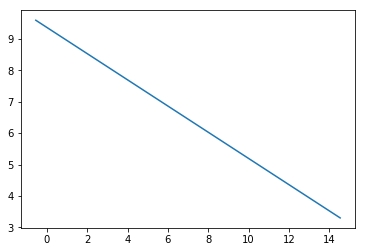

error value is [[0.40827067]]


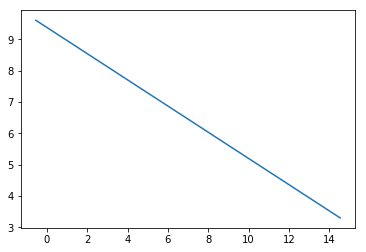

error value is [[0.40765271]]


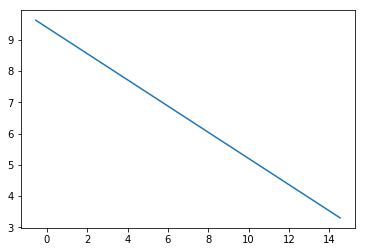

error value is [[0.4070368]]


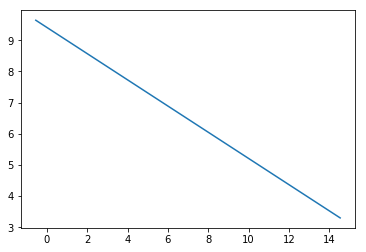

error value is [[0.40642293]]


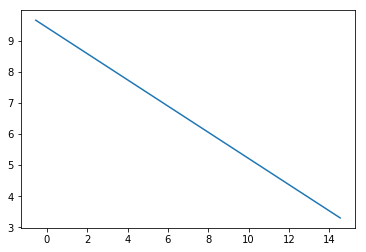

error value is [[0.40581111]]


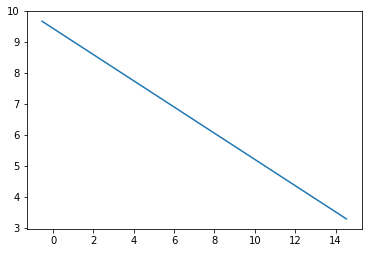

error value is [[0.4052013]]


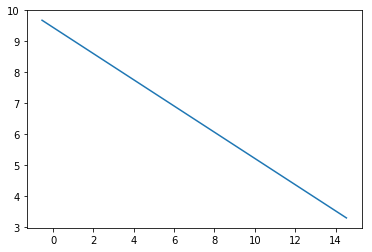

error value is [[0.40459351]]


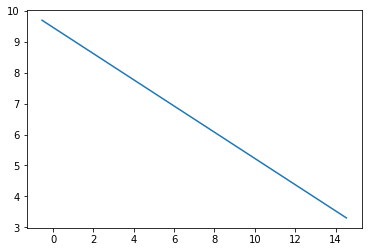

error value is [[0.40398774]]


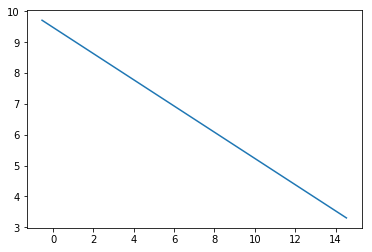

error value is [[0.40338396]]


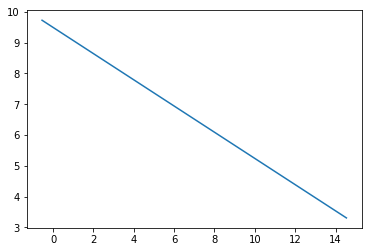

error value is [[0.40278217]]


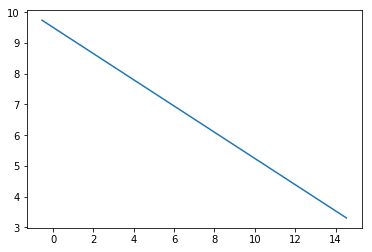

error value is [[0.40218236]]


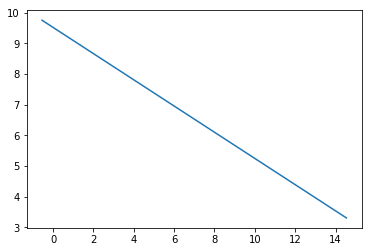

error value is [[0.40158452]]


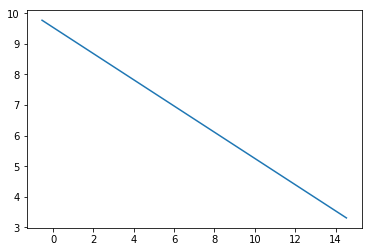

error value is [[0.40098865]]


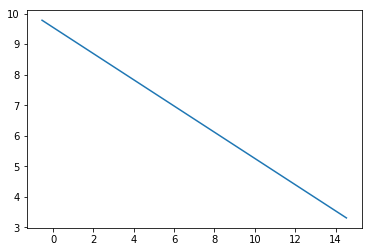

error value is [[0.40039474]]


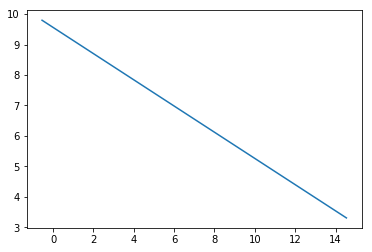

error value is [[0.39980277]]


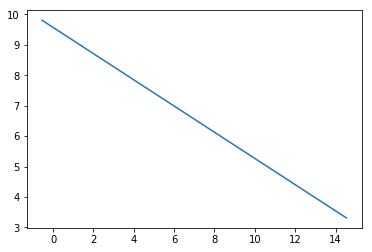

error value is [[0.39921274]]


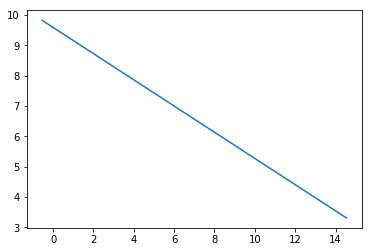

error value is [[0.39862464]]


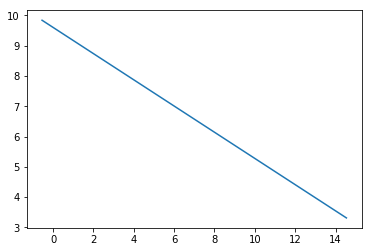

error value is [[0.39803846]]


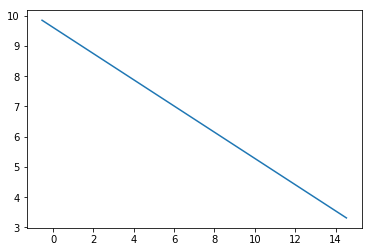

error value is [[0.39745419]]


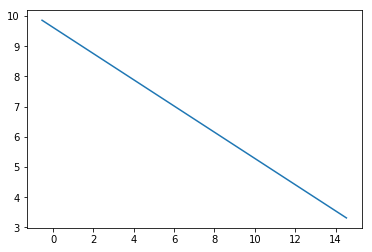

error value is [[0.39687183]]


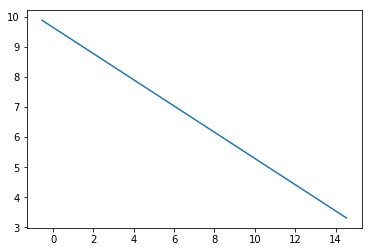

error value is [[0.39629137]]


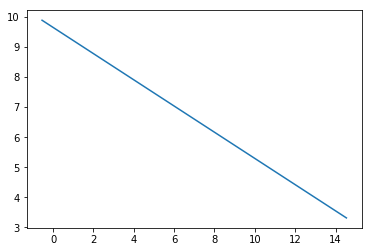

error value is [[0.39571279]]


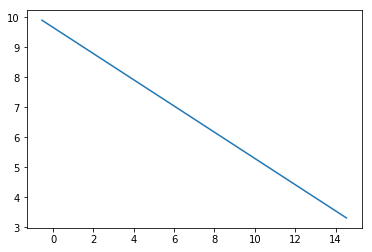

error value is [[0.3951361]]


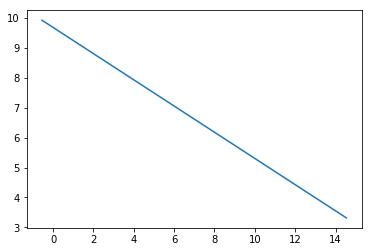

error value is [[0.39456127]]


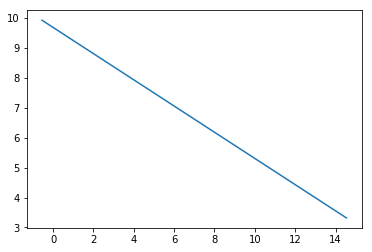

error value is [[0.39398831]]


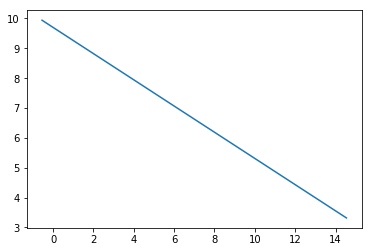

error value is [[0.3934172]]


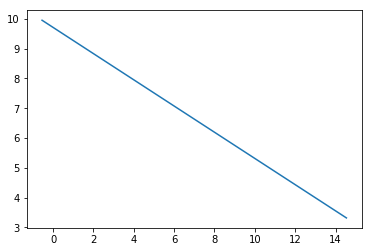

error value is [[0.39284794]]


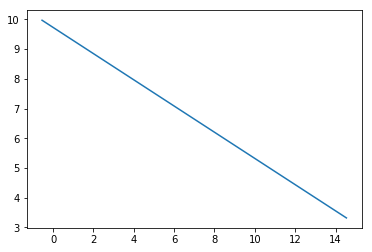

error value is [[0.39228052]]


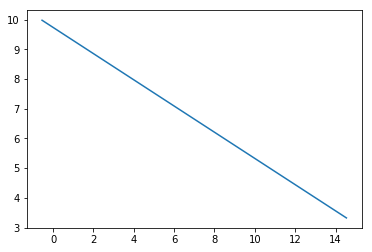

error value is [[0.39171493]]


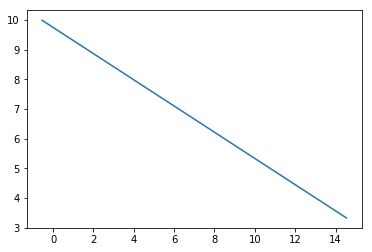

error value is [[0.39115116]]


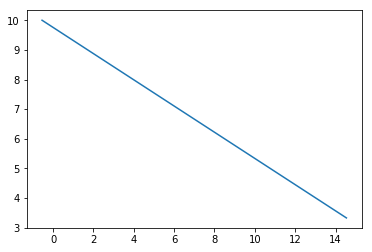

error value is [[0.39058921]]


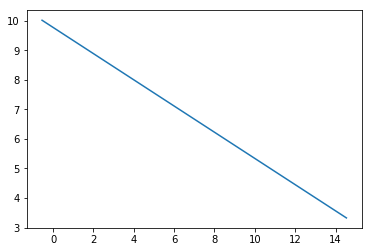

error value is [[0.39002907]]


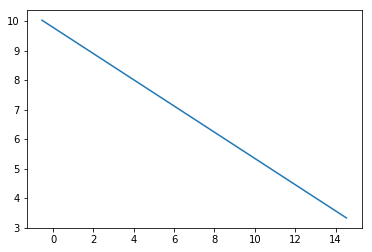

error value is [[0.38947072]]


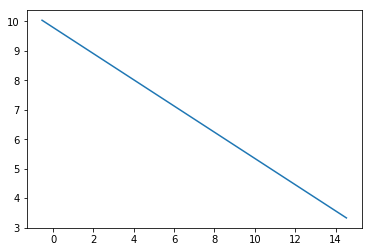

error value is [[0.38891417]]


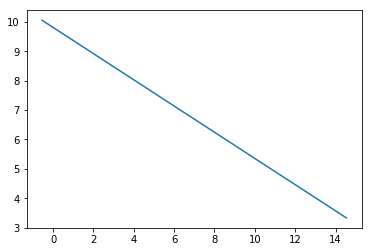

error value is [[0.3883594]]


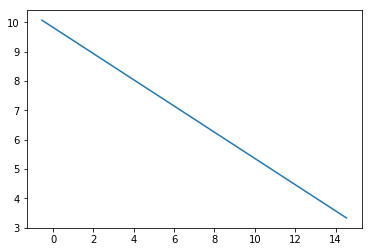

error value is [[0.3878064]]


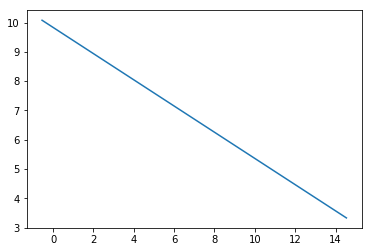

error value is [[0.38725518]]


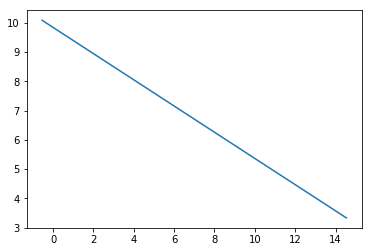

error value is [[0.38670571]]


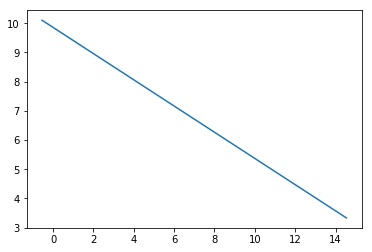

error value is [[0.386158]]


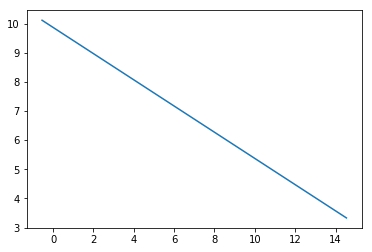

error value is [[0.38561203]]


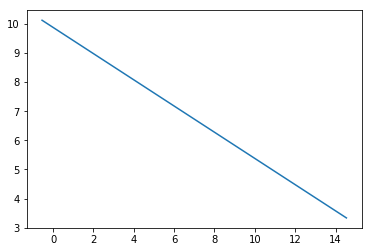

error value is [[0.38506781]]


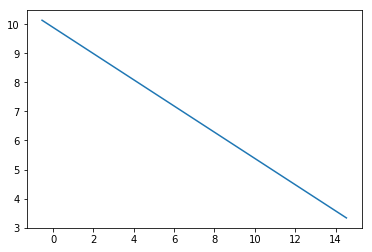

error value is [[0.38452531]]


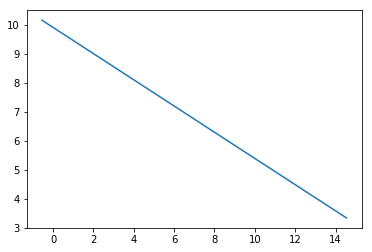

error value is [[0.38398453]]


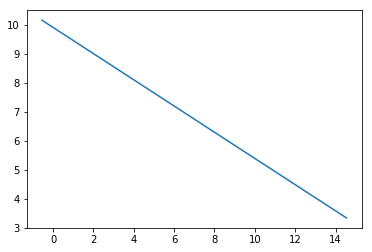

error value is [[0.38344547]]


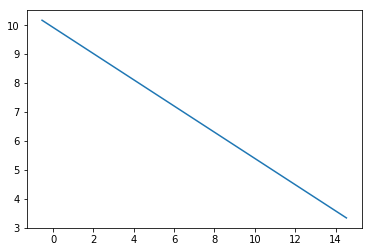

error value is [[0.38290812]]


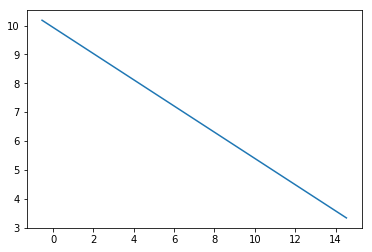

error value is [[0.38237247]]


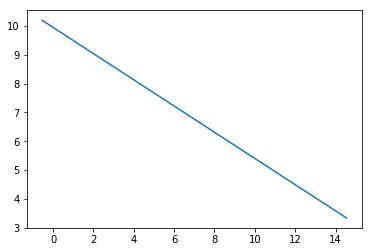

error value is [[0.38183851]]


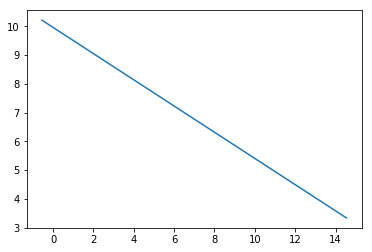

error value is [[0.38130624]]


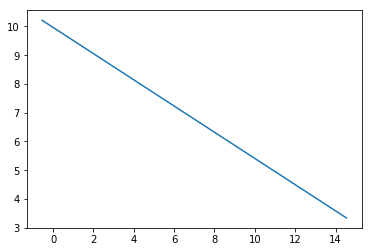

error value is [[0.38077564]]


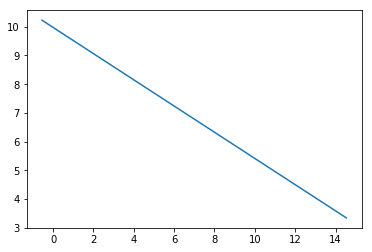

error value is [[0.38024672]]


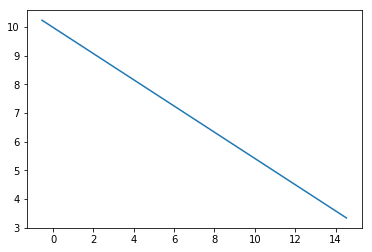

error value is [[0.37971947]]


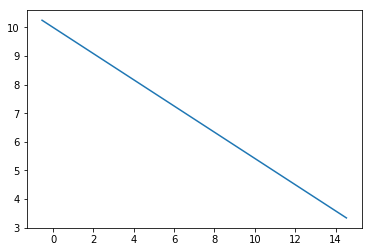

error value is [[0.37919386]]


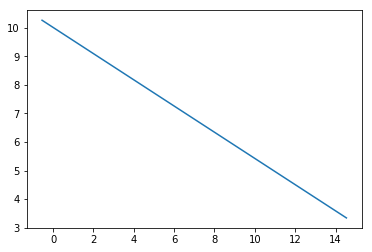

error value is [[0.37866991]]


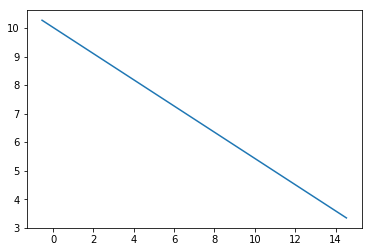

error value is [[0.37814761]]


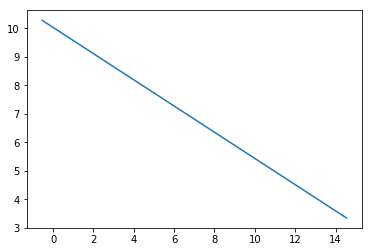

error value is [[0.37762694]]


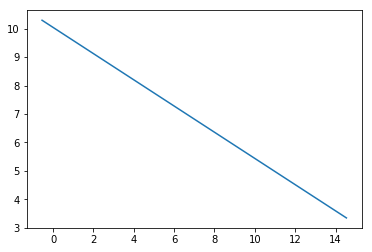

error value is [[0.37710789]]


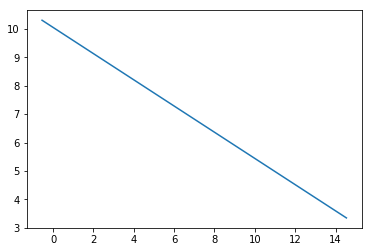

error value is [[0.37659047]]


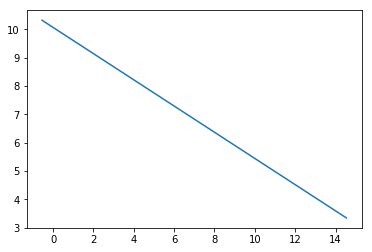

error value is [[0.37607467]]


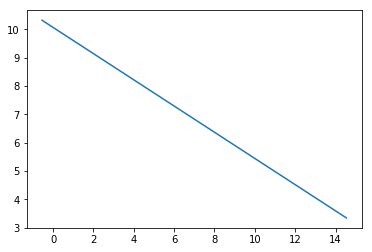

error value is [[0.37556047]]


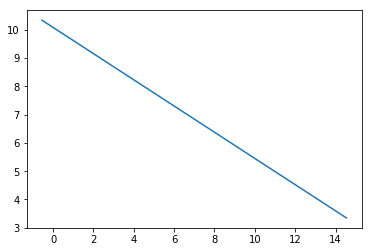

error value is [[0.37504788]]


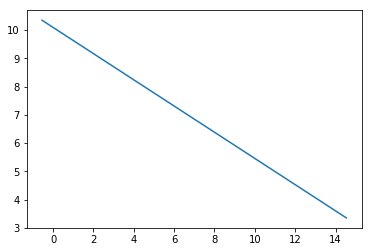

error value is [[0.37453687]]


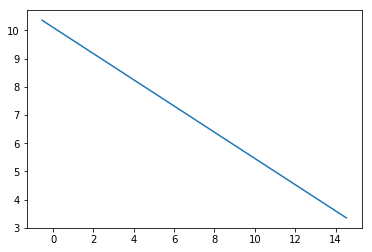

error value is [[0.37402746]]


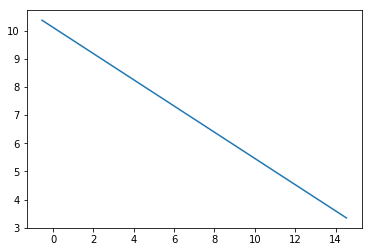

error value is [[0.37351963]]


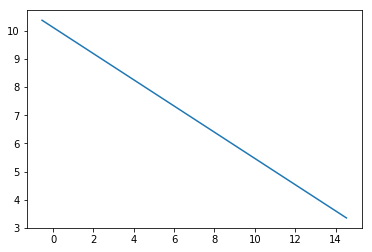

error value is [[0.37301337]]


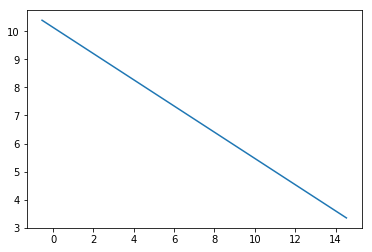

error value is [[0.37250868]]


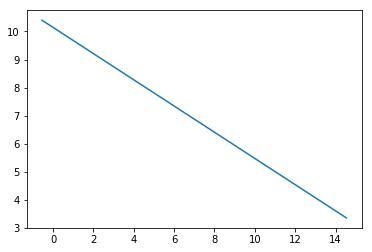

error value is [[0.37200555]]


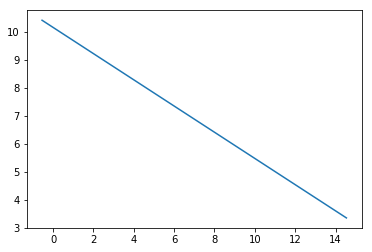

error value is [[0.37150397]]


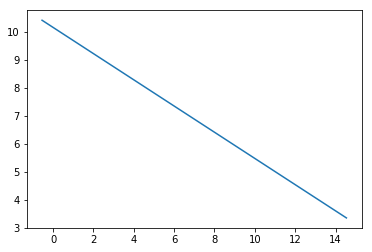

error value is [[0.37100394]]


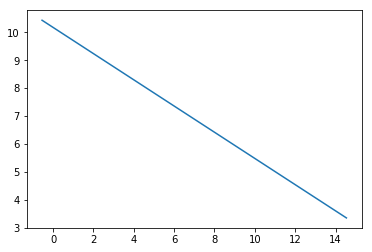

error value is [[0.37050545]]


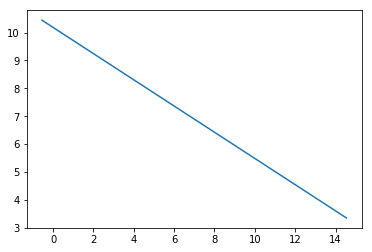

error value is [[0.3700085]]


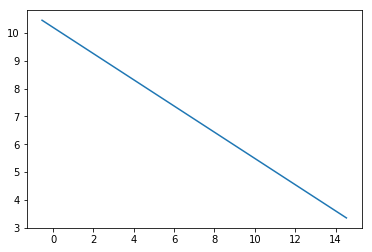

error value is [[0.36951307]]


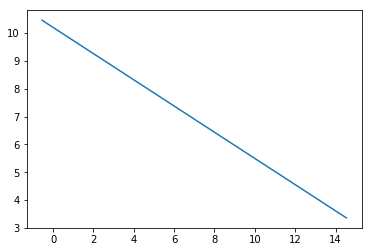

error value is [[0.36901917]]


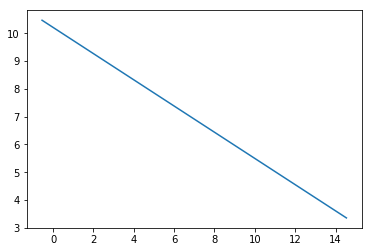

error value is [[0.36852678]]


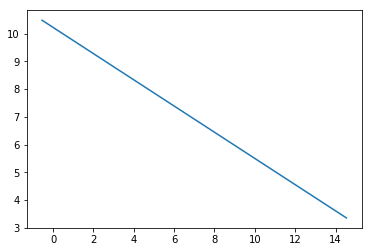

error value is [[0.3680359]]


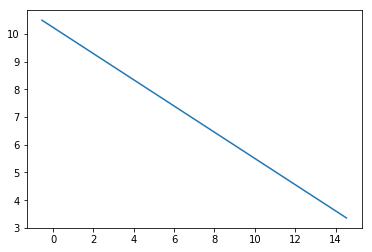

error value is [[0.36754652]]


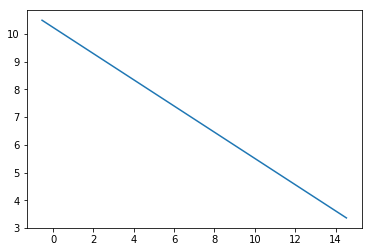

error value is [[0.36705864]]


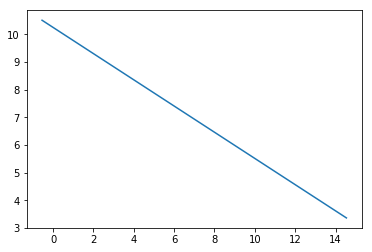

error value is [[0.36657224]]


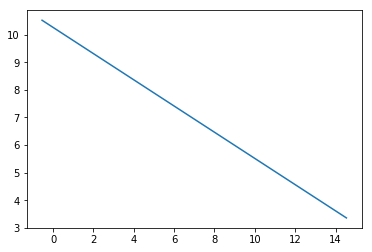

error value is [[0.36608733]]


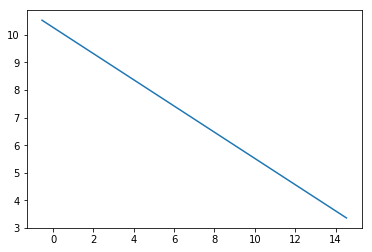

error value is [[0.3656039]]


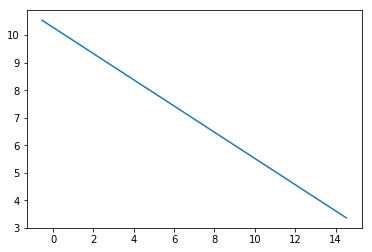

error value is [[0.36512194]]


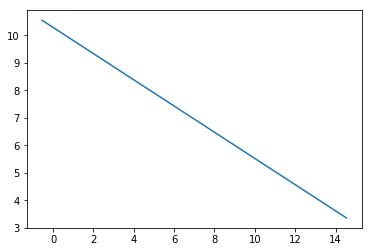

error value is [[0.36464144]]


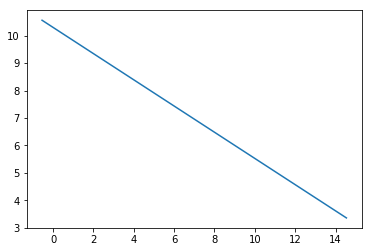

error value is [[0.3641624]]


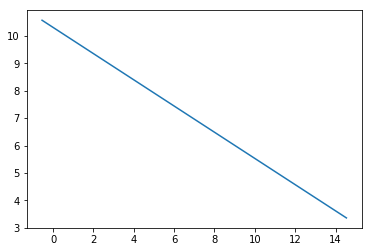

error value is [[0.36368481]]


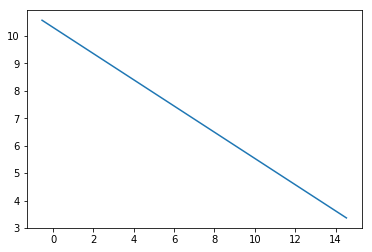

error value is [[0.36320867]]


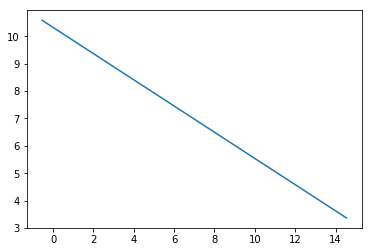

error value is [[0.36273397]]


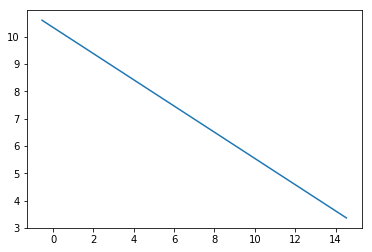

error value is [[0.3622607]]


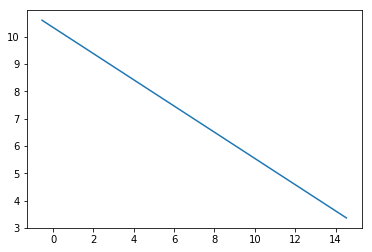

error value is [[0.36178886]]


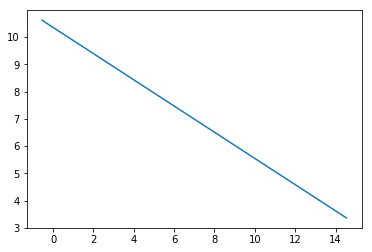

error value is [[0.36131844]]


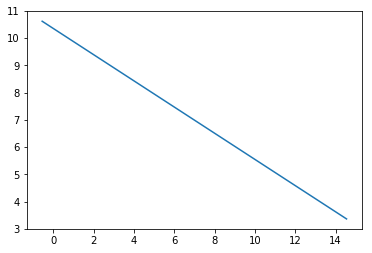

error value is [[0.36084944]]


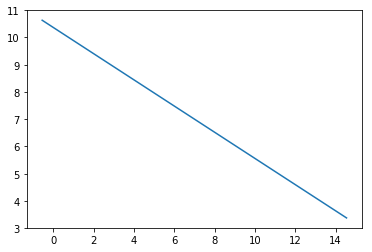

error value is [[0.36038185]]


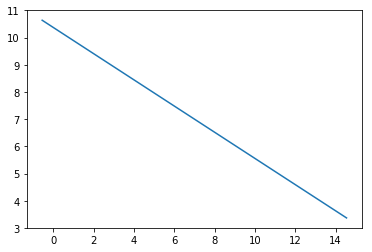

error value is [[0.35991567]]


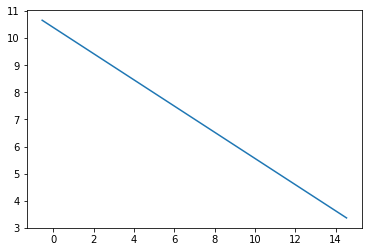

error value is [[0.35945088]]


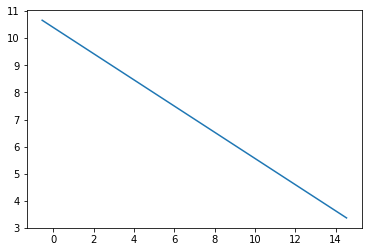

error value is [[0.35898748]]


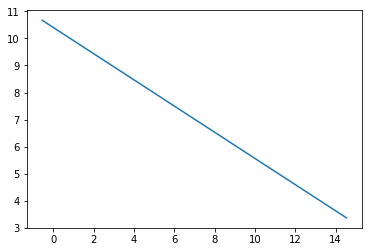

error value is [[0.35852548]]


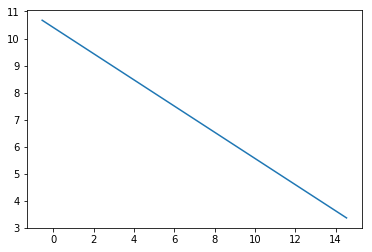

error value is [[0.35806485]]


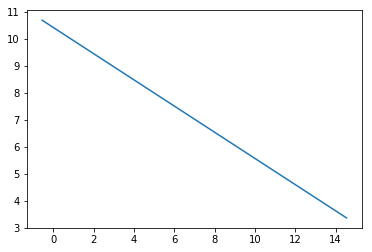

error value is [[0.3576056]]


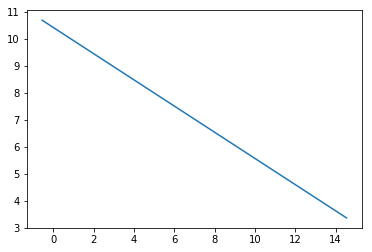

error value is [[0.35714771]]


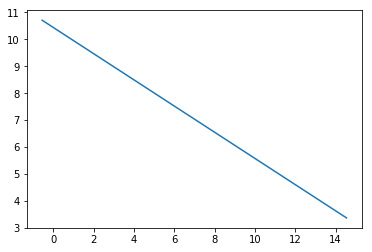

error value is [[0.3566912]]


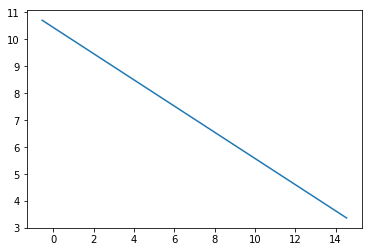

error value is [[0.35623603]]


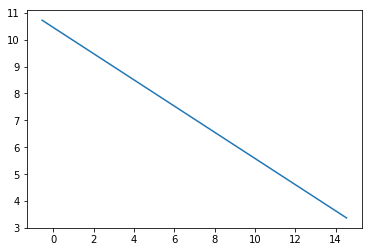

error value is [[0.35578223]]


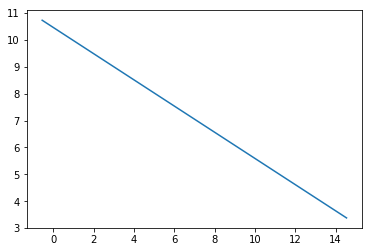

error value is [[0.35532977]]


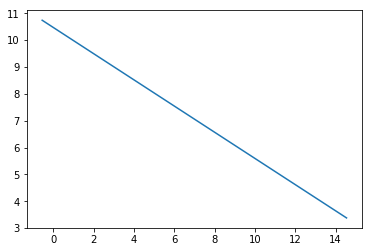

error value is [[0.35487865]]


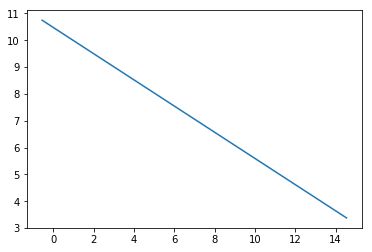

error value is [[0.35442886]]


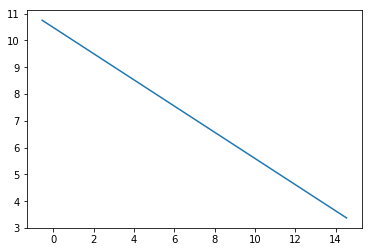

error value is [[0.35398041]]


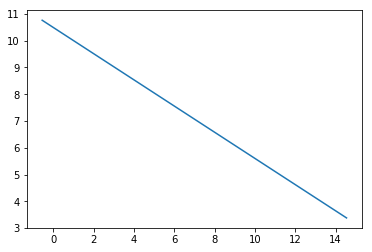

error value is [[0.35353328]]


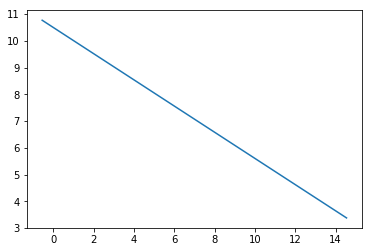

error value is [[0.35308747]]


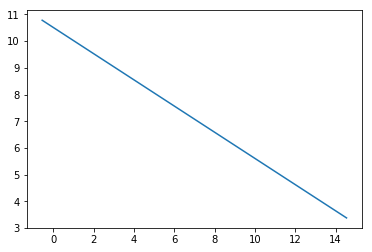

error value is [[0.35264298]]


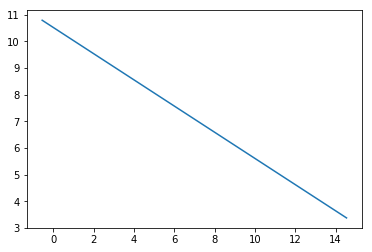

error value is [[0.35219979]]


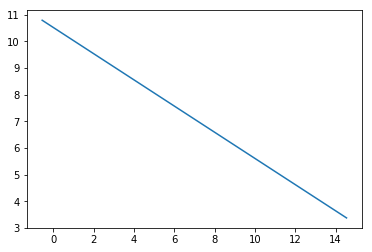

error value is [[0.35175791]]


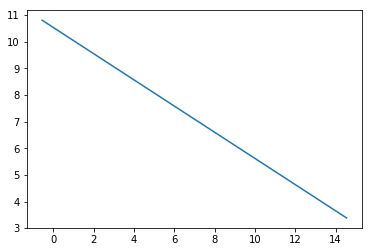

error value is [[0.35131732]]


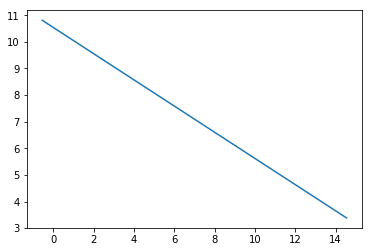

error value is [[0.35087803]]


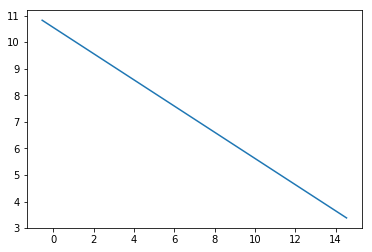

error value is [[0.35044002]]


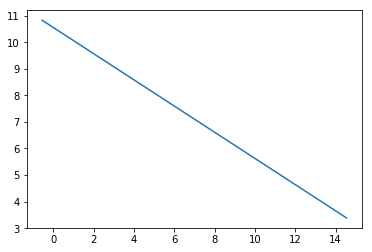

error value is [[0.3500033]]


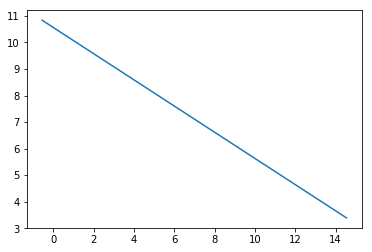

error value is [[0.34956785]]


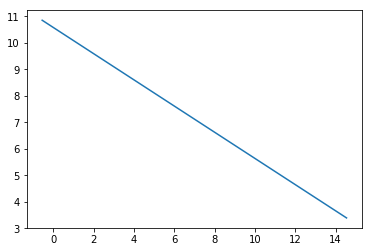

error value is [[0.34913368]]


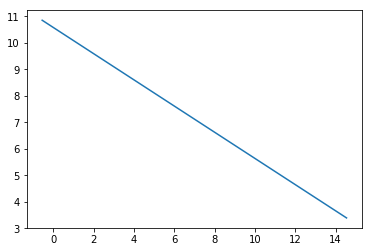

error value is [[0.34870076]]


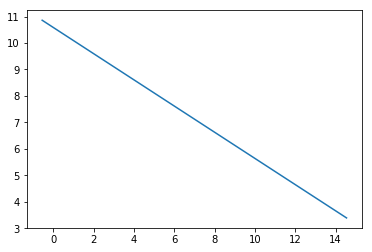

error value is [[0.34826912]]


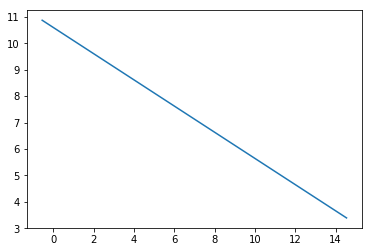

error value is [[0.34783872]]


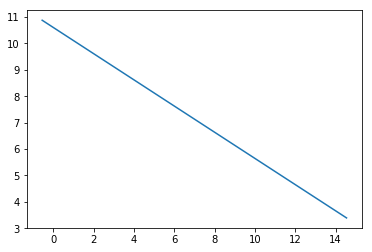

error value is [[0.34740958]]


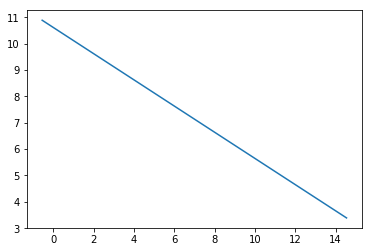

error value is [[0.34698168]]


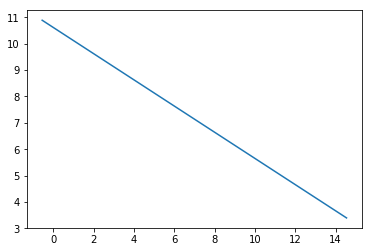

error value is [[0.34655503]]


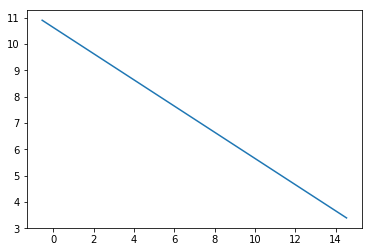

error value is [[0.3461296]]


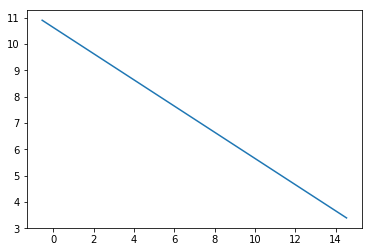

error value is [[0.34570541]]


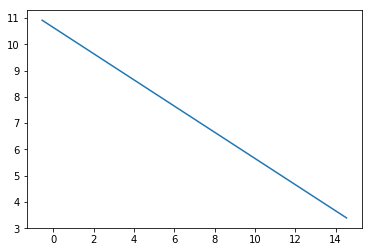

error value is [[0.34528245]]


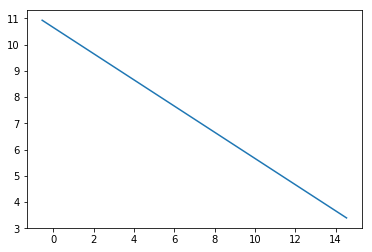

error value is [[0.3448607]]


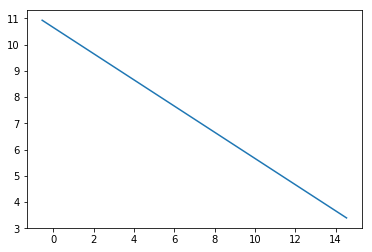

error value is [[0.34444017]]


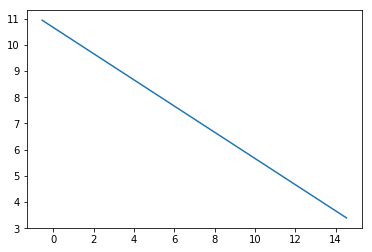

error value is [[0.34402086]]


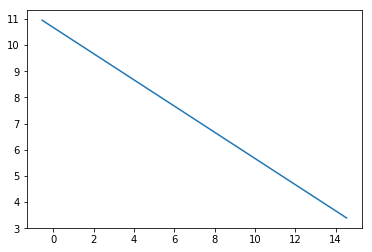

error value is [[0.34360274]]


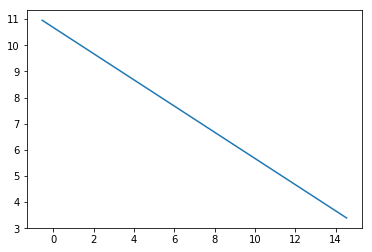

error value is [[0.34318583]]


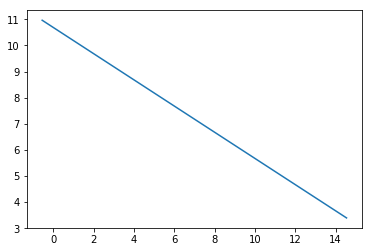

error value is [[0.34277011]]


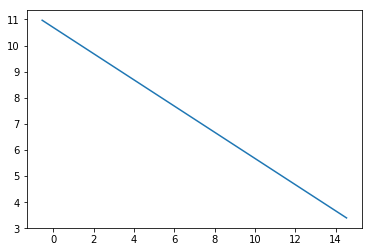

error value is [[0.34235559]]


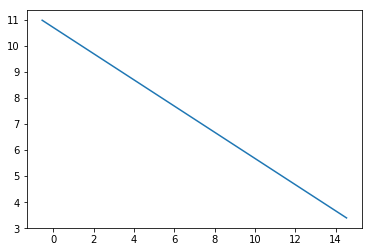

error value is [[0.34194225]]


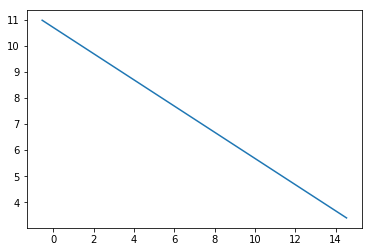

error value is [[0.34153009]]


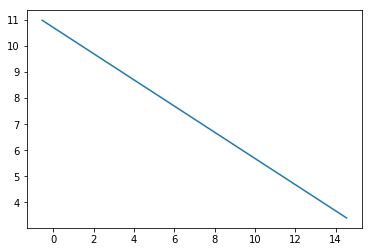

error value is [[0.34111911]]


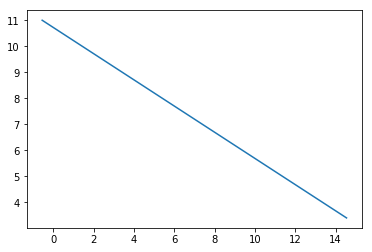

error value is [[0.3407093]]


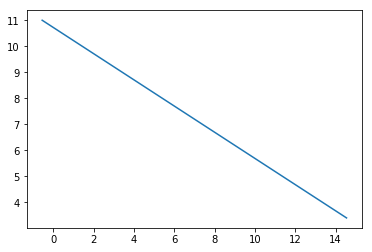

error value is [[0.34030066]]


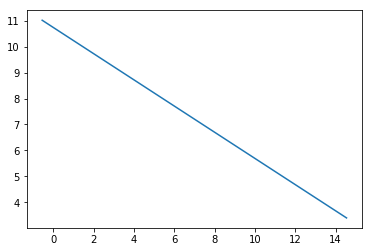

error value is [[0.33989318]]


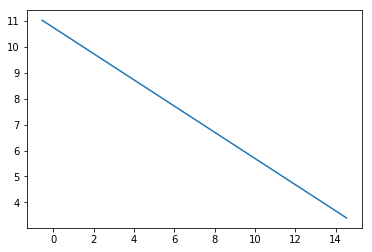

error value is [[0.33948686]]


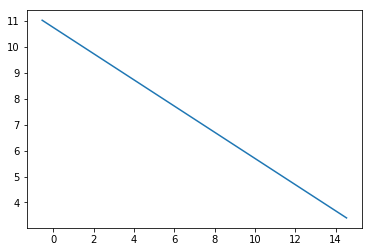

error value is [[0.33908169]]


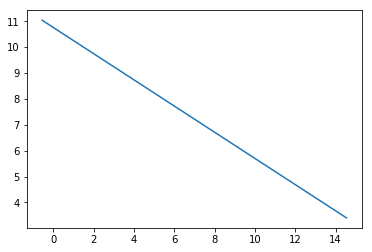

error value is [[0.33867767]]


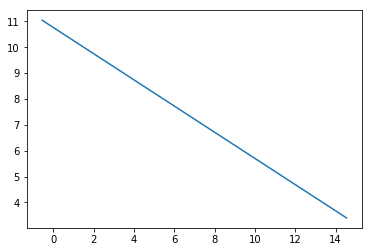

error value is [[0.33827479]]


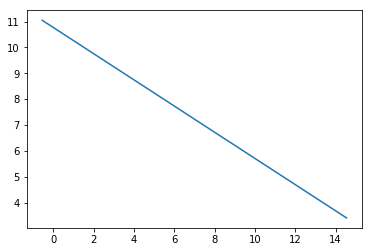

error value is [[0.33787306]]


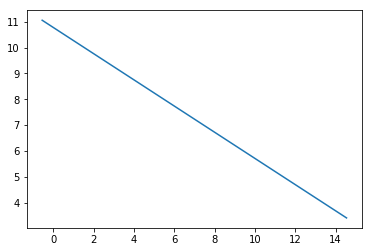

error value is [[0.33747245]]


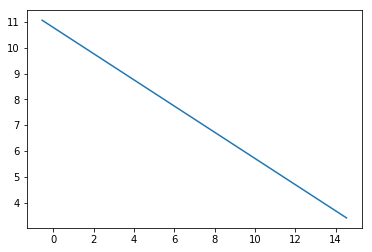

error value is [[0.33707298]]


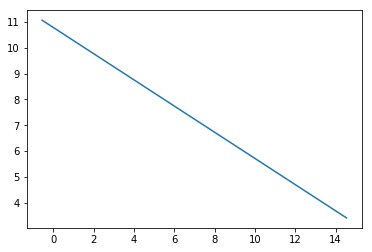

error value is [[0.33667464]]


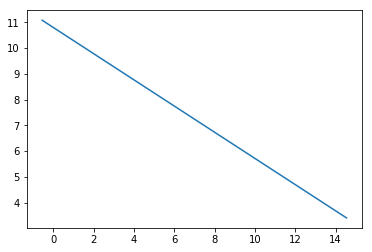

error value is [[0.33627741]]


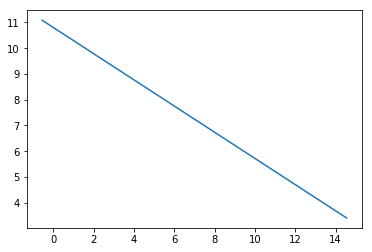

error value is [[0.33588131]]


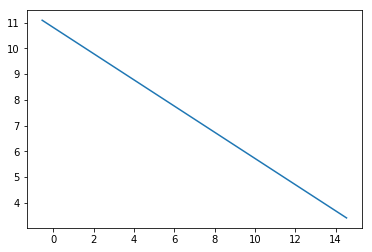

error value is [[0.33548631]]


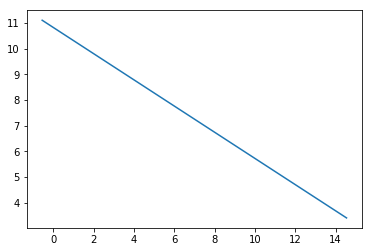

error value is [[0.33509242]]


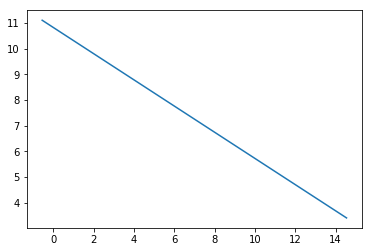

error value is [[0.33469964]]


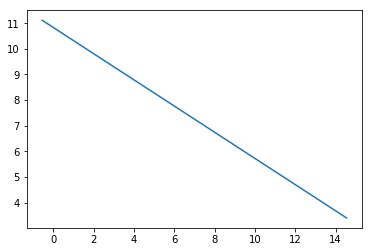

error value is [[0.33430796]]


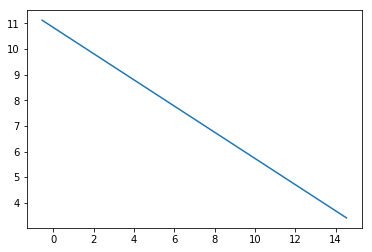

error value is [[0.33391737]]


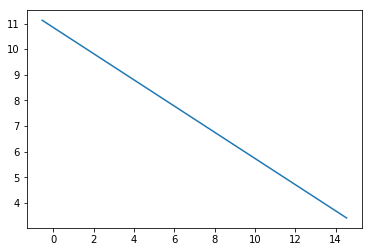

error value is [[0.33352787]]


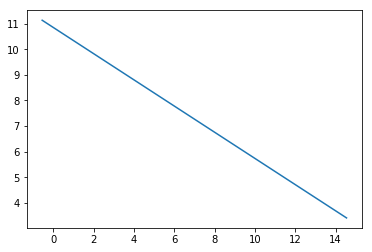

error value is [[0.33313945]]


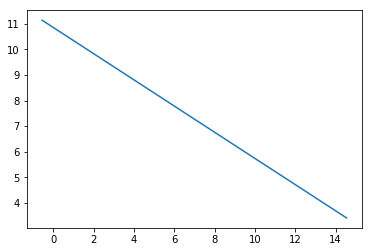

error value is [[0.33275212]]


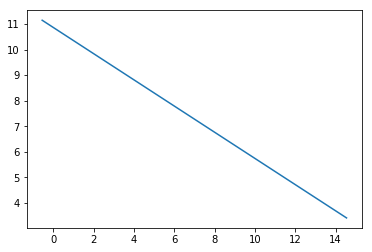

error value is [[0.33236587]]


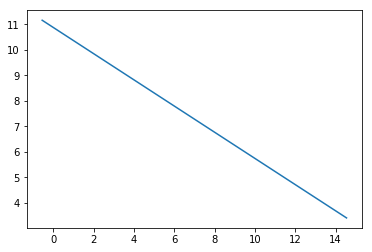

error value is [[0.33198069]]


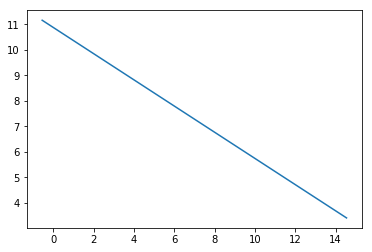

error value is [[0.33159658]]


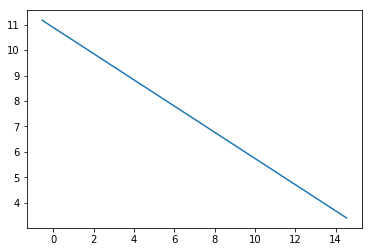

error value is [[0.33121353]]


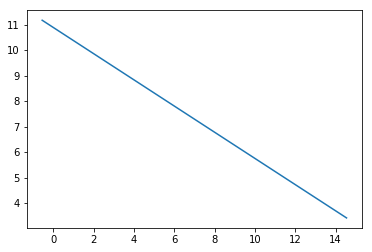

error value is [[0.33083154]]


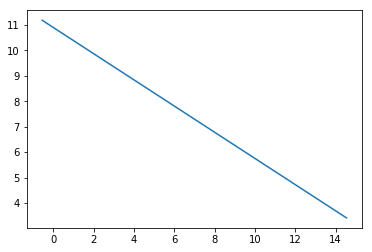

error value is [[0.33045061]]


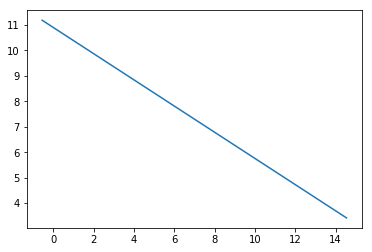

error value is [[0.33007074]]


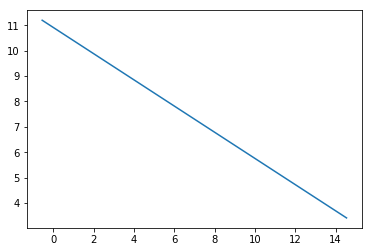

error value is [[0.32969191]]


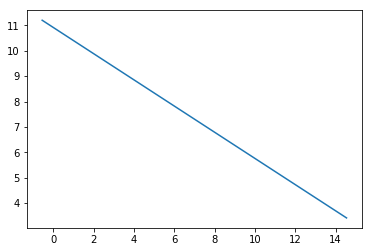

error value is [[0.32931412]]


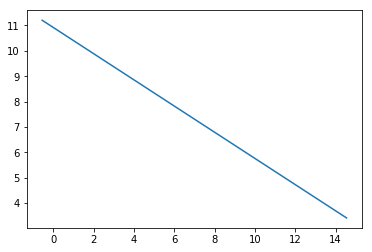

error value is [[0.32893738]]


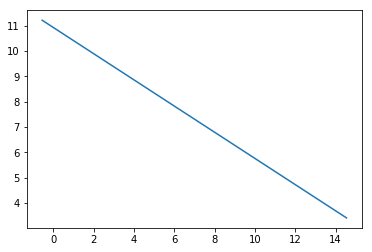

error value is [[0.32856167]]


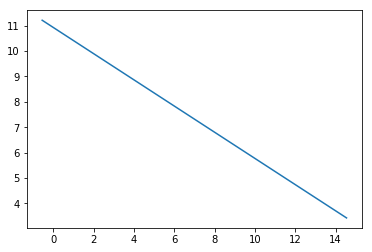

error value is [[0.32818699]]


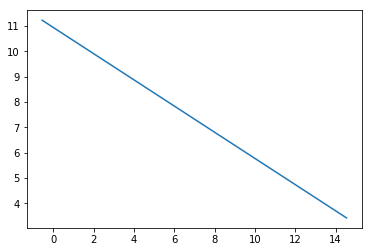

error value is [[0.32781334]]


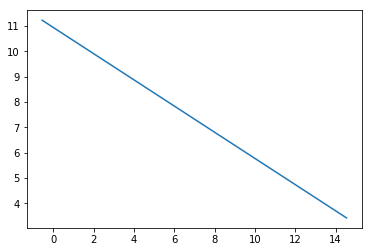

error value is [[0.32744071]]


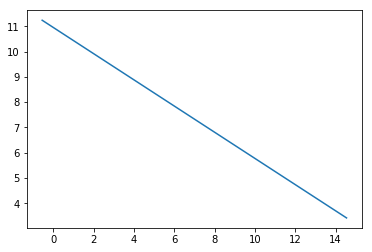

error value is [[0.32706911]]


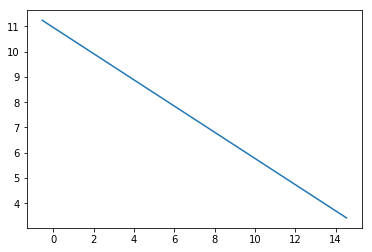

error value is [[0.32669852]]


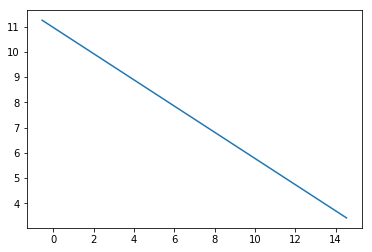

error value is [[0.32632894]]


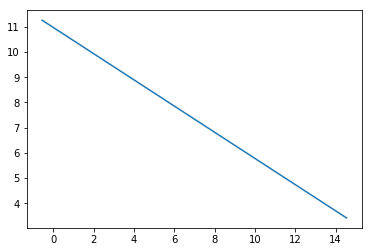

error value is [[0.32596037]]


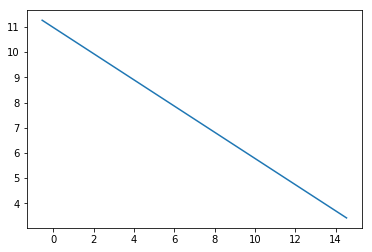

error value is [[0.3255928]]


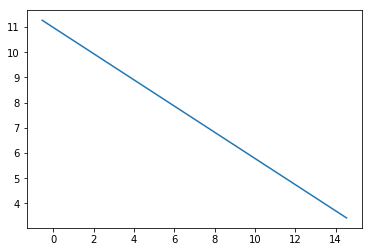

error value is [[0.32522623]]


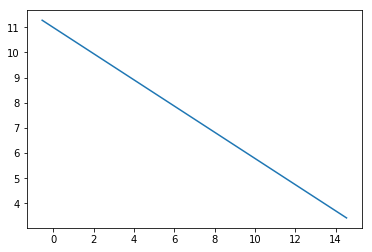

error value is [[0.32486066]]


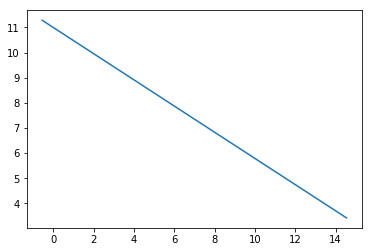

error value is [[0.32449608]]


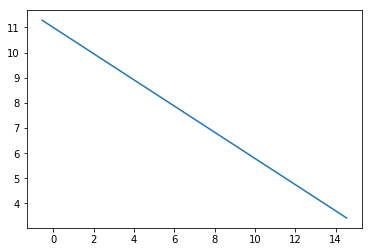

error value is [[0.32413249]]


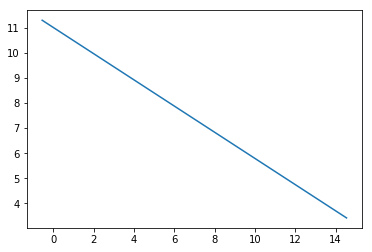

error value is [[0.32376989]]


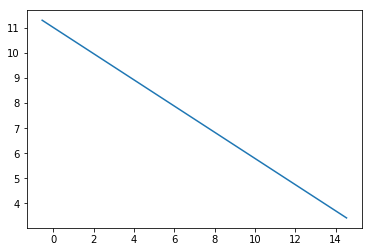

error value is [[0.32340826]]


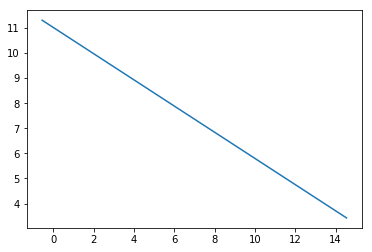

error value is [[0.32304761]]


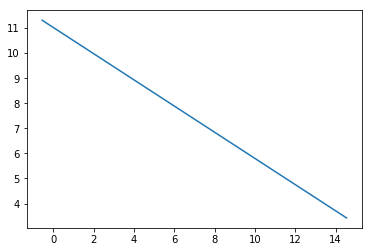

error value is [[0.32268794]]


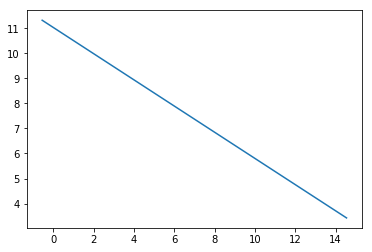

error value is [[0.32232923]]


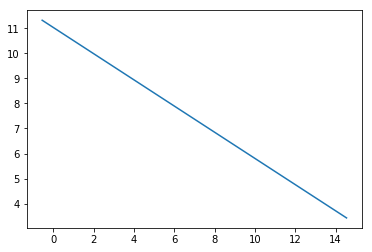

error value is [[0.32197149]]


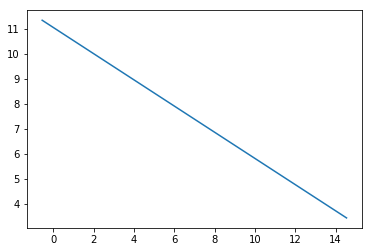

error value is [[0.32161472]]


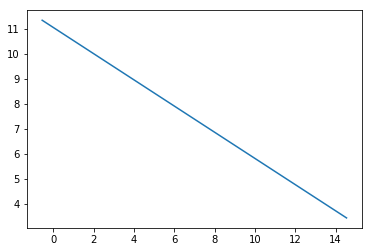

error value is [[0.3212589]]


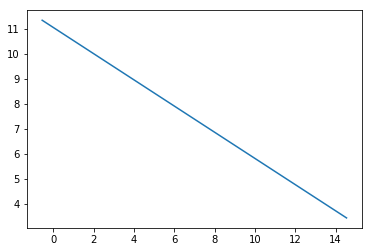

error value is [[0.32090403]]


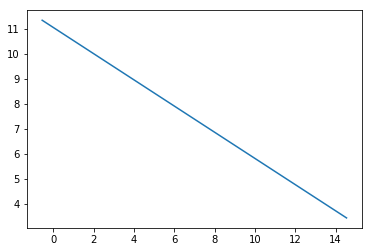

error value is [[0.32055012]]


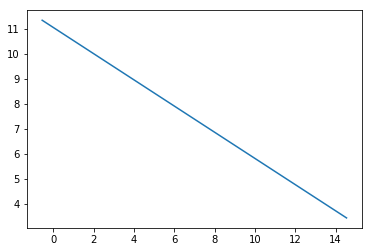

error value is [[0.32019715]]


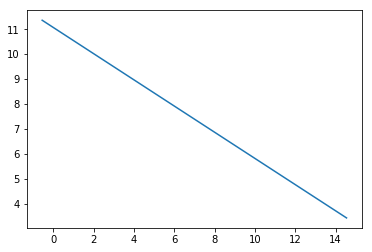

error value is [[0.31984513]]


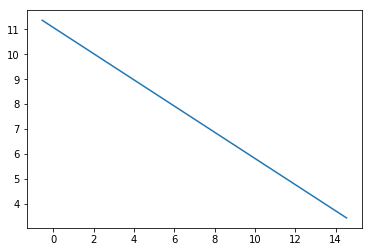

error value is [[0.31949404]]


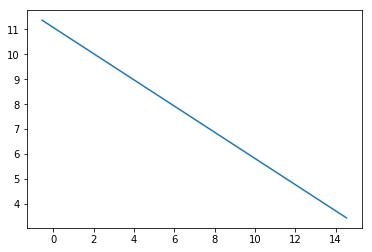

error value is [[0.3191439]]


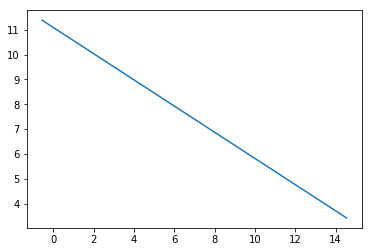

error value is [[0.31879468]]


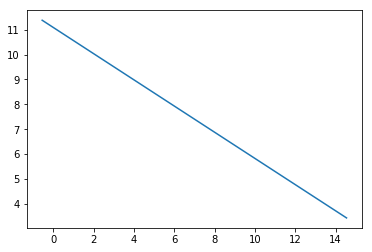

error value is [[0.3184464]]


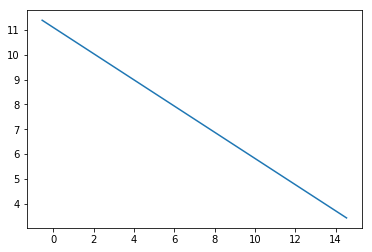

error value is [[0.31809904]]


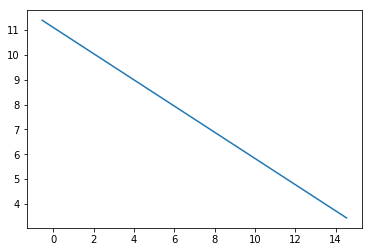

error value is [[0.3177526]]


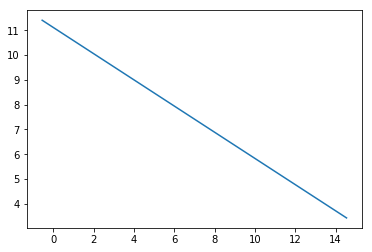

error value is [[0.31740708]]


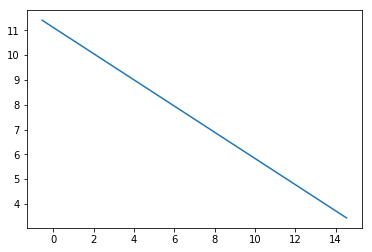

error value is [[0.31706248]]


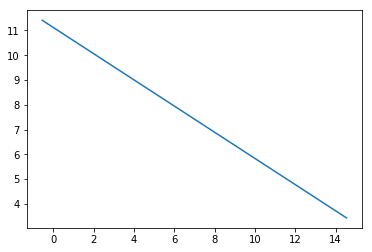

error value is [[0.31671879]]


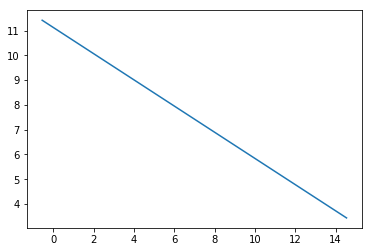

error value is [[0.31637601]]


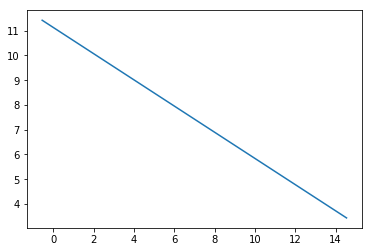

error value is [[0.31603413]]


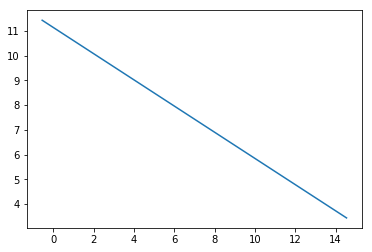

error value is [[0.31569315]]


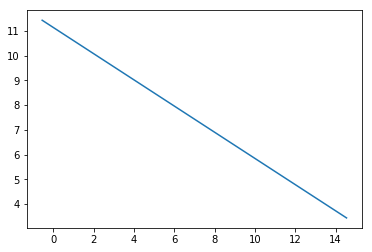

error value is [[0.31535307]]


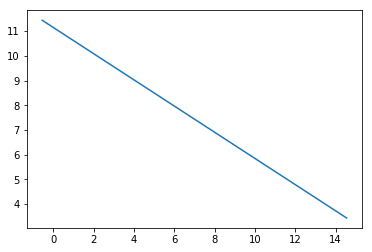

error value is [[0.31501388]]


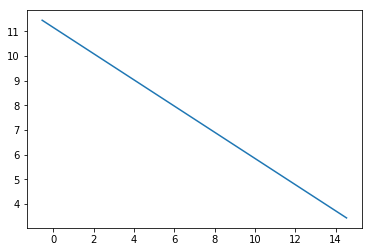

error value is [[0.31467559]]


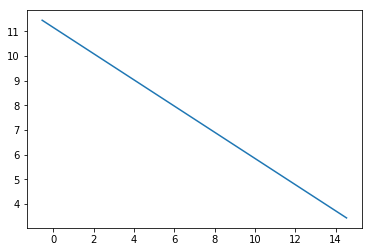

error value is [[0.31433818]]


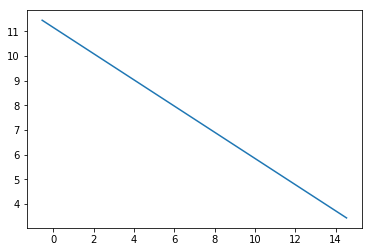

error value is [[0.31400166]]


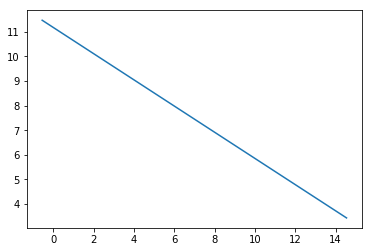

error value is [[0.31366602]]


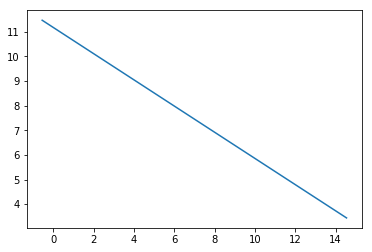

error value is [[0.31333126]]


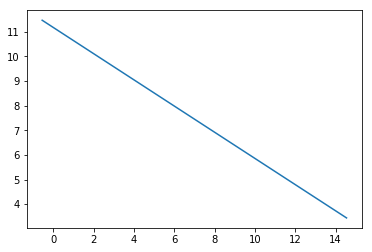

error value is [[0.31299737]]


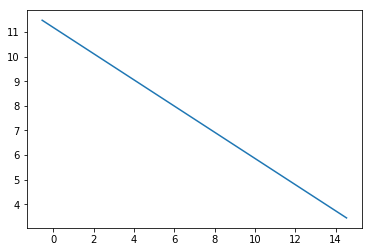

error value is [[0.31266435]]


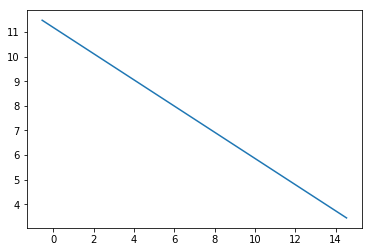

error value is [[0.3123322]]


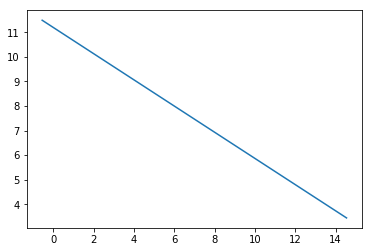

error value is [[0.31200092]]


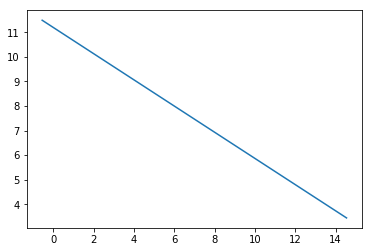

error value is [[0.31167049]]


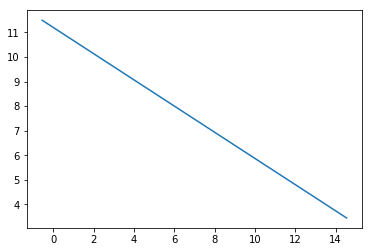

error value is [[0.31134093]]


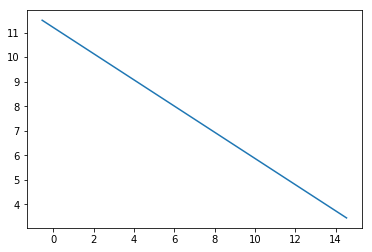

error value is [[0.31101221]]


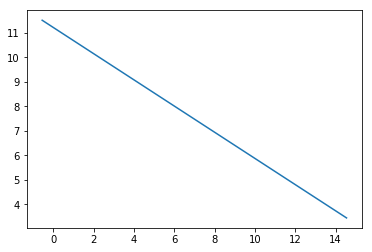

error value is [[0.31068435]]


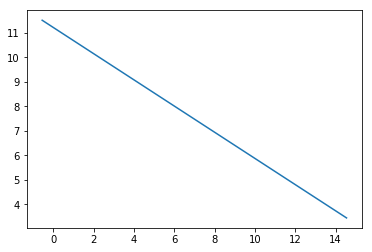

error value is [[0.31035734]]


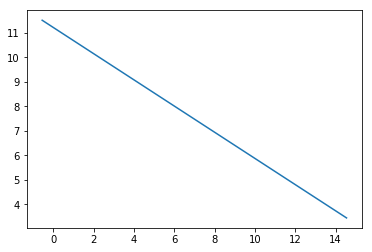

error value is [[0.31003118]]


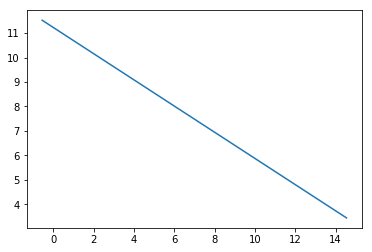

error value is [[0.30970585]]


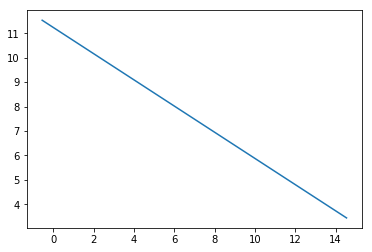

error value is [[0.30938137]]


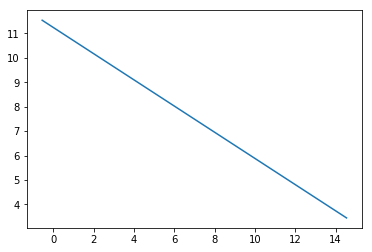

error value is [[0.30905772]]


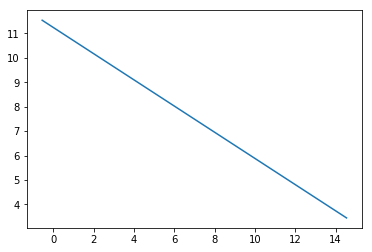

error value is [[0.30873491]]


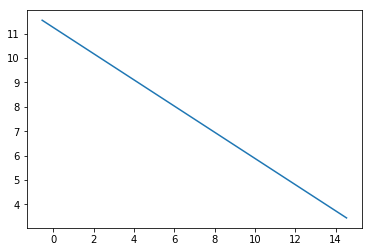

error value is [[0.30841292]]


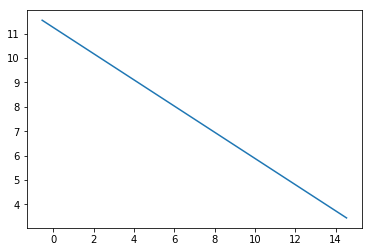

error value is [[0.30809176]]


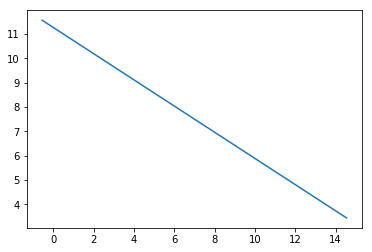

error value is [[0.30777142]]


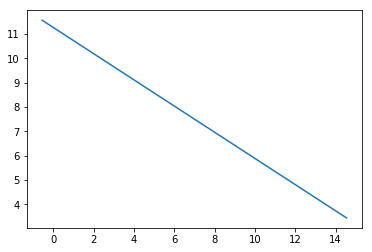

error value is [[0.30745191]]


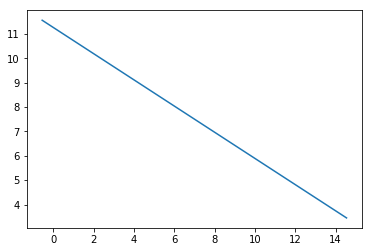

error value is [[0.30713321]]


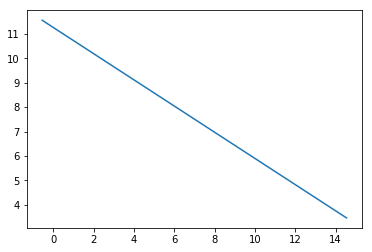

error value is [[0.30681532]]


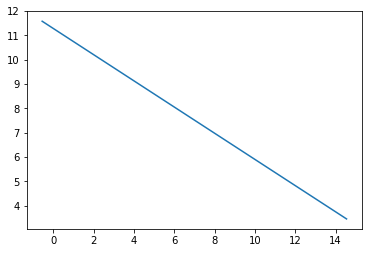

error value is [[0.30649825]]


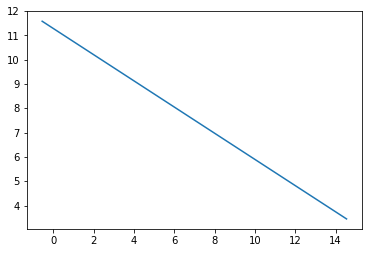

error value is [[0.30618199]]


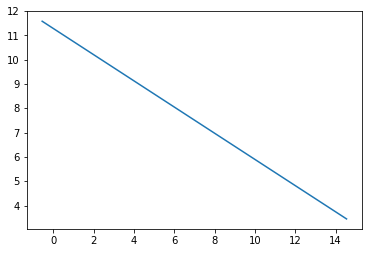

error value is [[0.30586653]]


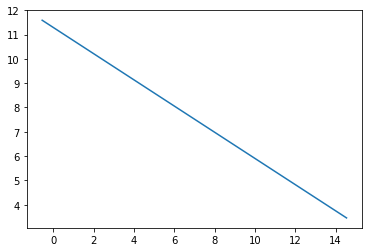

error value is [[0.30555187]]


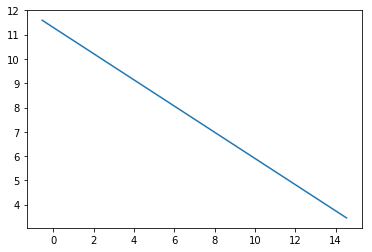

error value is [[0.30523802]]


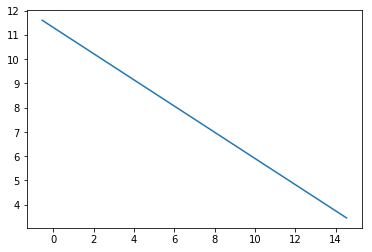

error value is [[0.30492496]]


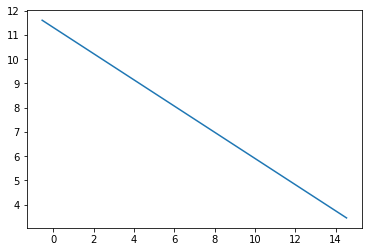

error value is [[0.30461269]]


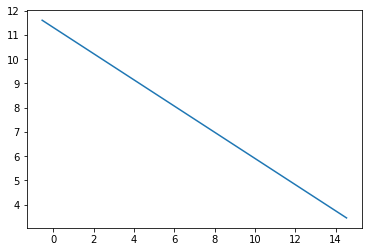

error value is [[0.30430121]]


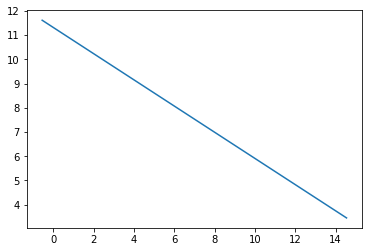

error value is [[0.30399052]]


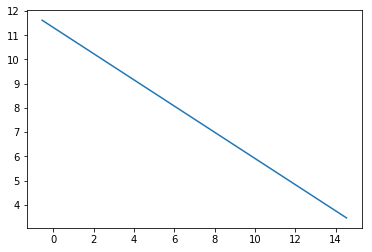

error value is [[0.30368062]]


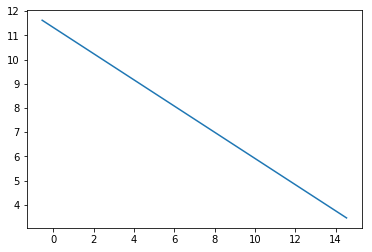

error value is [[0.3033715]]


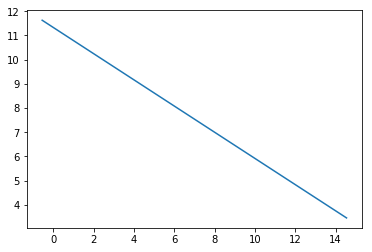

error value is [[0.30306316]]


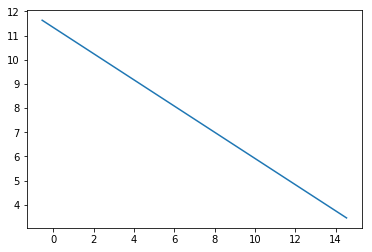

error value is [[0.30275559]]


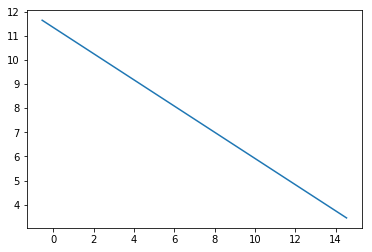

error value is [[0.3024488]]


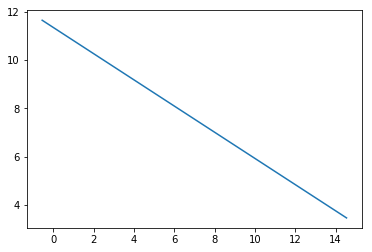

error value is [[0.30214278]]


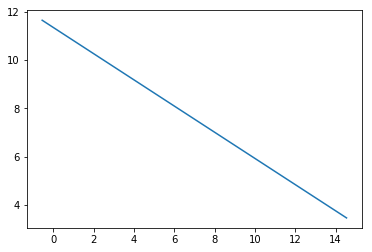

error value is [[0.30183752]]


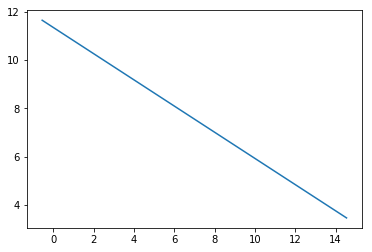

error value is [[0.30153303]]


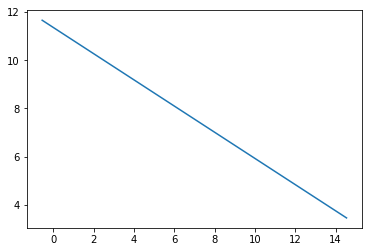

error value is [[0.30122931]]


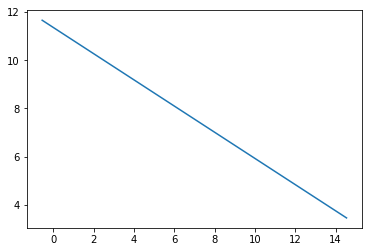

error value is [[0.30092634]]


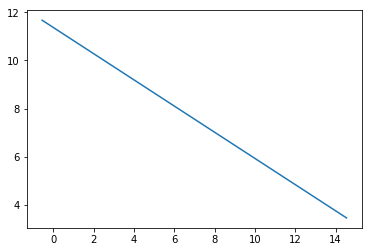

error value is [[0.30062413]]


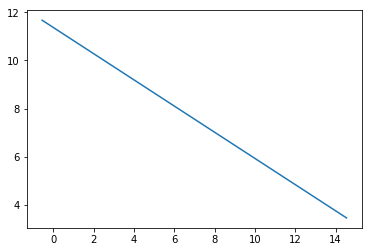

error value is [[0.30032267]]


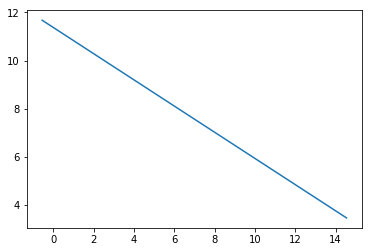

error value is [[0.30002196]]


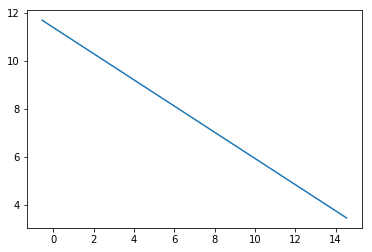

error value is [[0.29972201]]


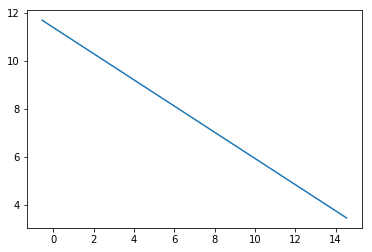

error value is [[0.2994228]]


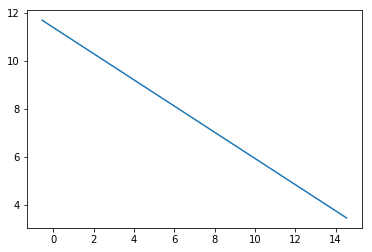

error value is [[0.29912433]]


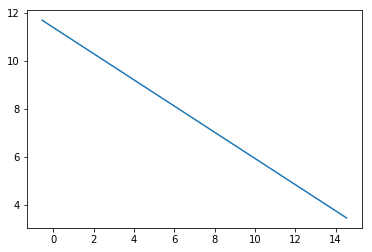

error value is [[0.2988266]]


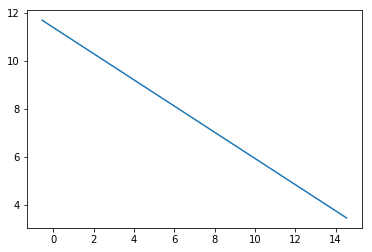

error value is [[0.29852961]]


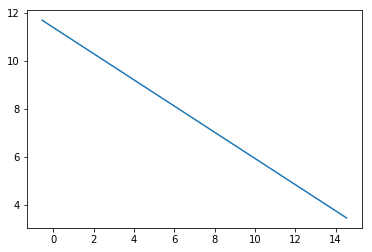

error value is [[0.29823335]]


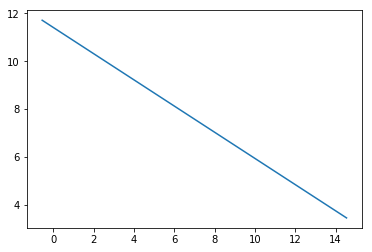

error value is [[0.29793783]]


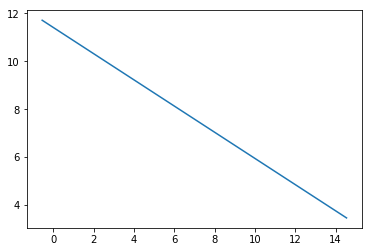

error value is [[0.29764304]]


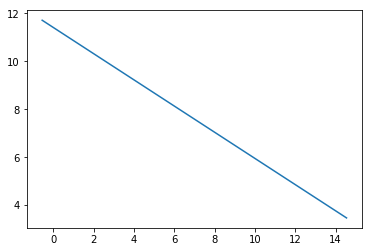

error value is [[0.29734897]]


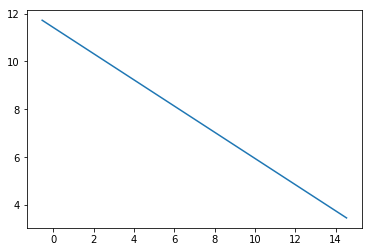

error value is [[0.29705563]]


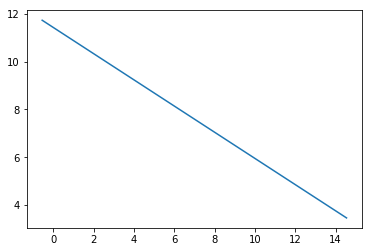

error value is [[0.29676301]]


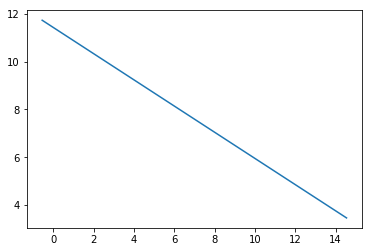

error value is [[0.29647111]]


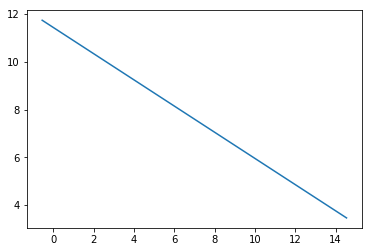

error value is [[0.29617993]]


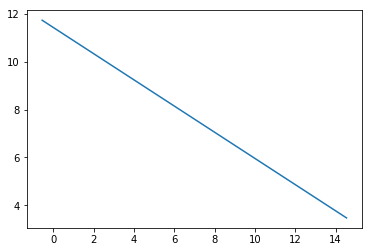

error value is [[0.29588946]]


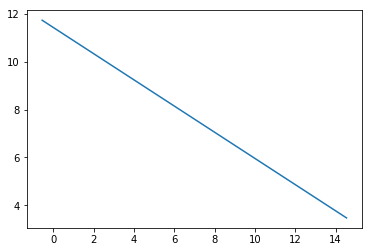

error value is [[0.2955997]]


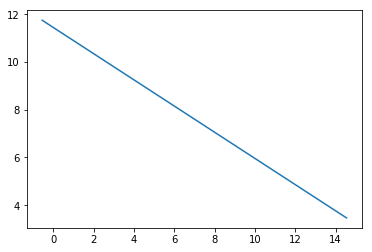

error value is [[0.29531065]]


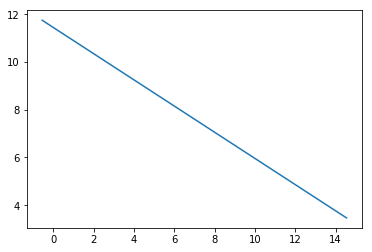

error value is [[0.29502231]]


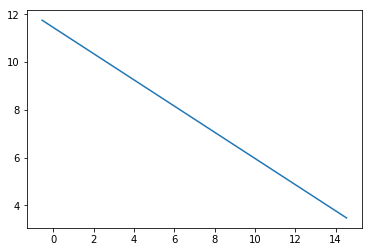

error value is [[0.29473467]]


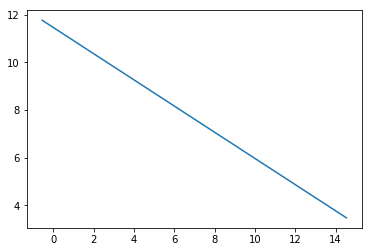

error value is [[0.29444774]]


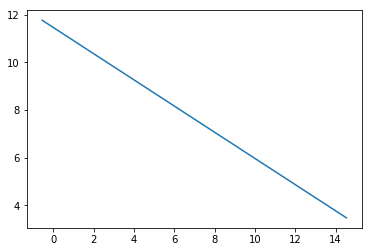

error value is [[0.2941615]]


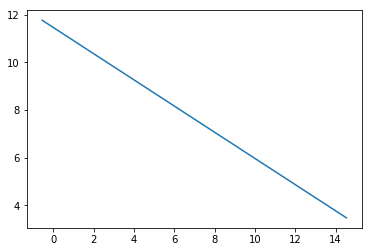

error value is [[0.29387596]]


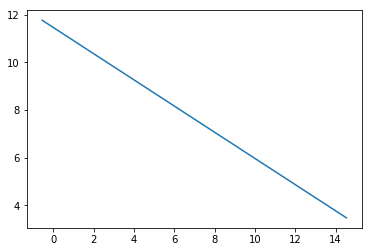

error value is [[0.29359111]]


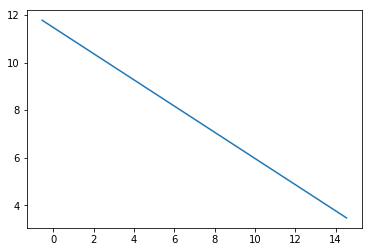

error value is [[0.29330696]]


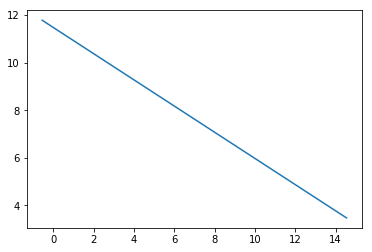

error value is [[0.29302349]]


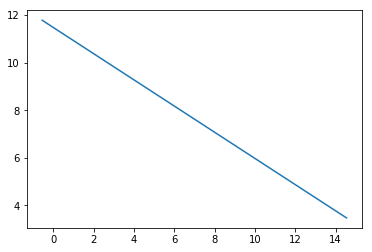

error value is [[0.29274071]]


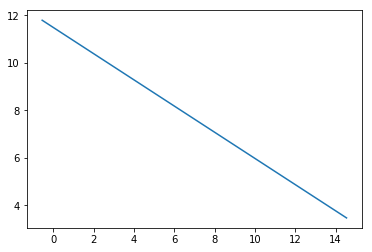

error value is [[0.29245862]]


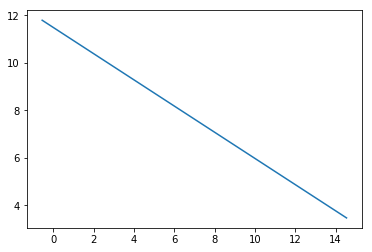

error value is [[0.29217721]]


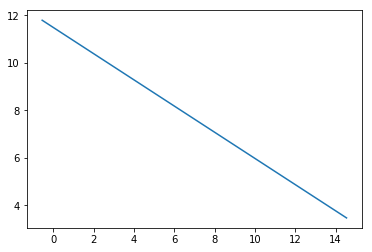

error value is [[0.29189647]]


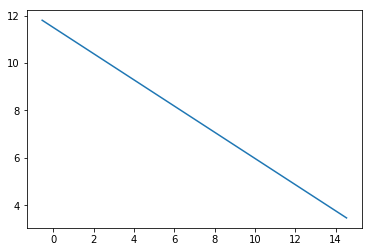

error value is [[0.29161642]]


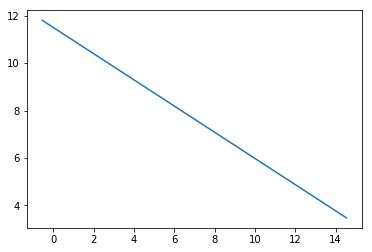

error value is [[0.29133703]]


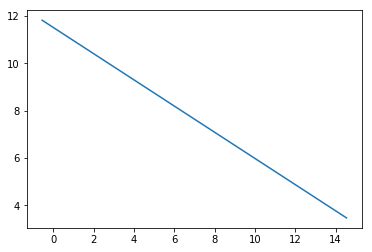

error value is [[0.29105832]]


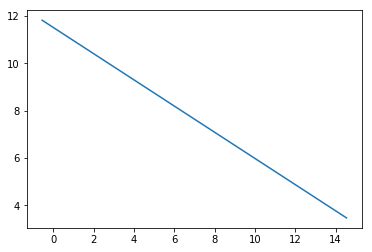

error value is [[0.29078028]]


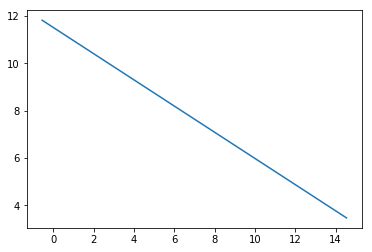

error value is [[0.29050291]]


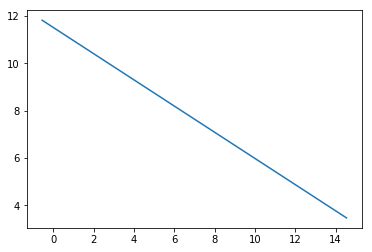

error value is [[0.29022621]]


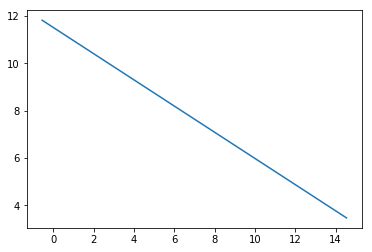

error value is [[0.28995016]]


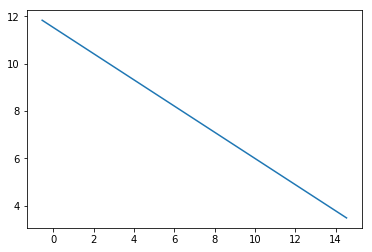

error value is [[0.28967478]]


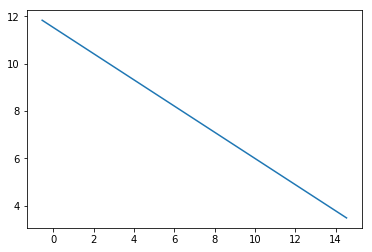

error value is [[0.28940005]]


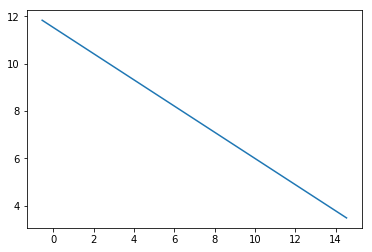

error value is [[0.28912598]]


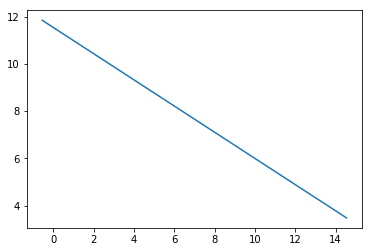

error value is [[0.28885257]]


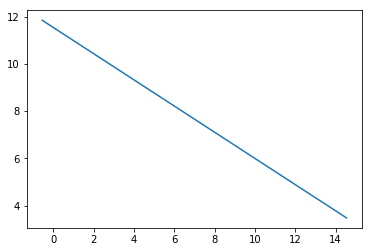

error value is [[0.2885798]]


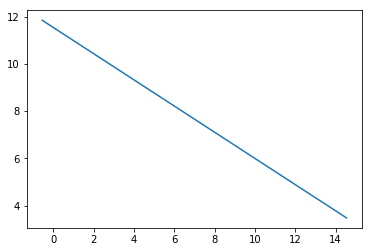

error value is [[0.28830769]]


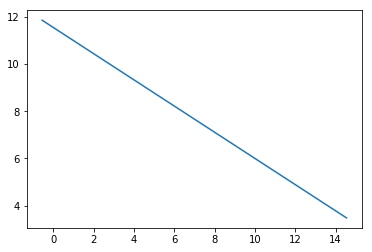

error value is [[0.28803622]]


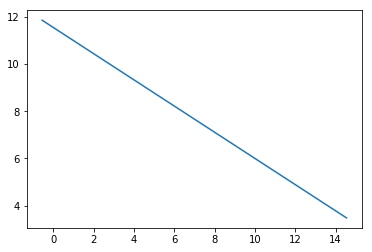

error value is [[0.2877654]]


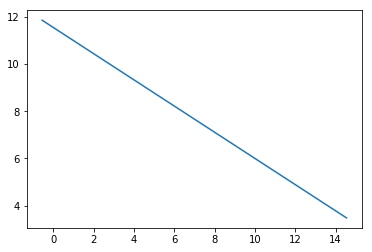

error value is [[0.28749521]]


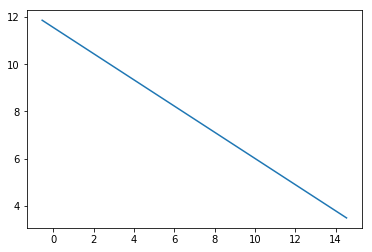

error value is [[0.28722567]]


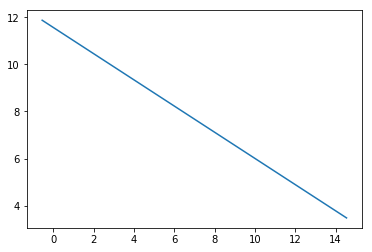

error value is [[0.28695677]]


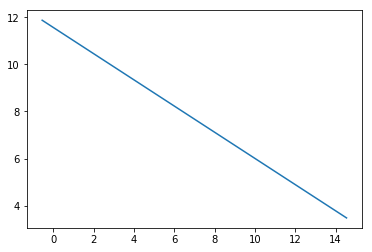

error value is [[0.2866885]]


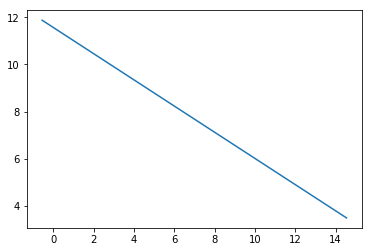

error value is [[0.28642087]]


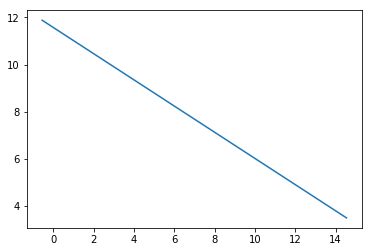

error value is [[0.28615386]]


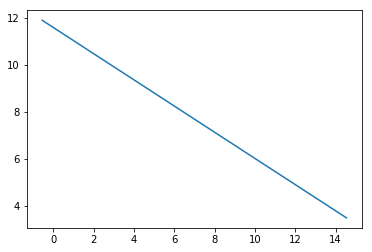

error value is [[0.28588749]]


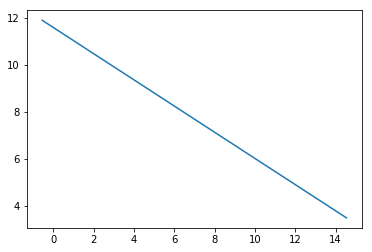

error value is [[0.28562174]]


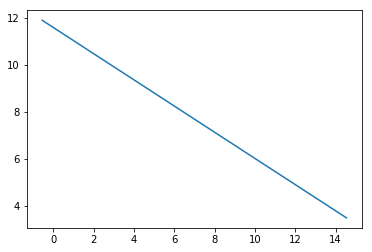

error value is [[0.28535662]]


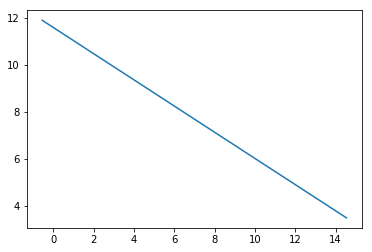

error value is [[0.28509212]]


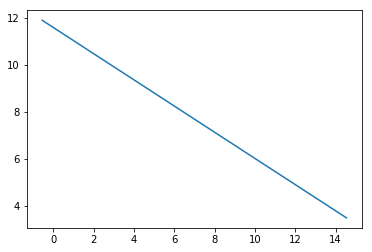

error value is [[0.28482824]]


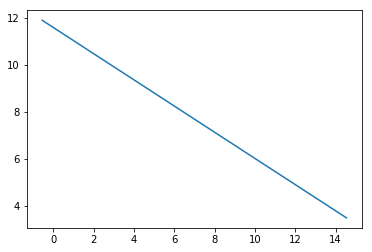

error value is [[0.28456498]]


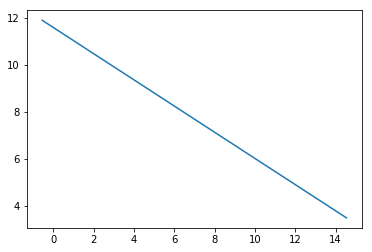

error value is [[0.28430233]]


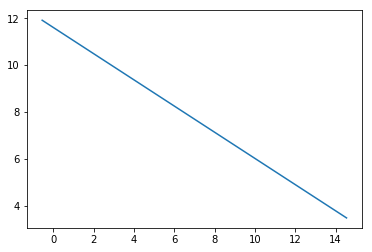

error value is [[0.2840403]]


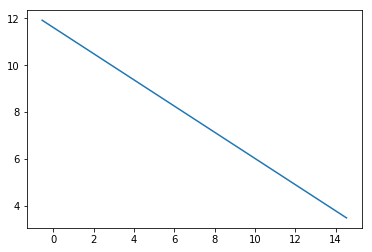

error value is [[0.28377888]]


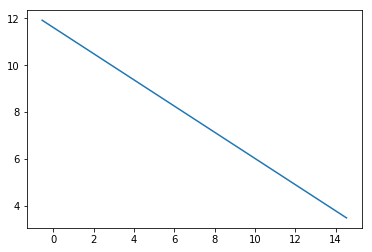

error value is [[0.28351807]]


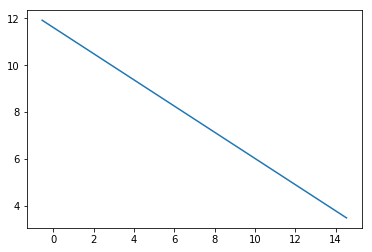

error value is [[0.28325787]]


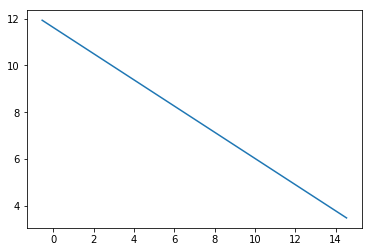

error value is [[0.28299828]]


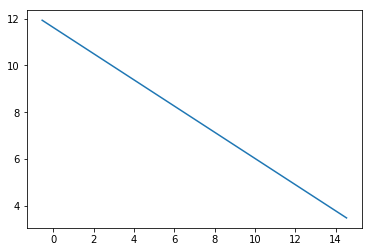

error value is [[0.28273928]]


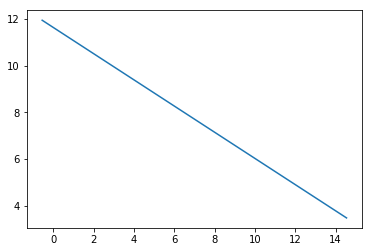

error value is [[0.28248089]]


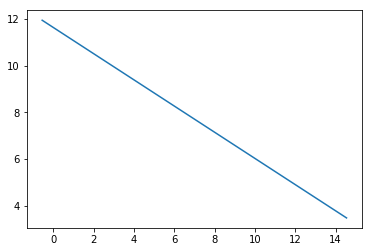

error value is [[0.2822231]]


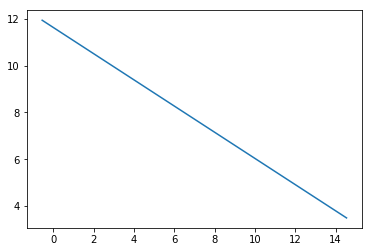

error value is [[0.28196591]]


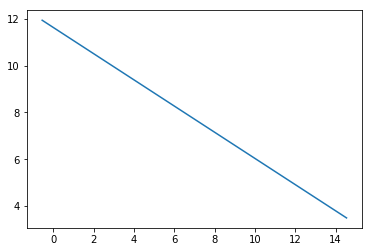

error value is [[0.28170931]]


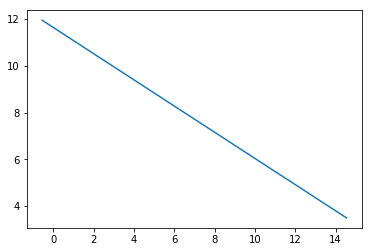

error value is [[0.2814533]]


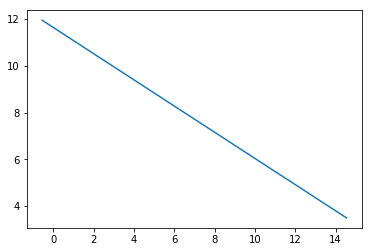

error value is [[0.28119789]]


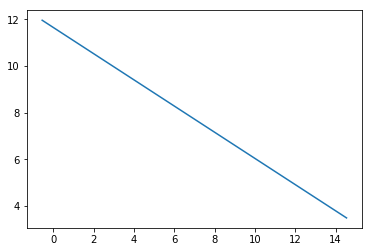

error value is [[0.28094307]]


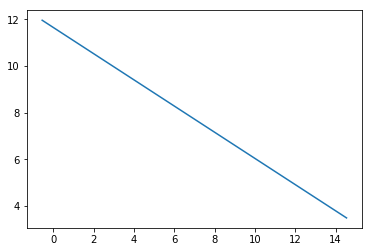

error value is [[0.28068883]]


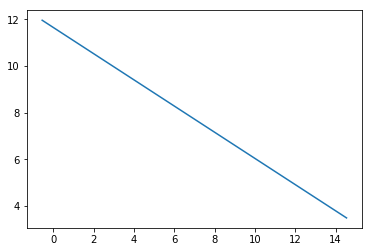

error value is [[0.28043518]]


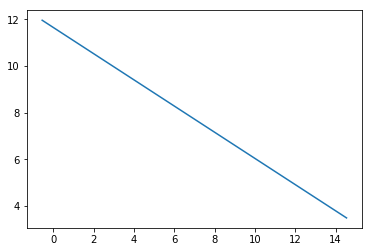

error value is [[0.28018211]]


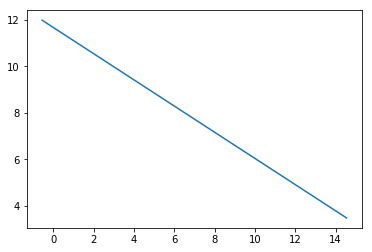

error value is [[0.27992962]]


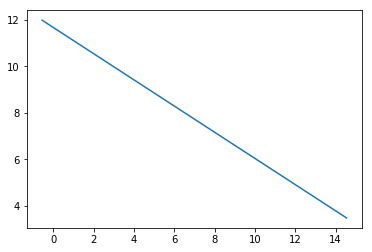

error value is [[0.27967771]]


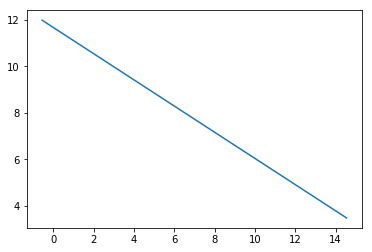

error value is [[0.27942638]]


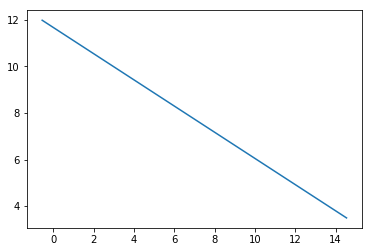

error value is [[0.27917563]]


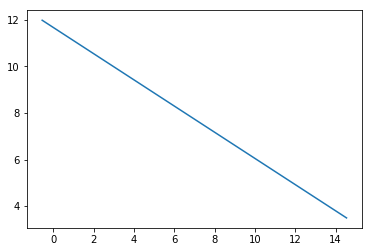

error value is [[0.27892544]]


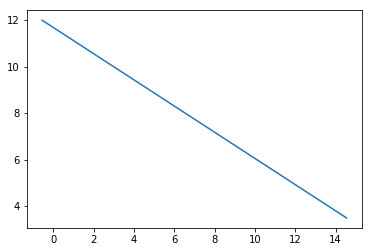

error value is [[0.27867583]]


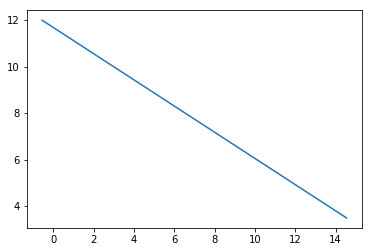

error value is [[0.27842679]]


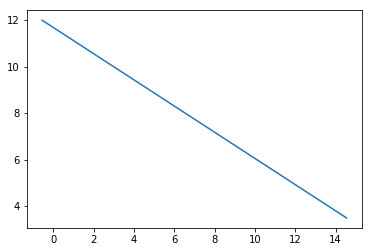

error value is [[0.27817832]]


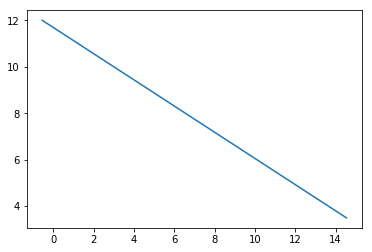

error value is [[0.27793041]]


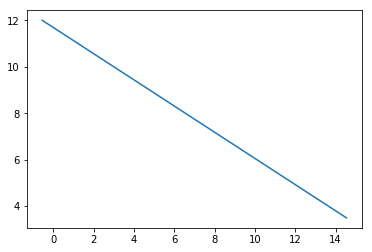

error value is [[0.27768307]]


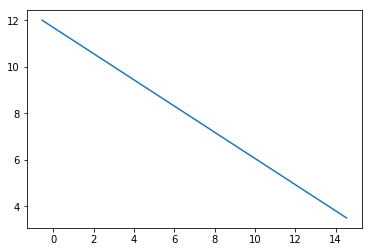

error value is [[0.27743629]]


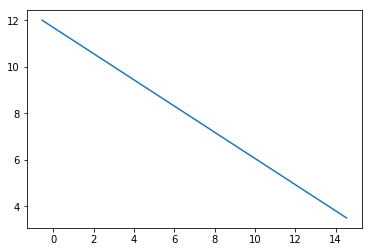

error value is [[0.27719007]]


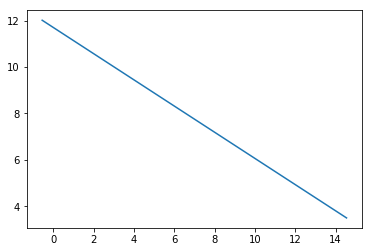

error value is [[0.27694441]]


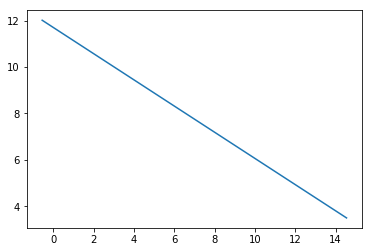

error value is [[0.2766993]]


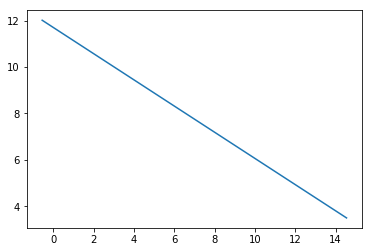

error value is [[0.27645475]]


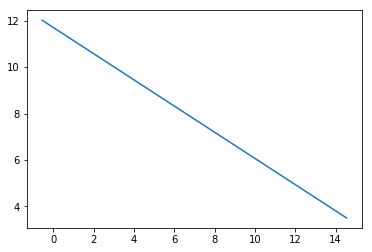

error value is [[0.27621075]]


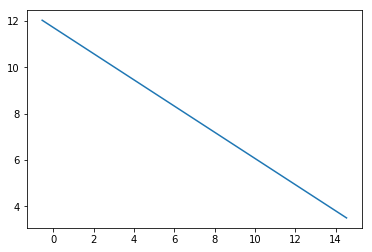

error value is [[0.2759673]]


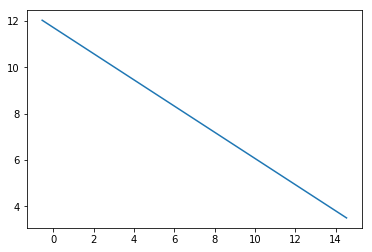

error value is [[0.2757244]]


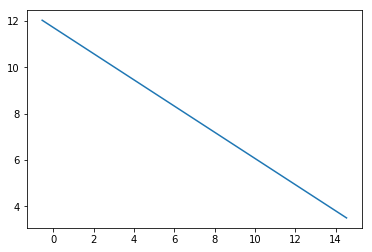

error value is [[0.27548205]]


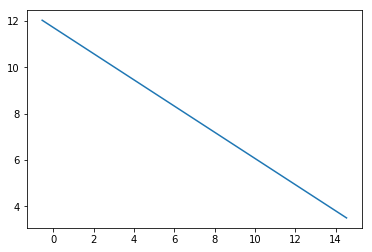

error value is [[0.27524025]]


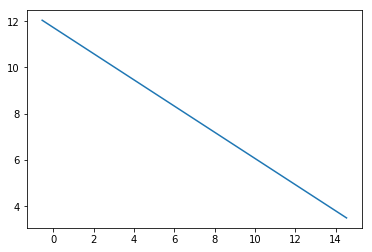

error value is [[0.27499898]]


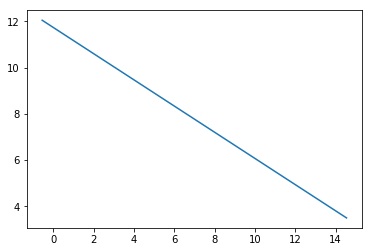

error value is [[0.27475826]]


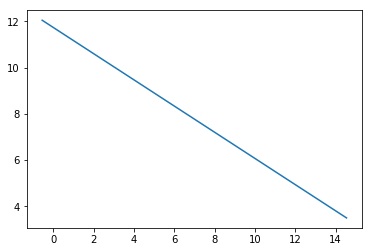

error value is [[0.27451808]]


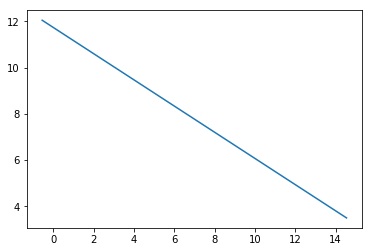

error value is [[0.27427844]]


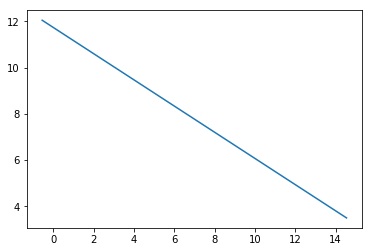

error value is [[0.27403933]]


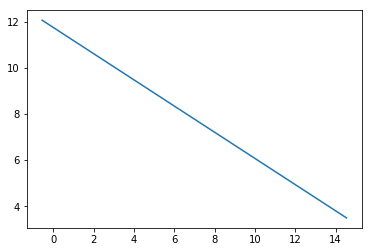

error value is [[0.27380076]]


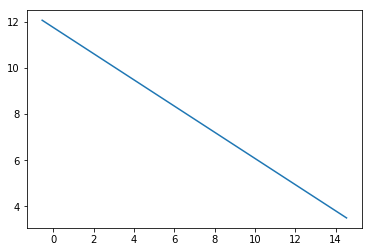

error value is [[0.27356272]]


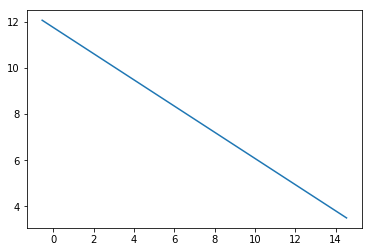

error value is [[0.27332521]]


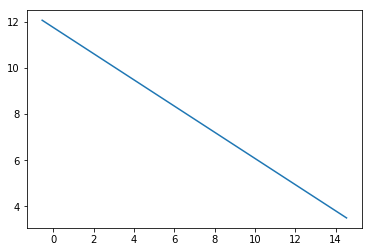

error value is [[0.27308824]]


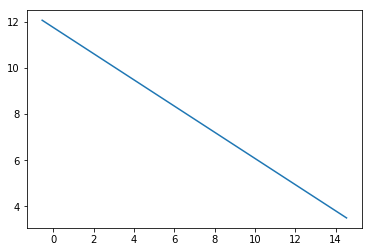

error value is [[0.27285179]]


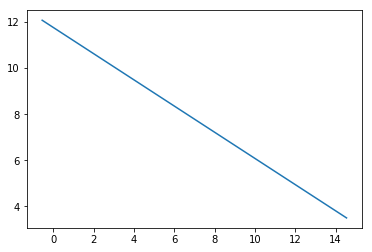

error value is [[0.27261586]]


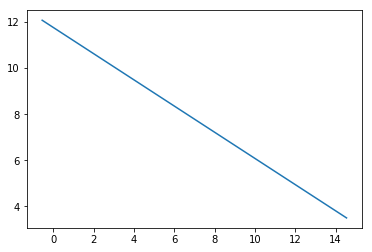

error value is [[0.27238046]]


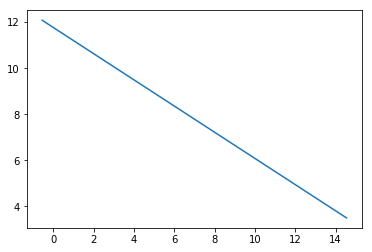

error value is [[0.27214558]]


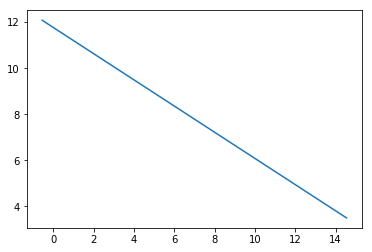

error value is [[0.27191122]]


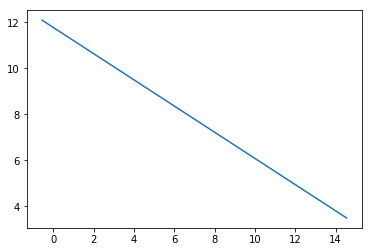

error value is [[0.27167738]]


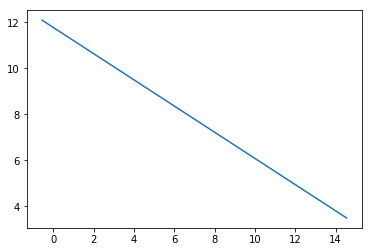

error value is [[0.27144406]]


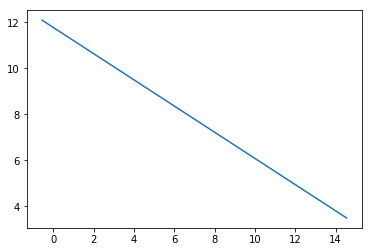

error value is [[0.27121126]]


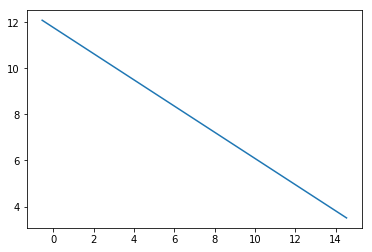

error value is [[0.27097896]]


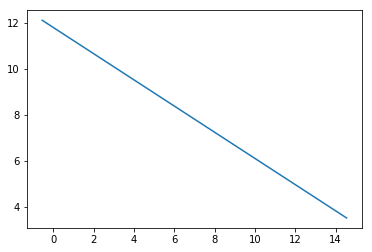

error value is [[0.27074718]]


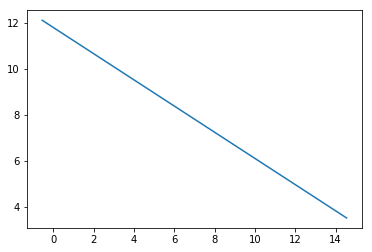

error value is [[0.27051591]]


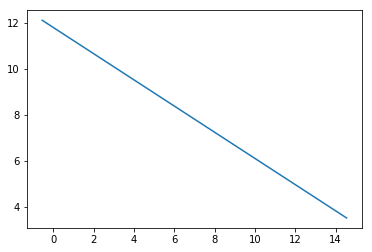

error value is [[0.27028515]]


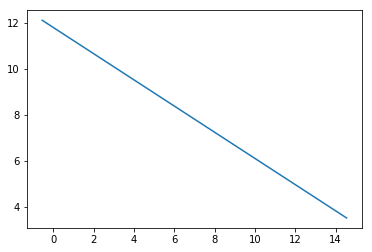

error value is [[0.2700549]]


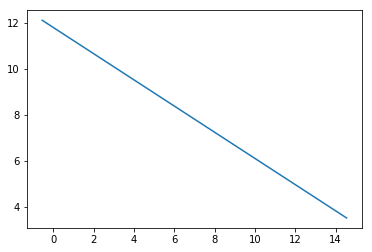

error value is [[0.26982515]]


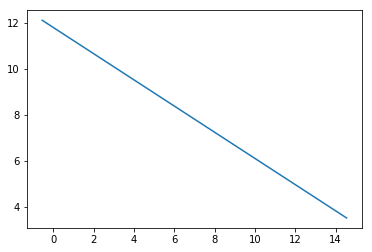

error value is [[0.26959591]]


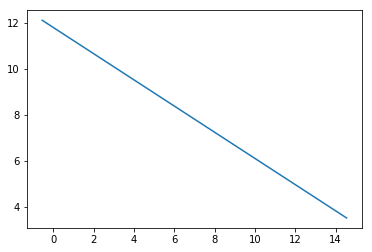

error value is [[0.26936716]]


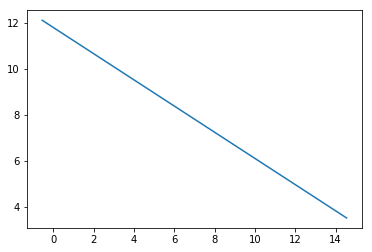

error value is [[0.26913892]]


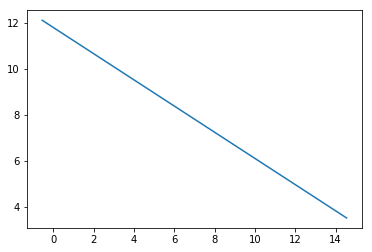

error value is [[0.26891118]]


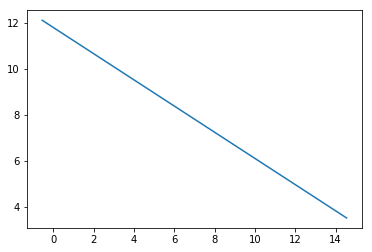

error value is [[0.26868394]]


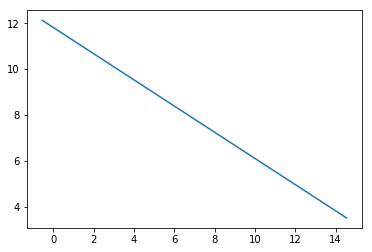

error value is [[0.26845719]]


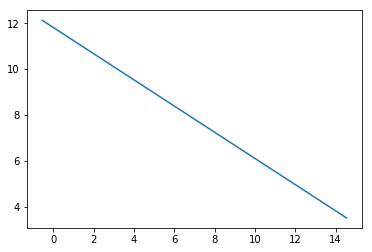

error value is [[0.26823093]]


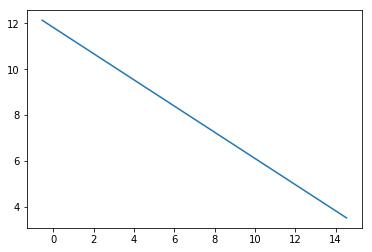

error value is [[0.26800517]]


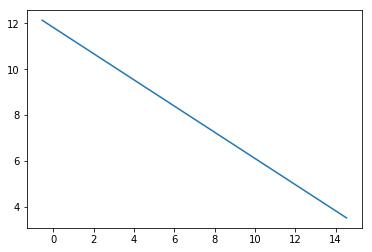

error value is [[0.2677799]]


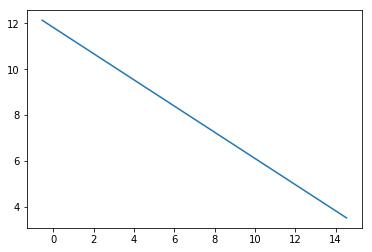

error value is [[0.26755512]]


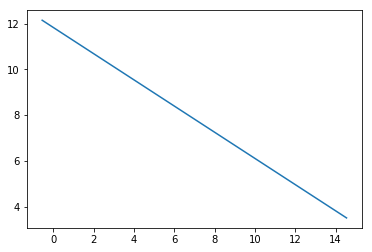

error value is [[0.26733082]]


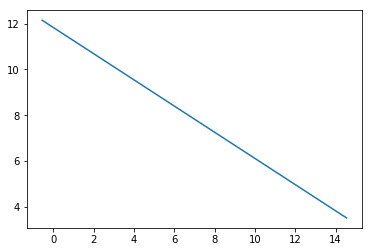

error value is [[0.26710701]]


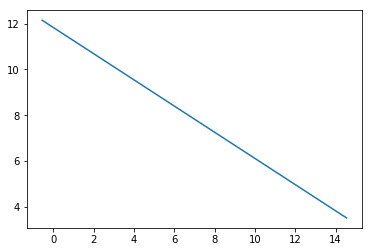

error value is [[0.26688369]]


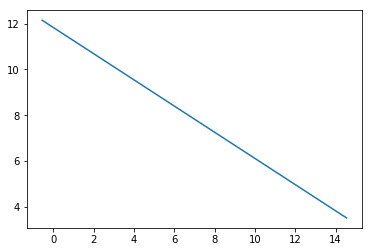

error value is [[0.26666085]]


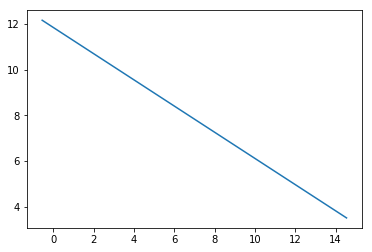

error value is [[0.26643849]]


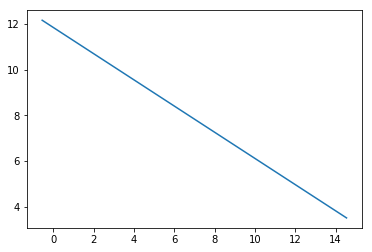

error value is [[0.26621661]]


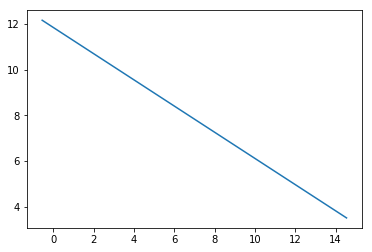

error value is [[0.26599521]]


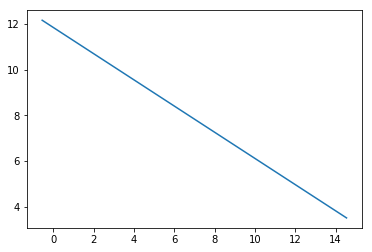

error value is [[0.26577429]]


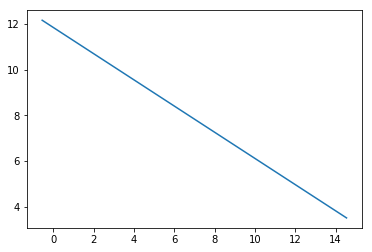

error value is [[0.26555384]]


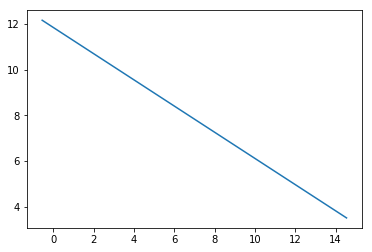

error value is [[0.26533387]]


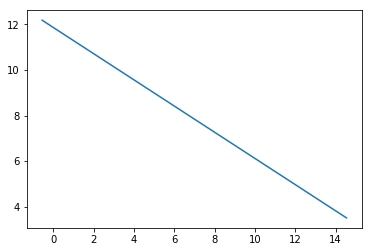

error value is [[0.26511437]]


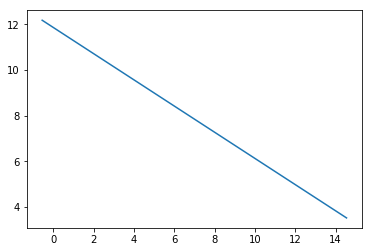

error value is [[0.26489534]]


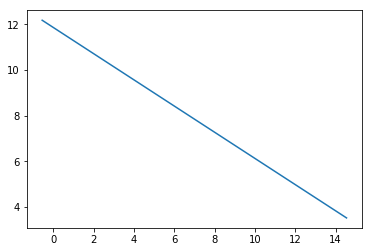

error value is [[0.26467677]]


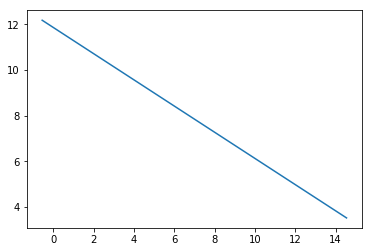

error value is [[0.26445868]]


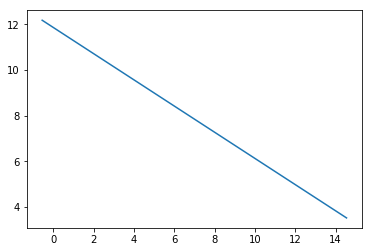

error value is [[0.26424105]]


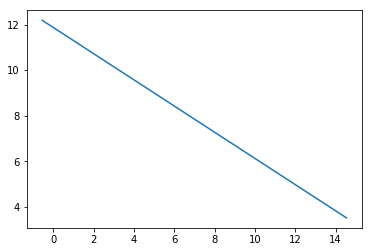

error value is [[0.26402389]]


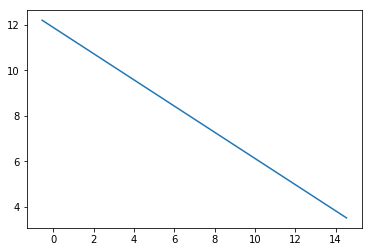

error value is [[0.26380719]]


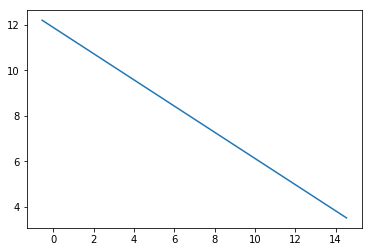

error value is [[0.26359096]]


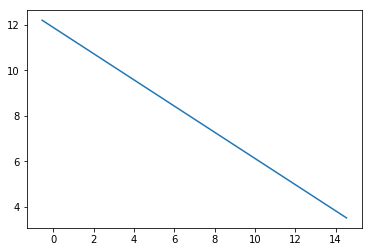

error value is [[0.26337518]]


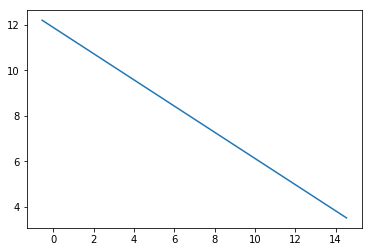

error value is [[0.26315986]]


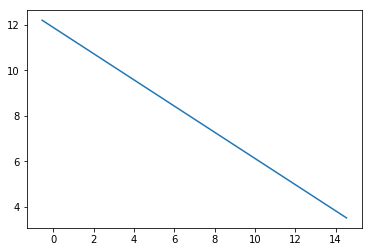

error value is [[0.262945]]


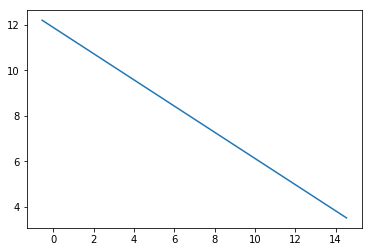

error value is [[0.2627306]]


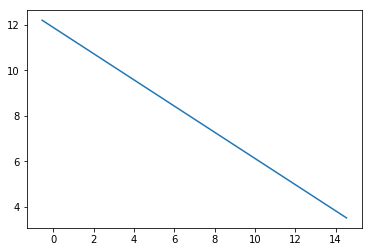

error value is [[0.26251665]]


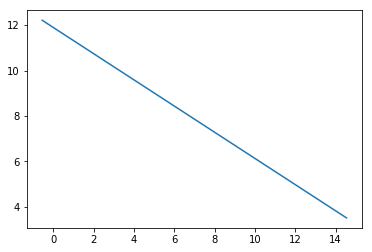

error value is [[0.26230316]]


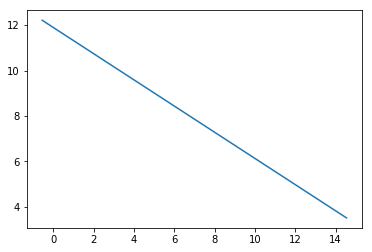

error value is [[0.26209011]]


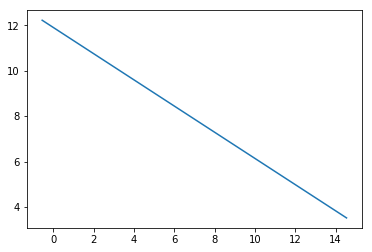

error value is [[0.26187752]]


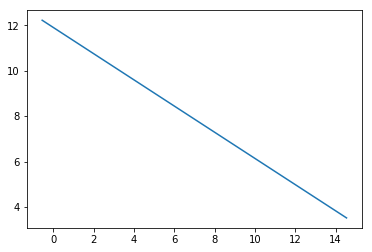

error value is [[0.26166537]]


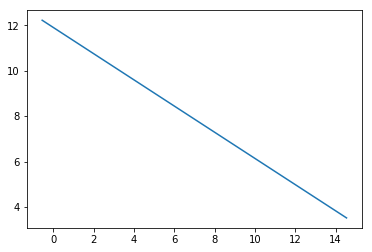

error value is [[0.26145368]]


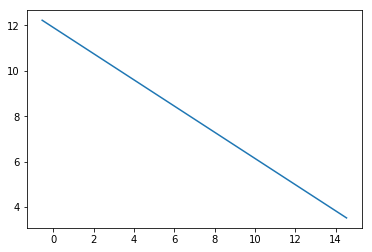

error value is [[0.26124243]]


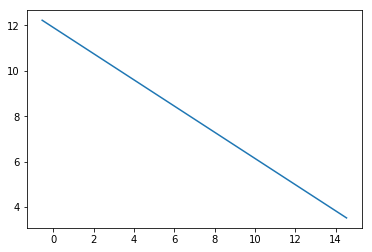

error value is [[0.26103162]]


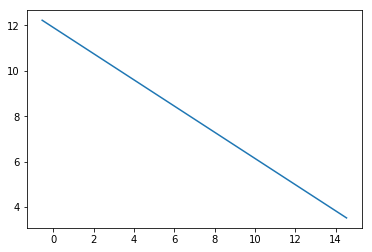

error value is [[0.26082126]]


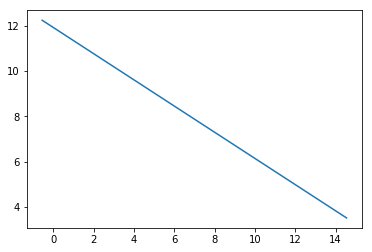

error value is [[0.26061134]]


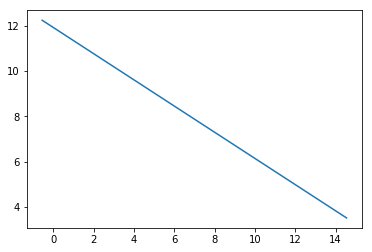

error value is [[0.26040186]]


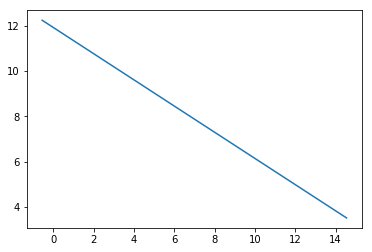

error value is [[0.26019282]]


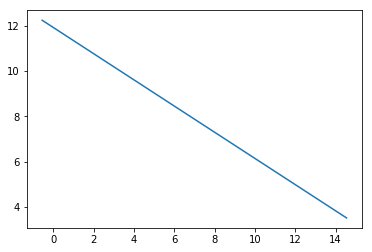

error value is [[0.25998422]]


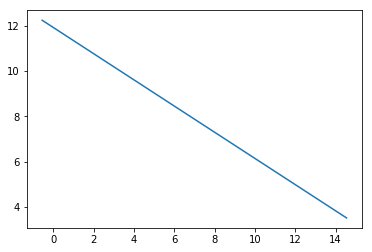

error value is [[0.25977605]]


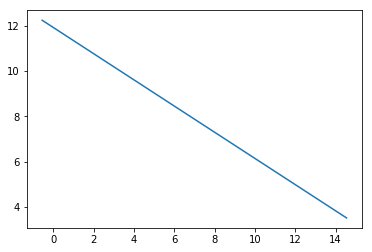

error value is [[0.25956832]]


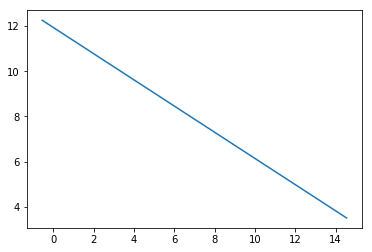

error value is [[0.25936102]]


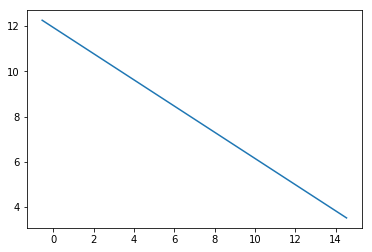

error value is [[0.25915415]]


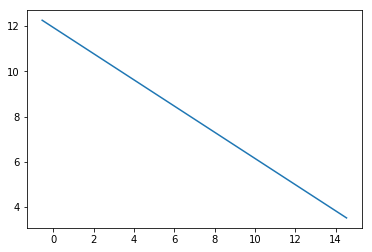

error value is [[0.25894772]]


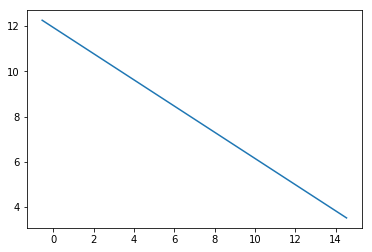

error value is [[0.25874172]]


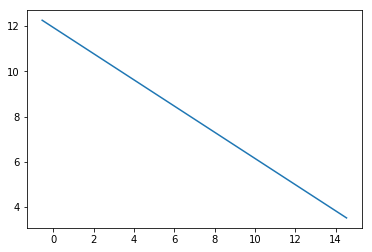

error value is [[0.25853614]]


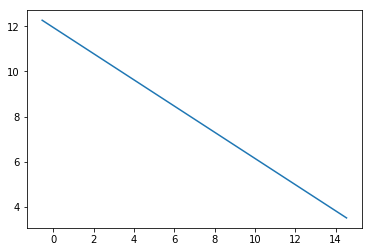

error value is [[0.25833099]]


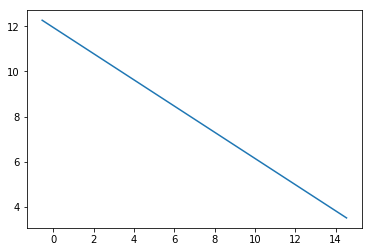

error value is [[0.25812627]]


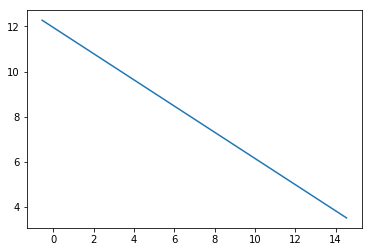

error value is [[0.25792197]]


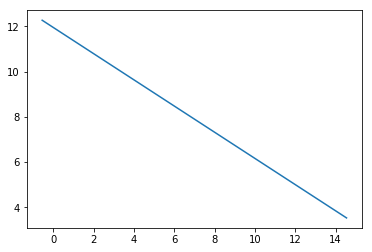

error value is [[0.25771809]]


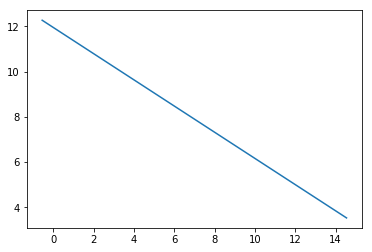

error value is [[0.25751464]]


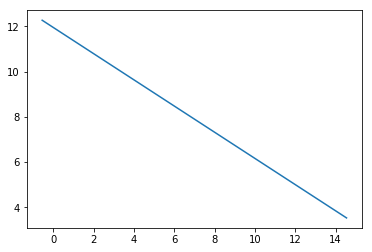

error value is [[0.25731161]]


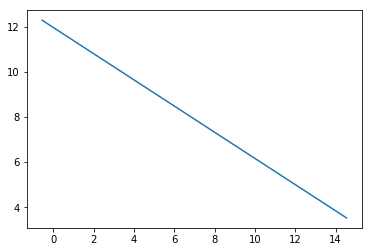

error value is [[0.25710899]]


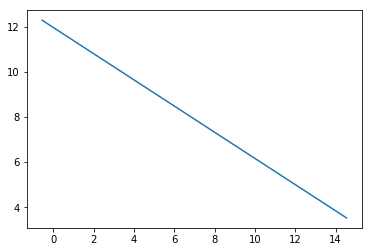

error value is [[0.2569068]]


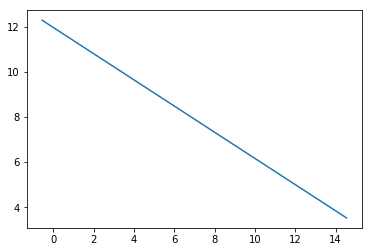

error value is [[0.25670502]]


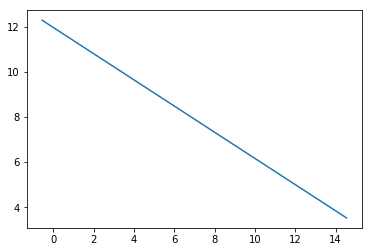

error value is [[0.25650365]]


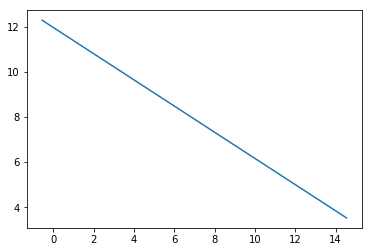

error value is [[0.2563027]]


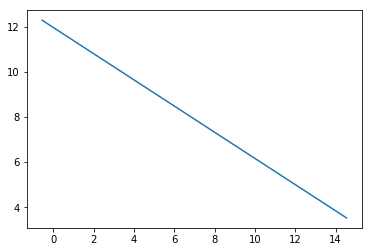

error value is [[0.25610216]]


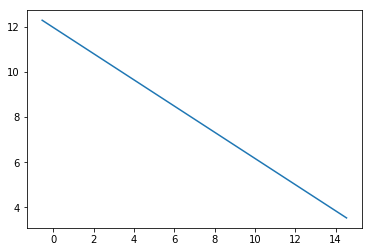

error value is [[0.25590204]]


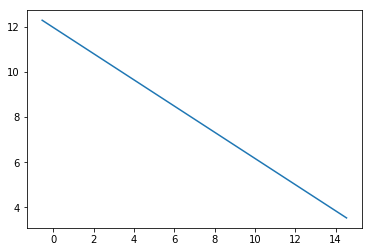

error value is [[0.25570232]]


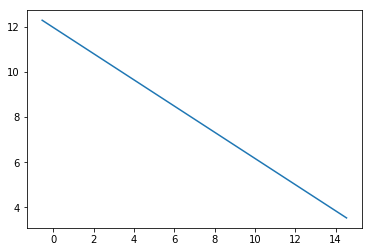

error value is [[0.25550301]]


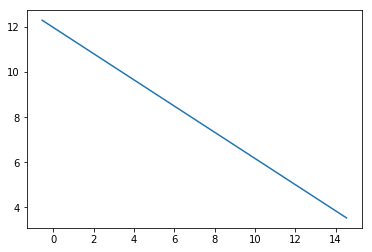

error value is [[0.25530411]]


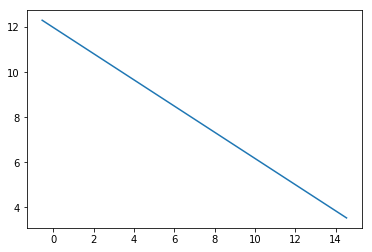

error value is [[0.25510562]]


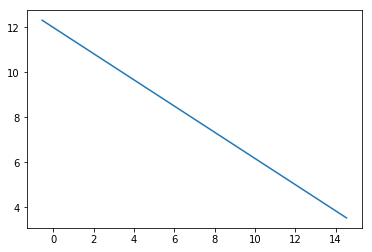

error value is [[0.25490753]]


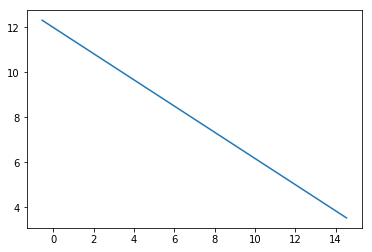

error value is [[0.25470985]]


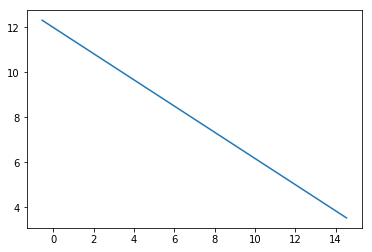

error value is [[0.25451257]]


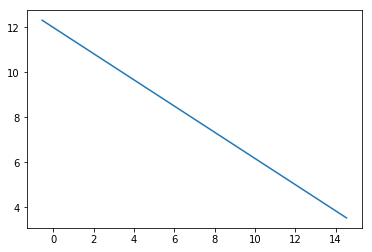

error value is [[0.25431569]]


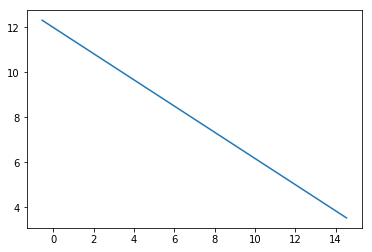

error value is [[0.25411921]]


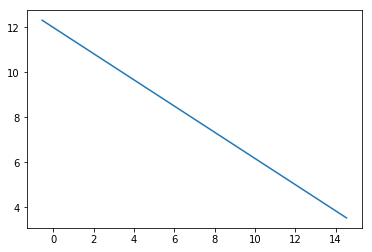

error value is [[0.25392313]]


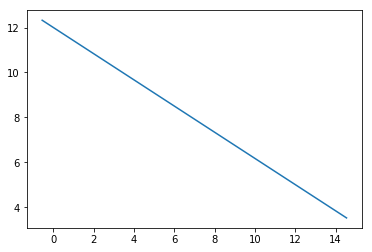

error value is [[0.25372745]]


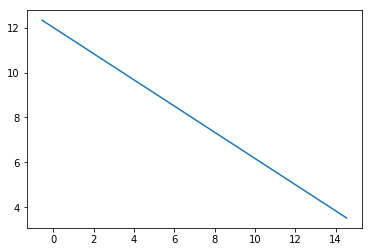

error value is [[0.25353217]]


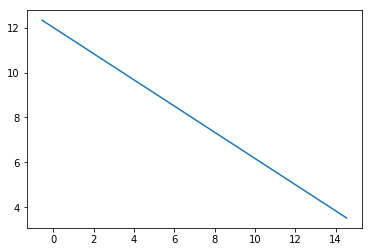

error value is [[0.25333728]]


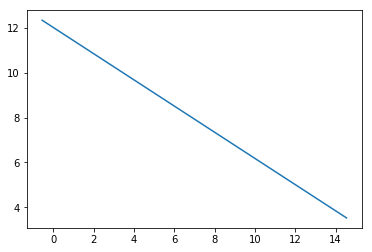

error value is [[0.25314278]]


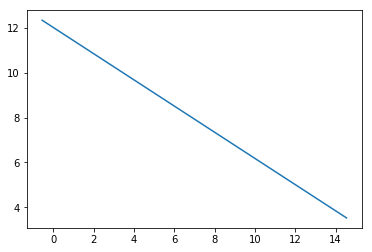

error value is [[0.25294868]]


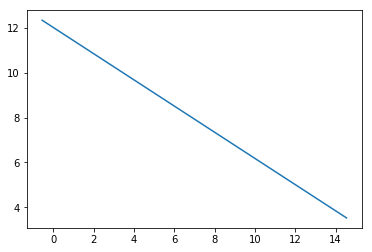

error value is [[0.25275497]]


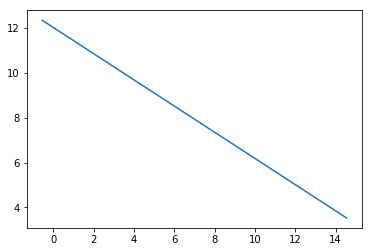

error value is [[0.25256165]]


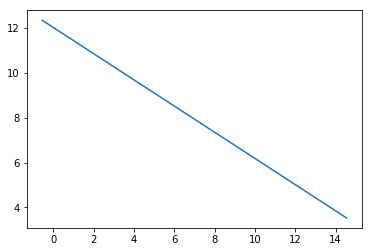

error value is [[0.25236872]]


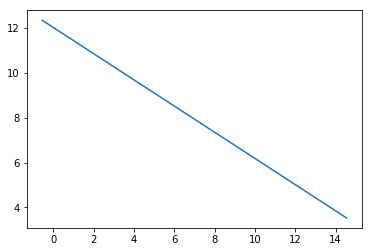

error value is [[0.25217618]]


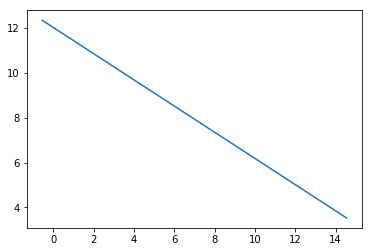

error value is [[0.25198402]]


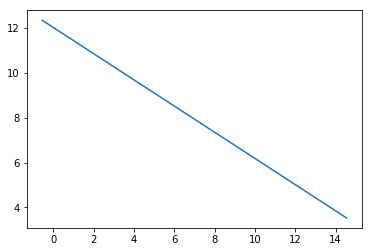

error value is [[0.25179225]]


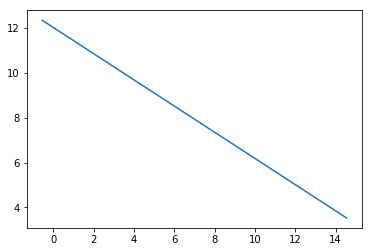

error value is [[0.25160087]]


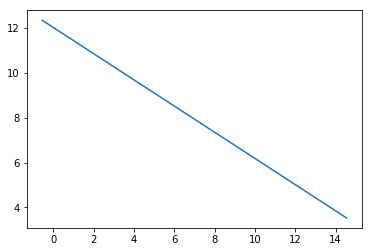

error value is [[0.25140987]]


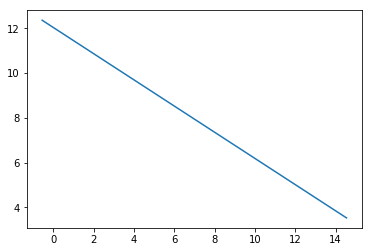

error value is [[0.25121925]]


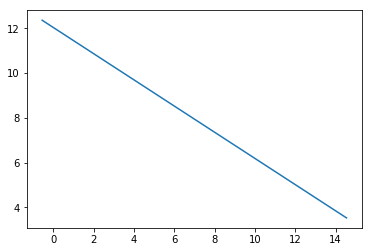

error value is [[0.25102902]]


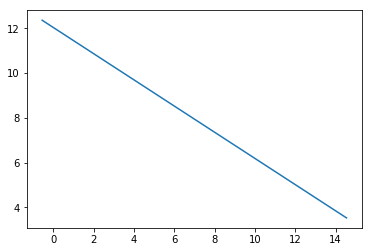

error value is [[0.25083916]]


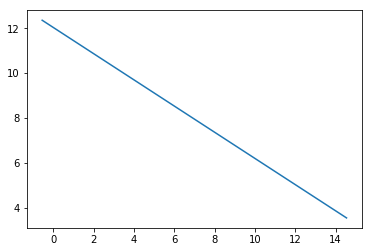

error value is [[0.25064968]]


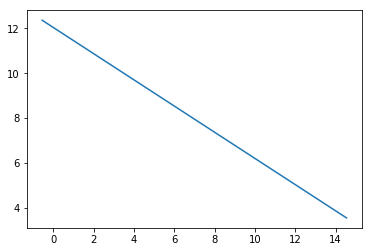

error value is [[0.25046059]]


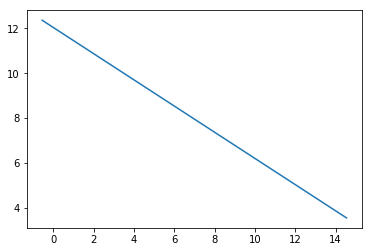

error value is [[0.25027186]]


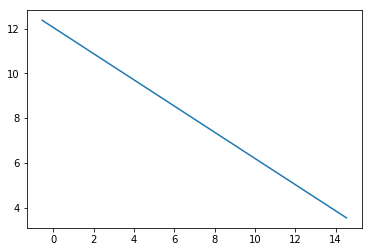

error value is [[0.25008352]]


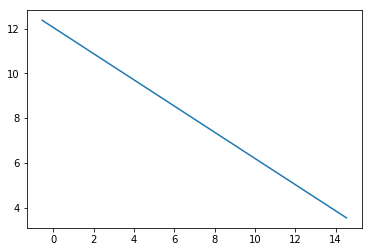

error value is [[0.24989555]]


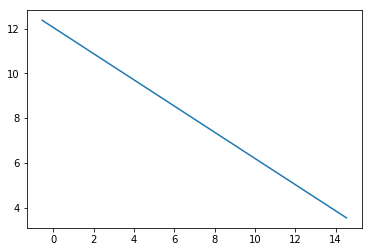

error value is [[0.24970795]]


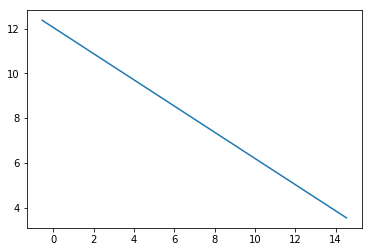

error value is [[0.24952072]]


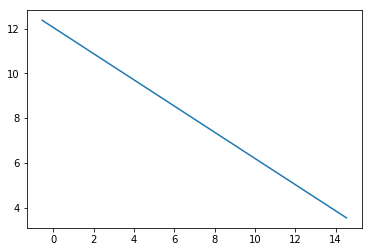

error value is [[0.24933387]]


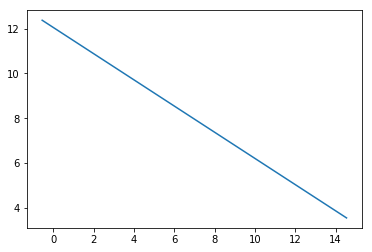

error value is [[0.24914738]]


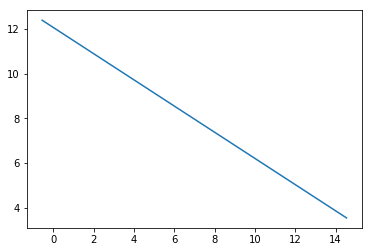

error value is [[0.24896127]]


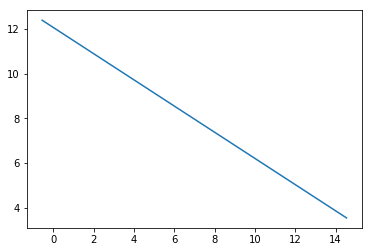

error value is [[0.24877552]]


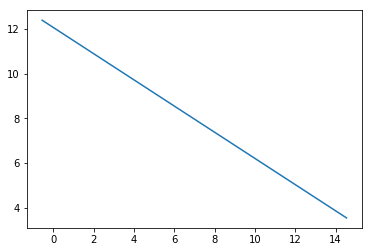

error value is [[0.24859014]]


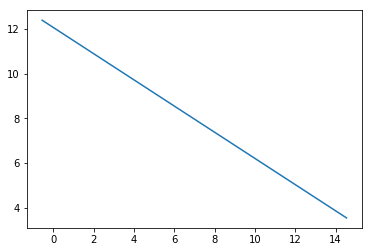

error value is [[0.24840513]]


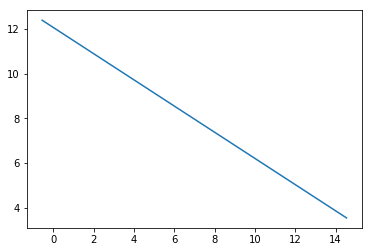

error value is [[0.24822048]]


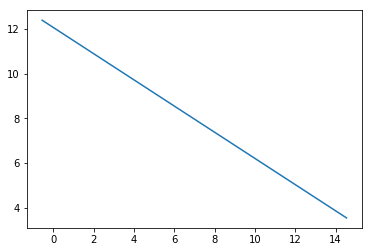

error value is [[0.24803619]]


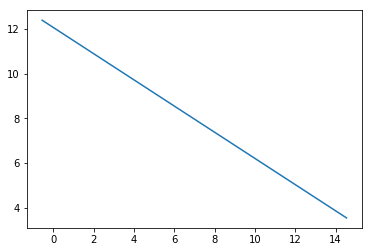

error value is [[0.24785227]]


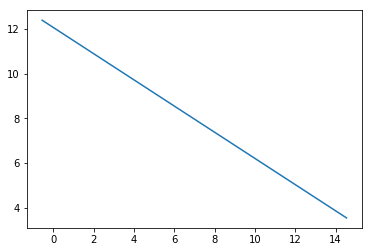

error value is [[0.24766871]]


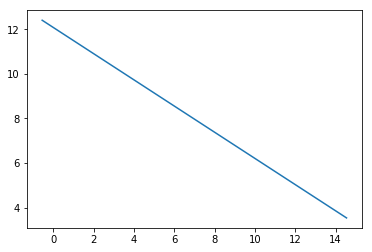

error value is [[0.2474855]]


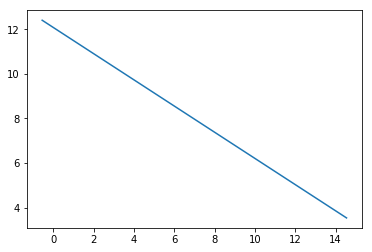

error value is [[0.24730266]]


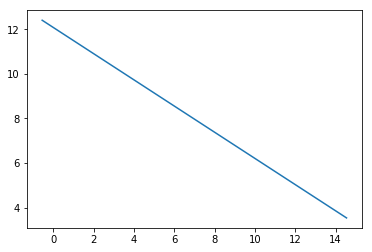

error value is [[0.24712018]]


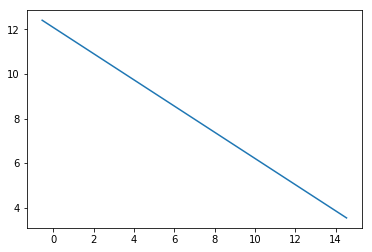

error value is [[0.24693805]]


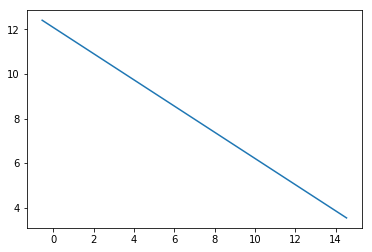

error value is [[0.24675628]]


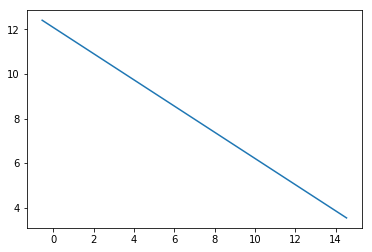

error value is [[0.24657487]]


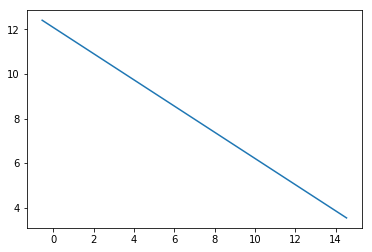

error value is [[0.2463938]]


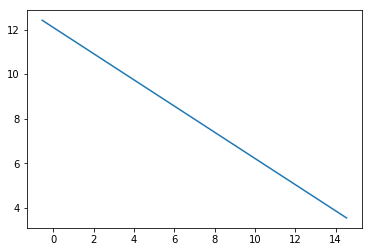

error value is [[0.2462131]]


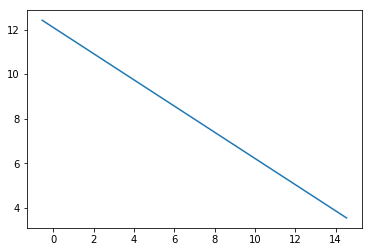

error value is [[0.24603274]]


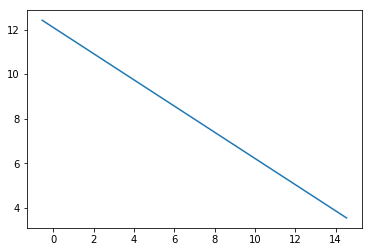

error value is [[0.24585273]]


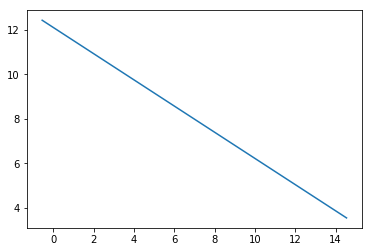

error value is [[0.24567308]]


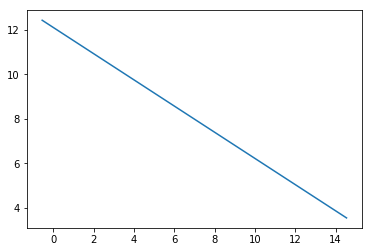

error value is [[0.24549377]]


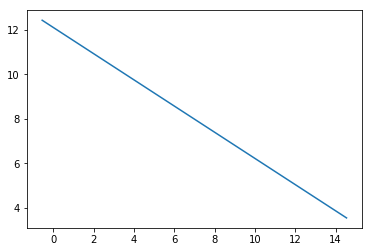

error value is [[0.24531481]]


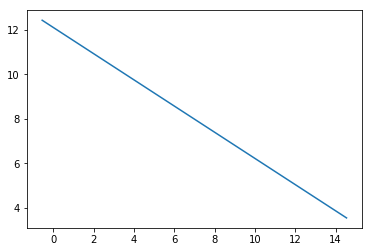

error value is [[0.2451362]]


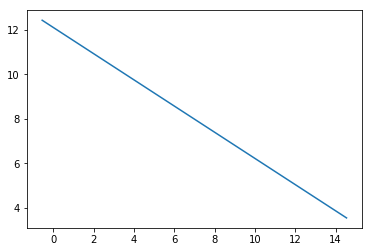

error value is [[0.24495794]]


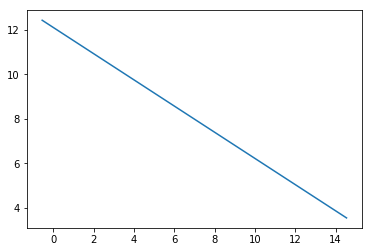

error value is [[0.24478002]]


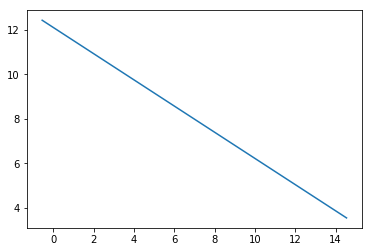

error value is [[0.24460244]]


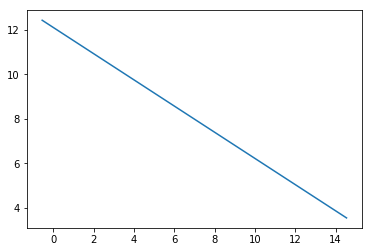

error value is [[0.24442521]]


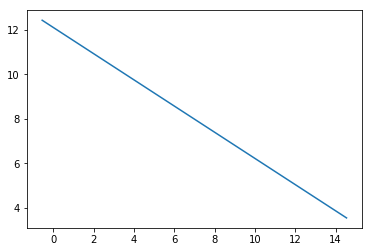

error value is [[0.24424831]]


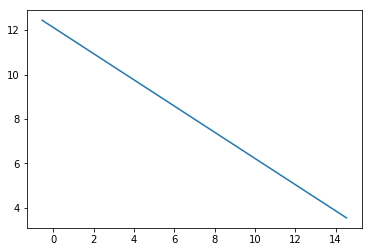

error value is [[0.24407176]]


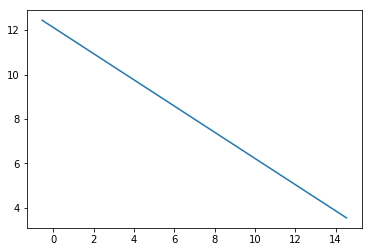

error value is [[0.24389555]]


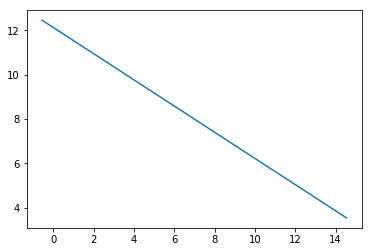

error value is [[0.24371968]]


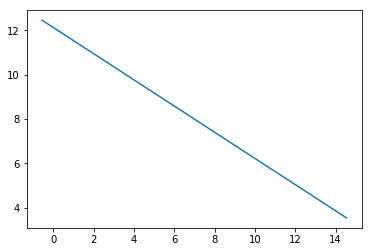

error value is [[0.24354414]]


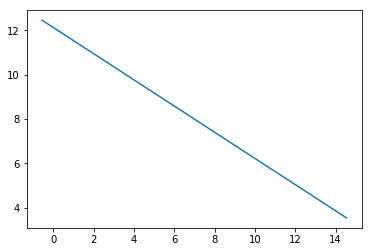

error value is [[0.24336895]]


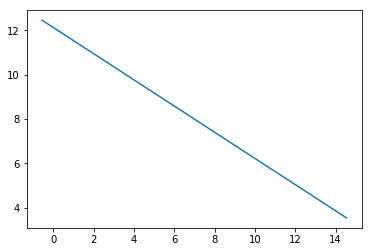

error value is [[0.24319409]]


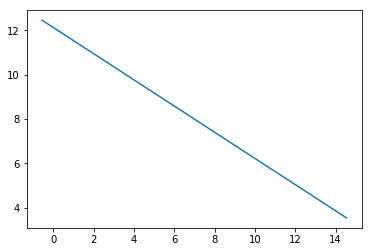

error value is [[0.24301956]]


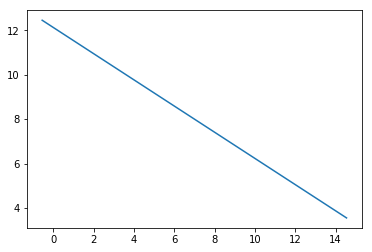

error value is [[0.24284537]]


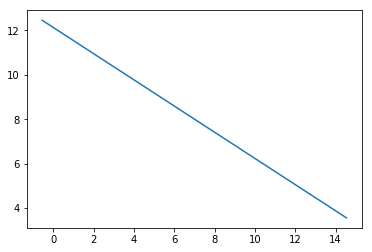

error value is [[0.24267151]]


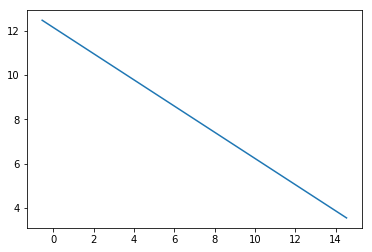

error value is [[0.24249798]]


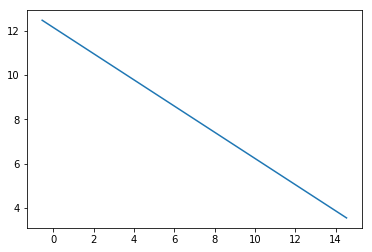

error value is [[0.24232479]]


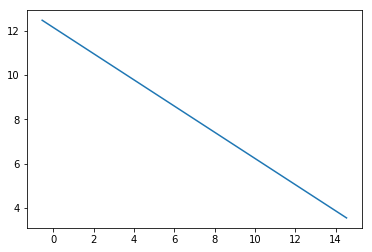

error value is [[0.24215192]]


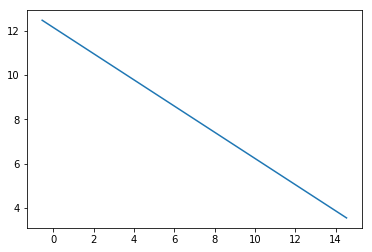

error value is [[0.24197938]]


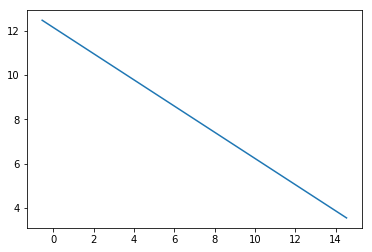

error value is [[0.24180718]]


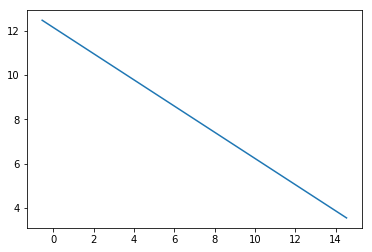

error value is [[0.24163529]]


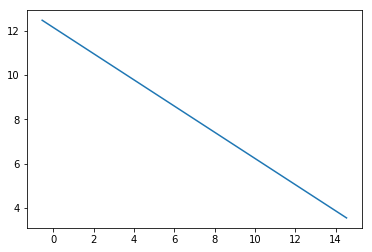

error value is [[0.24146374]]


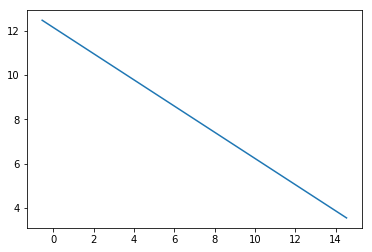

error value is [[0.24129251]]


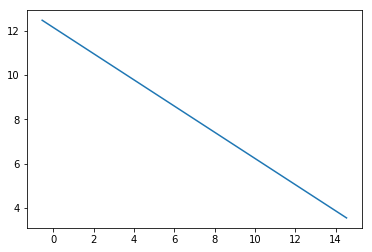

error value is [[0.24112161]]


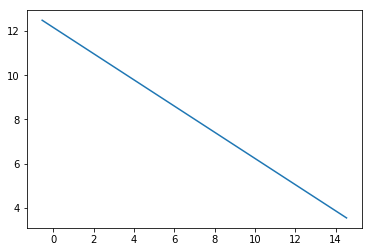

error value is [[0.24095103]]


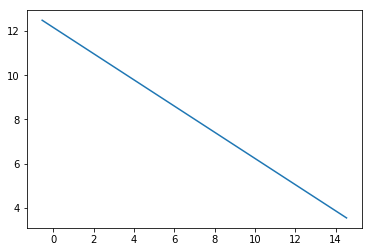

error value is [[0.24078077]]


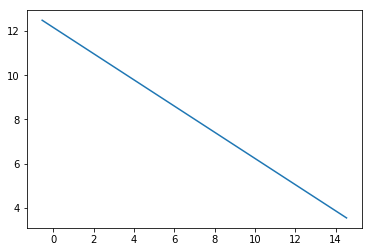

error value is [[0.24061083]]


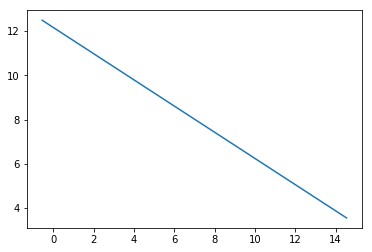

error value is [[0.24044122]]


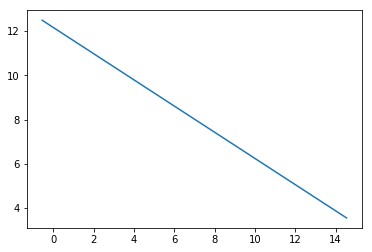

error value is [[0.24027193]]


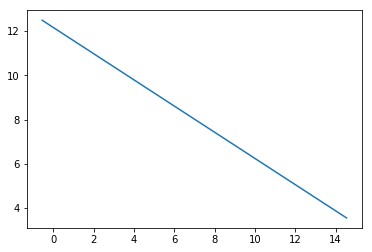

error value is [[0.24010295]]


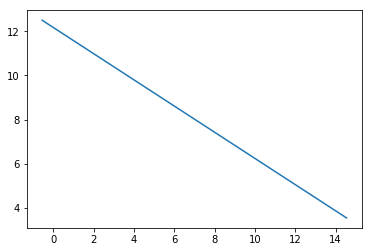

error value is [[0.23993429]]


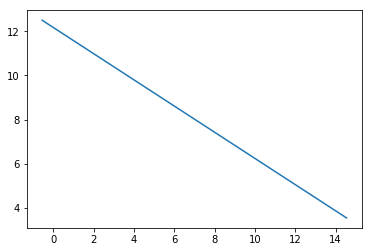

error value is [[0.23976595]]


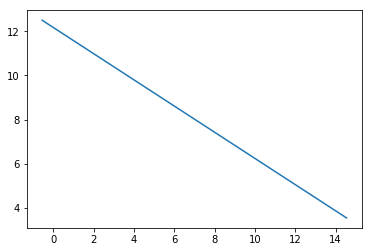

error value is [[0.23959793]]


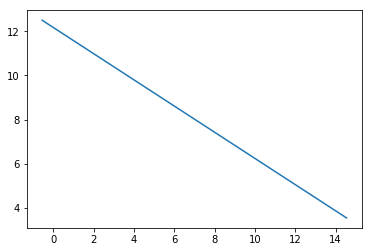

error value is [[0.23943022]]


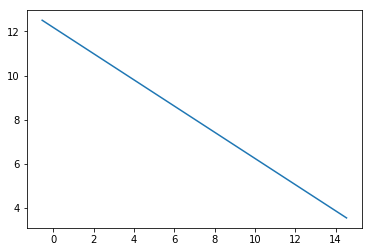

error value is [[0.23926283]]


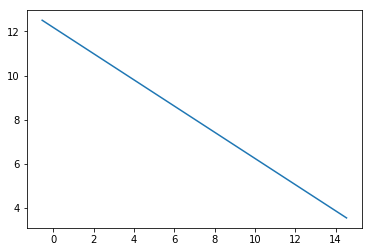

error value is [[0.23909575]]


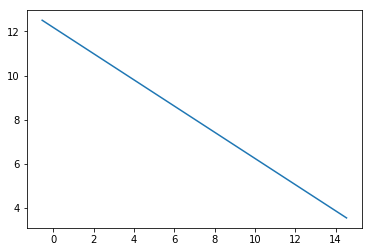

error value is [[0.23892898]]


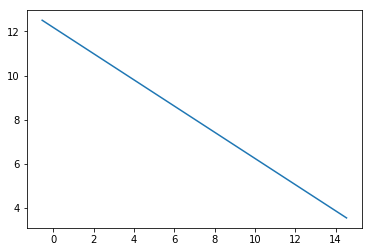

error value is [[0.23876252]]


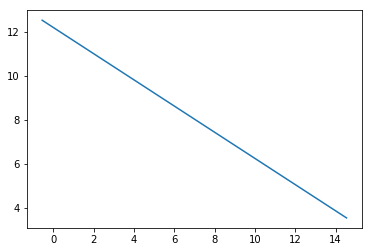

error value is [[0.23859638]]


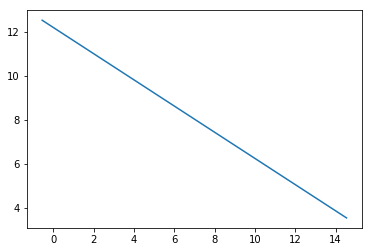

error value is [[0.23843054]]


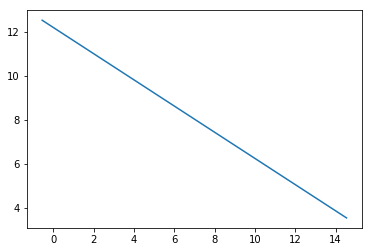

error value is [[0.23826502]]


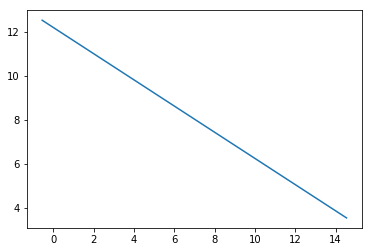

error value is [[0.2380998]]


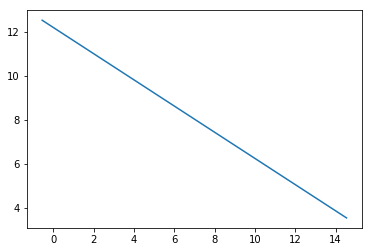

error value is [[0.23793489]]


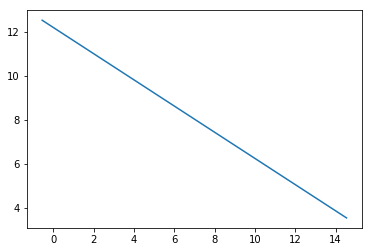

error value is [[0.23777029]]


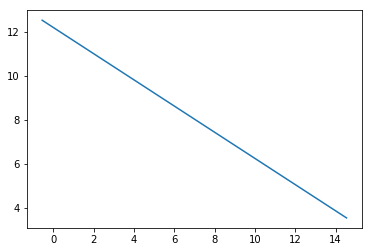

error value is [[0.237606]]


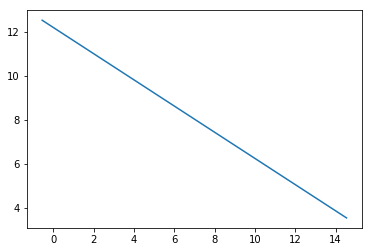

error value is [[0.237442]]


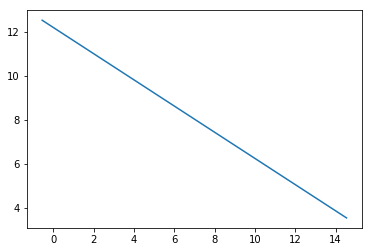

error value is [[0.23727832]]


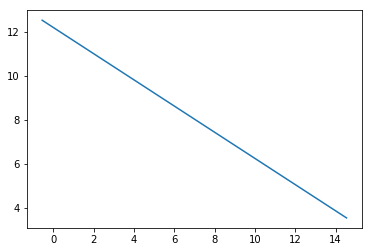

error value is [[0.23711493]]


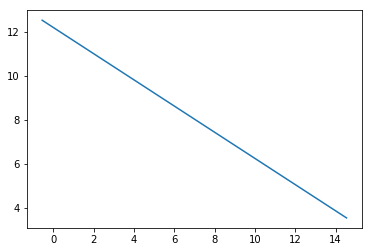

error value is [[0.23695185]]


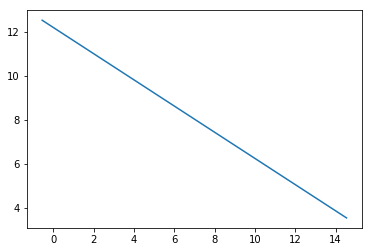

error value is [[0.23678907]]


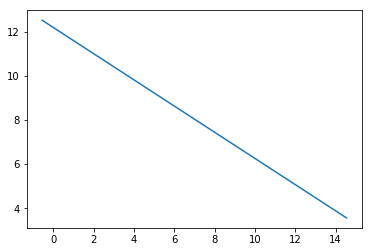

error value is [[0.23662659]]


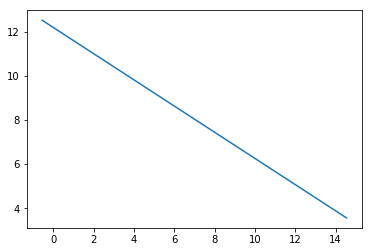

error value is [[0.23646441]]


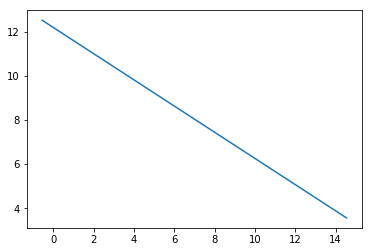

error value is [[0.23630253]]


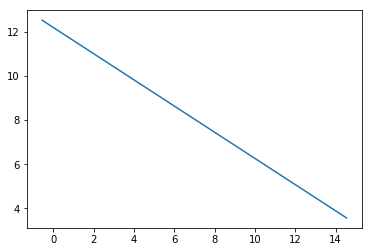

error value is [[0.23614095]]


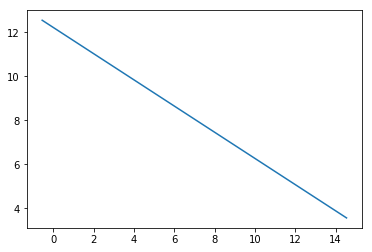

error value is [[0.23597967]]


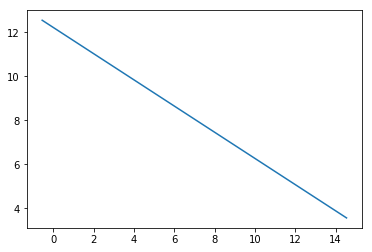

error value is [[0.23581868]]


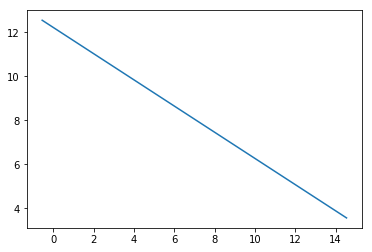

error value is [[0.23565799]]


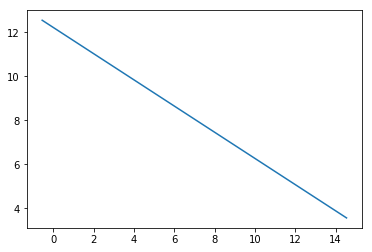

error value is [[0.23549759]]


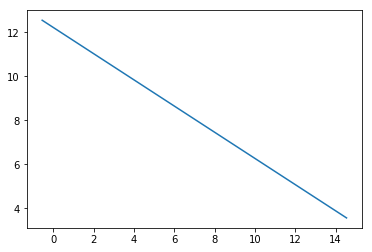

error value is [[0.23533749]]


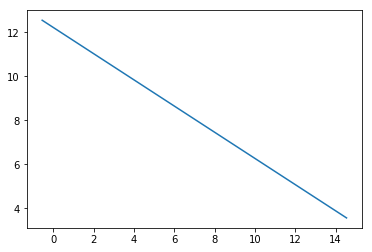

error value is [[0.23517768]]


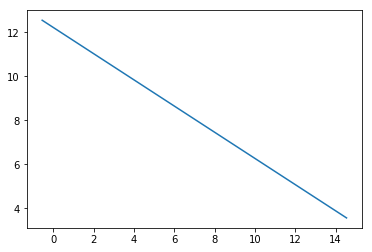

error value is [[0.23501816]]


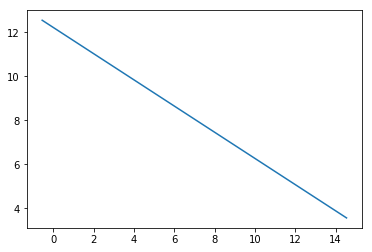

error value is [[0.23485893]]


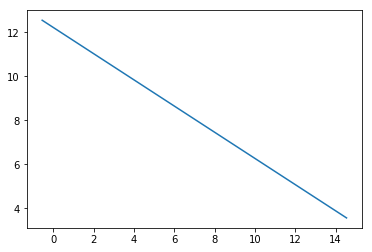

error value is [[0.2347]]


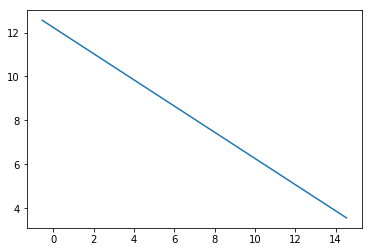

error value is [[0.23454135]]


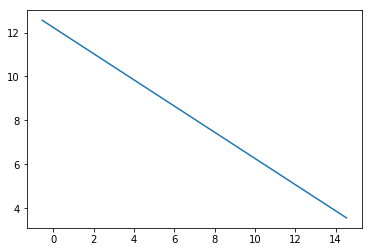

error value is [[0.234383]]


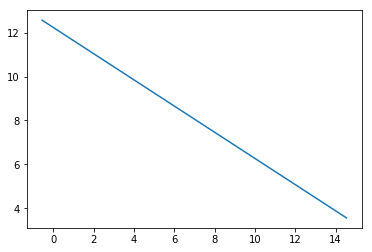

error value is [[0.23422493]]


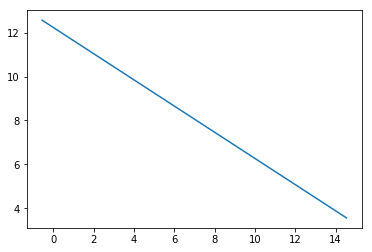

error value is [[0.23406715]]


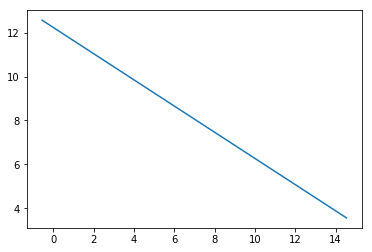

error value is [[0.23390966]]


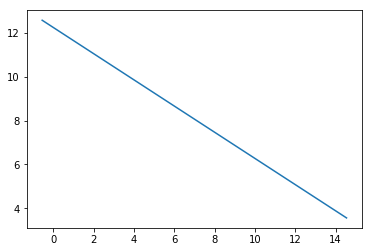

error value is [[0.23375245]]


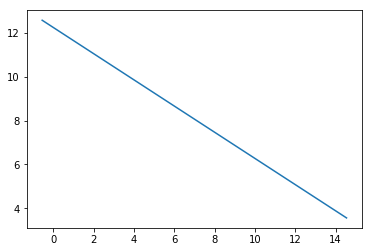

error value is [[0.23359553]]


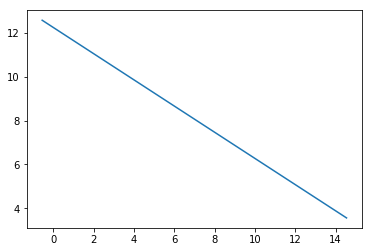

error value is [[0.23343889]]


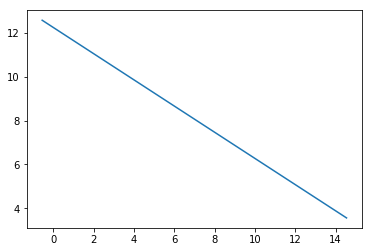

error value is [[0.23328254]]


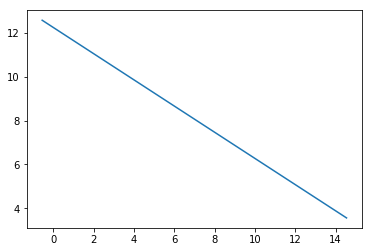

error value is [[0.23312647]]


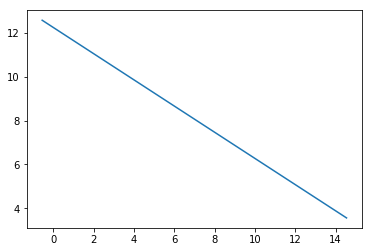

error value is [[0.23297068]]


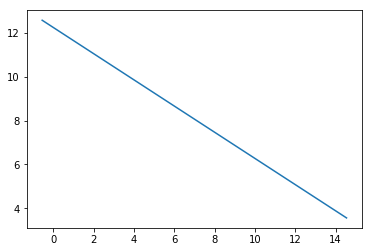

error value is [[0.23281518]]


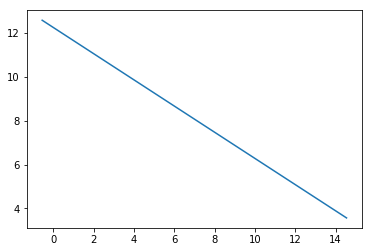

error value is [[0.23265995]]


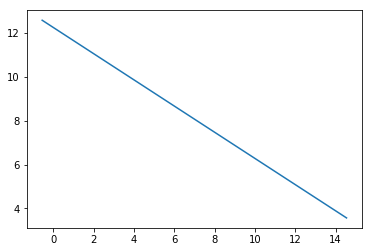

error value is [[0.232505]]


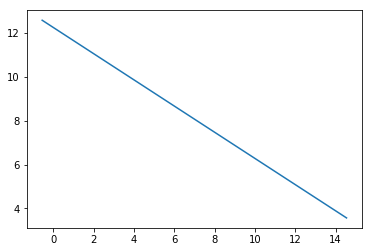

error value is [[0.23235034]]


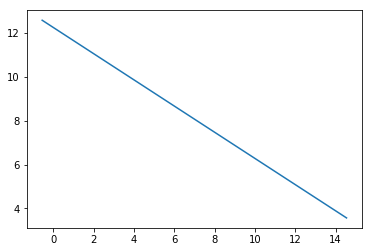

error value is [[0.23219595]]


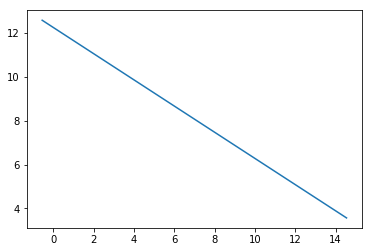

error value is [[0.23204184]]


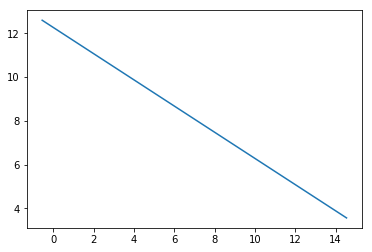

error value is [[0.231888]]


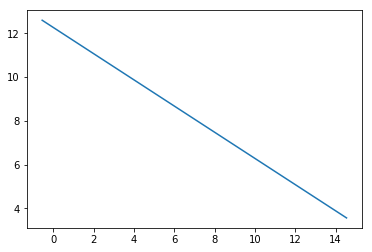

error value is [[0.23173445]]


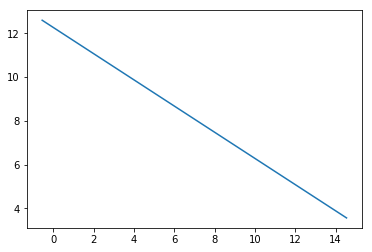

error value is [[0.23158116]]


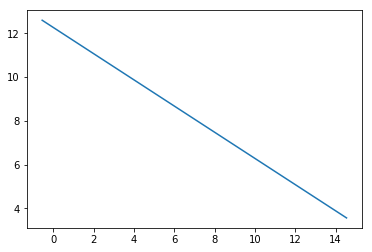

error value is [[0.23142816]]


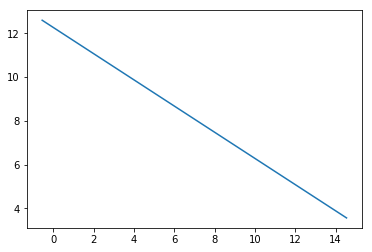

error value is [[0.23127542]]


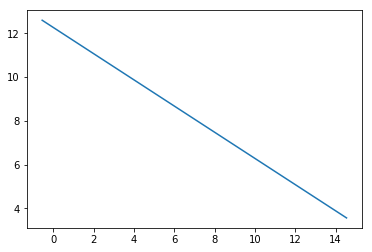

error value is [[0.23112296]]


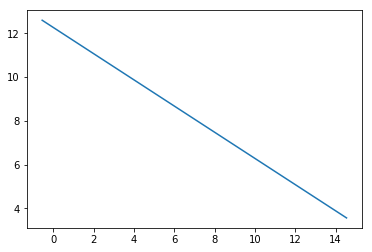

error value is [[0.23097077]]


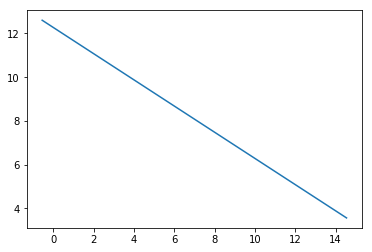

error value is [[0.23081886]]


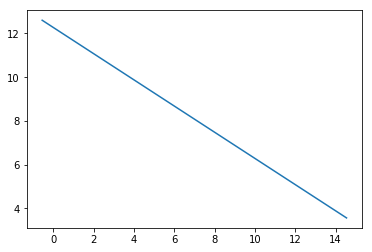

error value is [[0.23066721]]


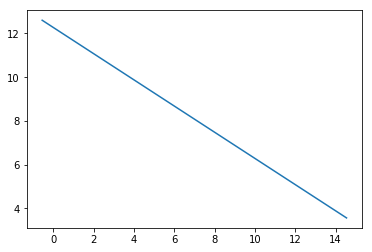

error value is [[0.23051583]]


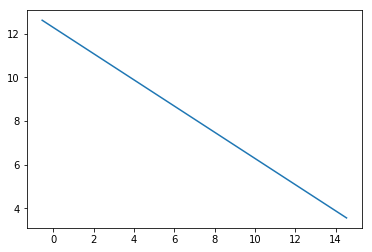

error value is [[0.23036473]]


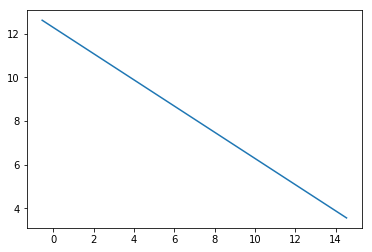

error value is [[0.23021389]]


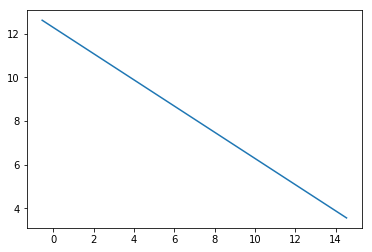

error value is [[0.23006332]]


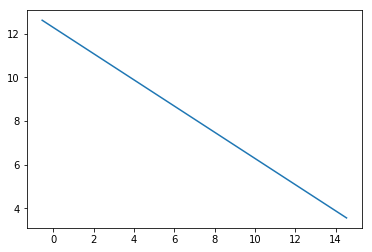

error value is [[0.22991302]]


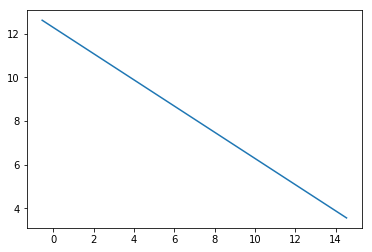

error value is [[0.22976298]]


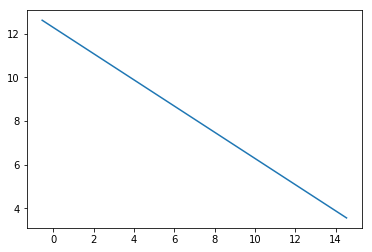

error value is [[0.22961321]]


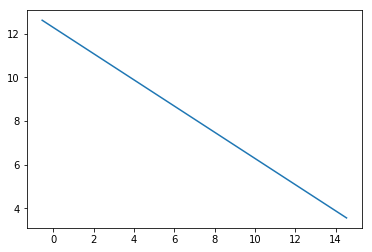

error value is [[0.22946371]]


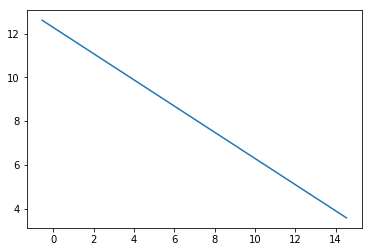

error value is [[0.22931446]]


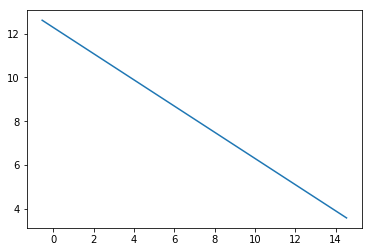

error value is [[0.22916549]]


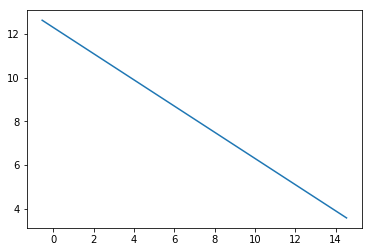

error value is [[0.22901677]]


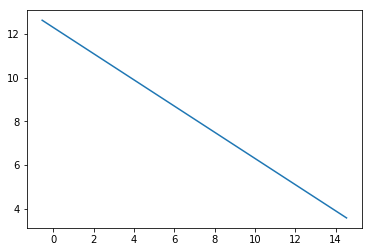

error value is [[0.22886832]]


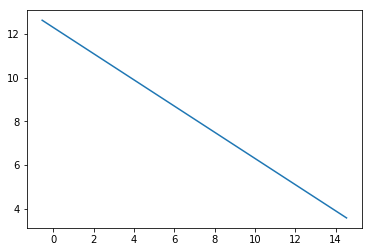

error value is [[0.22872013]]


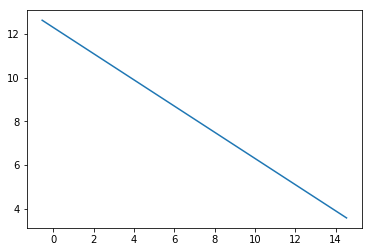

error value is [[0.2285722]]


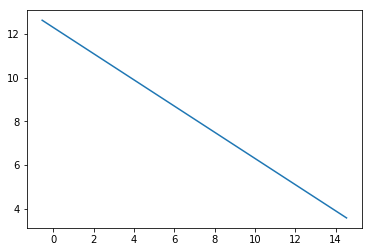

error value is [[0.22842453]]


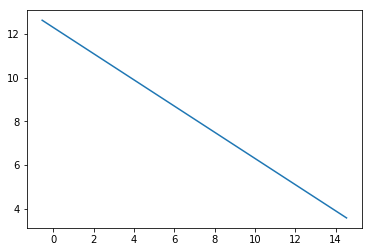

error value is [[0.22827712]]


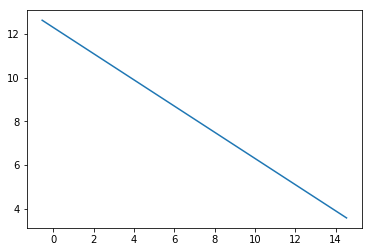

error value is [[0.22812997]]


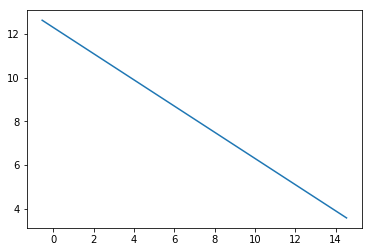

error value is [[0.22798308]]


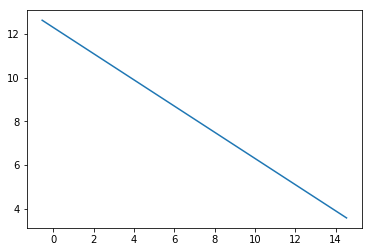

error value is [[0.22783645]]


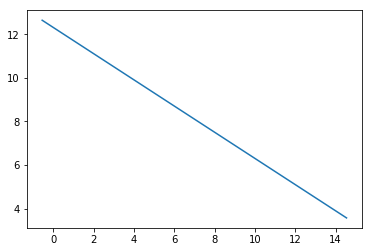

error value is [[0.22769007]]


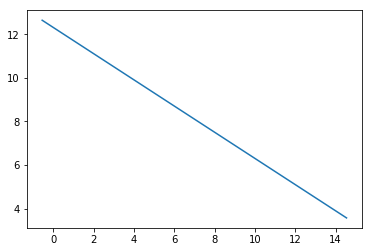

error value is [[0.22754394]]


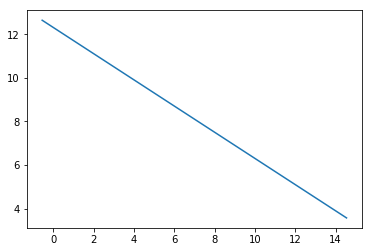

error value is [[0.22739808]]


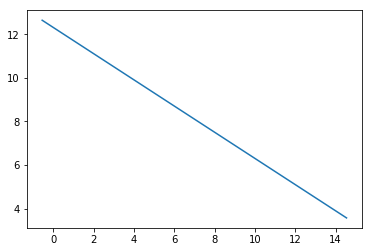

error value is [[0.22725247]]


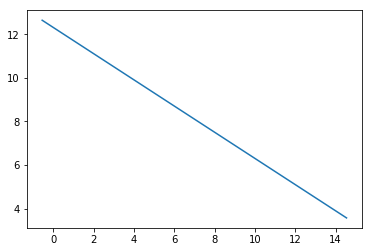

error value is [[0.22710711]]


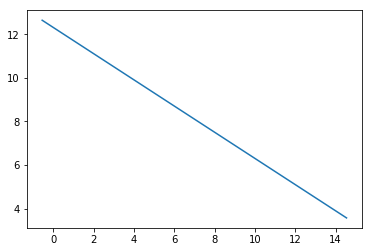

error value is [[0.226962]]


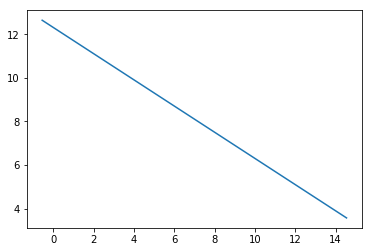

error value is [[0.22681715]]


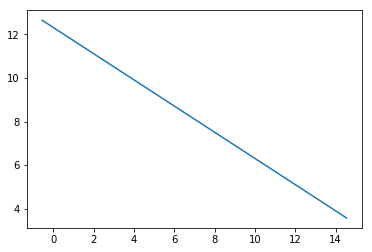

error value is [[0.22667255]]


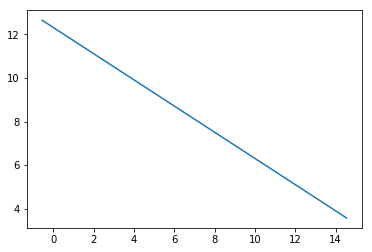

error value is [[0.2265282]]


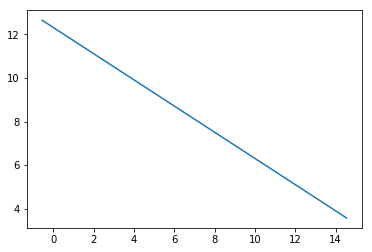

error value is [[0.2263841]]


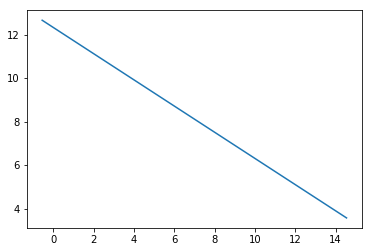

error value is [[0.22624025]]


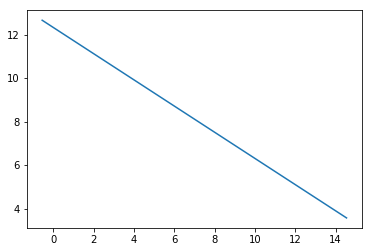

error value is [[0.22609666]]


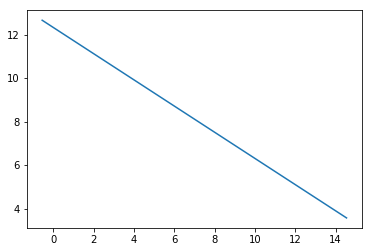

error value is [[0.22595331]]


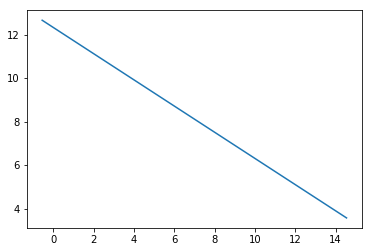

error value is [[0.2258102]]


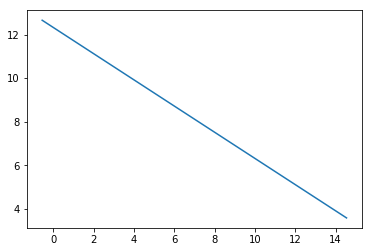

error value is [[0.22566735]]


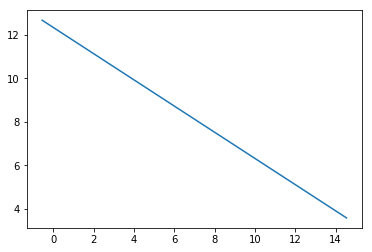

error value is [[0.22552474]]


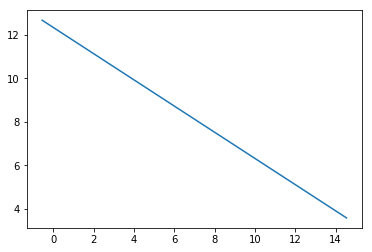

error value is [[0.22538238]]


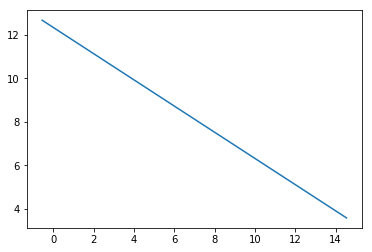

error value is [[0.22524026]]


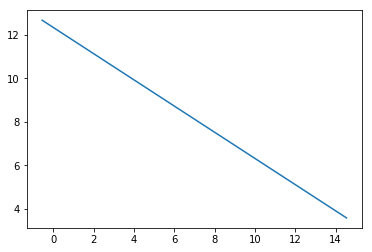

error value is [[0.22509839]]


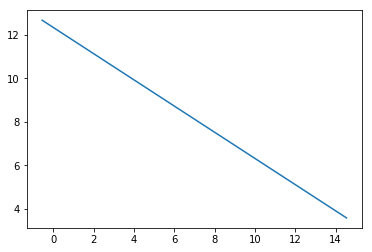

error value is [[0.22495676]]


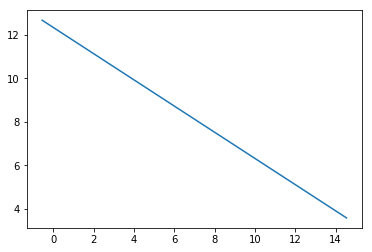

error value is [[0.22481538]]


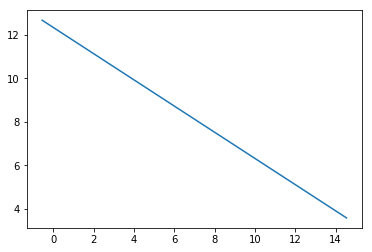

error value is [[0.22467424]]


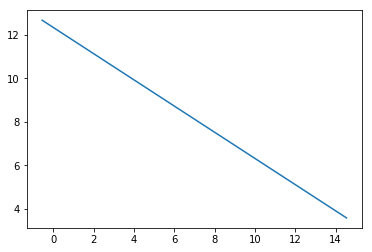

error value is [[0.22453334]]


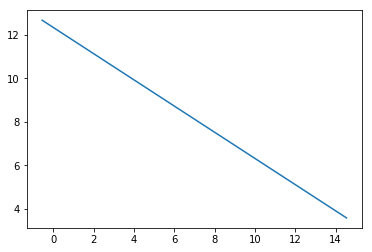

error value is [[0.22439268]]


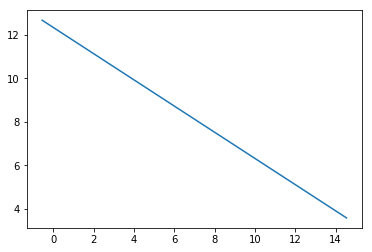

error value is [[0.22425227]]


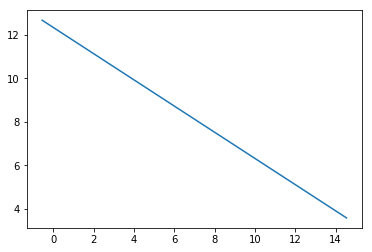

error value is [[0.22411209]]


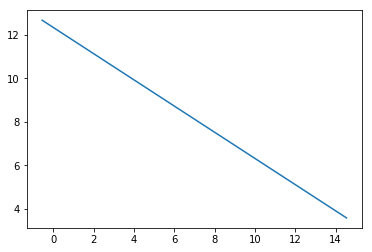

error value is [[0.22397216]]


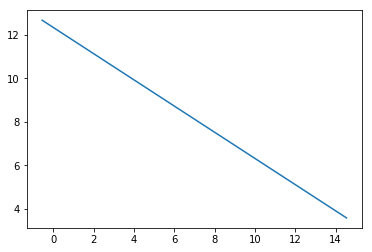

error value is [[0.22383246]]


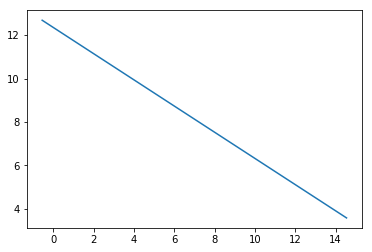

error value is [[0.223693]]


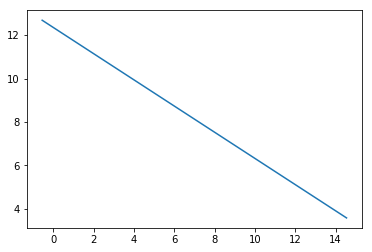

error value is [[0.22355378]]


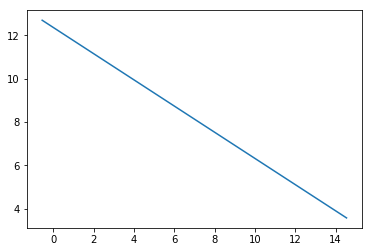

error value is [[0.2234148]]


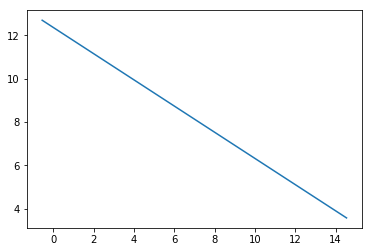

error value is [[0.22327605]]


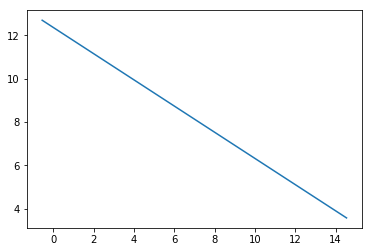

error value is [[0.22313754]]


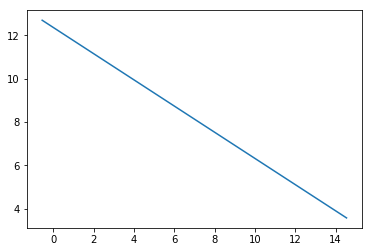

error value is [[0.22299927]]


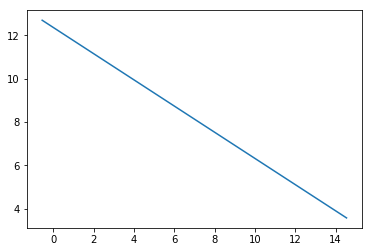

error value is [[0.22286123]]


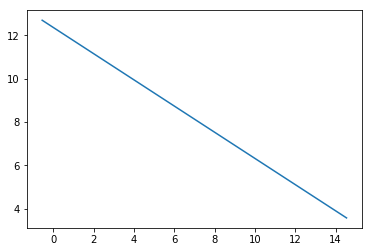

error value is [[0.22272342]]


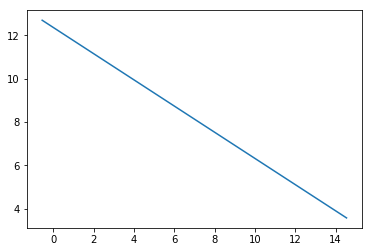

error value is [[0.22258585]]


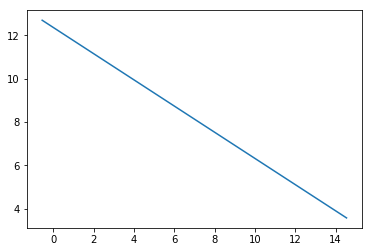

error value is [[0.22244851]]


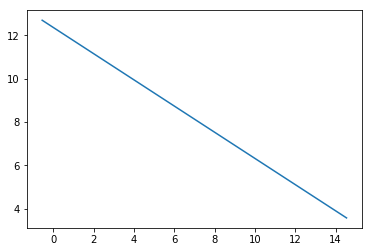

error value is [[0.2223114]]


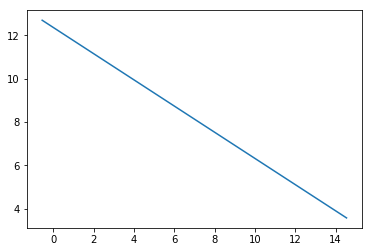

error value is [[0.22217453]]


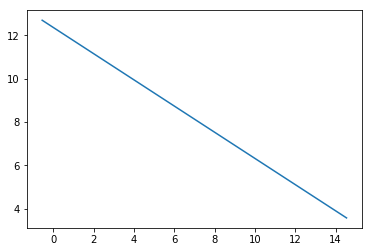

error value is [[0.22203788]]


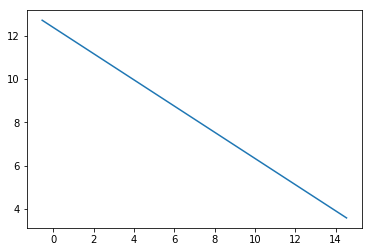

error value is [[0.22190147]]


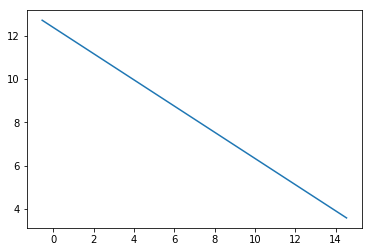

error value is [[0.22176529]]


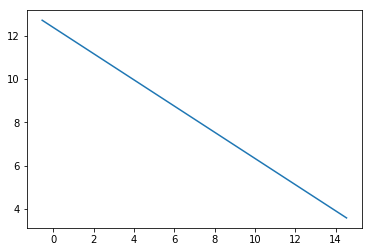

error value is [[0.22162933]]


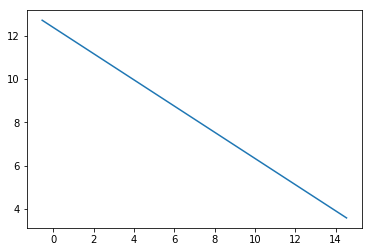

error value is [[0.22149361]]


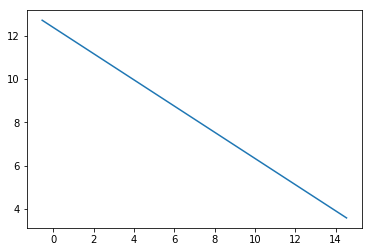

error value is [[0.22135811]]


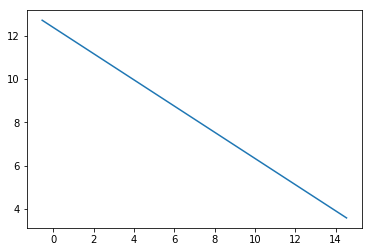

error value is [[0.22122284]]


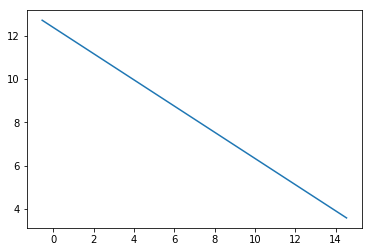

error value is [[0.2210878]]


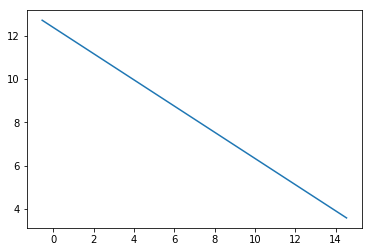

error value is [[0.22095299]]


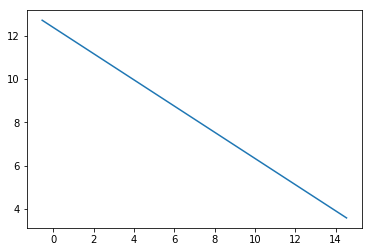

error value is [[0.2208184]]


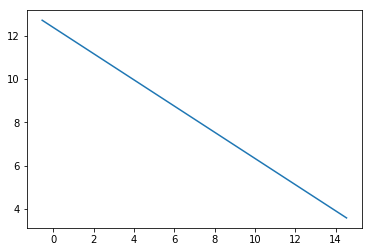

error value is [[0.22068403]]


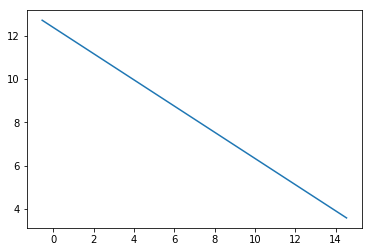

error value is [[0.2205499]]


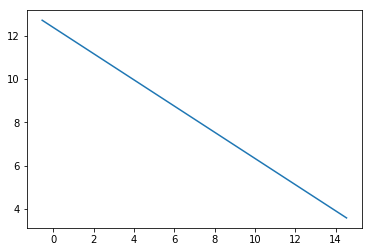

error value is [[0.22041598]]


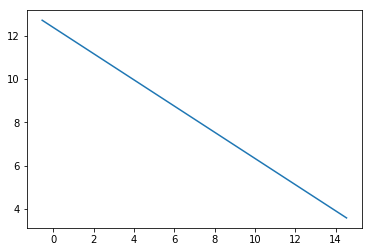

error value is [[0.22028229]]


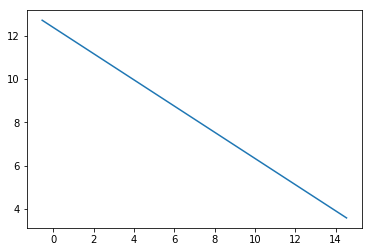

error value is [[0.22014882]]


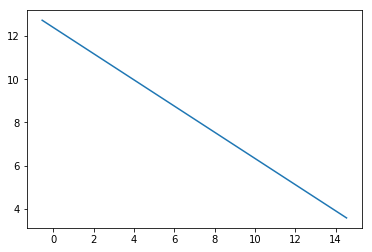

error value is [[0.22001558]]


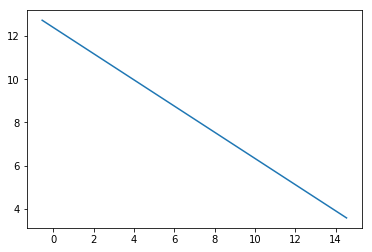

error value is [[0.21988255]]


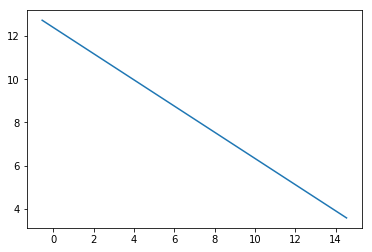

error value is [[0.21974975]]


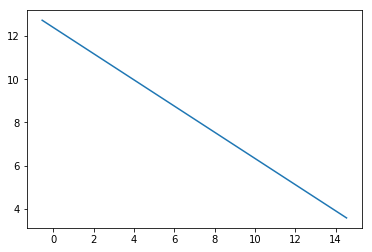

error value is [[0.21961717]]


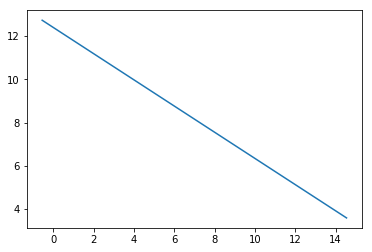

error value is [[0.21948481]]


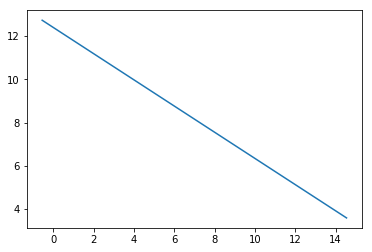

error value is [[0.21935267]]


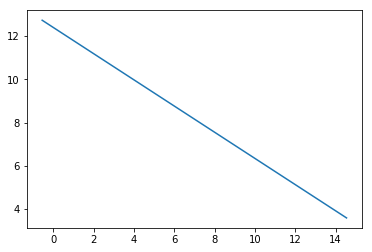

error value is [[0.21922074]]


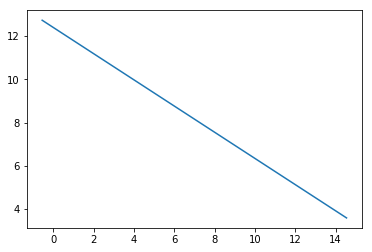

error value is [[0.21908904]]


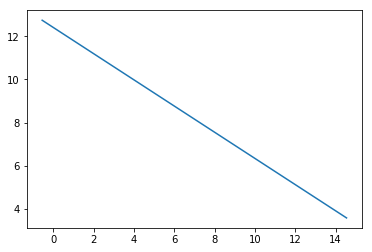

error value is [[0.21895755]]


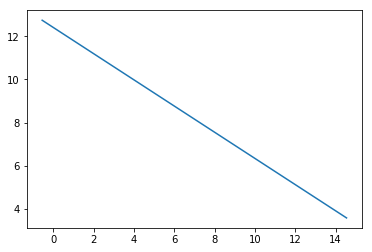

error value is [[0.21882629]]


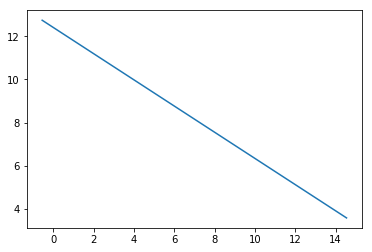

error value is [[0.21869523]]


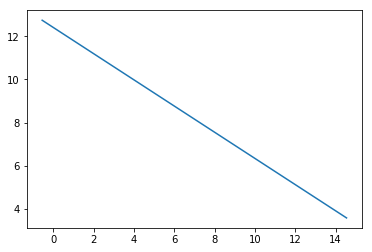

error value is [[0.2185644]]


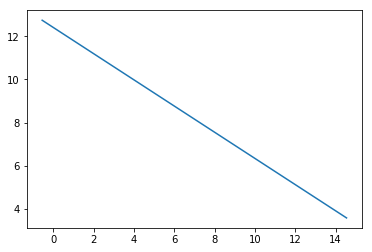

error value is [[0.21843378]]


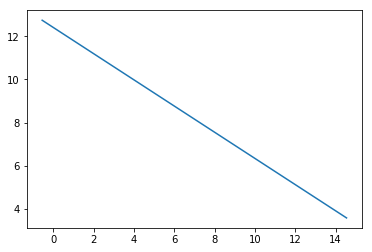

error value is [[0.21830338]]


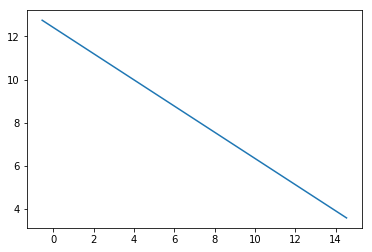

error value is [[0.21817319]]


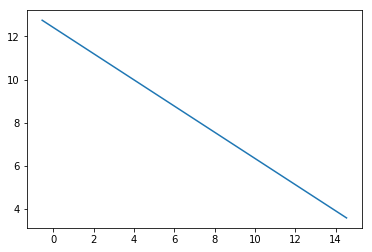

error value is [[0.21804321]]


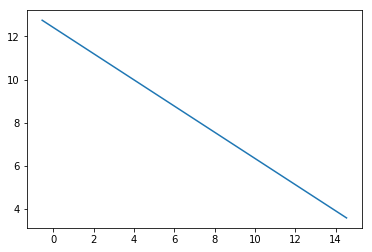

error value is [[0.21791345]]


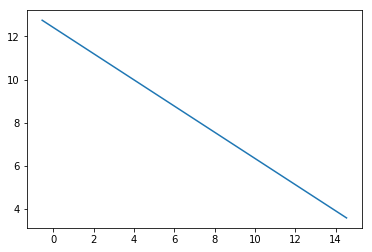

error value is [[0.21778391]]


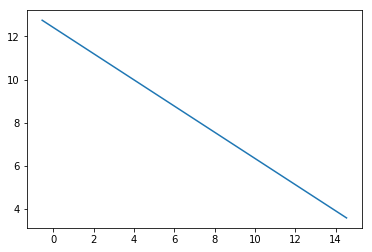

error value is [[0.21765457]]


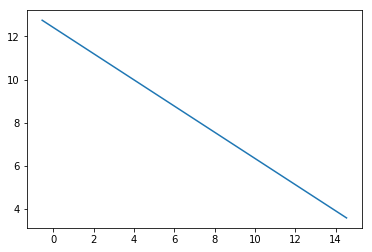

error value is [[0.21752545]]


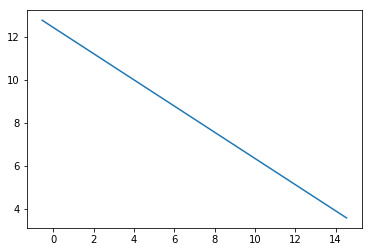

error value is [[0.21739654]]


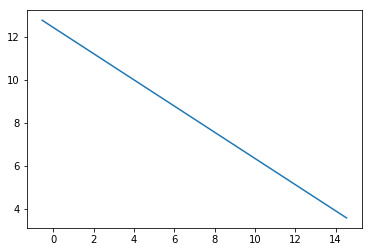

error value is [[0.21726784]]


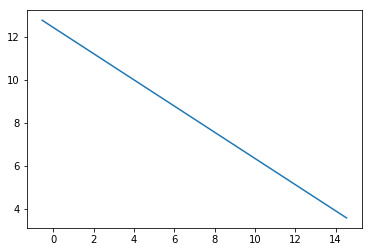

error value is [[0.21713935]]


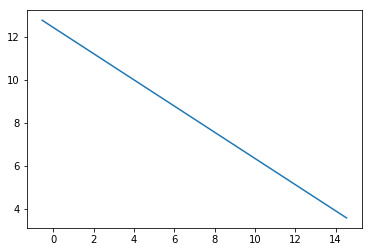

error value is [[0.21701107]]


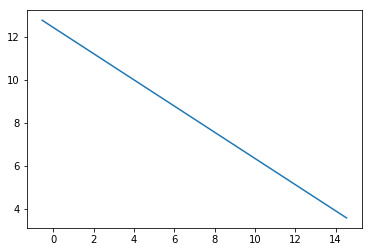

error value is [[0.216883]]


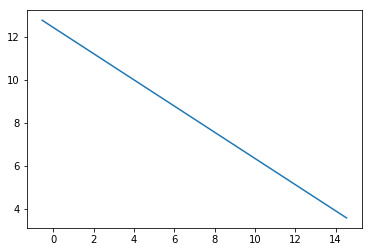

error value is [[0.21675513]]


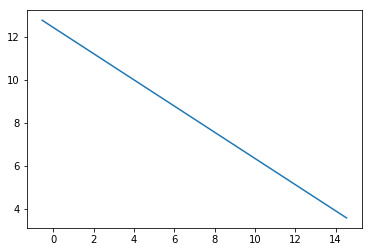

error value is [[0.21662748]]


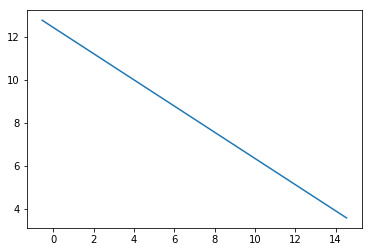

error value is [[0.21650004]]


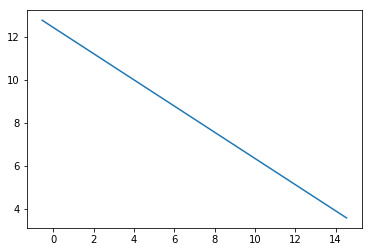

error value is [[0.2163728]]


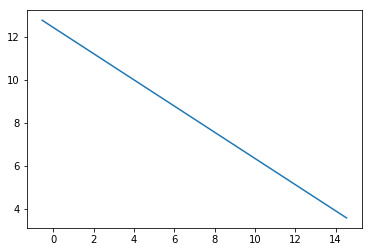

error value is [[0.21624577]]


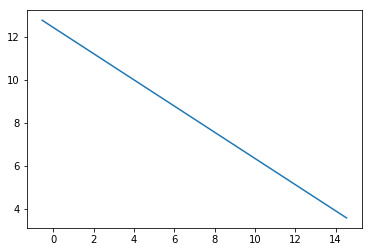

error value is [[0.21611894]]


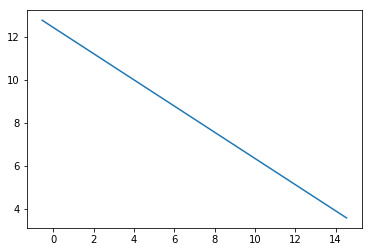

error value is [[0.21599232]]


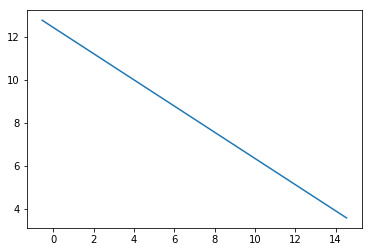

error value is [[0.21586591]]


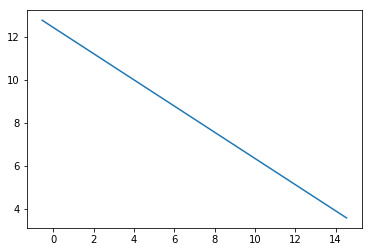

error value is [[0.2157397]]


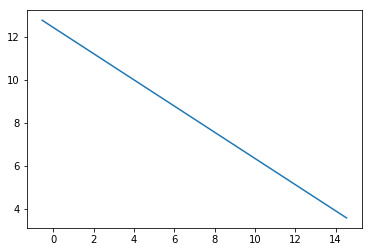

error value is [[0.2156137]]


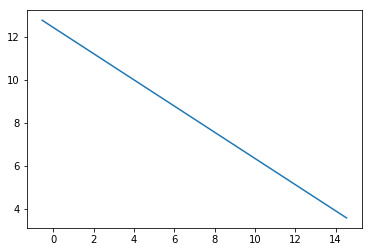

error value is [[0.2154879]]


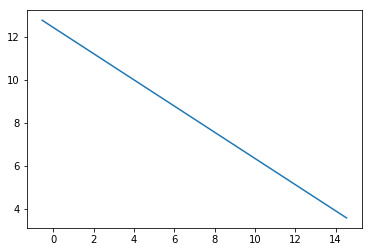

error value is [[0.2153623]]


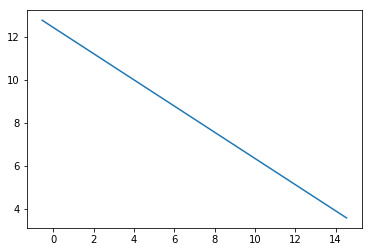

error value is [[0.21523691]]


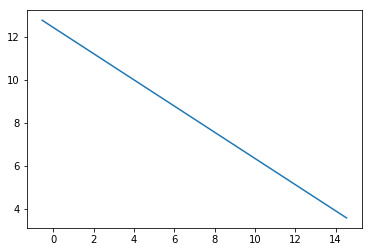

error value is [[0.21511172]]


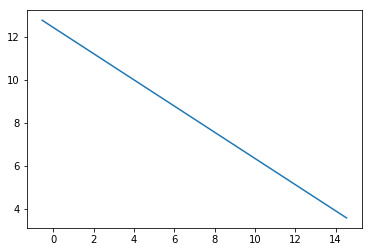

error value is [[0.21498673]]


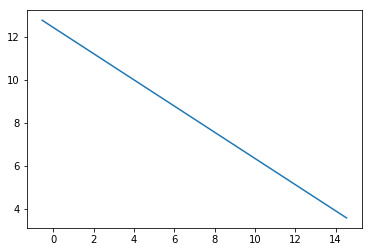

error value is [[0.21486194]]


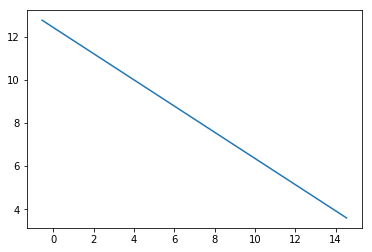

error value is [[0.21473735]]


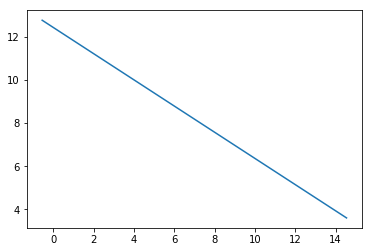

error value is [[0.21461296]]


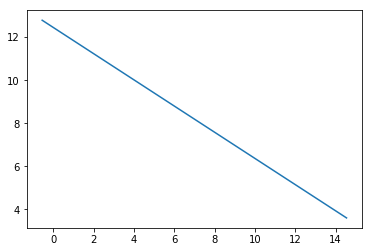

error value is [[0.21448877]]


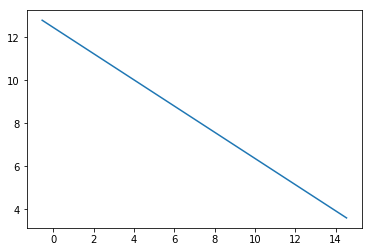

error value is [[0.21436478]]


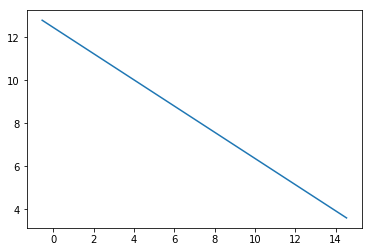

error value is [[0.214241]]


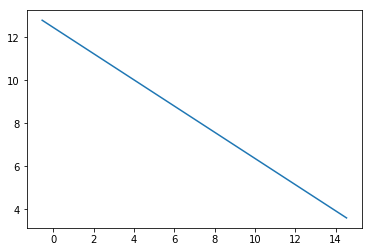

error value is [[0.2141174]]


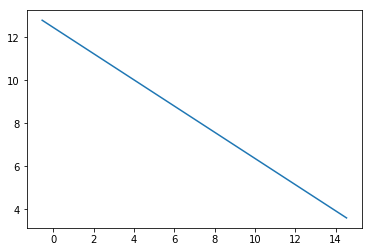

error value is [[0.21399401]]


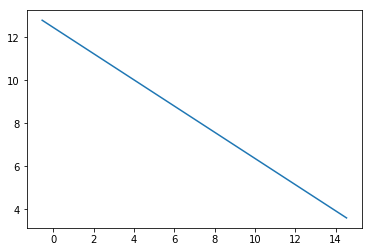

error value is [[0.21387082]]


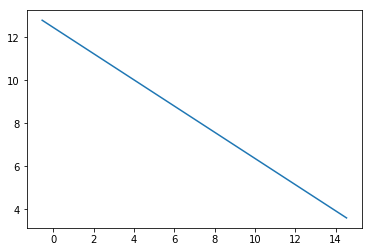

error value is [[0.21374782]]


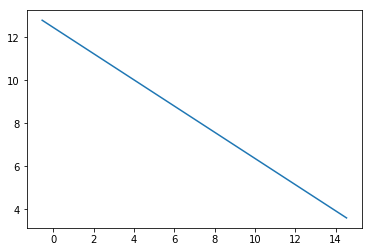

error value is [[0.21362501]]


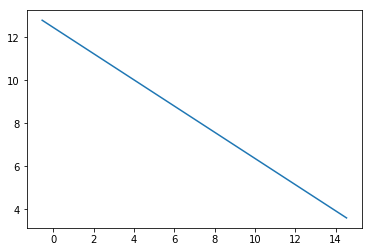

error value is [[0.21350241]]


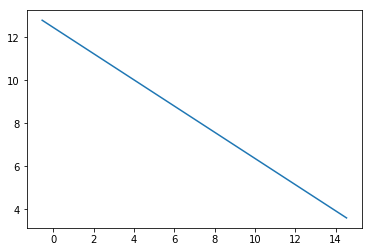

error value is [[0.21338]]


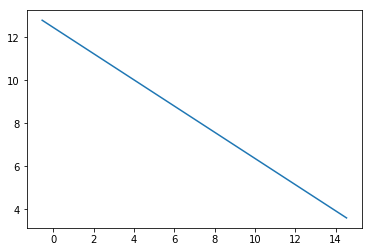

error value is [[0.21325778]]


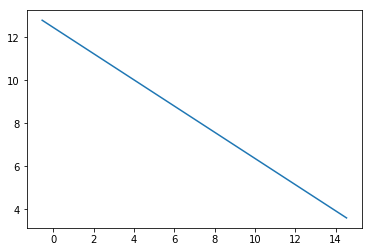

error value is [[0.21313576]]


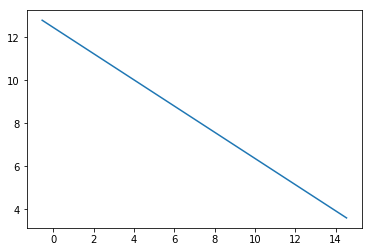

error value is [[0.21301393]]


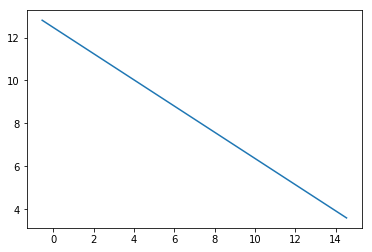

error value is [[0.2128923]]


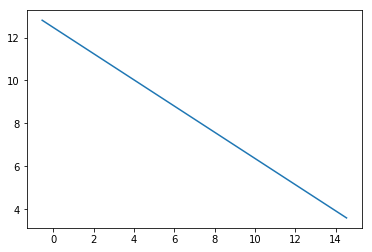

error value is [[0.21277086]]


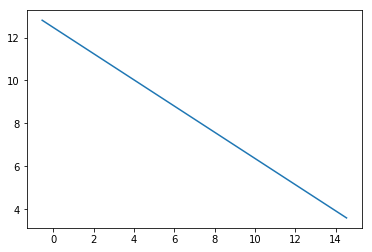

error value is [[0.21264961]]


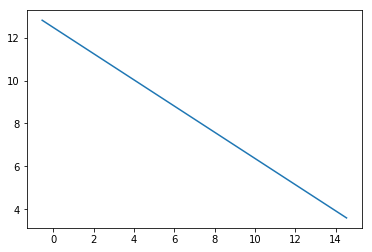

error value is [[0.21252855]]


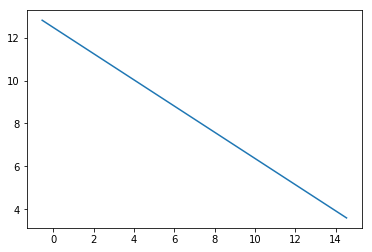

error value is [[0.21240769]]


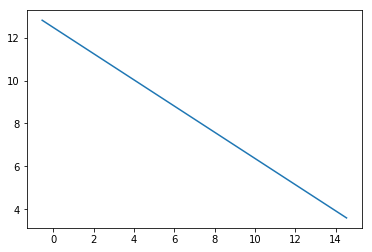

error value is [[0.21228702]]


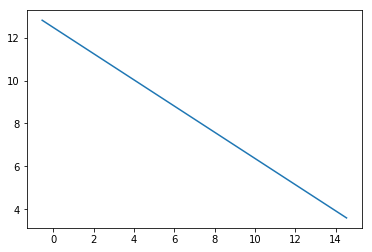

error value is [[0.21216653]]


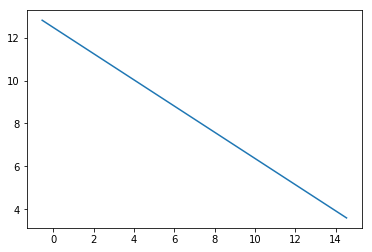

error value is [[0.21204624]]


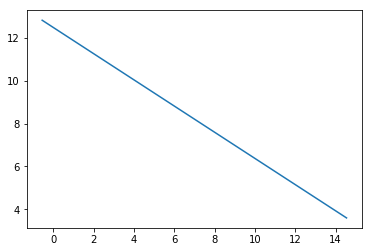

error value is [[0.21192614]]


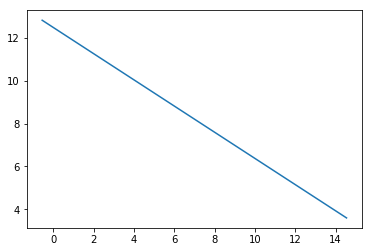

error value is [[0.21180623]]


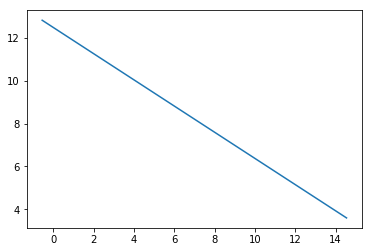

error value is [[0.2116865]]


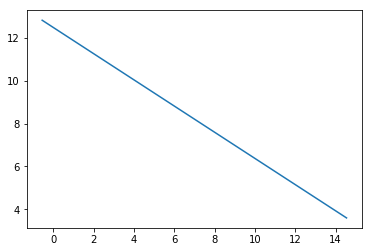

error value is [[0.21156697]]


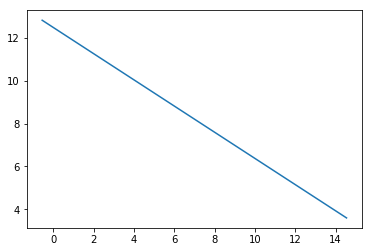

error value is [[0.21144762]]


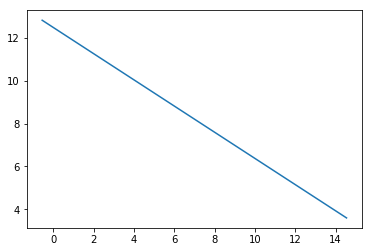

error value is [[0.21132846]]


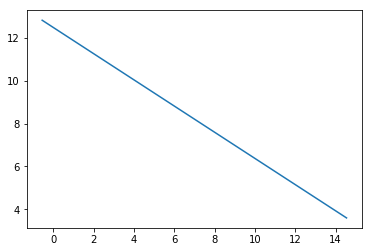

error value is [[0.21120949]]


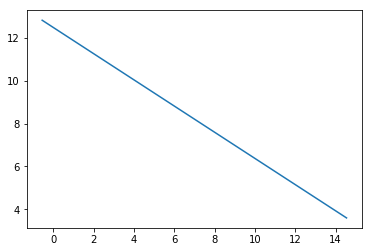

error value is [[0.21109071]]


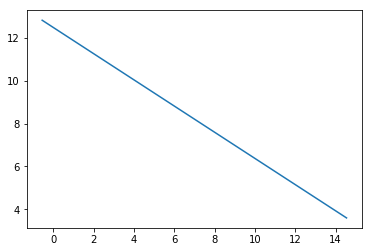

error value is [[0.21097211]]


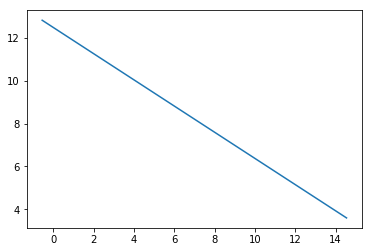

error value is [[0.21085369]]


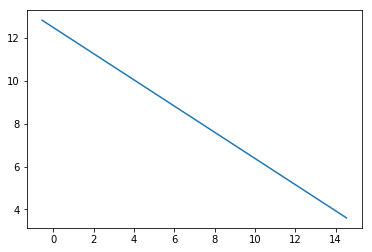

error value is [[0.21073546]]


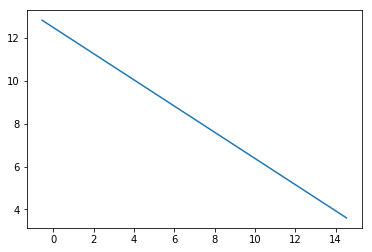

error value is [[0.21061742]]


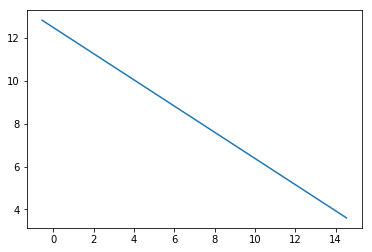

error value is [[0.21049956]]


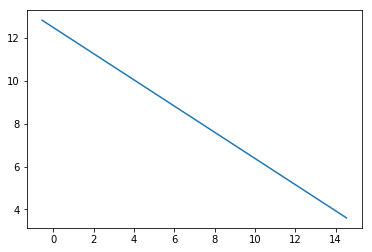

error value is [[0.21038189]]


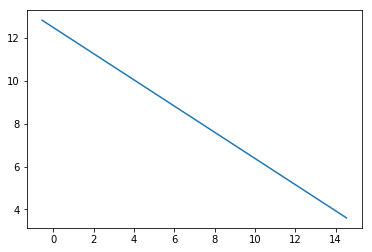

error value is [[0.2102644]]


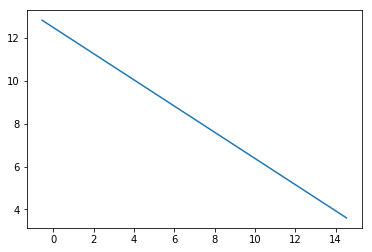

error value is [[0.21014709]]


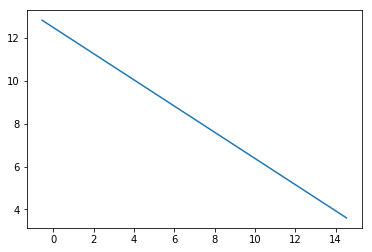

error value is [[0.21002996]]


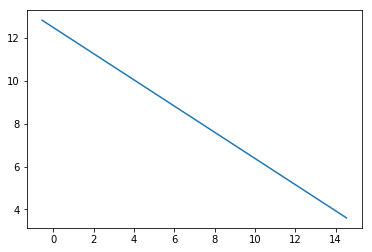

error value is [[0.20991302]]


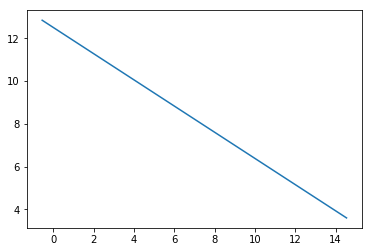

error value is [[0.20979626]]


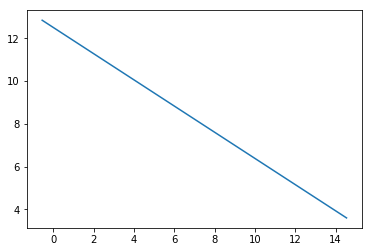

error value is [[0.20967968]]


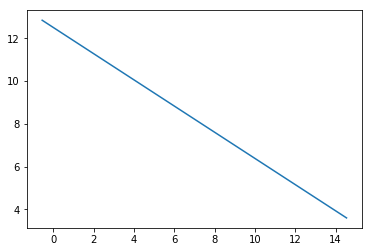

error value is [[0.20956328]]


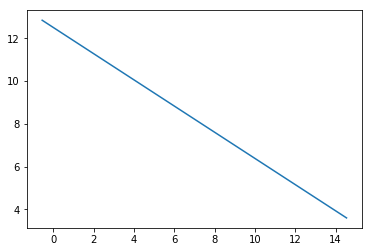

error value is [[0.20944706]]


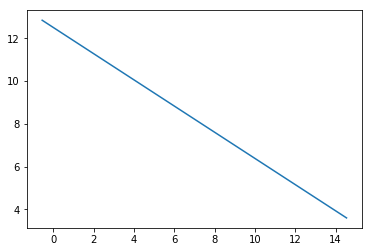

error value is [[0.20933103]]


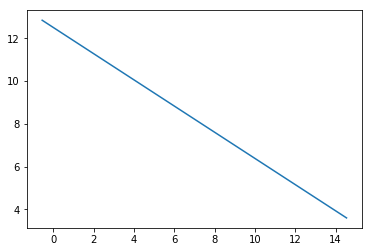

error value is [[0.20921517]]


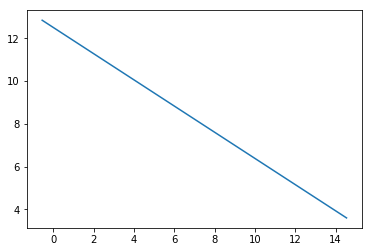

error value is [[0.20909949]]


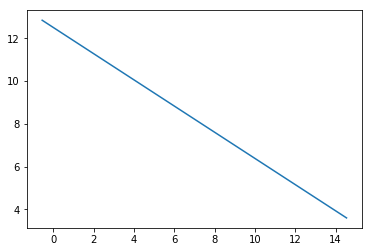

error value is [[0.20898399]]


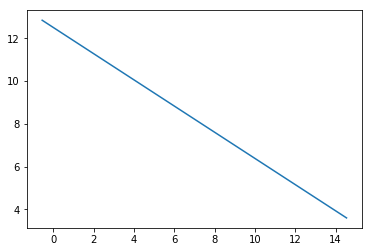

error value is [[0.20886867]]


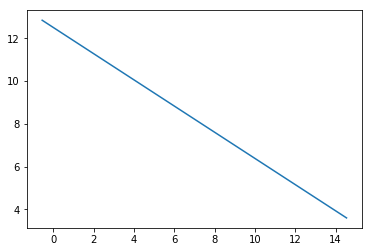

error value is [[0.20875352]]


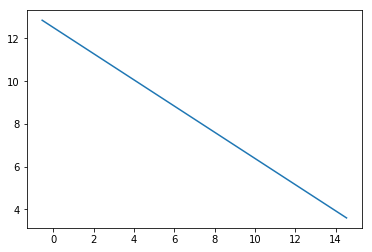

error value is [[0.20863856]]


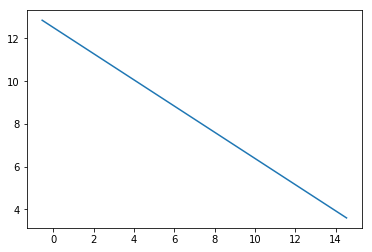

error value is [[0.20852377]]


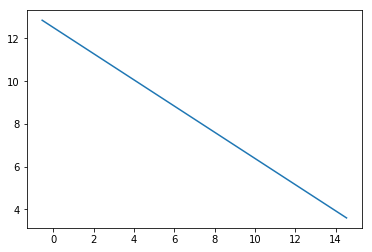

error value is [[0.20840915]]


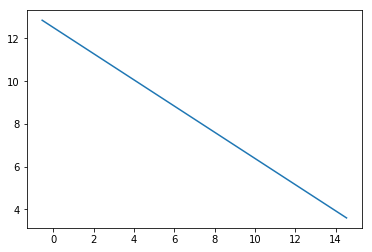

error value is [[0.20829472]]


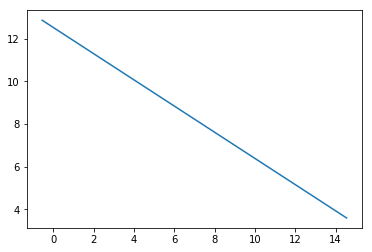

error value is [[0.20818046]]


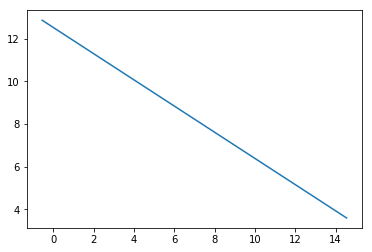

error value is [[0.20806637]]


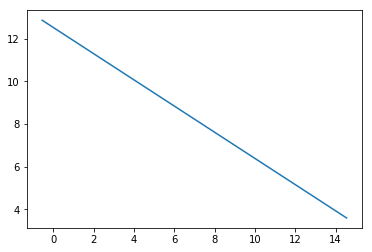

error value is [[0.20795246]]


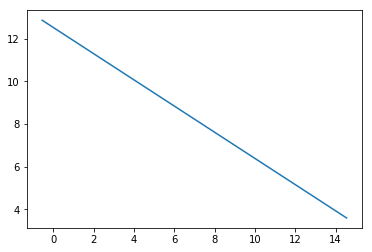

error value is [[0.20783873]]


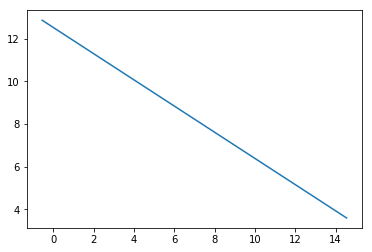

error value is [[0.20772517]]


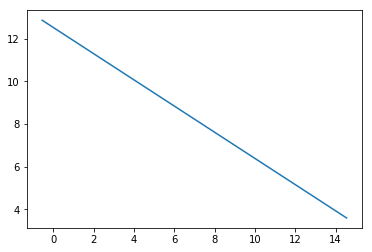

error value is [[0.20761178]]


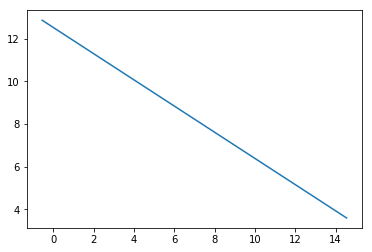

error value is [[0.20749857]]


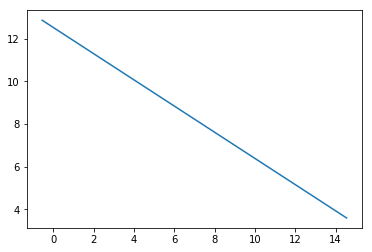

error value is [[0.20738553]]


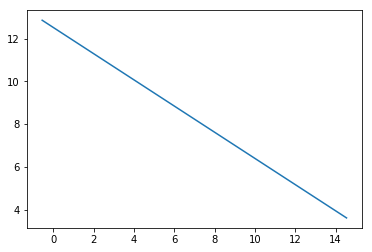

error value is [[0.20727266]]


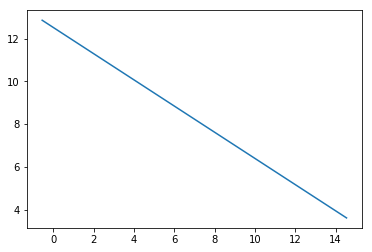

error value is [[0.20715997]]


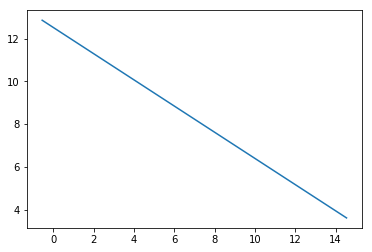

error value is [[0.20704744]]


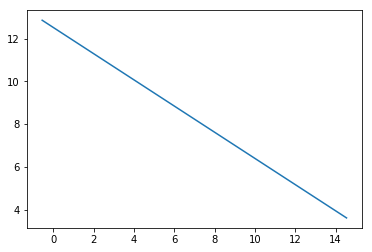

error value is [[0.20693509]]


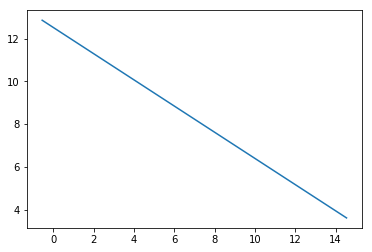

error value is [[0.20682291]]


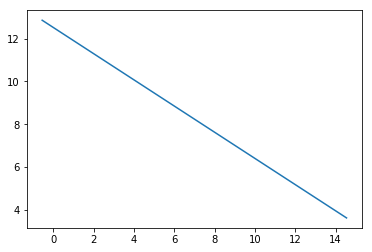

error value is [[0.2067109]]


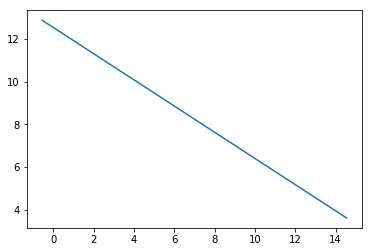

error value is [[0.20659906]]


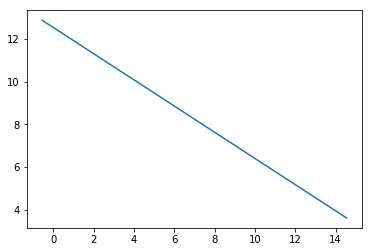

error value is [[0.20648739]]


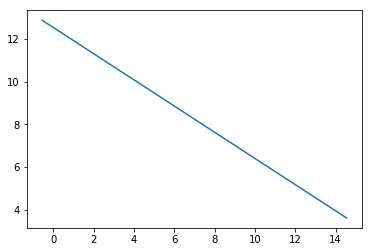

error value is [[0.20637589]]


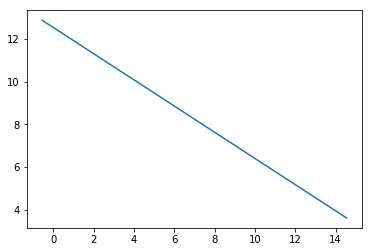

error value is [[0.20626456]]


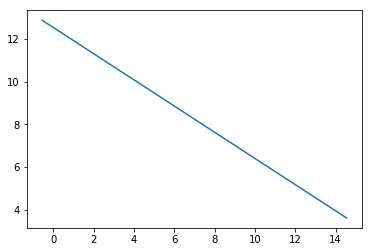

error value is [[0.20615339]]


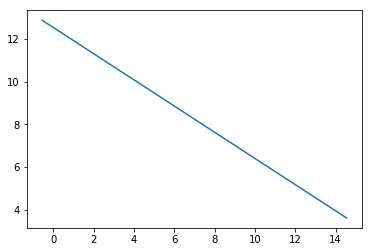

error value is [[0.2060424]]


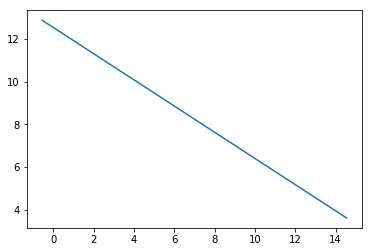

error value is [[0.20593157]]


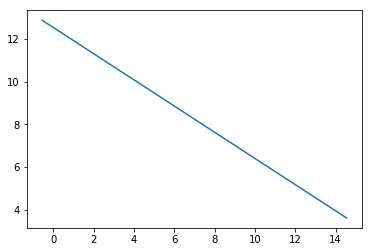

error value is [[0.20582091]]


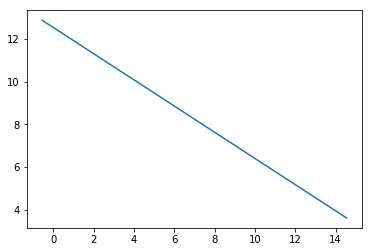

error value is [[0.20571042]]


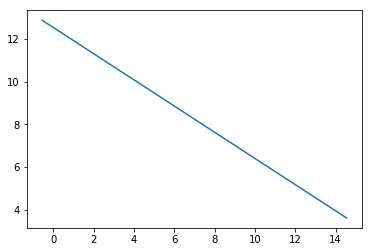

error value is [[0.20560009]]


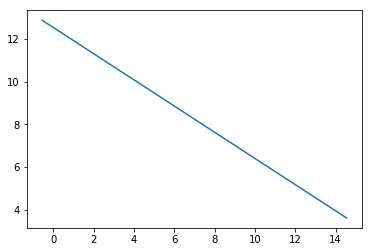

error value is [[0.20548993]]


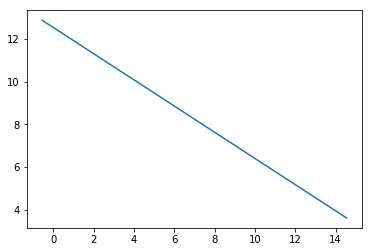

error value is [[0.20537994]]


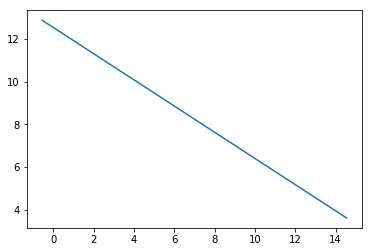

error value is [[0.20527011]]


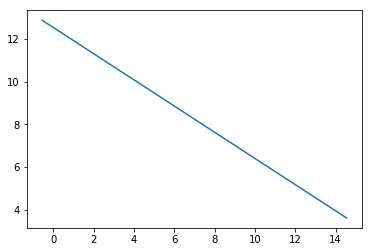

error value is [[0.20516045]]


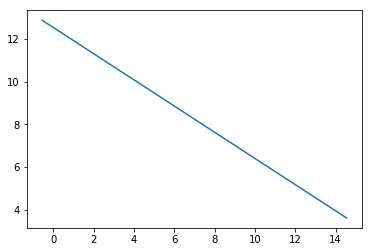

error value is [[0.20505095]]


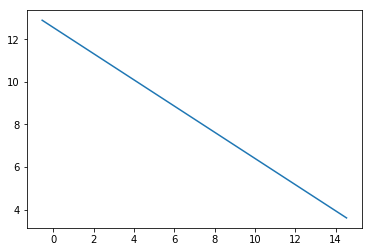

error value is [[0.20494162]]


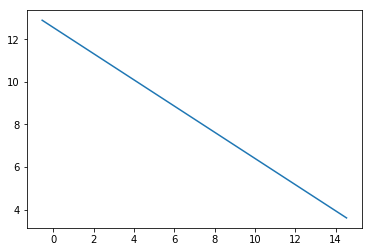

error value is [[0.20483245]]


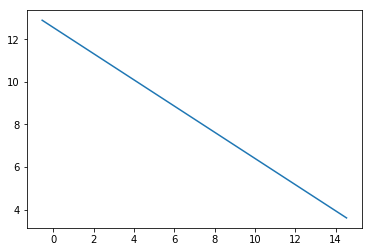

error value is [[0.20472344]]


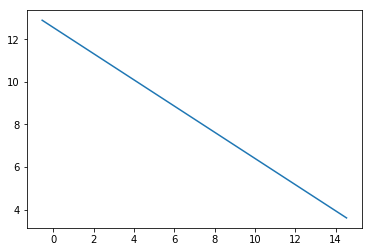

error value is [[0.2046146]]


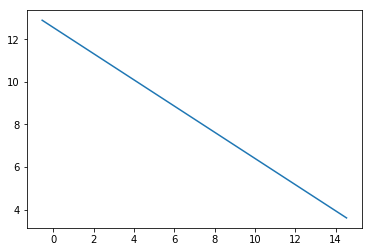

error value is [[0.20450592]]


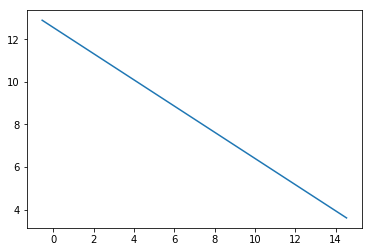

error value is [[0.2043974]]


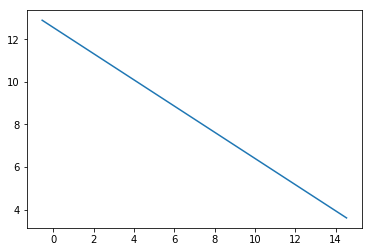

error value is [[0.20428905]]


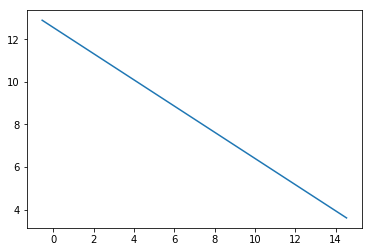

error value is [[0.20418085]]


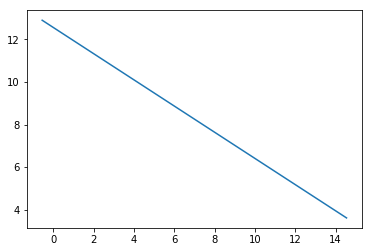

error value is [[0.20407282]]


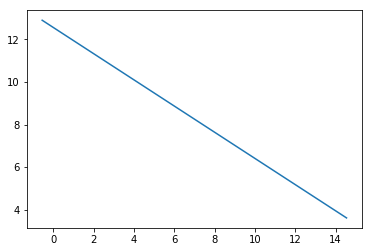

error value is [[0.20396495]]


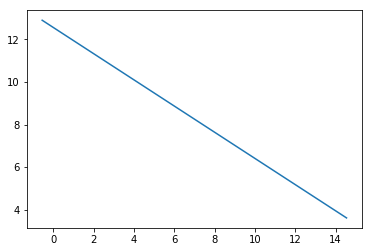

error value is [[0.20385724]]


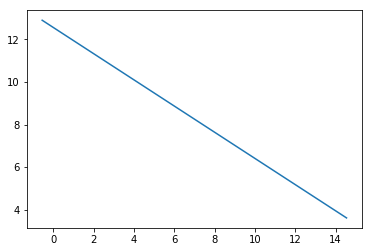

error value is [[0.20374969]]


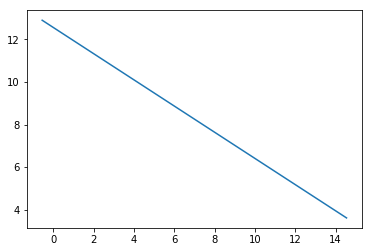

error value is [[0.2036423]]


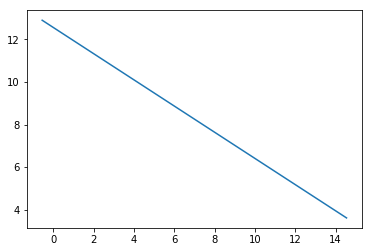

error value is [[0.20353507]]


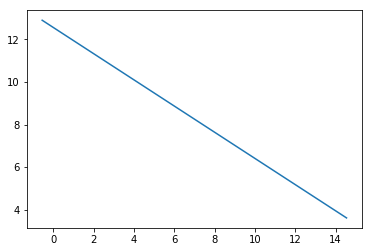

error value is [[0.203428]]


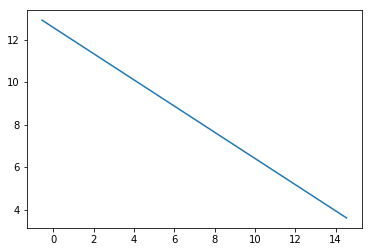

error value is [[0.20332109]]


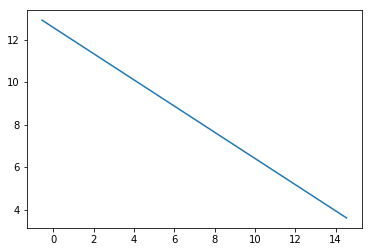

error value is [[0.20321433]]


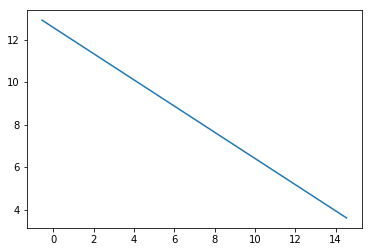

error value is [[0.20310774]]


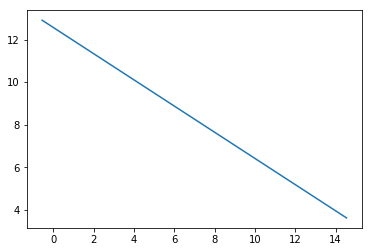

error value is [[0.2030013]]


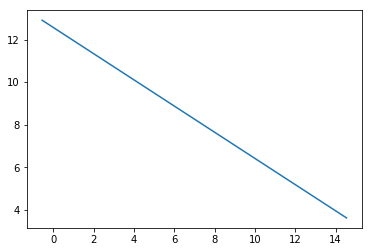

error value is [[0.20289502]]


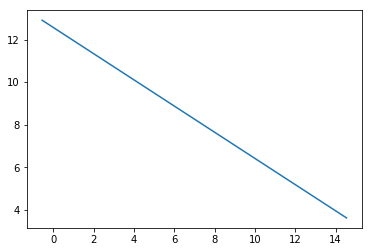

error value is [[0.2027889]]


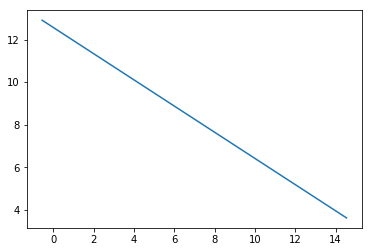

error value is [[0.20268293]]


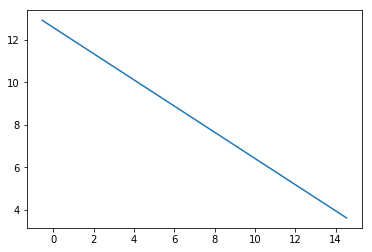

error value is [[0.20257712]]


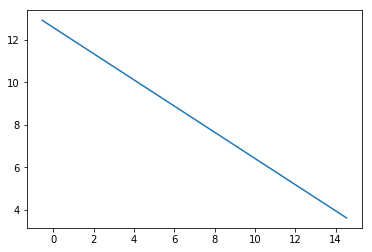

error value is [[0.20247146]]


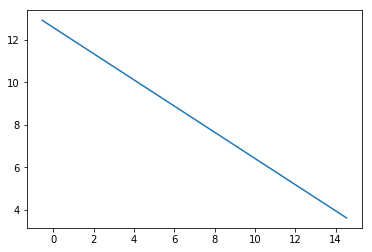

error value is [[0.20236597]]


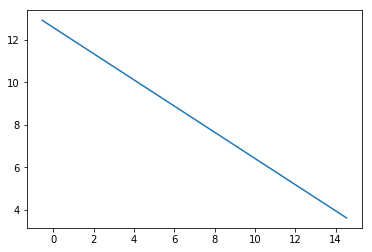

error value is [[0.20226062]]


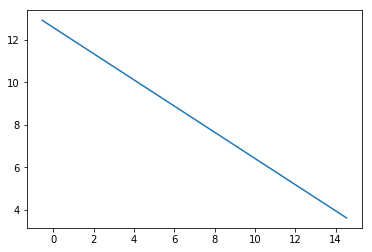

error value is [[0.20215543]]


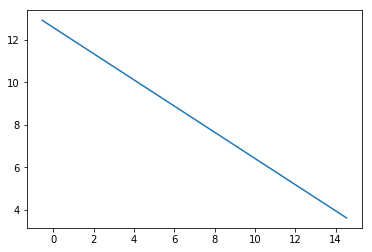

error value is [[0.2020504]]


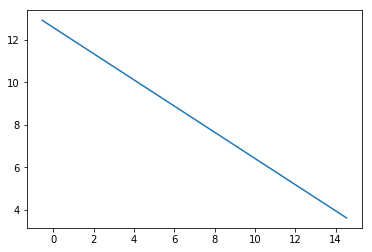

error value is [[0.20194552]]


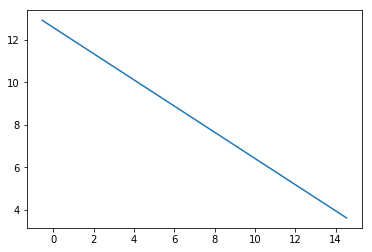

error value is [[0.20184079]]


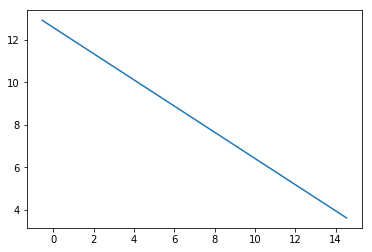

error value is [[0.20173622]]


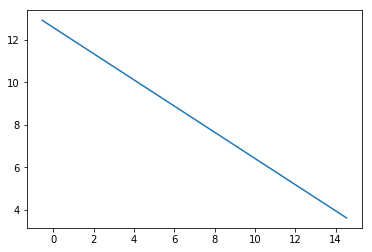

error value is [[0.2016318]]


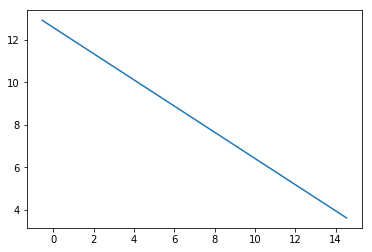

error value is [[0.20152754]]


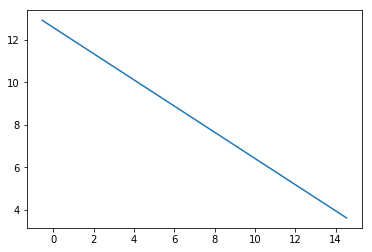

error value is [[0.20142342]]


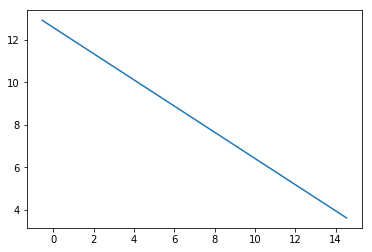

error value is [[0.20131946]]


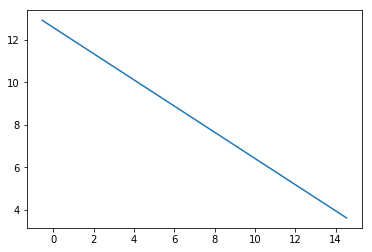

error value is [[0.20121565]]


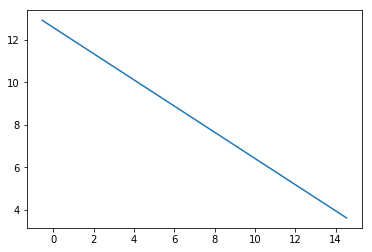

error value is [[0.20111199]]


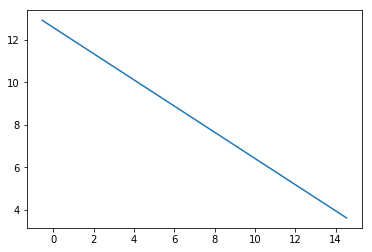

error value is [[0.20100849]]


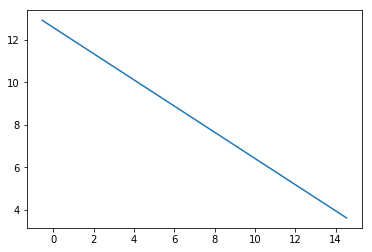

error value is [[0.20090513]]


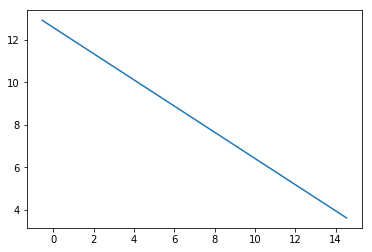

error value is [[0.20080192]]


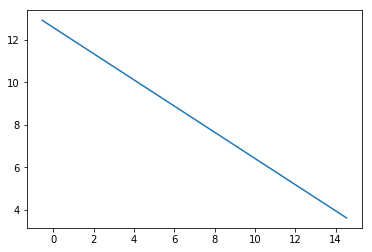

error value is [[0.20069887]]


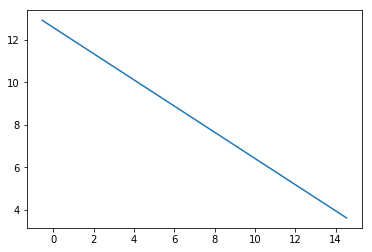

error value is [[0.20059596]]


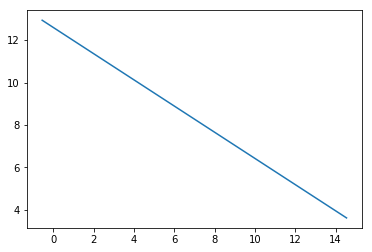

error value is [[0.20049321]]


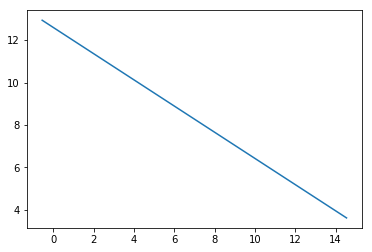

error value is [[0.2003906]]


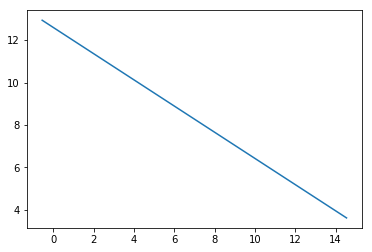

error value is [[0.20028814]]


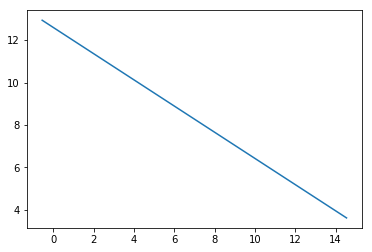

error value is [[0.20018583]]


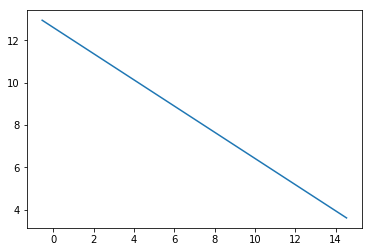

error value is [[0.20008367]]


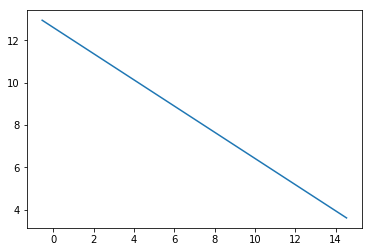

error value is [[0.19998165]]


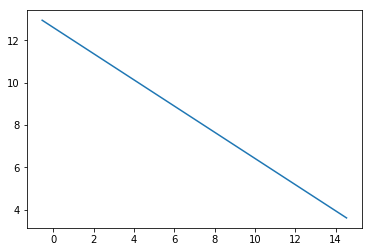

error value is [[0.19987979]]


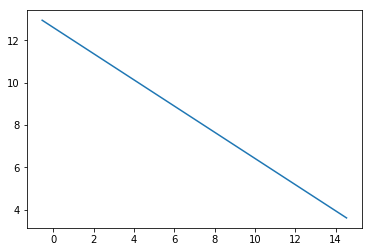

error value is [[0.19977807]]


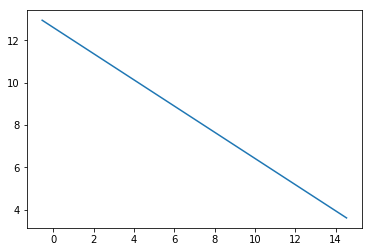

error value is [[0.1996765]]


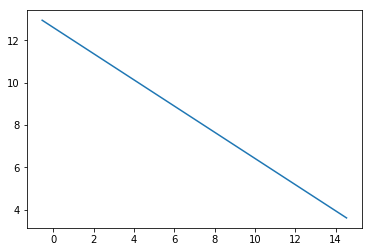

error value is [[0.19957507]]


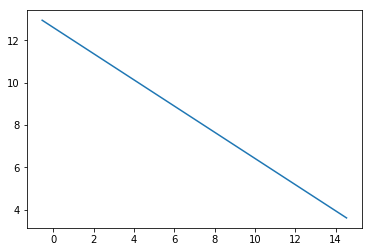

error value is [[0.19947379]]


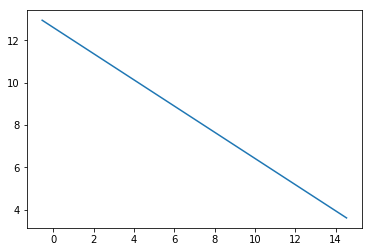

error value is [[0.19937266]]


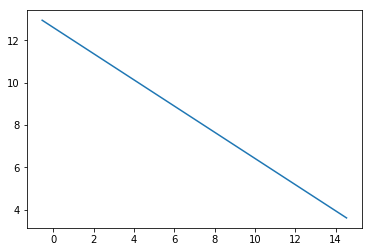

error value is [[0.19927167]]


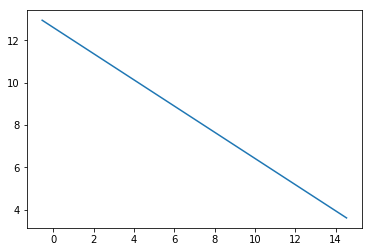

error value is [[0.19917082]]


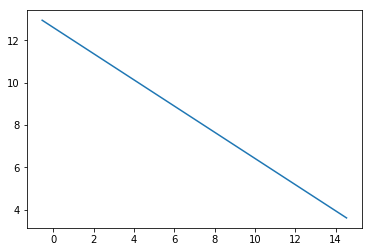

error value is [[0.19907012]]


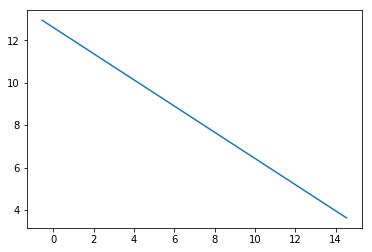

error value is [[0.19896957]]


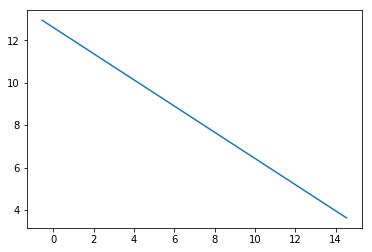

error value is [[0.19886916]]


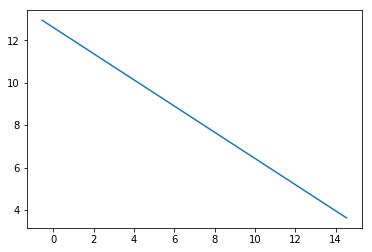

error value is [[0.1987689]]


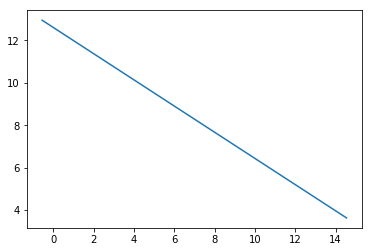

error value is [[0.19866877]]


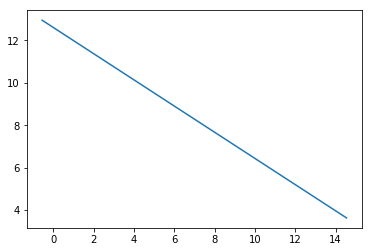

error value is [[0.19856879]]


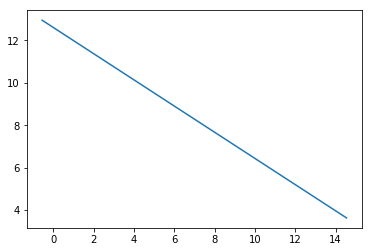

error value is [[0.19846896]]


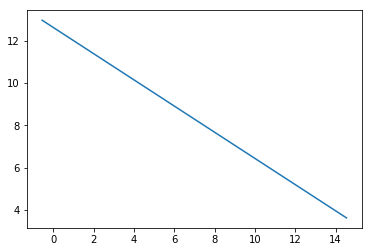

error value is [[0.19836926]]


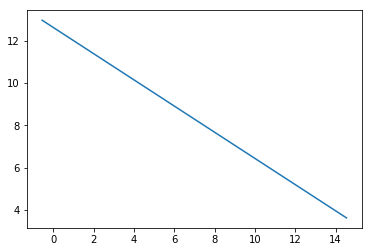

error value is [[0.19826971]]


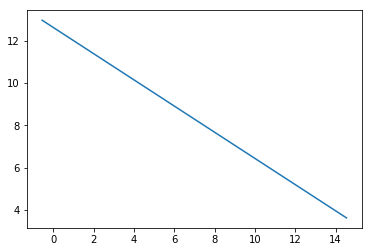

error value is [[0.1981703]]


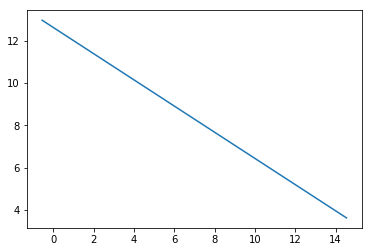

error value is [[0.19807104]]


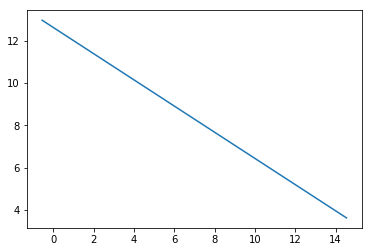

error value is [[0.19797191]]


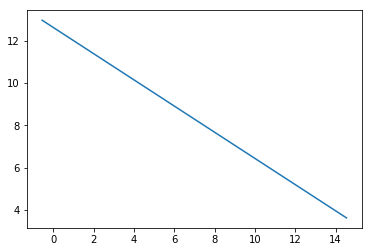

error value is [[0.19787293]]


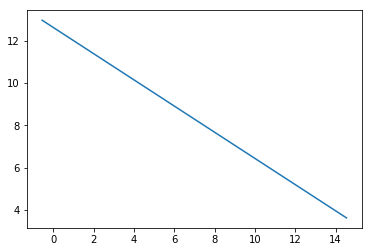

error value is [[0.19777408]]


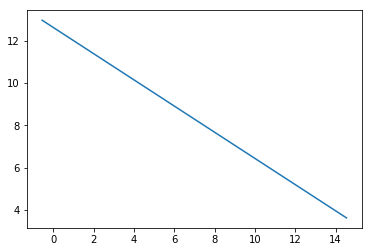

error value is [[0.19767538]]


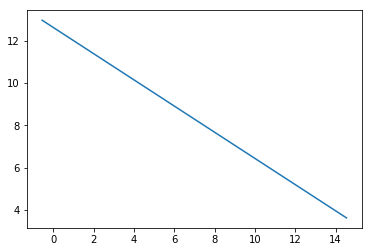

error value is [[0.19757682]]


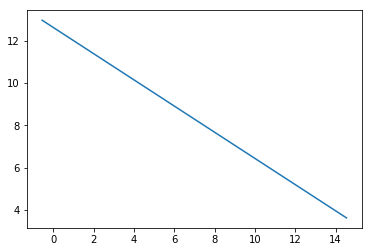

error value is [[0.19747839]]


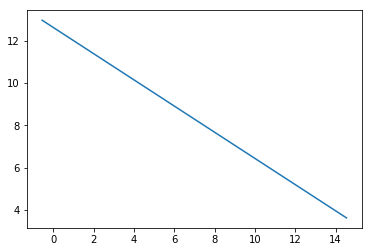

error value is [[0.19738011]]


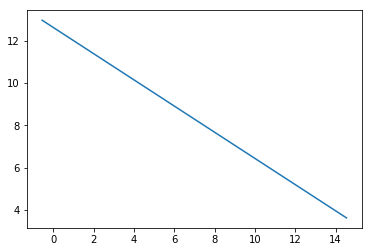

error value is [[0.19728196]]


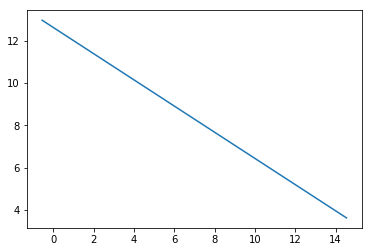

error value is [[0.19718396]]


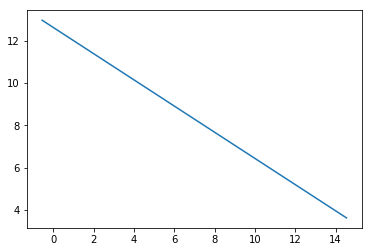

error value is [[0.19708609]]


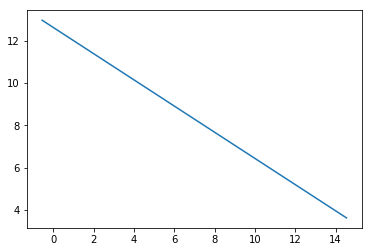

error value is [[0.19698836]]


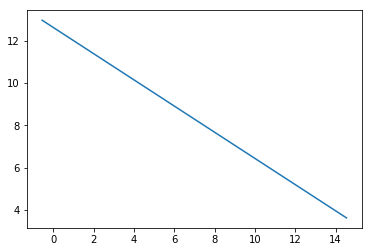

error value is [[0.19689077]]


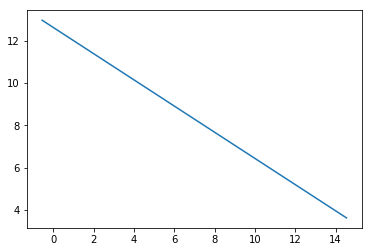

error value is [[0.19679332]]


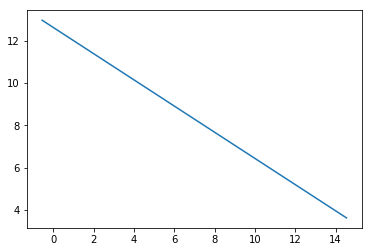

error value is [[0.196696]]


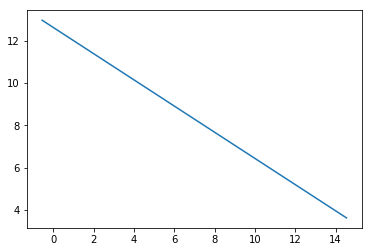

error value is [[0.19659883]]


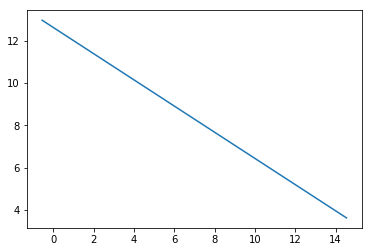

error value is [[0.19650178]]


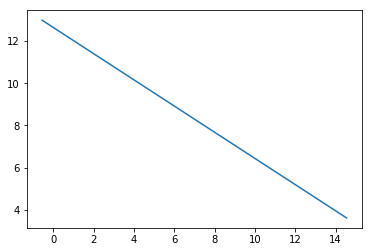

error value is [[0.19640488]]


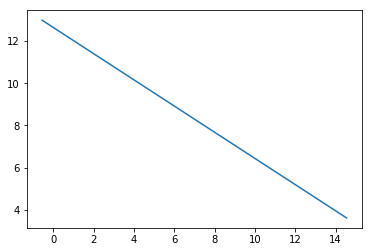

error value is [[0.19630811]]


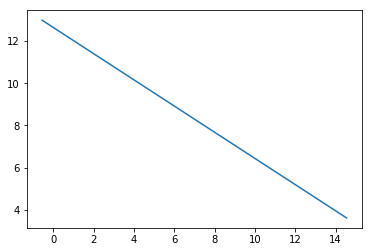

error value is [[0.19621148]]


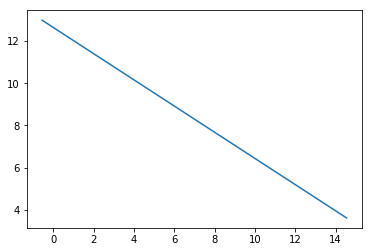

error value is [[0.19611498]]


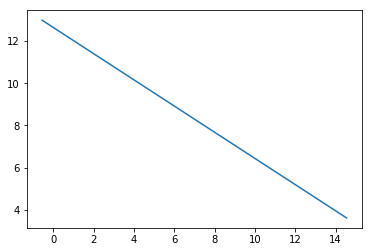

error value is [[0.19601862]]


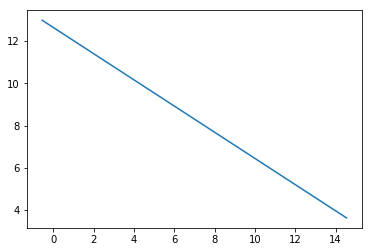

error value is [[0.19592239]]


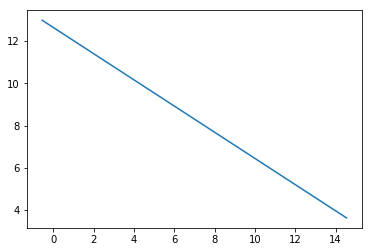

error value is [[0.1958263]]


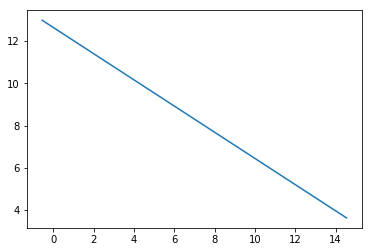

error value is [[0.19573035]]


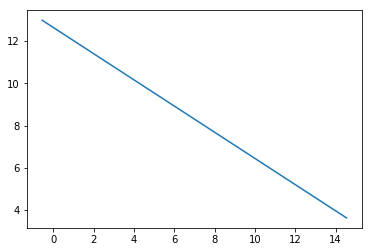

error value is [[0.19563452]]


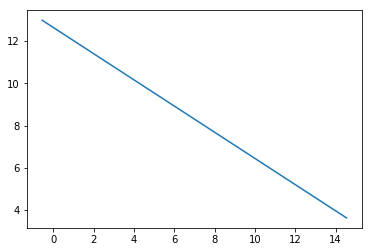

error value is [[0.19553883]]


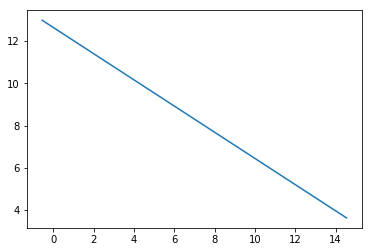

error value is [[0.19544328]]


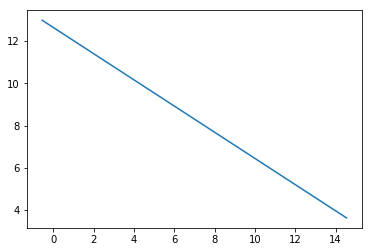

error value is [[0.19534786]]


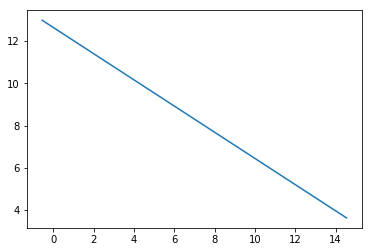

error value is [[0.19525257]]


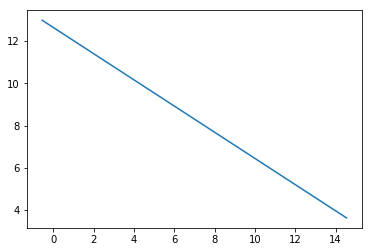

error value is [[0.19515741]]


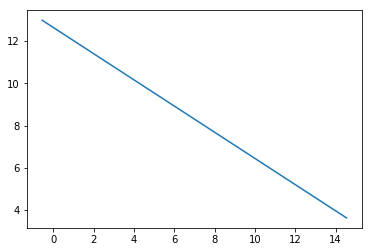

error value is [[0.19506239]]


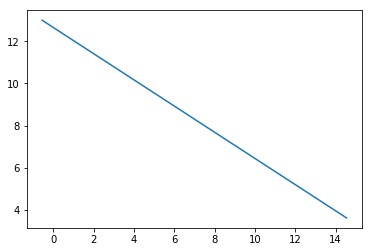

error value is [[0.1949675]]


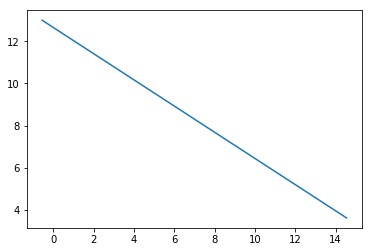

error value is [[0.19487274]]


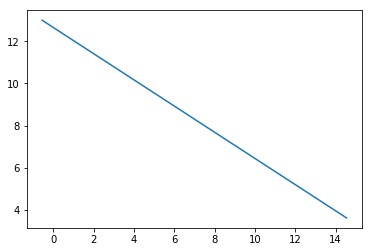

error value is [[0.19477811]]


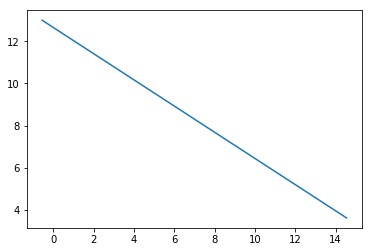

error value is [[0.19468361]]


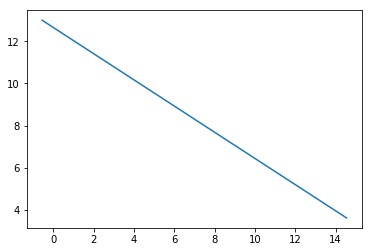

error value is [[0.19458925]]


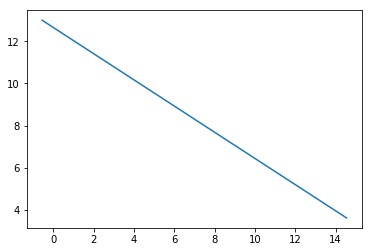

error value is [[0.19449501]]


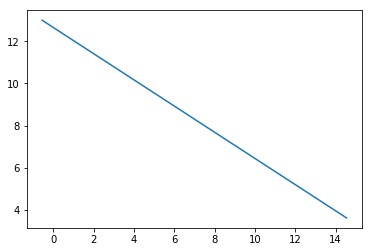

error value is [[0.19440091]]


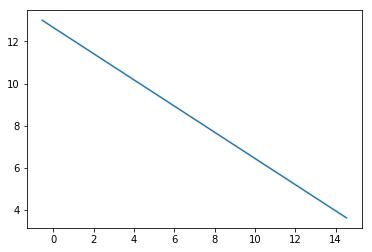

error value is [[0.19430693]]


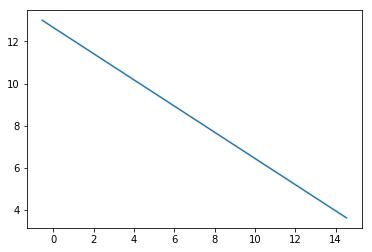

error value is [[0.19421309]]


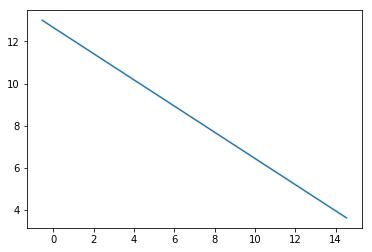

error value is [[0.19411938]]


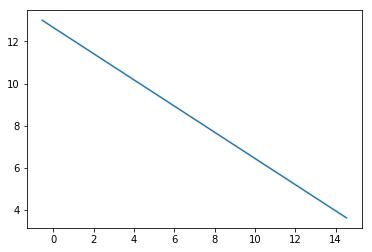

error value is [[0.19402579]]


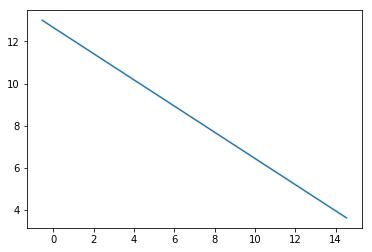

error value is [[0.19393234]]


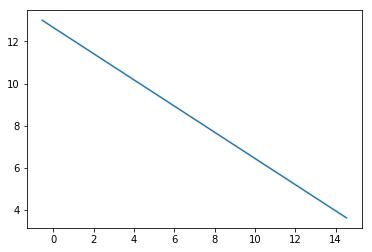

error value is [[0.19383901]]


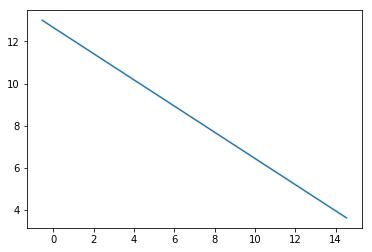

error value is [[0.19374581]]


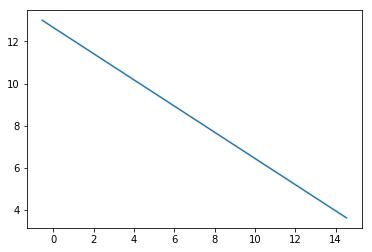

error value is [[0.19365274]]


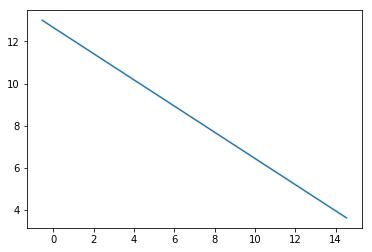

error value is [[0.1935598]]


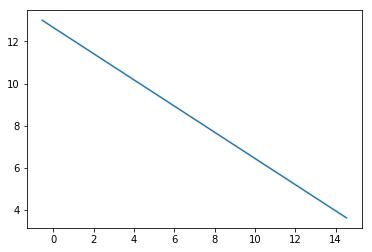

error value is [[0.19346699]]


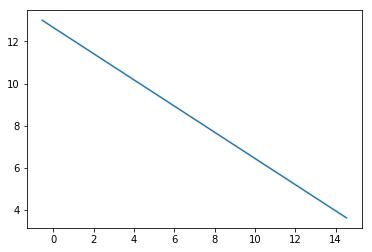

error value is [[0.1933743]]


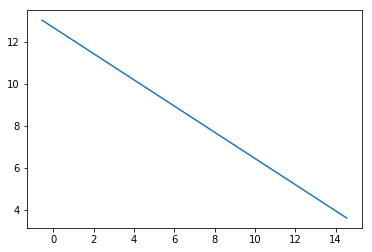

error value is [[0.19328174]]


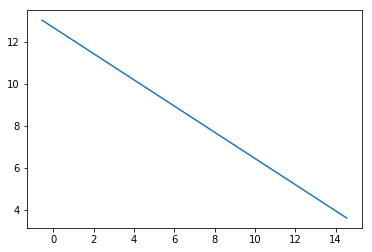

error value is [[0.19318931]]


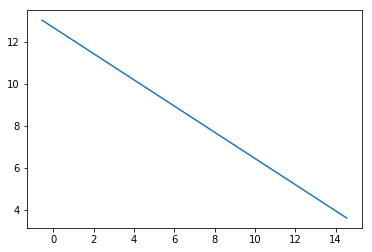

error value is [[0.193097]]


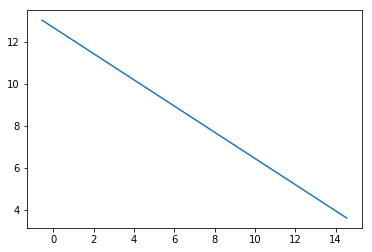

error value is [[0.19300482]]


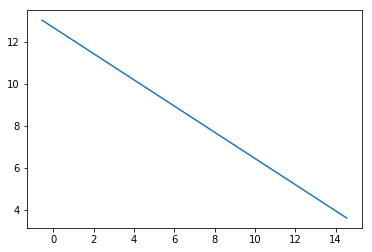

error value is [[0.19291277]]


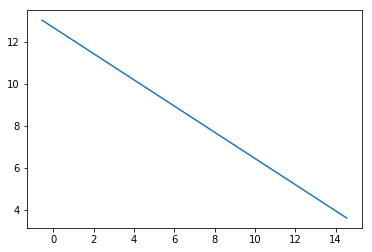

error value is [[0.19282084]]


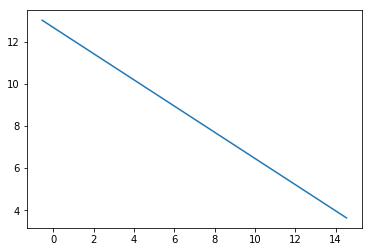

error value is [[0.19272904]]


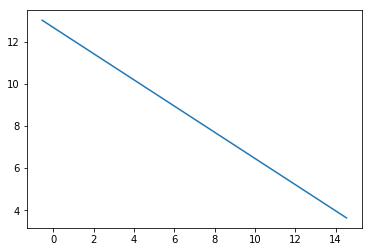

error value is [[0.19263736]]


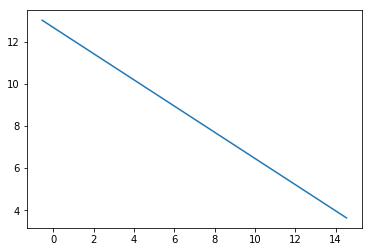

error value is [[0.19254581]]


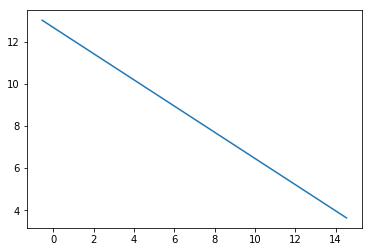

error value is [[0.19245439]]


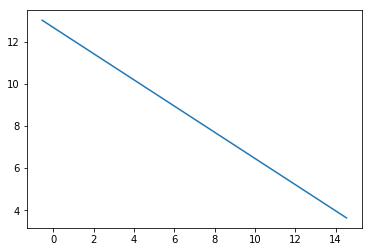

error value is [[0.19236309]]


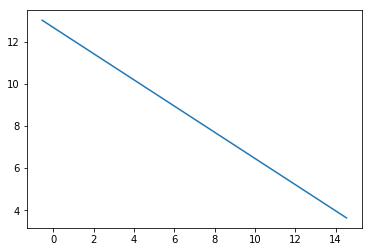

error value is [[0.19227191]]


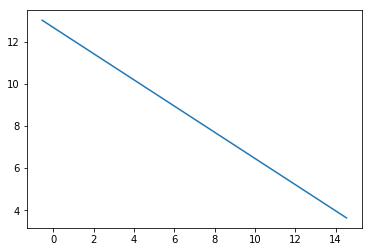

error value is [[0.19218085]]


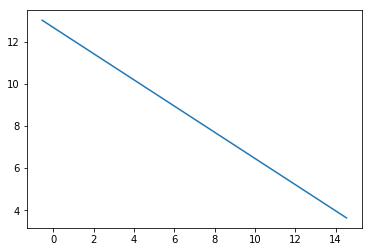

error value is [[0.19208993]]


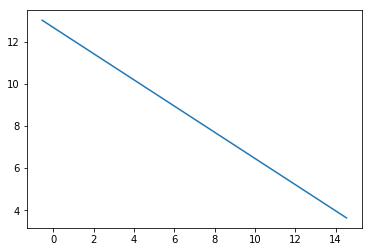

error value is [[0.19199912]]


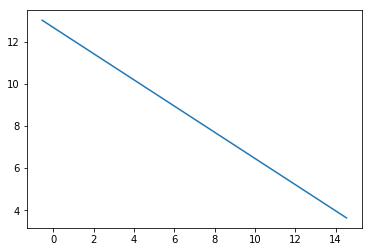

error value is [[0.19190844]]


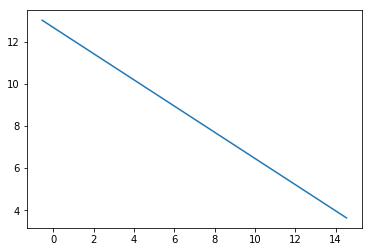

error value is [[0.19181788]]


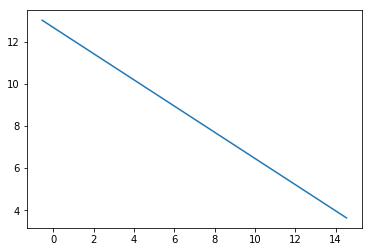

error value is [[0.19172744]]


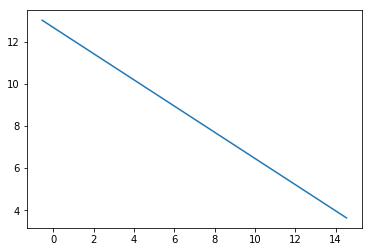

error value is [[0.19163713]]


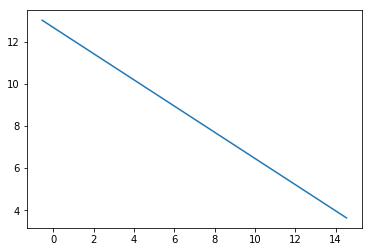

error value is [[0.19154693]]


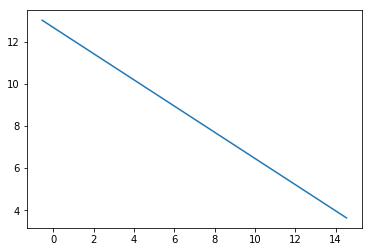

error value is [[0.19145686]]


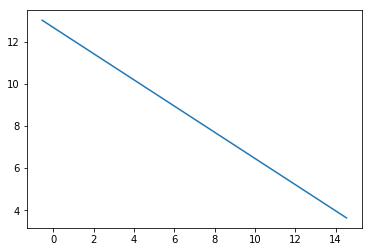

error value is [[0.19136691]]


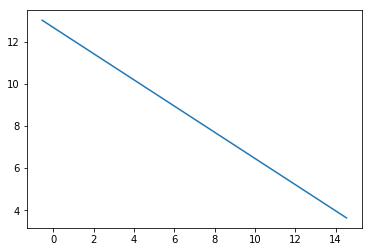

error value is [[0.19127709]]


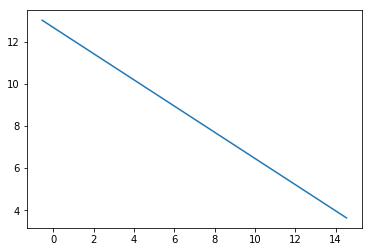

error value is [[0.19118738]]


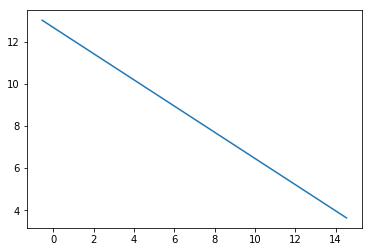

error value is [[0.1910978]]


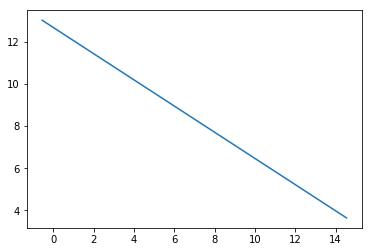

error value is [[0.19100833]]


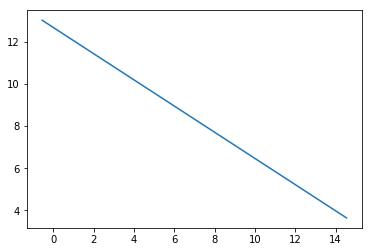

error value is [[0.19091899]]


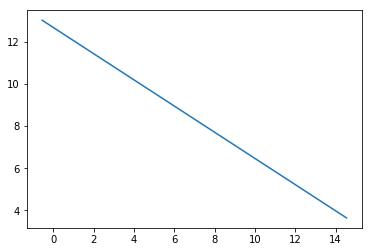

error value is [[0.19082977]]


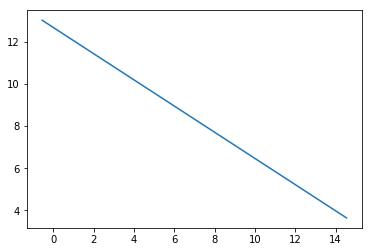

error value is [[0.19074066]]


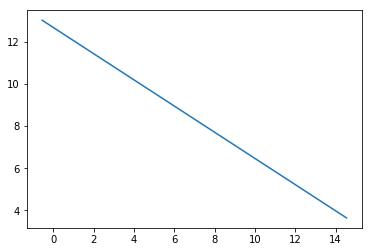

error value is [[0.19065168]]


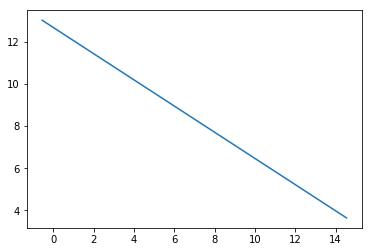

error value is [[0.19056282]]


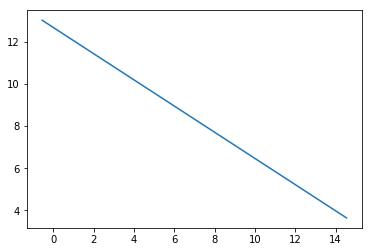

error value is [[0.19047407]]


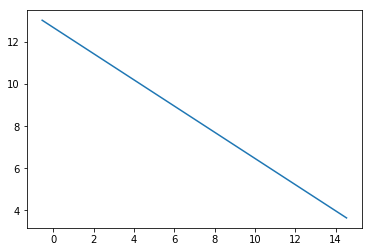

error value is [[0.19038544]]


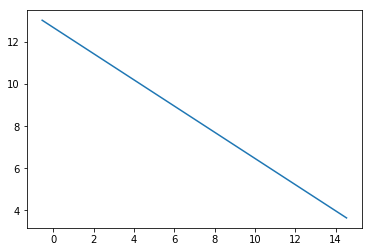

error value is [[0.19029694]]


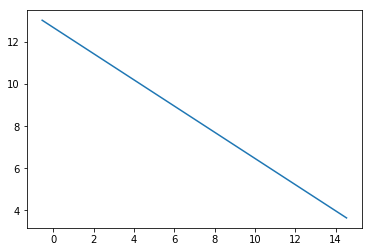

error value is [[0.19020855]]


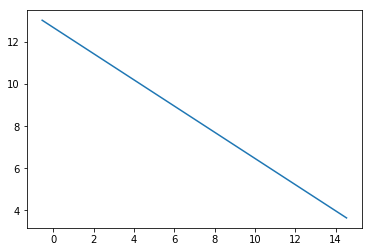

error value is [[0.19012028]]


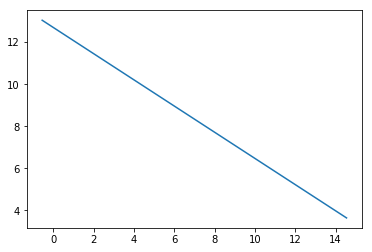

error value is [[0.19003213]]


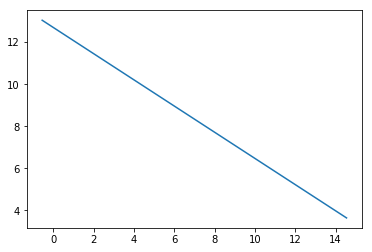

error value is [[0.18994409]]


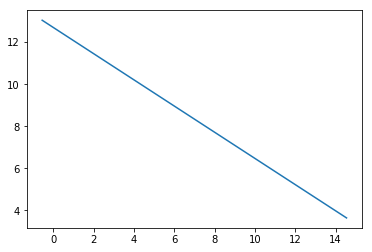

error value is [[0.18985617]]


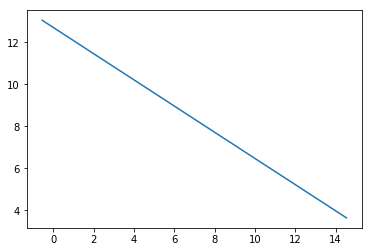

error value is [[0.18976837]]


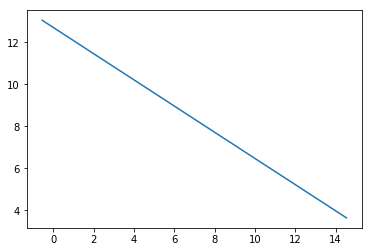

error value is [[0.18968069]]


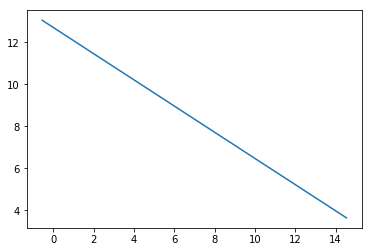

error value is [[0.18959312]]


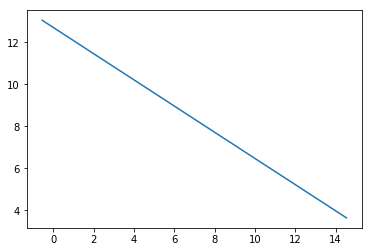

error value is [[0.18950568]]


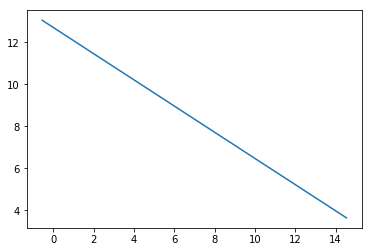

error value is [[0.18941834]]


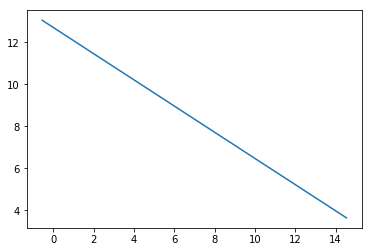

error value is [[0.18933112]]


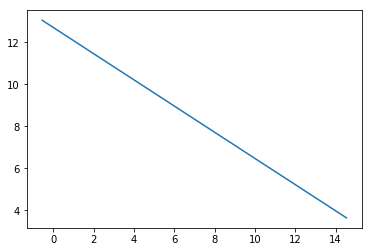

error value is [[0.18924402]]


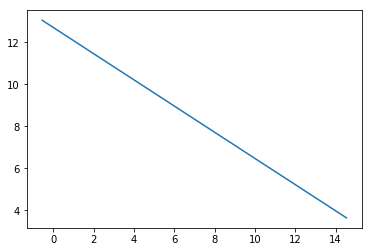

error value is [[0.18915704]]


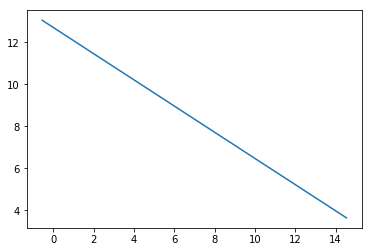

error value is [[0.18907017]]


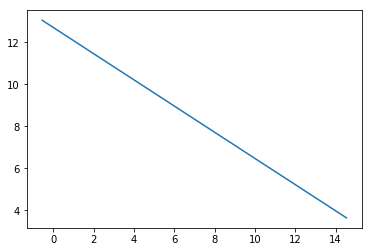

error value is [[0.18898341]]


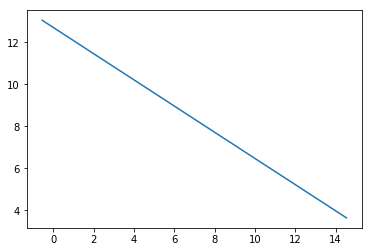

error value is [[0.18889677]]


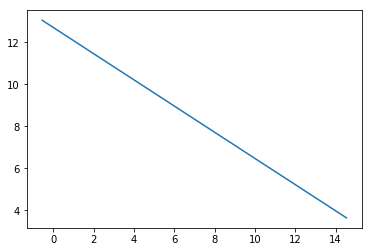

error value is [[0.18881025]]


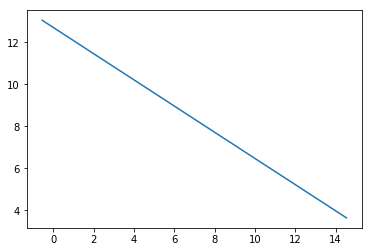

error value is [[0.18872383]]


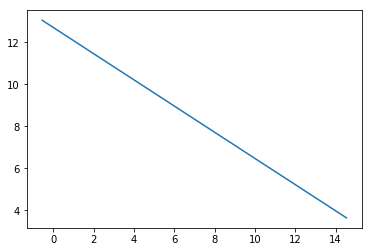

error value is [[0.18863754]]


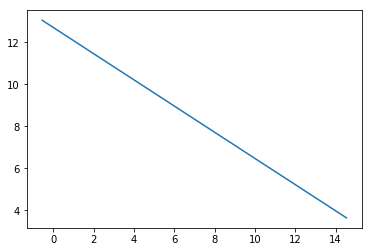

error value is [[0.18855135]]


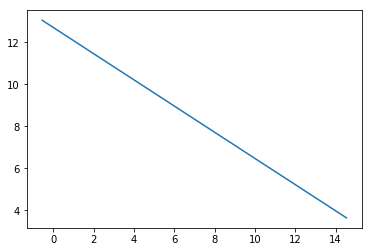

error value is [[0.18846529]]


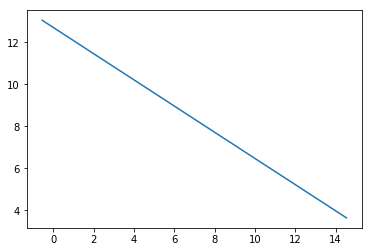

error value is [[0.18837933]]


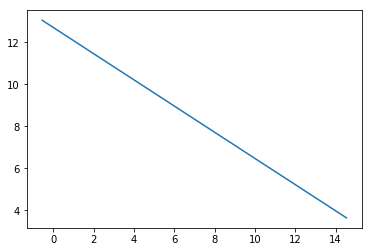

error value is [[0.18829349]]


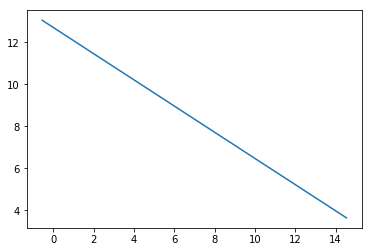

error value is [[0.18820776]]


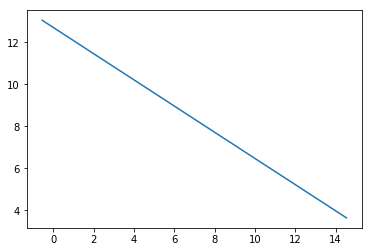

error value is [[0.18812214]]


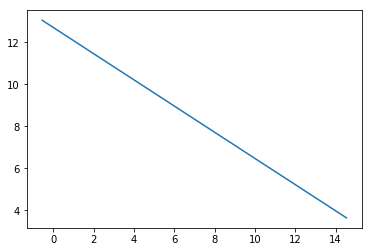

error value is [[0.18803664]]


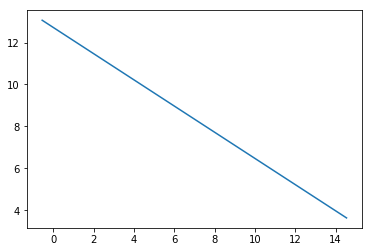

error value is [[0.18795124]]


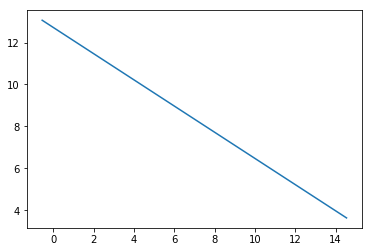

error value is [[0.18786596]]


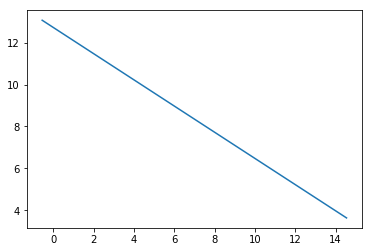

error value is [[0.1877808]]


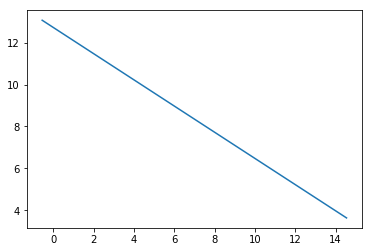

error value is [[0.18769574]]


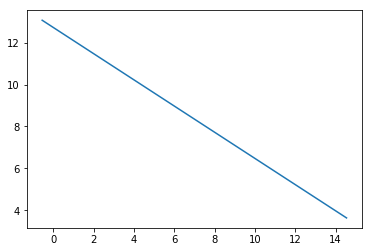

error value is [[0.1876108]]


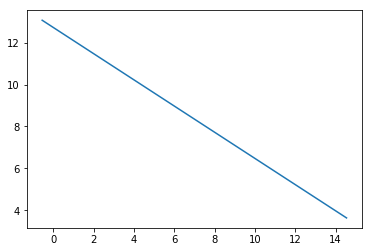

error value is [[0.18752596]]


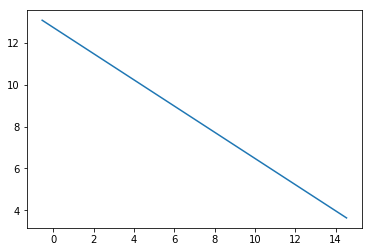

error value is [[0.18744124]]


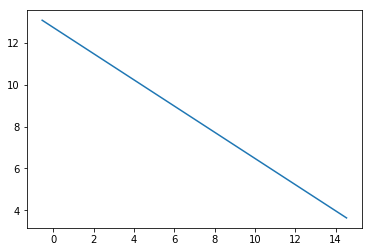

error value is [[0.18735663]]


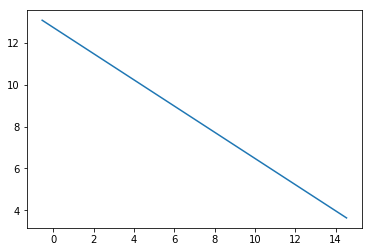

error value is [[0.18727213]]


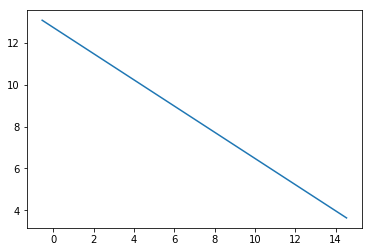

error value is [[0.18718773]]


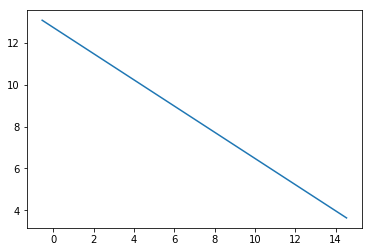

error value is [[0.18710345]]


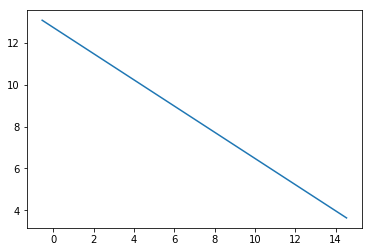

error value is [[0.18701928]]


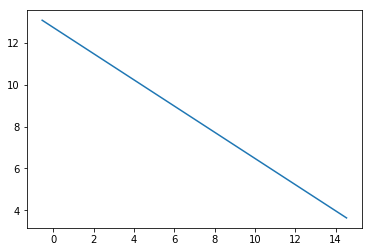

error value is [[0.18693522]]


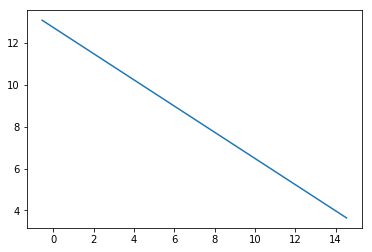

error value is [[0.18685127]]


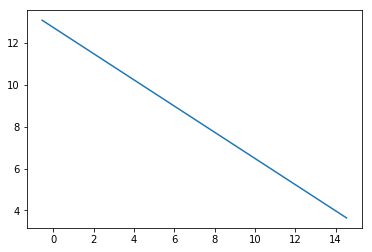

error value is [[0.18676743]]


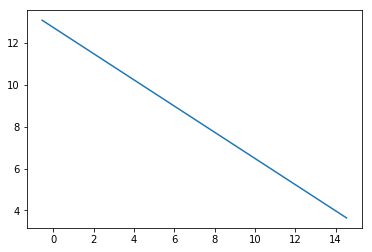

error value is [[0.18668369]]


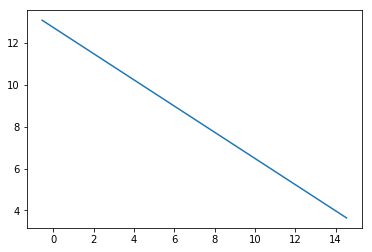

error value is [[0.18660007]]


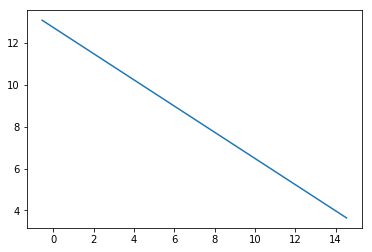

error value is [[0.18651655]]


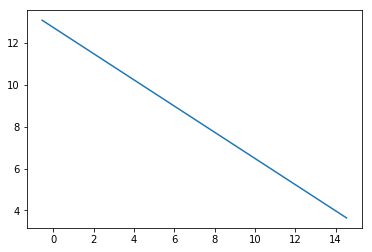

error value is [[0.18643314]]


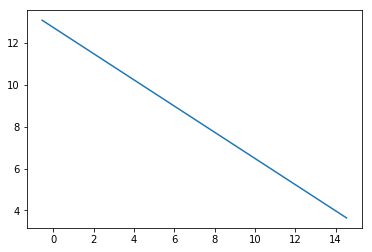

error value is [[0.18634984]]


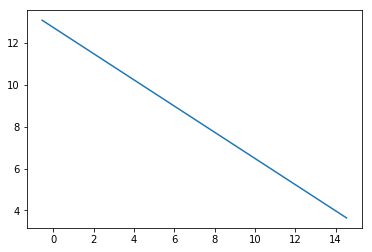

error value is [[0.18626665]]


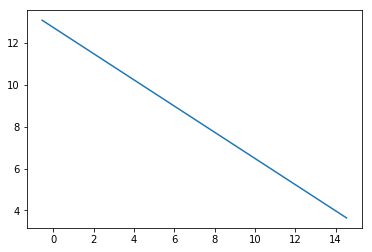

error value is [[0.18618357]]


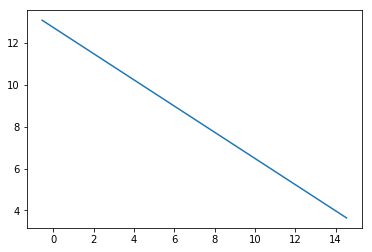

error value is [[0.18610059]]


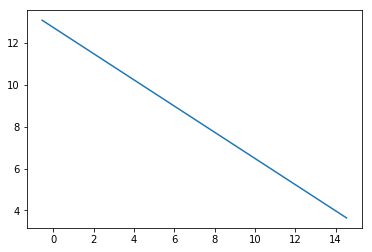

error value is [[0.18601772]]


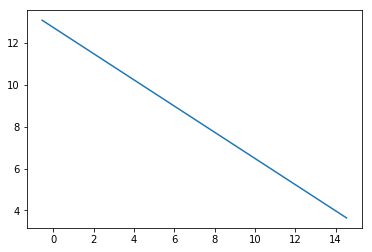

error value is [[0.18593496]]


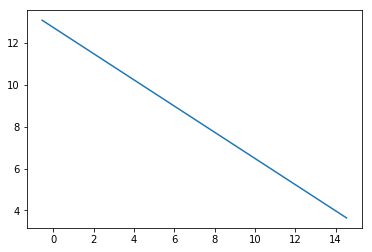

error value is [[0.1858523]]


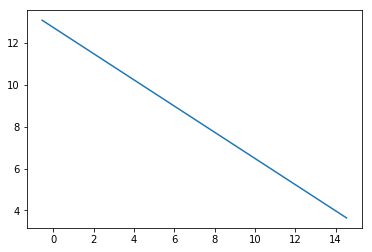

error value is [[0.18576975]]


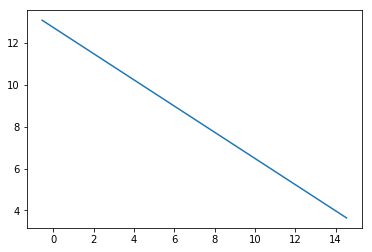

error value is [[0.18568731]]


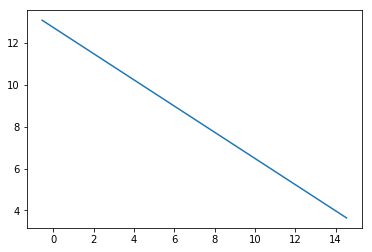

error value is [[0.18560497]]


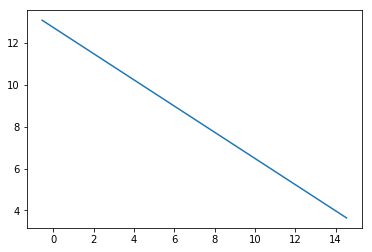

error value is [[0.18552274]]


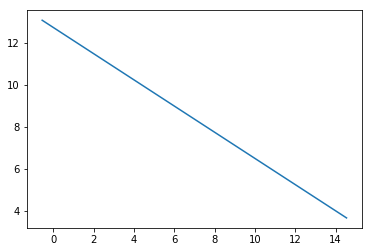

error value is [[0.18544061]]


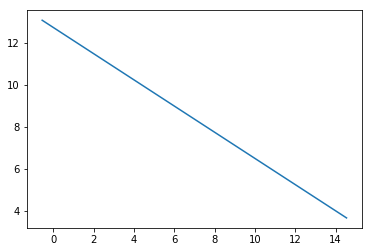

error value is [[0.1853586]]


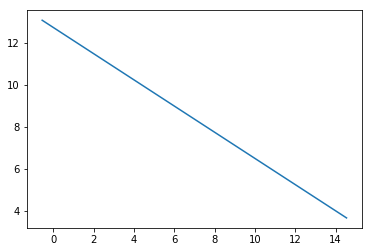

error value is [[0.18527668]]


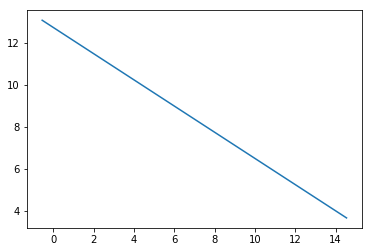

error value is [[0.18519487]]


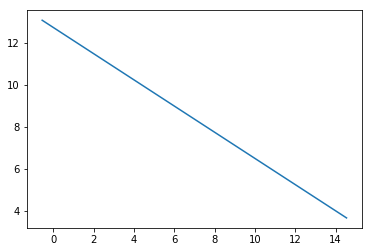

error value is [[0.18511317]]


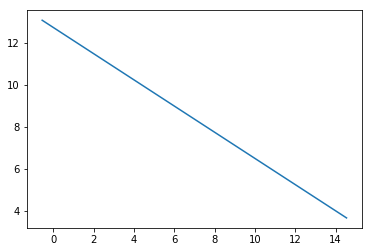

error value is [[0.18503157]]


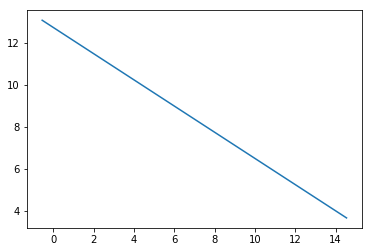

error value is [[0.18495007]]


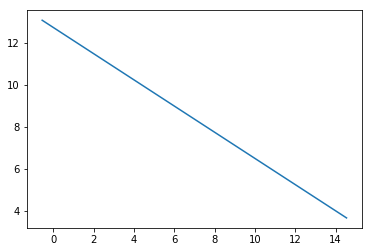

error value is [[0.18486868]]


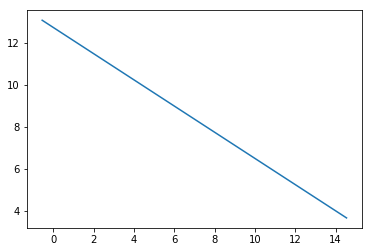

error value is [[0.1847874]]


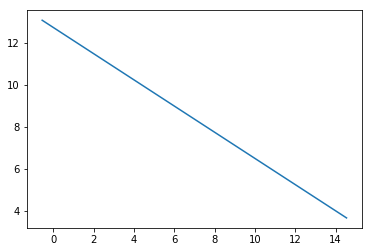

error value is [[0.18470621]]


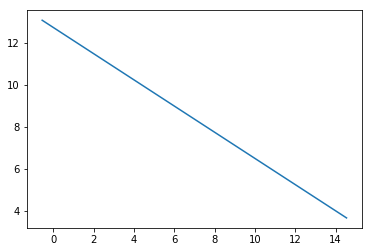

error value is [[0.18462514]]


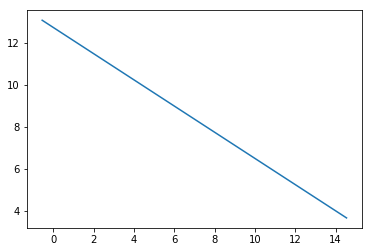

error value is [[0.18454416]]


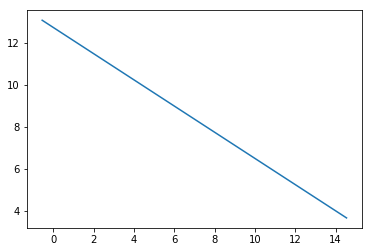

error value is [[0.18446329]]


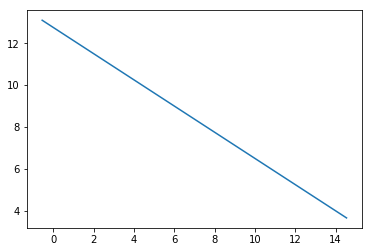

error value is [[0.18438252]]


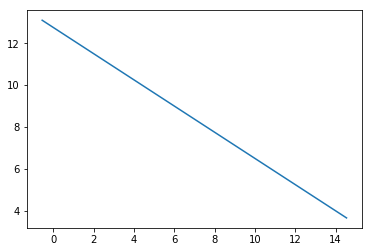

error value is [[0.18430185]]


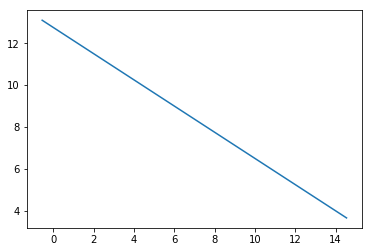

error value is [[0.18422129]]


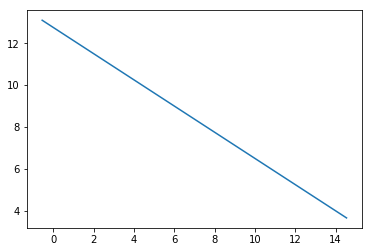

error value is [[0.18414083]]


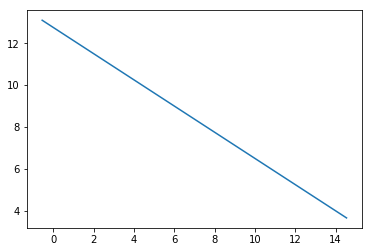

error value is [[0.18406047]]


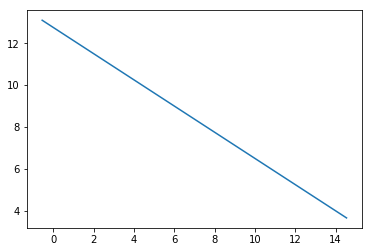

error value is [[0.18398021]]


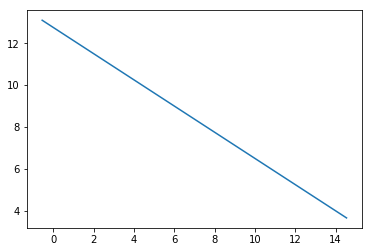

error value is [[0.18390006]]


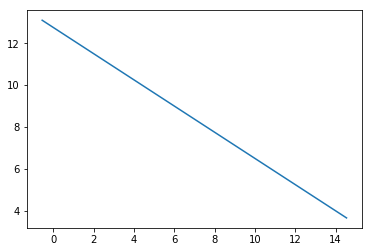

error value is [[0.18382]]


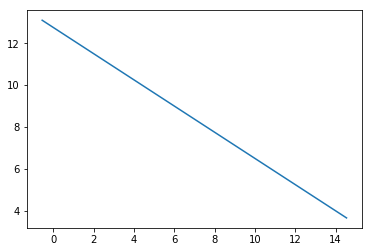

error value is [[0.18374005]]


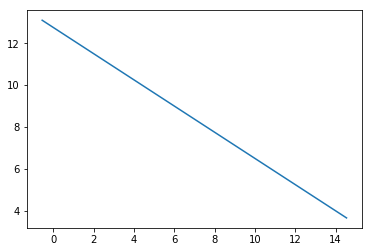

error value is [[0.1836602]]


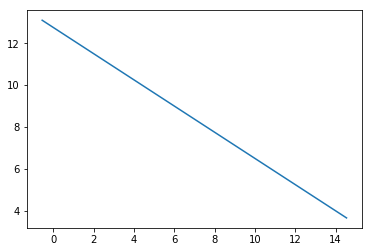

error value is [[0.18358045]]


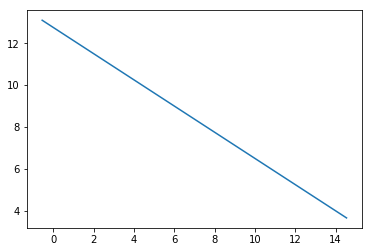

error value is [[0.1835008]]


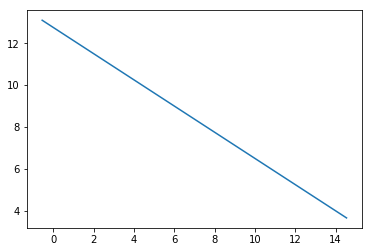

error value is [[0.18342126]]


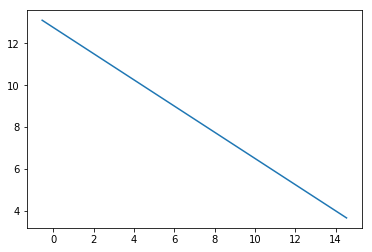

error value is [[0.18334181]]


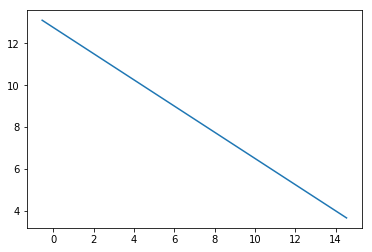

error value is [[0.18326246]]


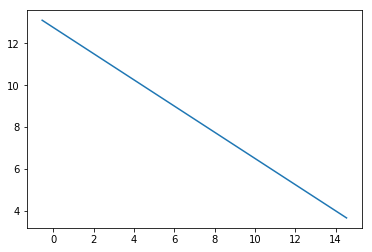

error value is [[0.18318321]]


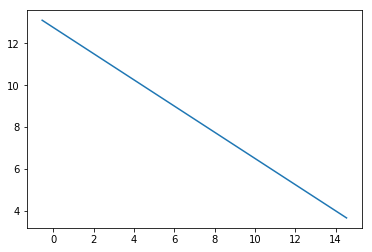

error value is [[0.18310407]]


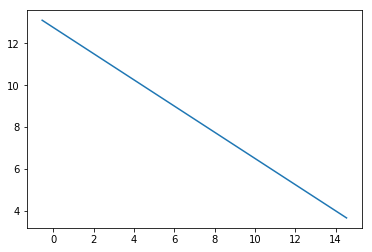

error value is [[0.18302502]]


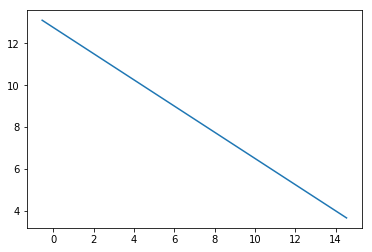

error value is [[0.18294607]]


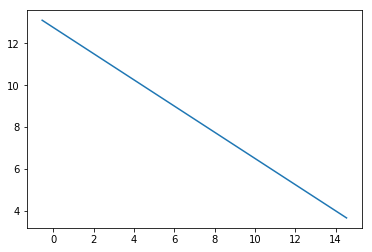

error value is [[0.18286722]]


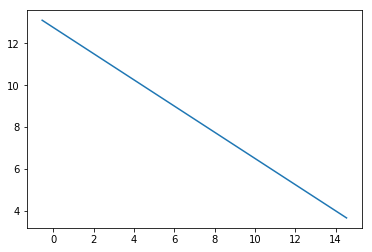

error value is [[0.18278847]]


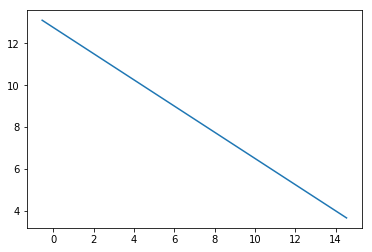

error value is [[0.18270982]]


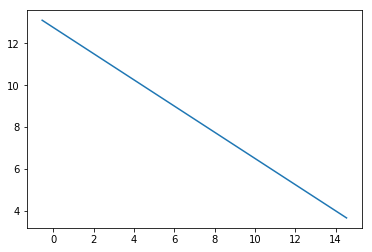

error value is [[0.18263127]]


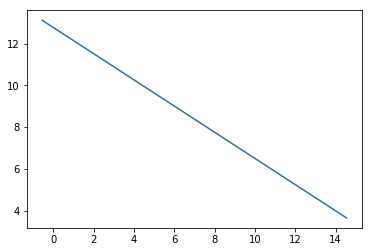

error value is [[0.18255282]]


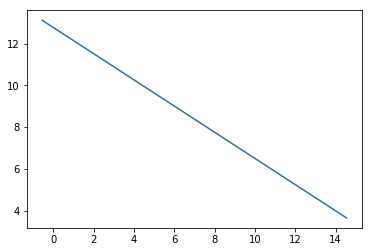

error value is [[0.18247446]]


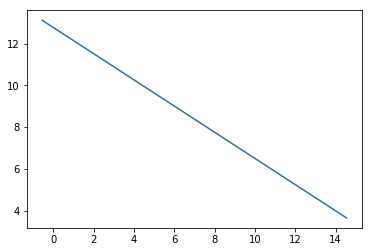

error value is [[0.1823962]]


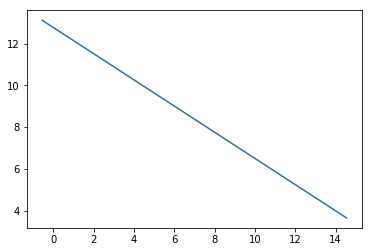

error value is [[0.18231804]]


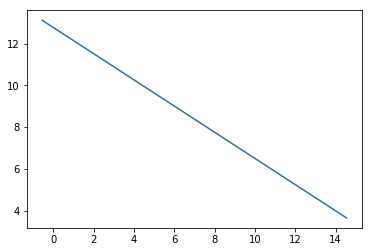

error value is [[0.18223998]]


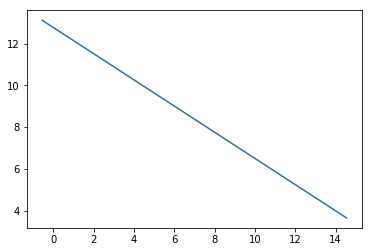

error value is [[0.18216202]]


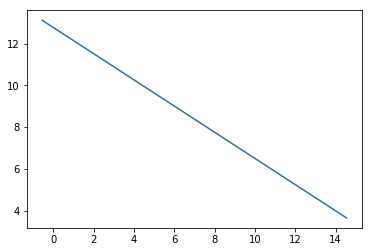

error value is [[0.18208415]]


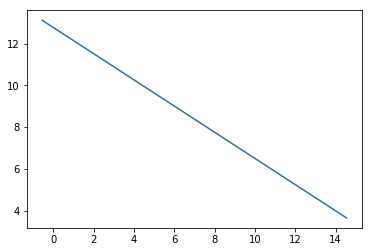

error value is [[0.18200638]]


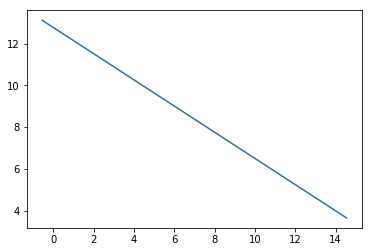

error value is [[0.18192871]]


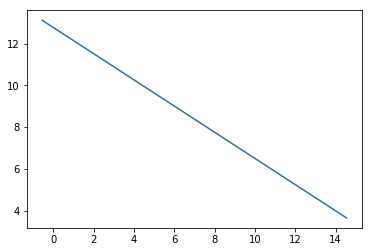

error value is [[0.18185114]]


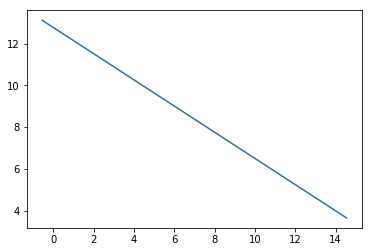

error value is [[0.18177366]]


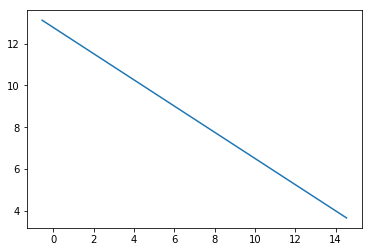

error value is [[0.18169628]]


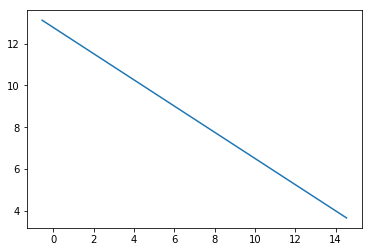

error value is [[0.18161899]]


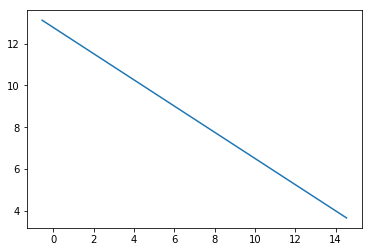

error value is [[0.1815418]]


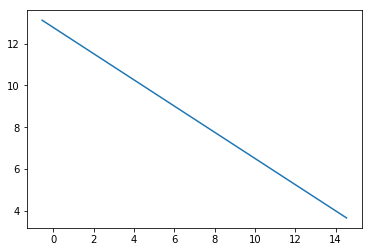

error value is [[0.18146471]]


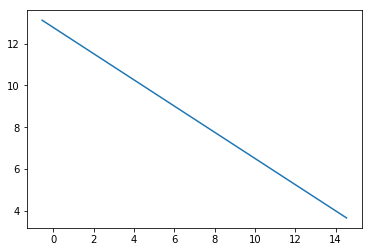

error value is [[0.18138771]]


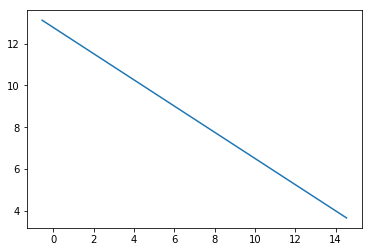

error value is [[0.18131081]]


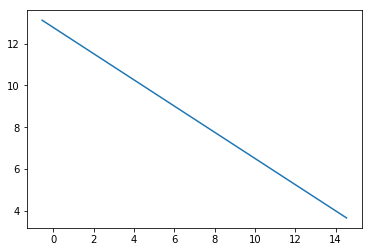

error value is [[0.181234]]


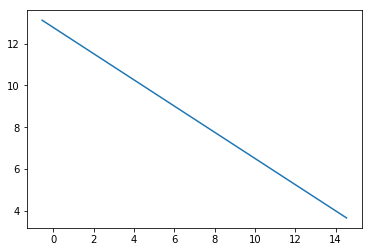

error value is [[0.18115729]]


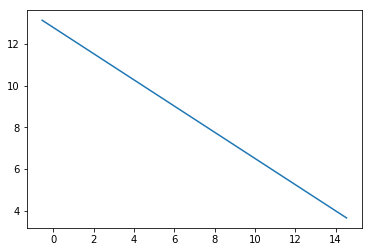

error value is [[0.18108067]]


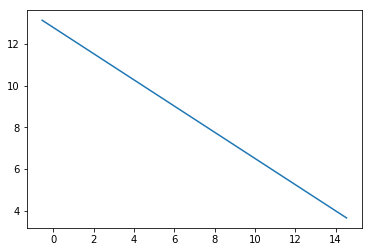

error value is [[0.18100415]]


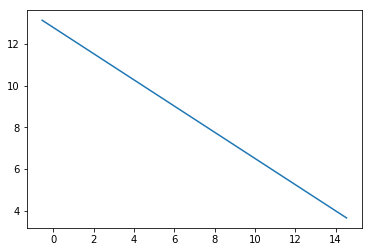

error value is [[0.18092772]]


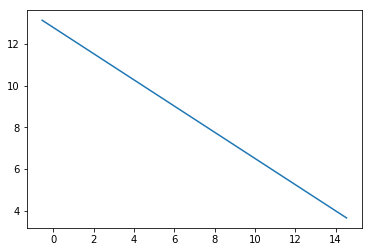

error value is [[0.18085138]]


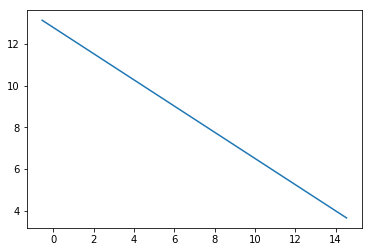

error value is [[0.18077515]]


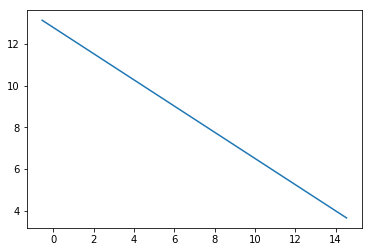

error value is [[0.180699]]


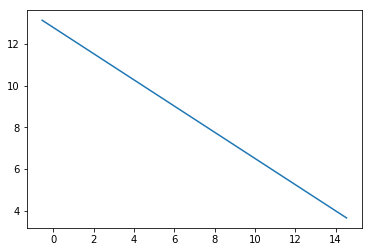

error value is [[0.18062295]]


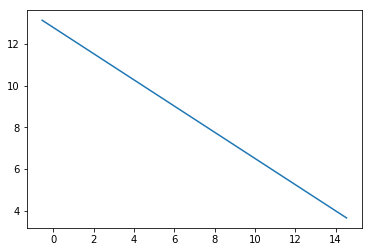

error value is [[0.18054699]]


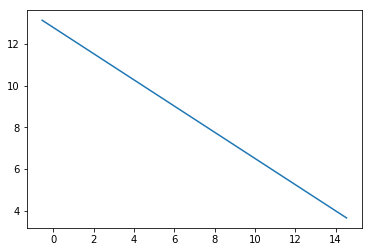

error value is [[0.18047113]]


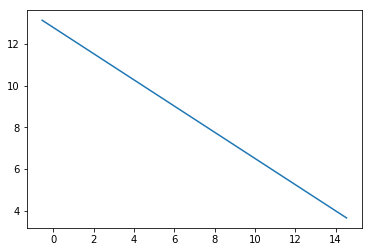

error value is [[0.18039536]]


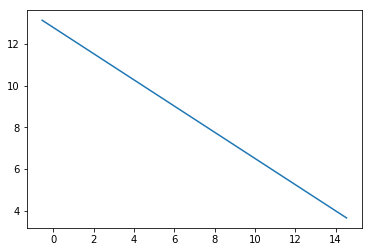

error value is [[0.18031968]]


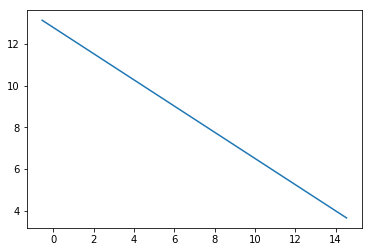

error value is [[0.1802441]]


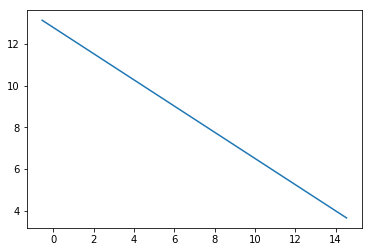

error value is [[0.1801686]]


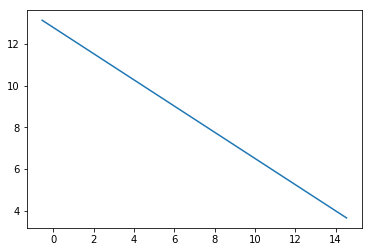

error value is [[0.1800932]]


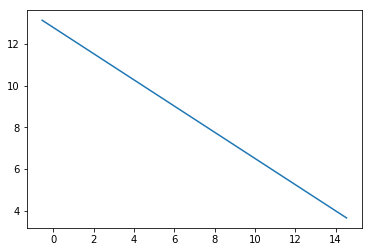

error value is [[0.1800179]]


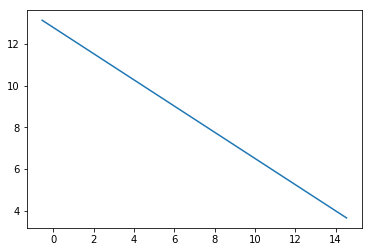

error value is [[0.17994268]]


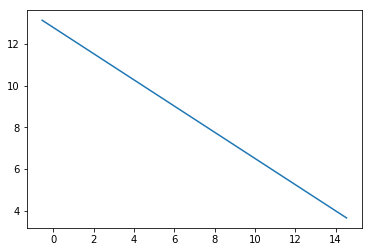

error value is [[0.17986756]]


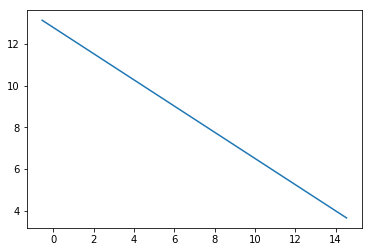

error value is [[0.17979253]]


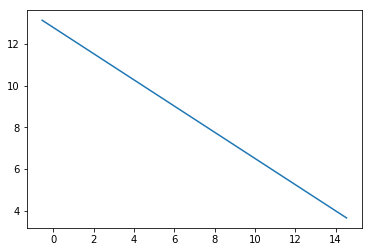

error value is [[0.17971759]]


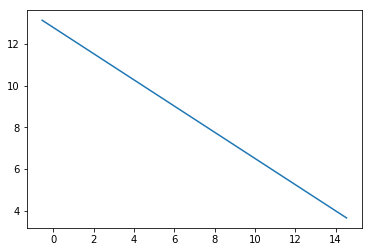

error value is [[0.17964275]]


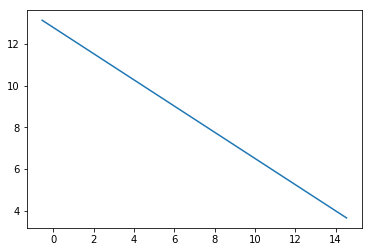

error value is [[0.17956799]]


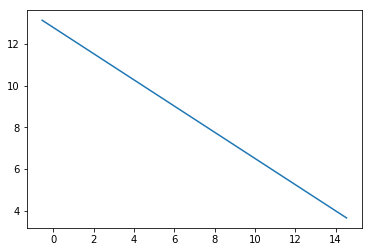

error value is [[0.17949333]]


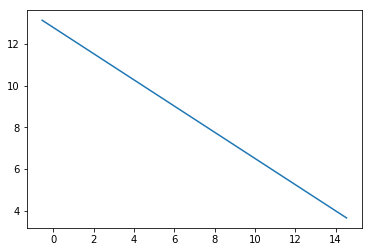

error value is [[0.17941875]]


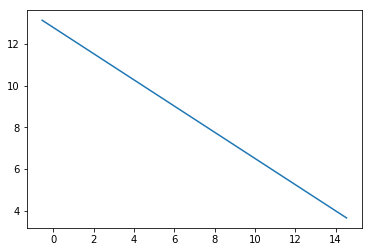

error value is [[0.17934427]]


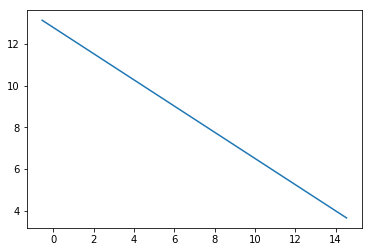

error value is [[0.17926988]]


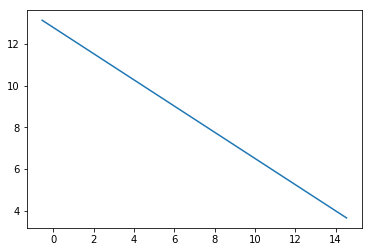

error value is [[0.17919558]]


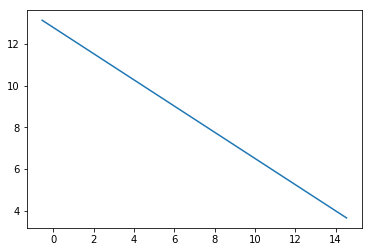

error value is [[0.17912137]]


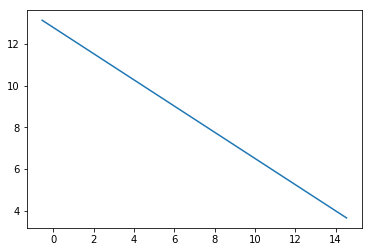

error value is [[0.17904725]]


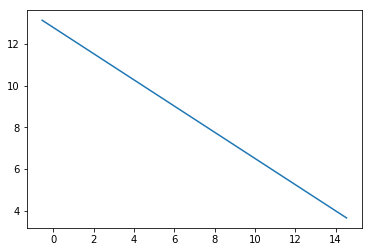

error value is [[0.17897322]]


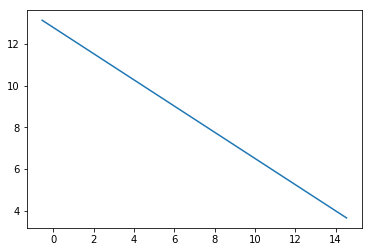

error value is [[0.17889928]]


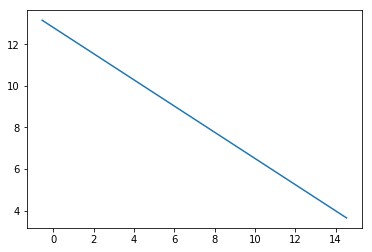

error value is [[0.17882543]]


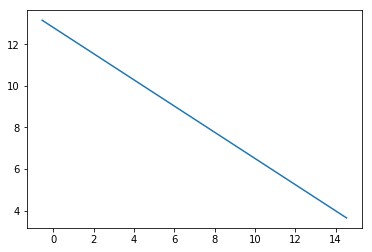

error value is [[0.17875167]]


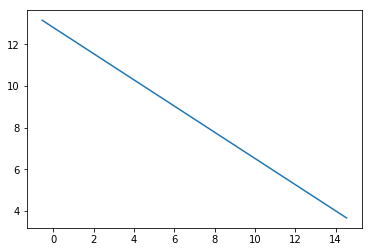

error value is [[0.178678]]


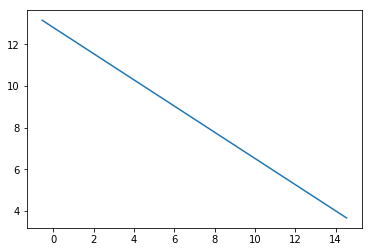

error value is [[0.17860441]]


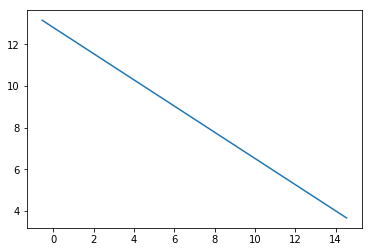

error value is [[0.17853092]]


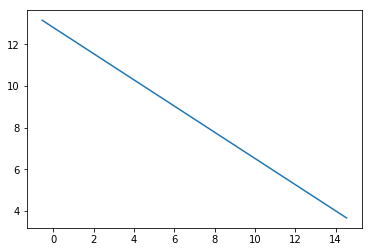

error value is [[0.17845752]]


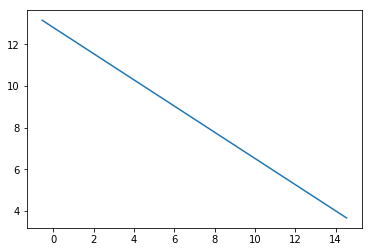

error value is [[0.1783842]]


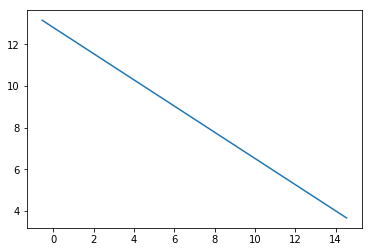

error value is [[0.17831097]]


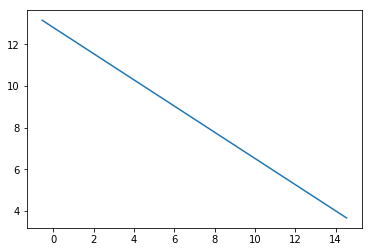

error value is [[0.17823783]]


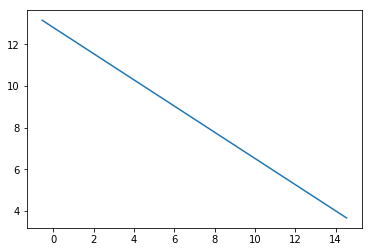

error value is [[0.17816478]]


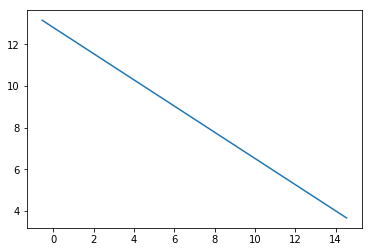

error value is [[0.17809182]]


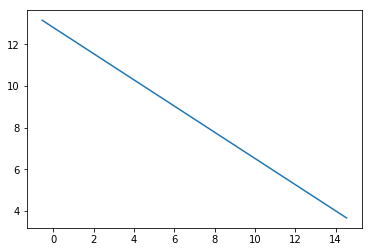

error value is [[0.17801894]]


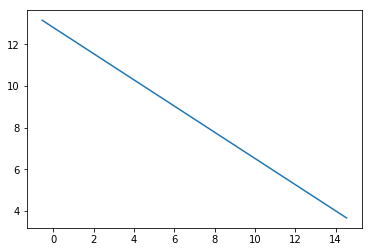

error value is [[0.17794616]]


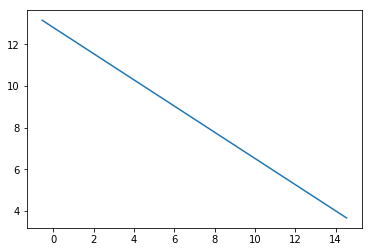

error value is [[0.17787346]]


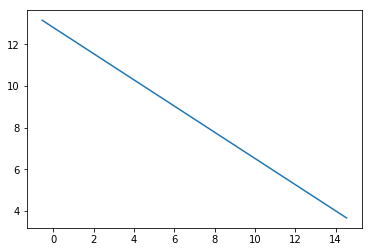

error value is [[0.17780085]]


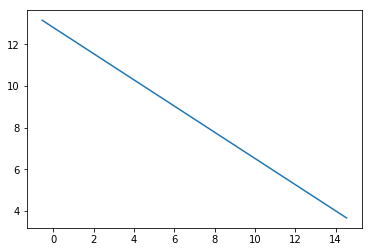

error value is [[0.17772832]]


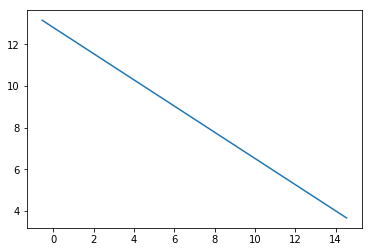

error value is [[0.17765588]]


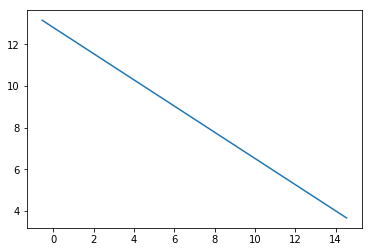

error value is [[0.17758353]]


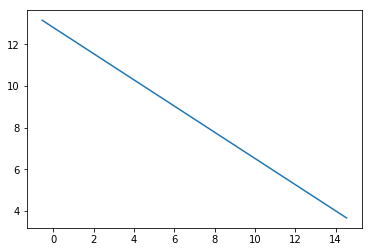

error value is [[0.17751127]]


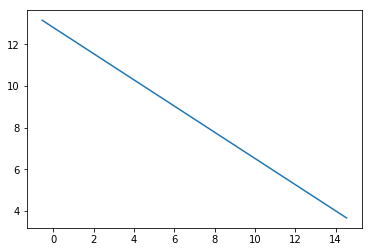

error value is [[0.17743909]]


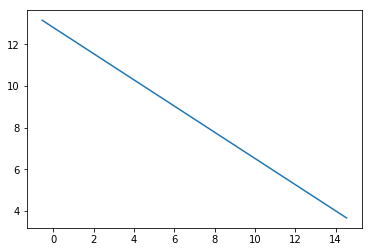

error value is [[0.177367]]


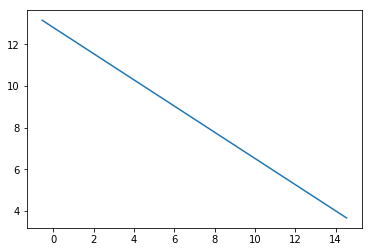

error value is [[0.17729499]]


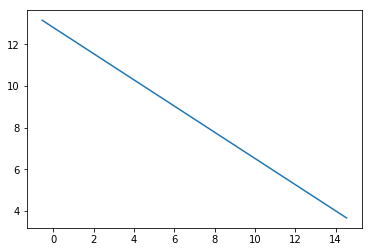

error value is [[0.17722308]]


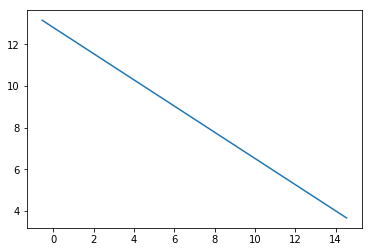

error value is [[0.17715124]]


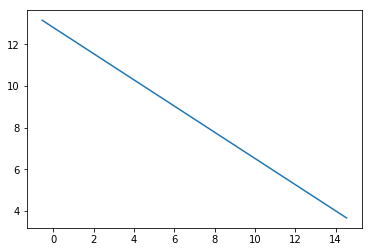

error value is [[0.1770795]]


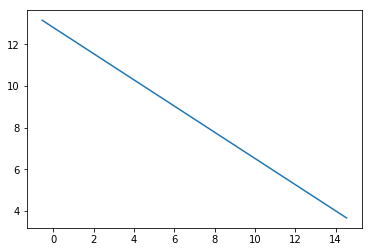

error value is [[0.17700783]]


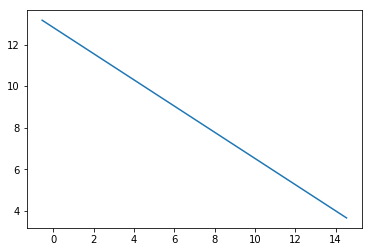

error value is [[0.17693626]]


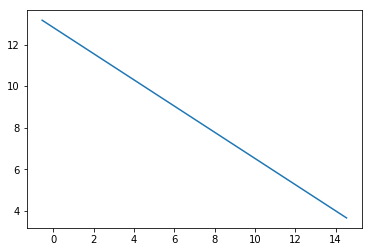

error value is [[0.17686477]]


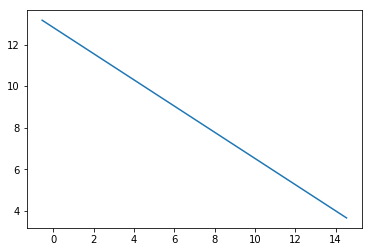

error value is [[0.17679336]]


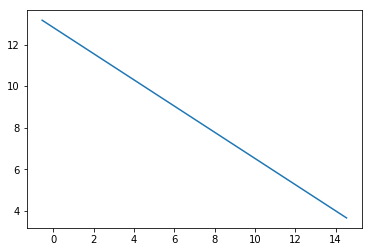

error value is [[0.17672204]]


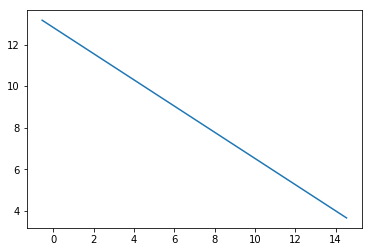

error value is [[0.1766508]]


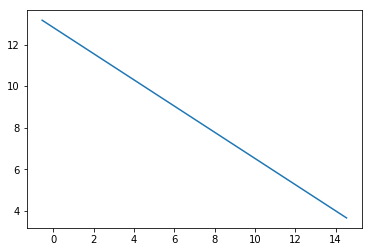

error value is [[0.17657965]]


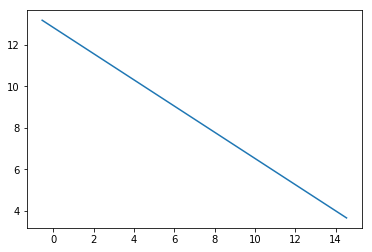

error value is [[0.17650859]]


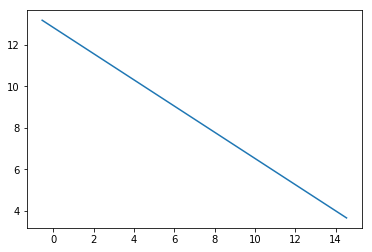

error value is [[0.1764376]]


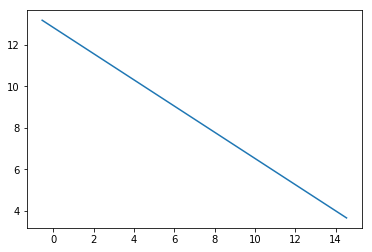

error value is [[0.17636671]]


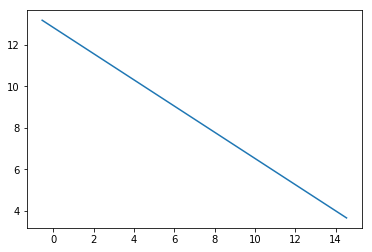

error value is [[0.17629589]]


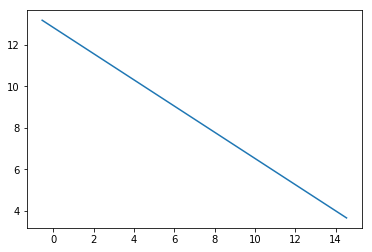

error value is [[0.17622516]]


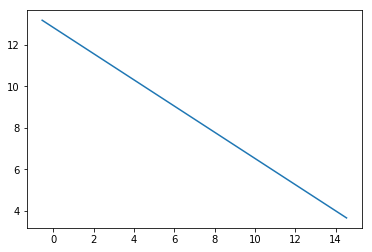

error value is [[0.17615452]]


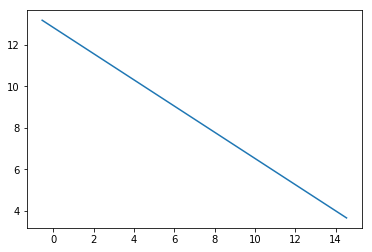

error value is [[0.17608395]]


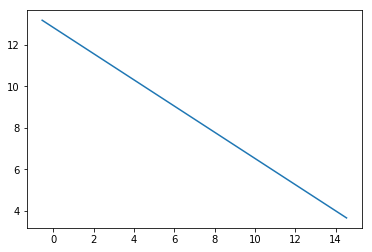

error value is [[0.17601347]]


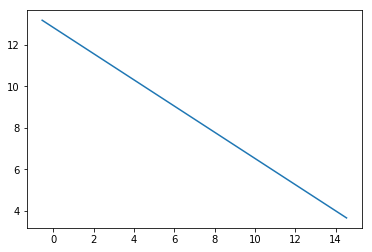

error value is [[0.17594308]]


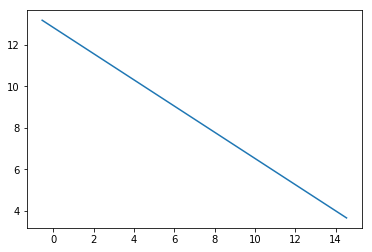

error value is [[0.17587276]]


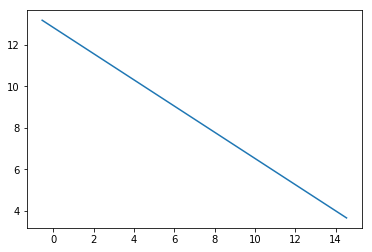

error value is [[0.17580253]]


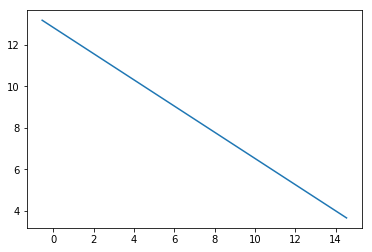

error value is [[0.17573239]]


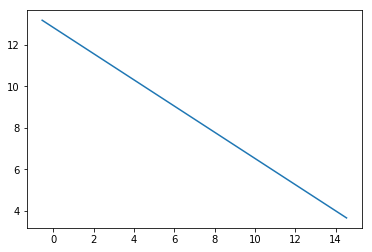

error value is [[0.17566232]]


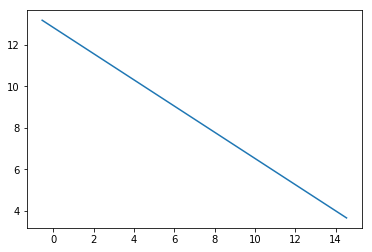

error value is [[0.17559234]]


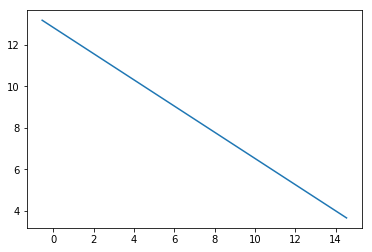

error value is [[0.17552244]]


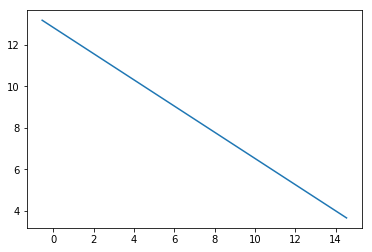

error value is [[0.17545262]]


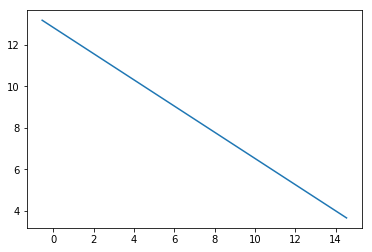

error value is [[0.17538289]]


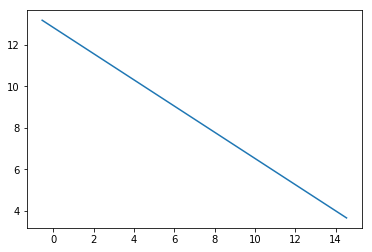

error value is [[0.17531323]]


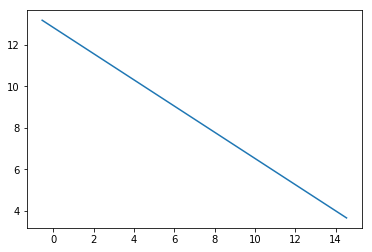

error value is [[0.17524366]]


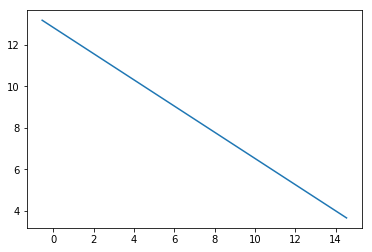

error value is [[0.17517417]]


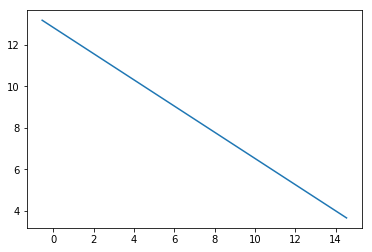

error value is [[0.17510476]]


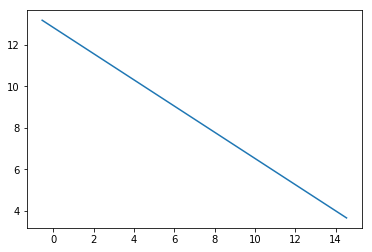

error value is [[0.17503544]]


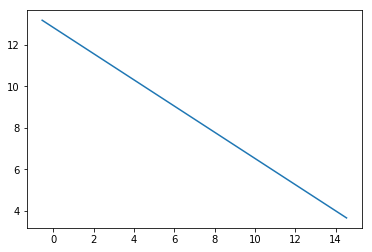

error value is [[0.17496619]]


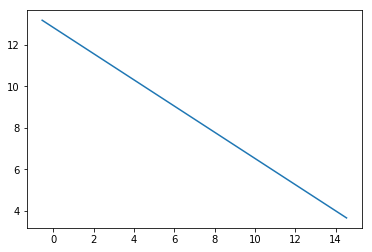

error value is [[0.17489703]]


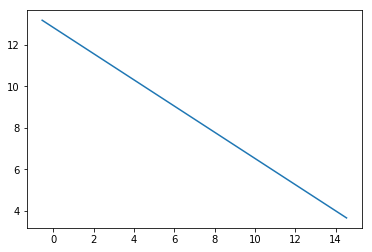

error value is [[0.17482794]]


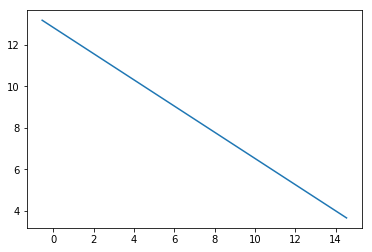

error value is [[0.17475894]]


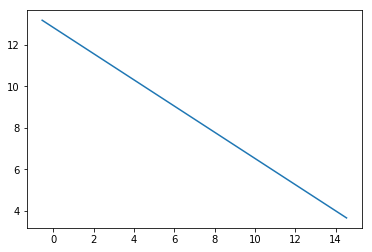

error value is [[0.17469002]]


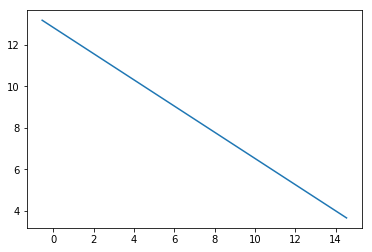

error value is [[0.17462117]]


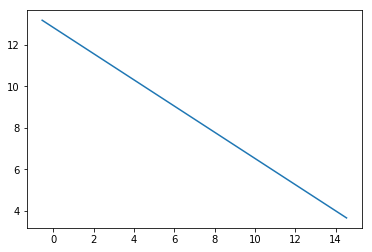

error value is [[0.17455241]]


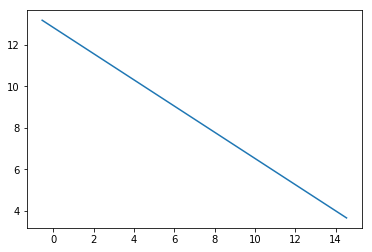

error value is [[0.17448373]]


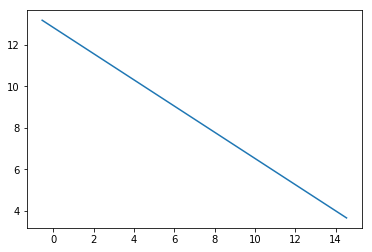

error value is [[0.17441513]]


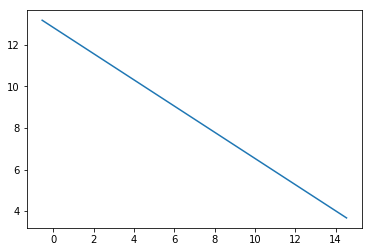

error value is [[0.1743466]]


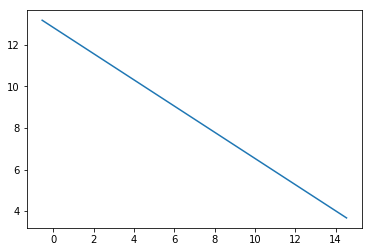

error value is [[0.17427816]]


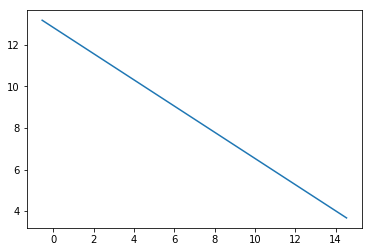

error value is [[0.1742098]]


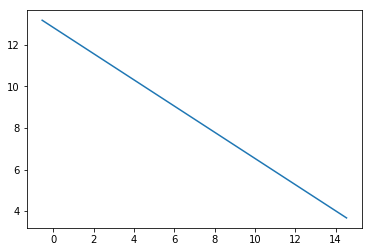

error value is [[0.17414152]]


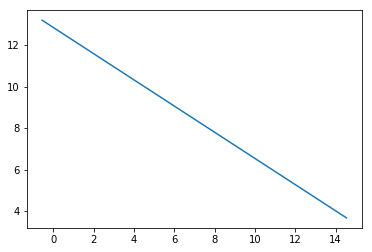

error value is [[0.17407331]]


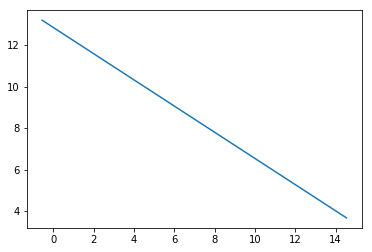

error value is [[0.17400519]]


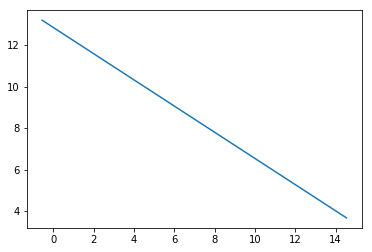

error value is [[0.17393714]]


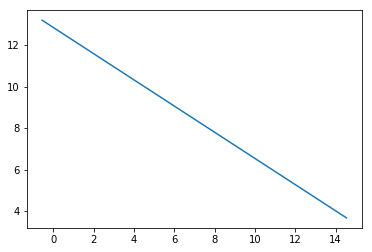

error value is [[0.17386917]]


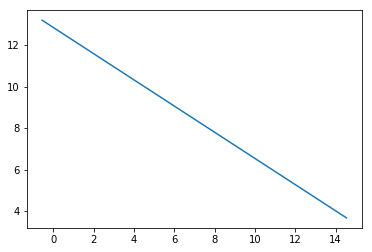

error value is [[0.17380129]]


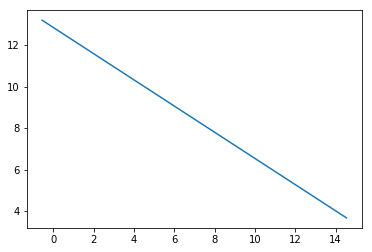

error value is [[0.17373348]]


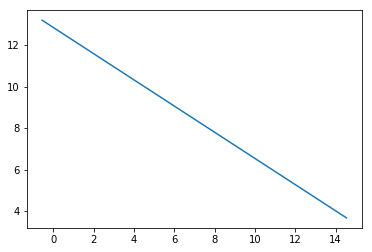

error value is [[0.17366574]]


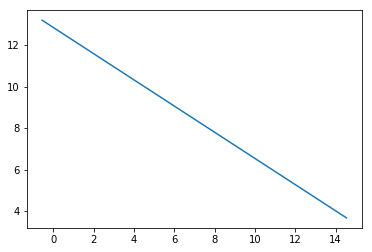

error value is [[0.17359809]]


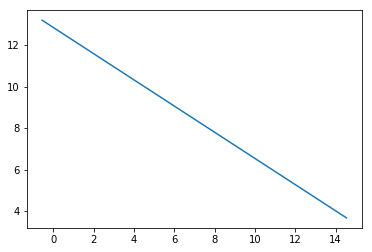

error value is [[0.17353052]]


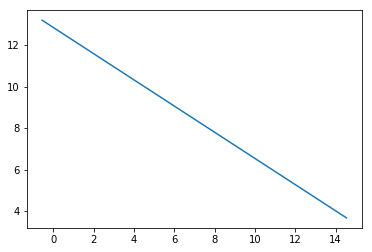

error value is [[0.17346302]]


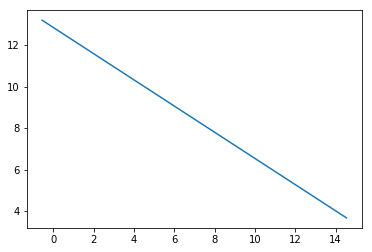

error value is [[0.1733956]]


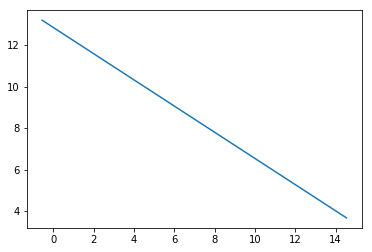

error value is [[0.17332826]]


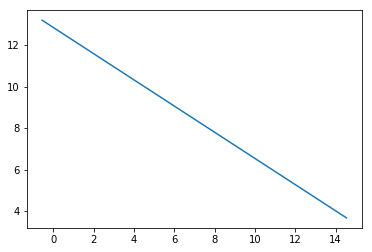

error value is [[0.173261]]


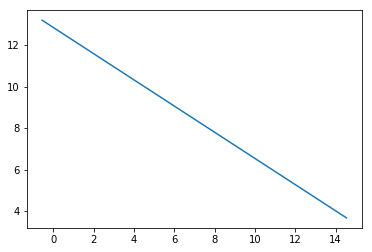

error value is [[0.17319381]]


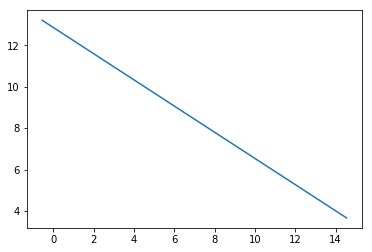

error value is [[0.1731267]]


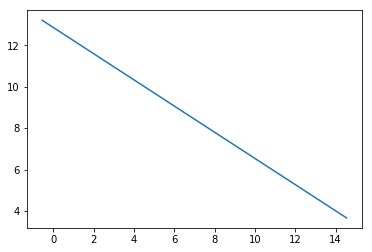

error value is [[0.17305967]]


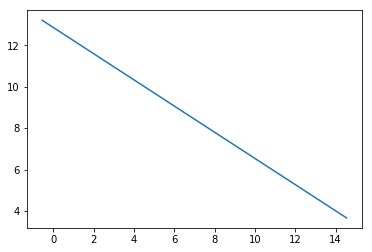

error value is [[0.17299271]]


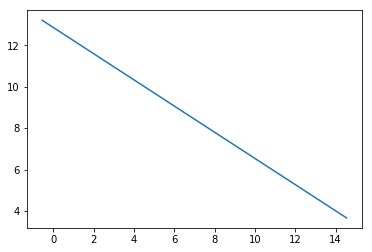

error value is [[0.17292584]]


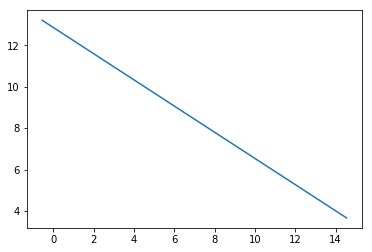

error value is [[0.17285903]]


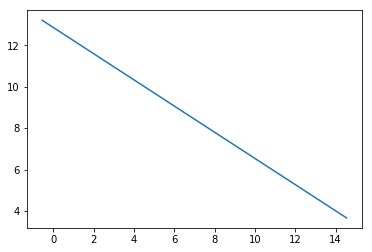

error value is [[0.17279231]]


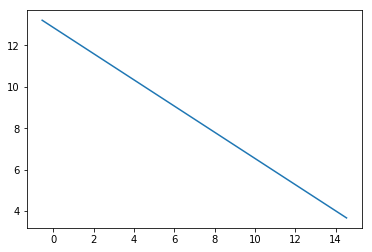

error value is [[0.17272566]]


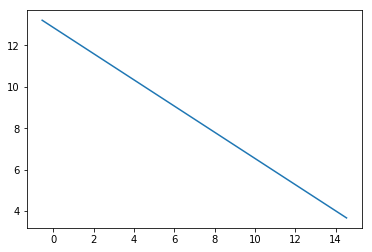

error value is [[0.17265909]]


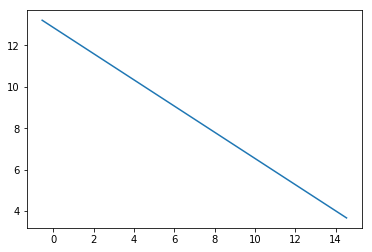

error value is [[0.1725926]]


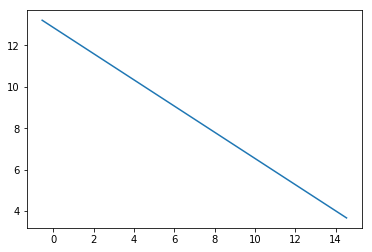

error value is [[0.17252618]]


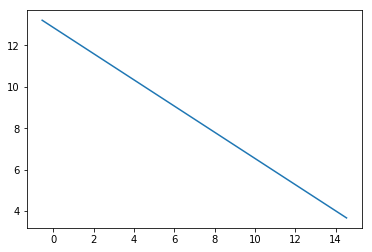

error value is [[0.17245983]]


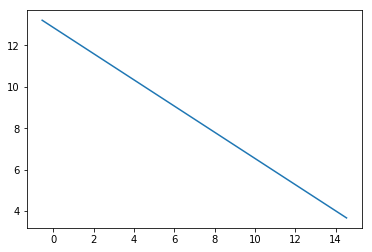

error value is [[0.17239356]]


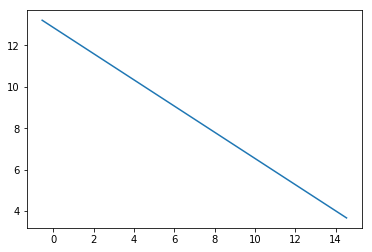

error value is [[0.17232737]]


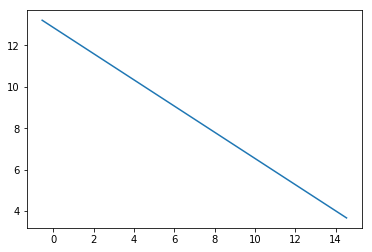

error value is [[0.17226126]]


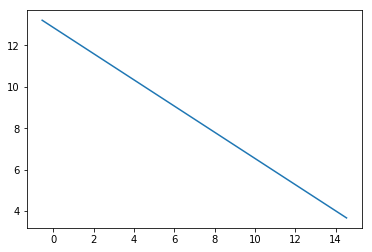

error value is [[0.17219522]]


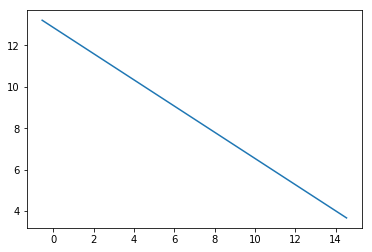

error value is [[0.17212925]]


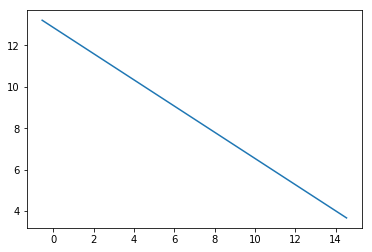

error value is [[0.17206336]]


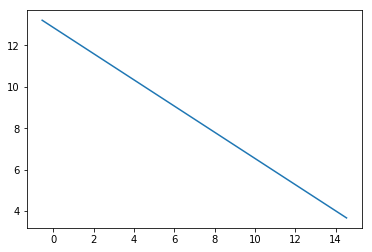

error value is [[0.17199754]]


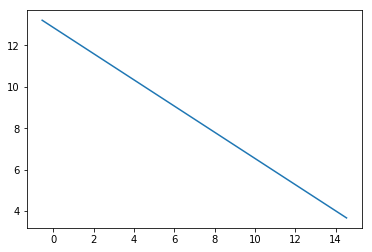

error value is [[0.1719318]]


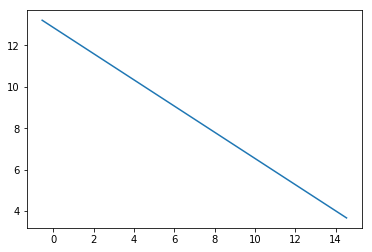

error value is [[0.17186614]]


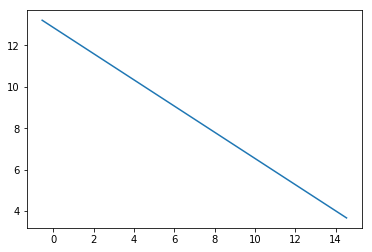

error value is [[0.17180055]]


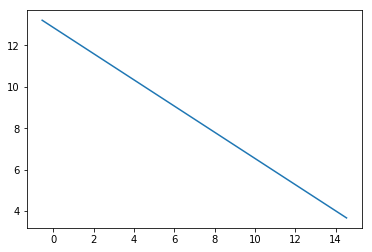

error value is [[0.17173503]]


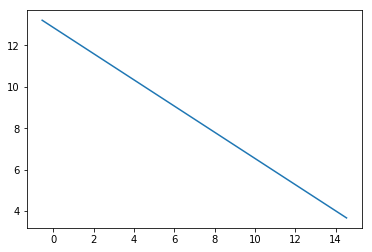

error value is [[0.17166959]]


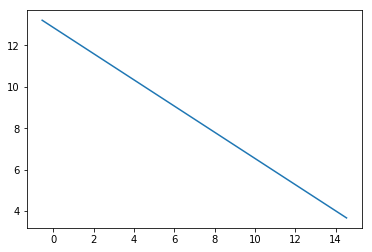

error value is [[0.17160422]]


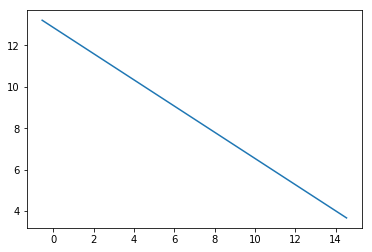

error value is [[0.17153892]]


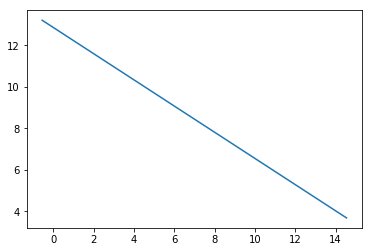

error value is [[0.1714737]]


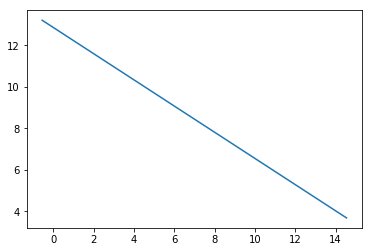

error value is [[0.17140856]]


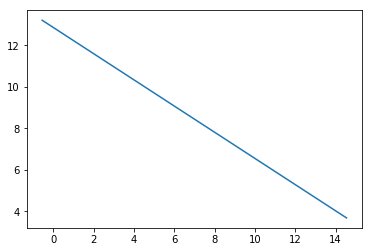

error value is [[0.17134349]]


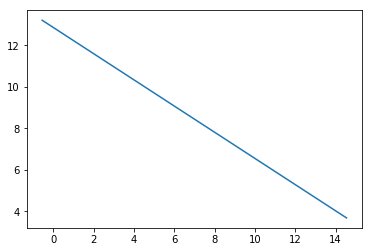

error value is [[0.17127849]]


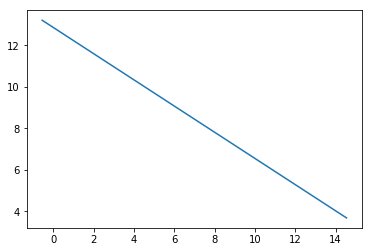

error value is [[0.17121356]]


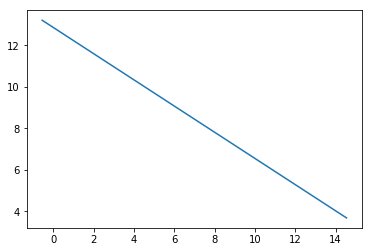

error value is [[0.17114871]]


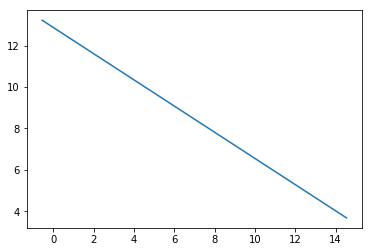

error value is [[0.17108393]]


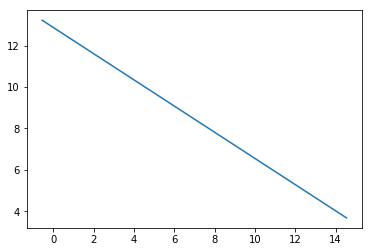

error value is [[0.17101922]]


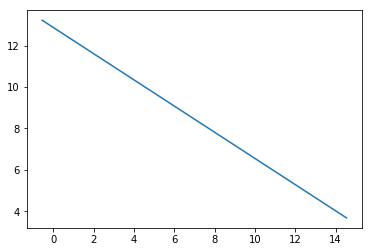

error value is [[0.17095459]]


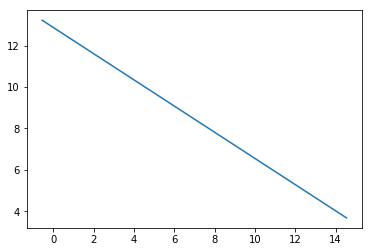

error value is [[0.17089003]]


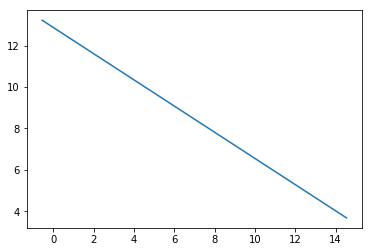

error value is [[0.17082554]]


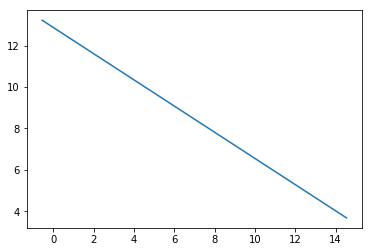

error value is [[0.17076113]]


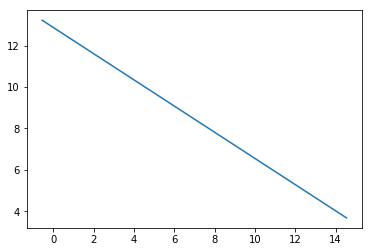

error value is [[0.17069678]]


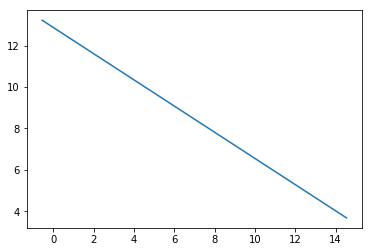

error value is [[0.17063251]]


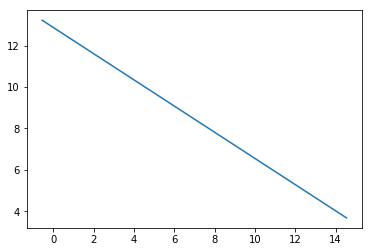

error value is [[0.17056831]]


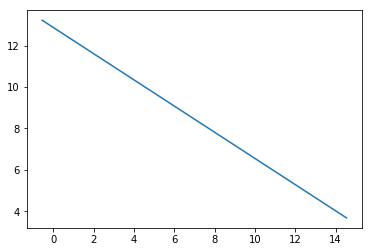

error value is [[0.17050419]]


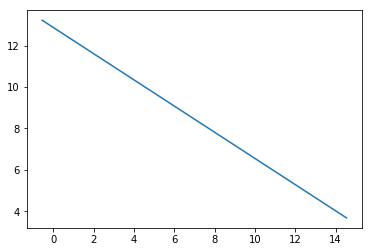

error value is [[0.17044013]]


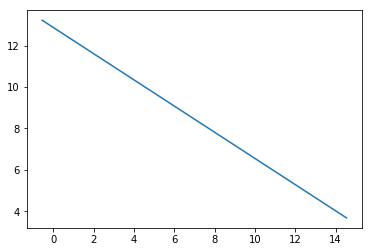

error value is [[0.17037615]]


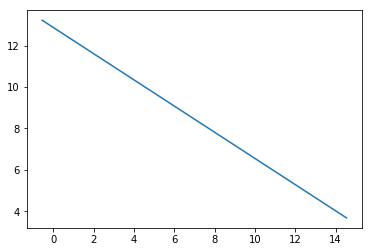

error value is [[0.17031224]]


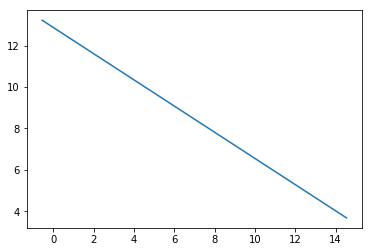

error value is [[0.1702484]]


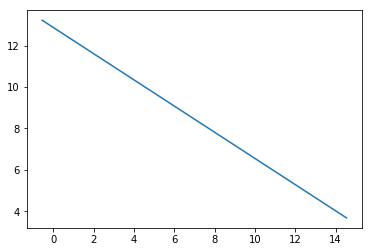

error value is [[0.17018463]]


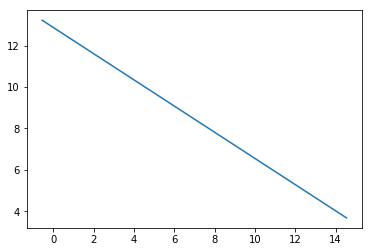

error value is [[0.17012094]]


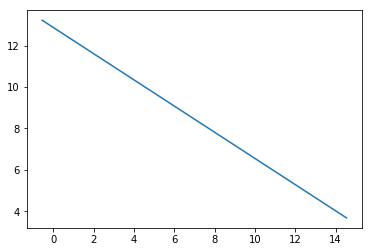

error value is [[0.17005731]]


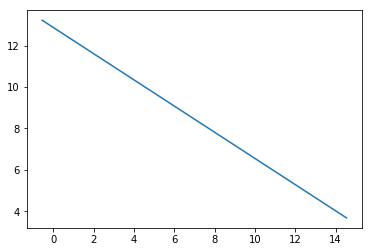

error value is [[0.16999376]]


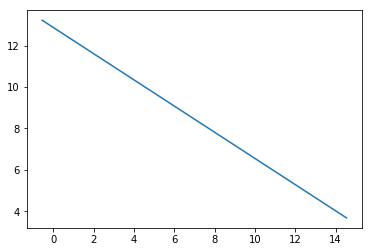

error value is [[0.16993027]]


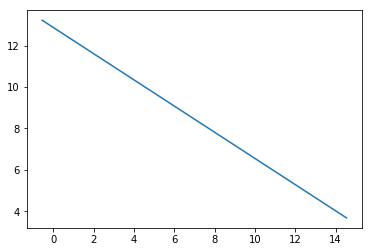

error value is [[0.16986686]]


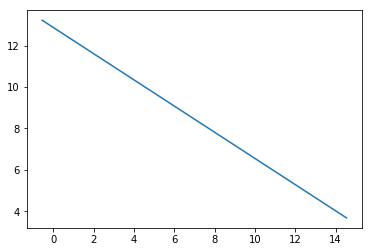

error value is [[0.16980352]]


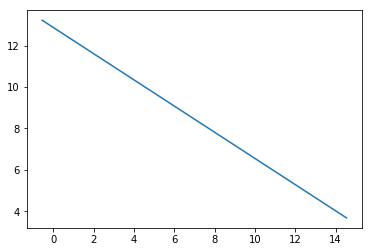

error value is [[0.16974025]]


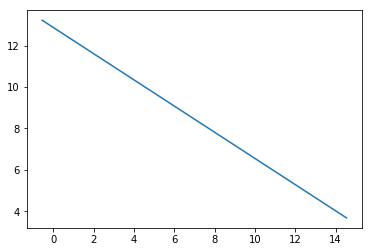

error value is [[0.16967704]]


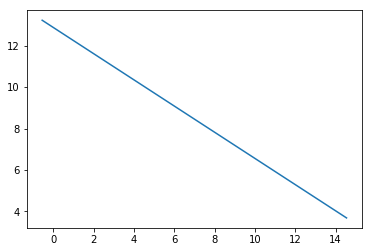

error value is [[0.16961391]]


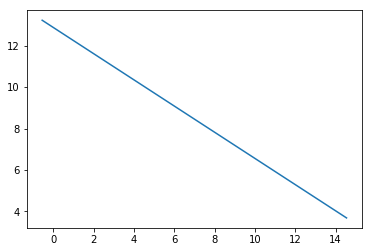

error value is [[0.16955085]]


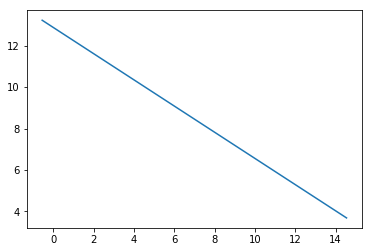

error value is [[0.16948786]]


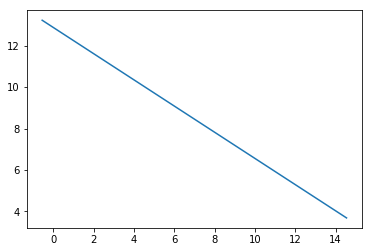

error value is [[0.16942494]]


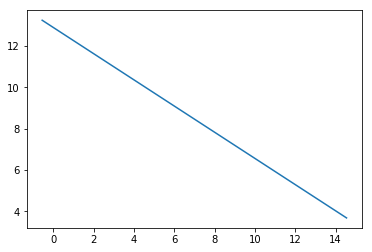

error value is [[0.16936209]]


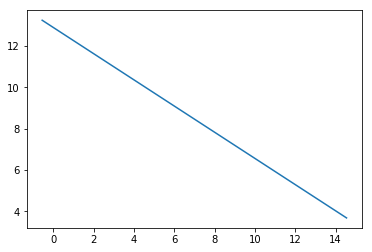

error value is [[0.16929931]]


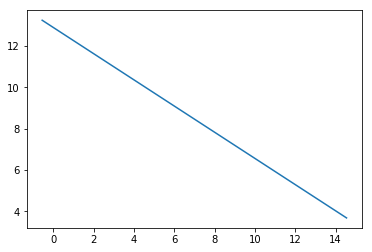

error value is [[0.1692366]]


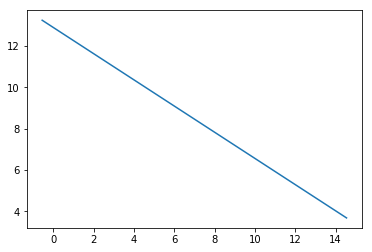

error value is [[0.16917396]]


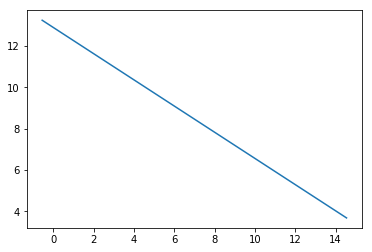

error value is [[0.16911138]]


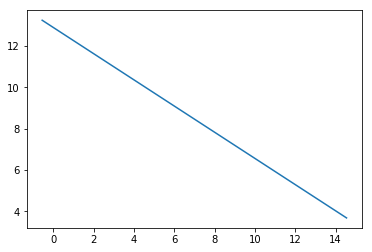

error value is [[0.16904888]]


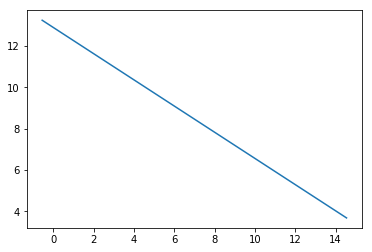

error value is [[0.16898644]]


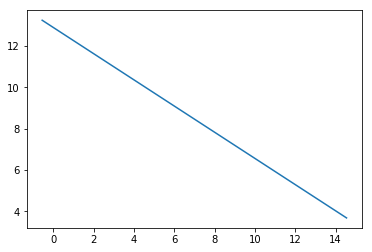

error value is [[0.16892408]]


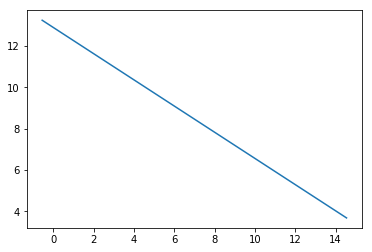

error value is [[0.16886178]]


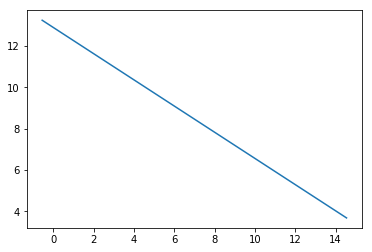

error value is [[0.16879955]]


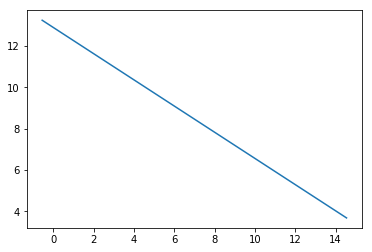

error value is [[0.16873739]]


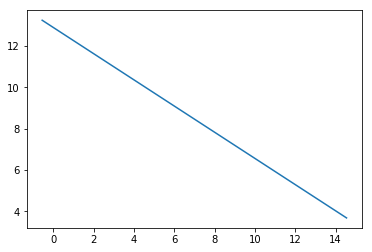

error value is [[0.1686753]]


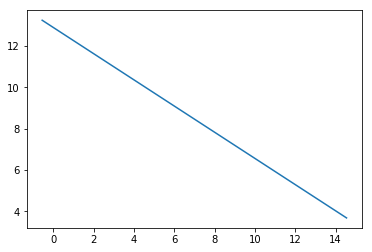

error value is [[0.16861328]]


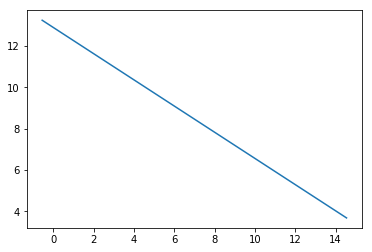

error value is [[0.16855133]]


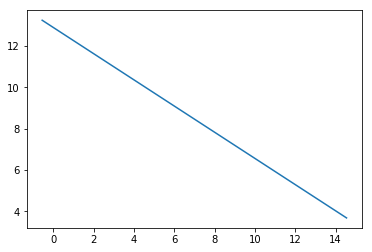

error value is [[0.16848944]]


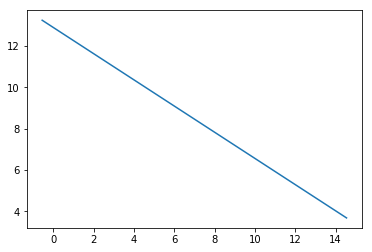

error value is [[0.16842762]]


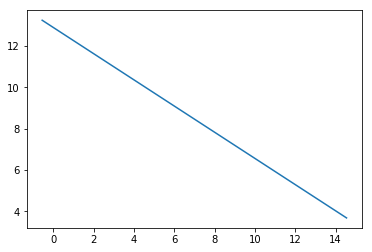

error value is [[0.16836587]]


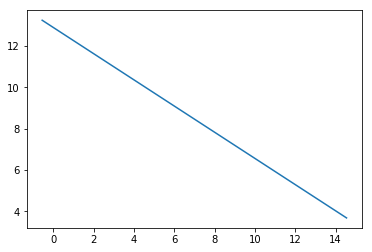

error value is [[0.16830419]]


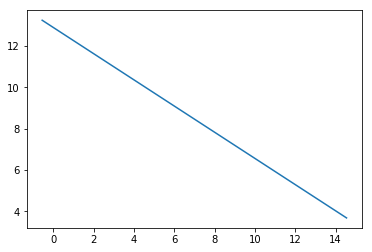

error value is [[0.16824258]]


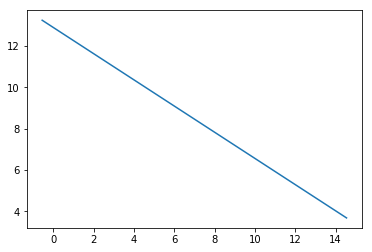

error value is [[0.16818103]]


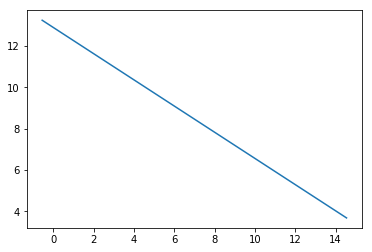

error value is [[0.16811955]]


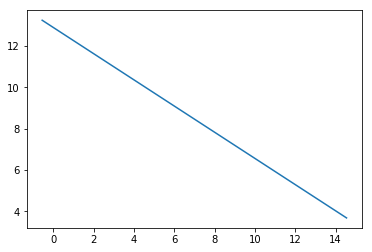

error value is [[0.16805814]]


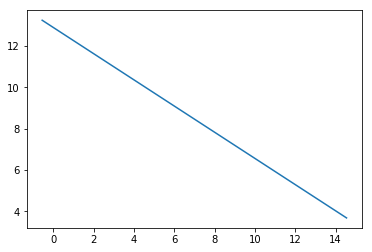

error value is [[0.16799679]]


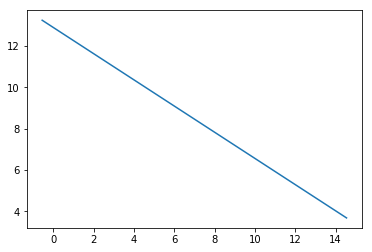

error value is [[0.16793551]]


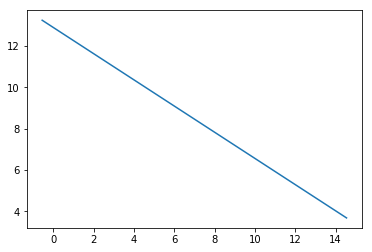

error value is [[0.1678743]]


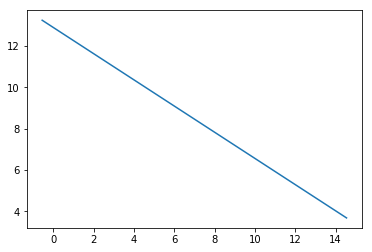

error value is [[0.16781316]]


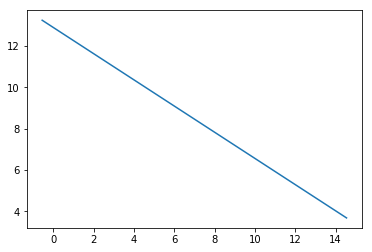

error value is [[0.16775208]]


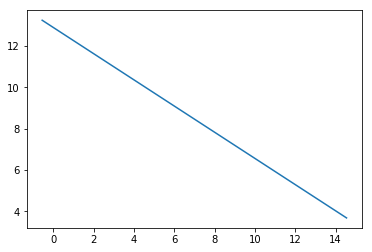

error value is [[0.16769107]]


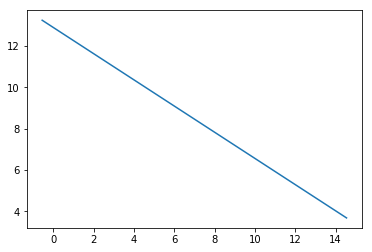

error value is [[0.16763013]]


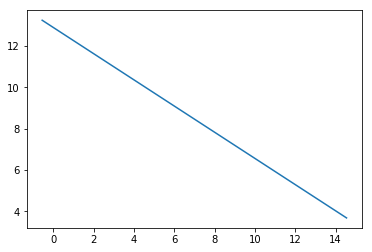

error value is [[0.16756925]]


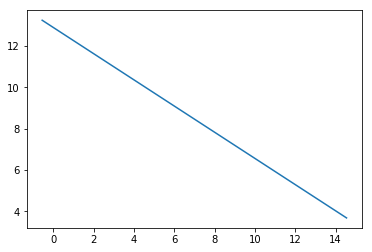

error value is [[0.16750844]]


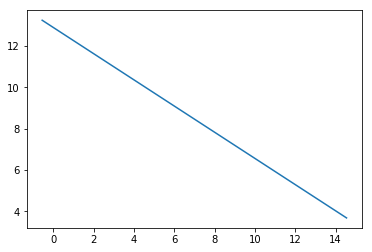

error value is [[0.16744769]]


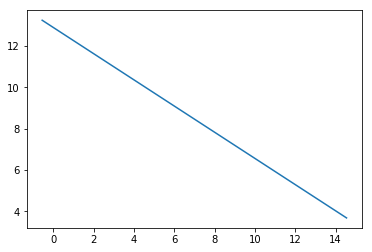

error value is [[0.16738702]]


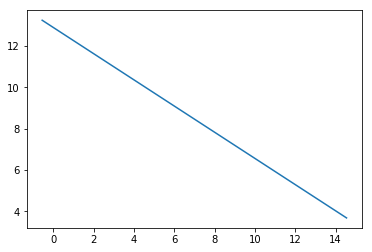

error value is [[0.1673264]]


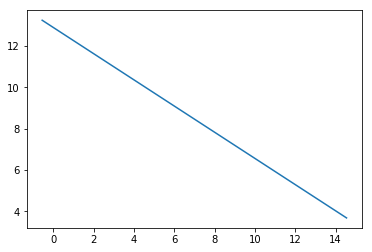

error value is [[0.16726586]]


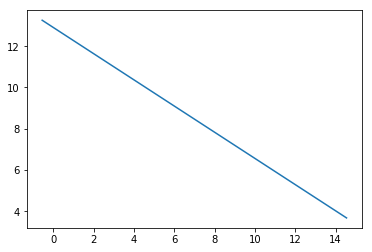

error value is [[0.16720537]]


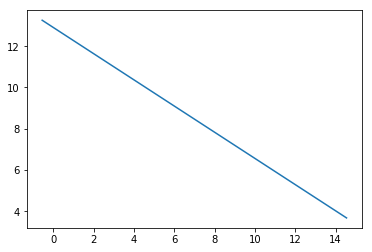

error value is [[0.16714496]]


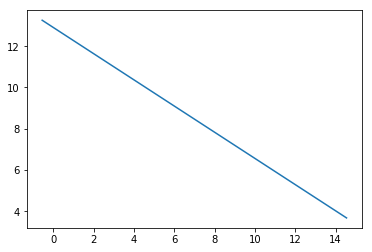

error value is [[0.16708461]]


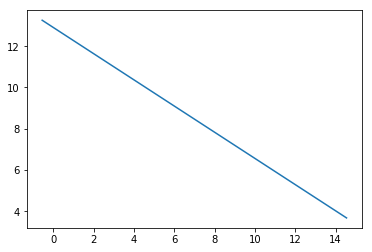

error value is [[0.16702432]]


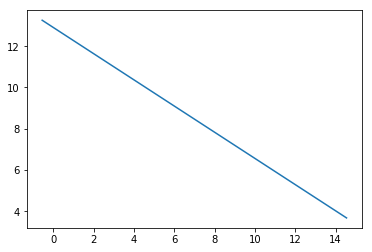

error value is [[0.1669641]]


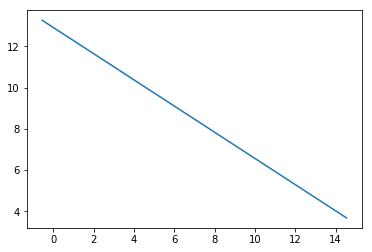

error value is [[0.16690395]]


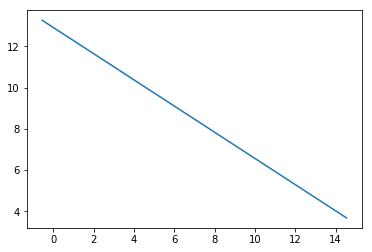

error value is [[0.16684386]]


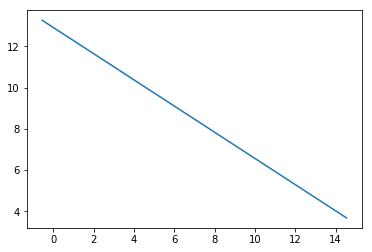

error value is [[0.16678384]]


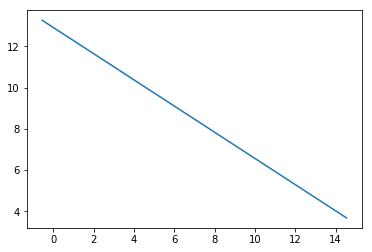

error value is [[0.16672388]]


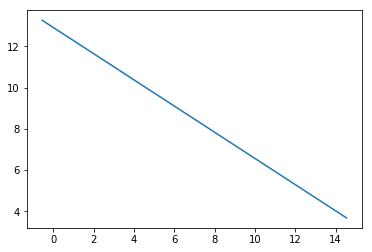

error value is [[0.16666398]]


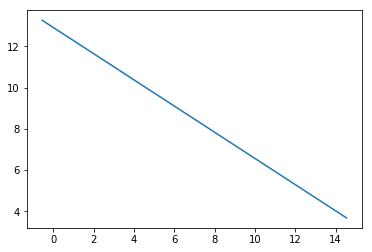

error value is [[0.16660415]]


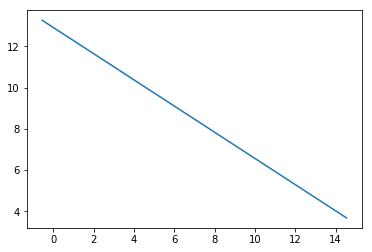

error value is [[0.16654439]]


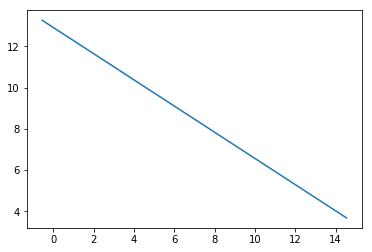

error value is [[0.16648469]]


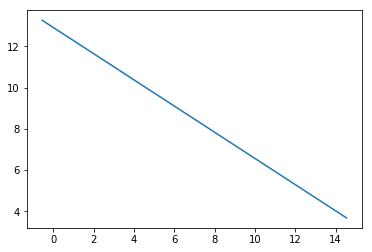

error value is [[0.16642505]]


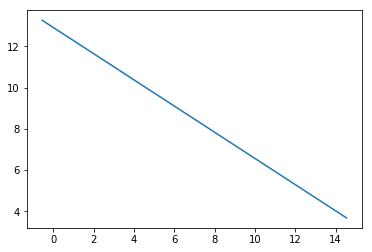

error value is [[0.16636548]]


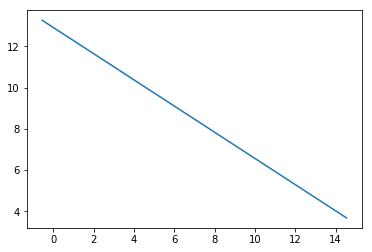

error value is [[0.16630597]]


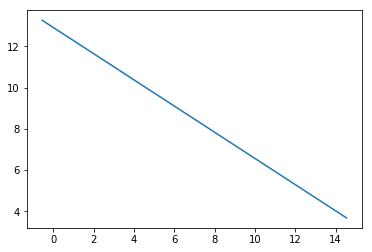

error value is [[0.16624653]]


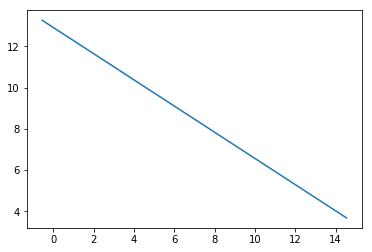

error value is [[0.16618715]]


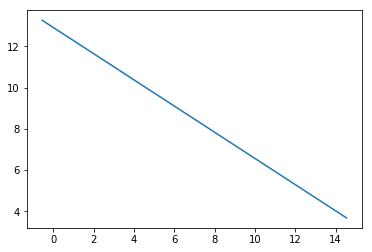

error value is [[0.16612783]]


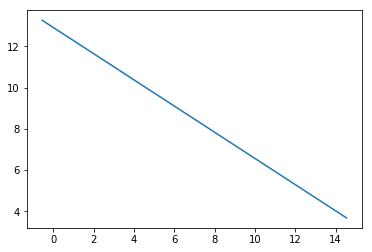

error value is [[0.16606858]]


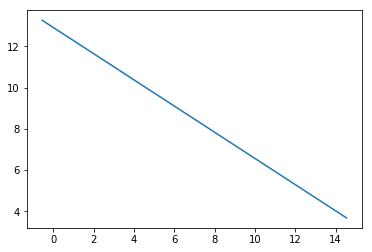

error value is [[0.16600939]]


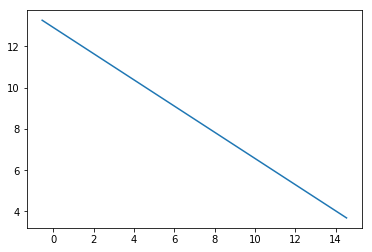

error value is [[0.16595026]]


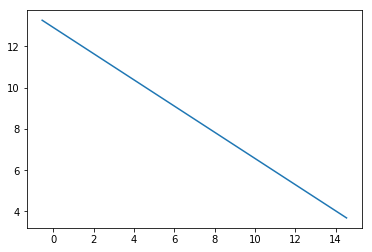

error value is [[0.1658912]]


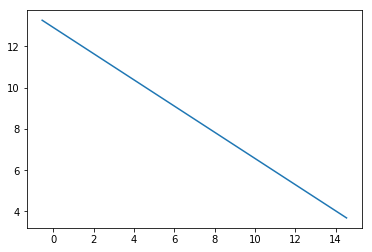

error value is [[0.1658322]]


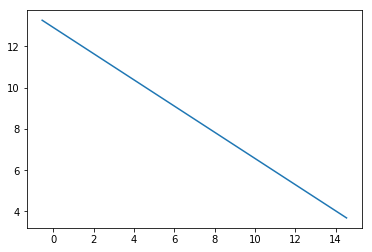

error value is [[0.16577326]]


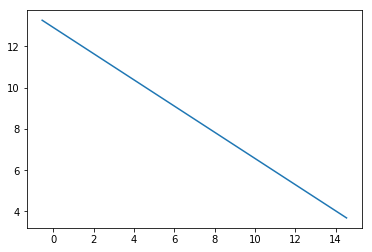

error value is [[0.16571439]]


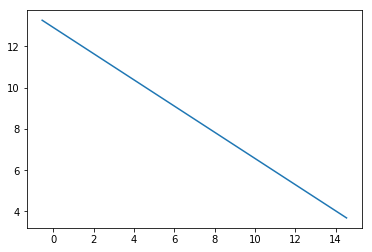

error value is [[0.16565558]]


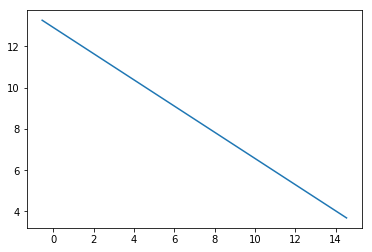

error value is [[0.16559683]]


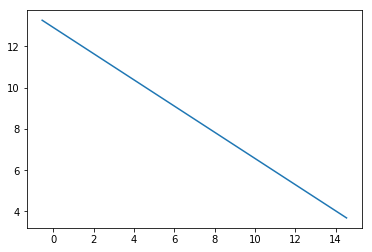

error value is [[0.16553815]]


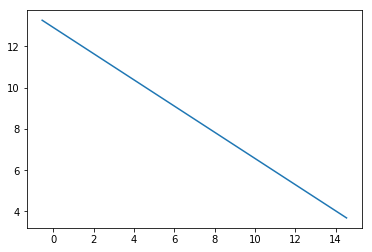

error value is [[0.16547953]]


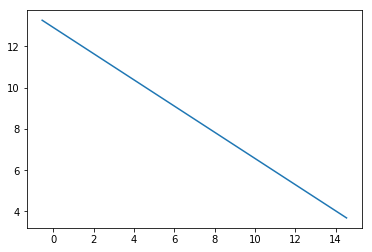

error value is [[0.16542097]]


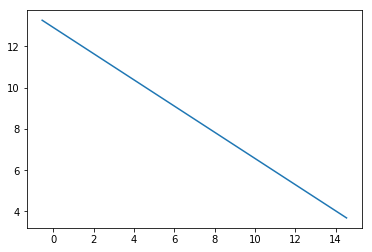

error value is [[0.16536247]]


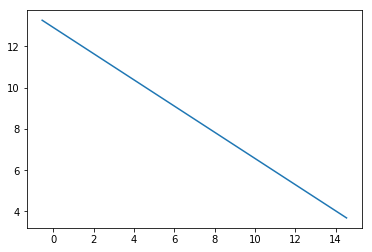

error value is [[0.16530404]]


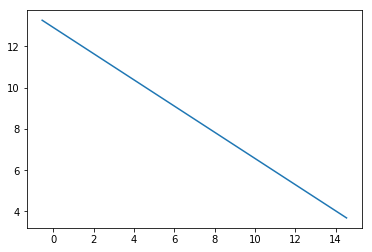

error value is [[0.16524567]]


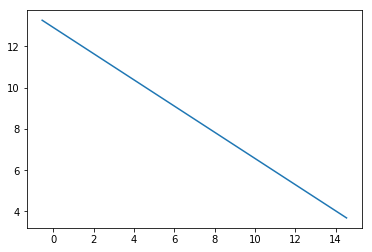

error value is [[0.16518736]]


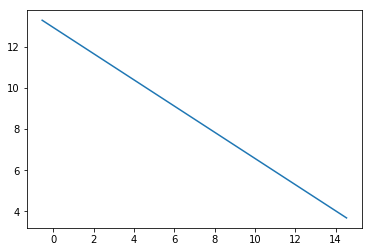

error value is [[0.16512911]]


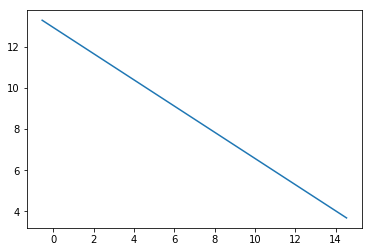

error value is [[0.16507092]]


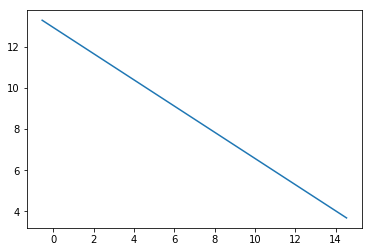

error value is [[0.1650128]]


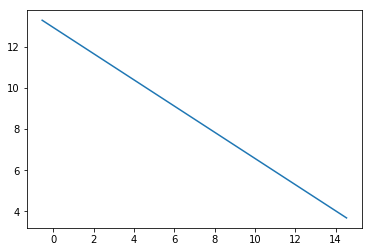

error value is [[0.16495473]]


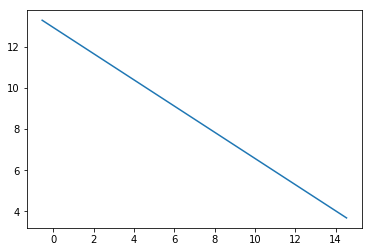

error value is [[0.16489673]]


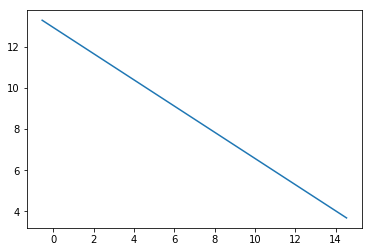

error value is [[0.16483879]]


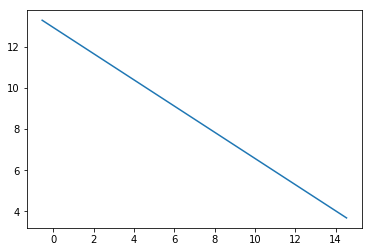

error value is [[0.16478092]]


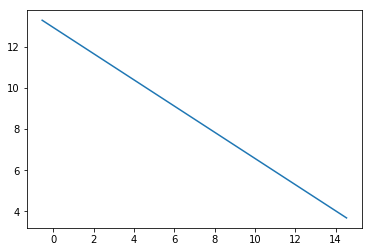

error value is [[0.1647231]]


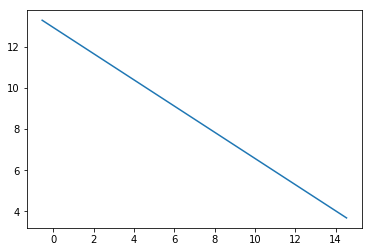

error value is [[0.16466534]]


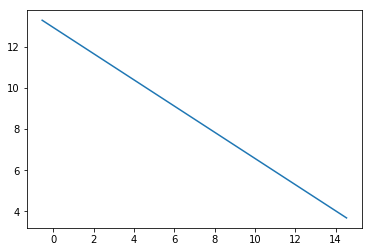

error value is [[0.16460765]]


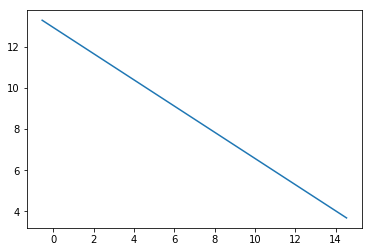

error value is [[0.16455001]]


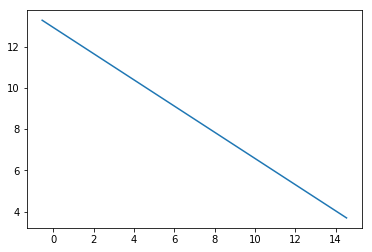

error value is [[0.16449244]]


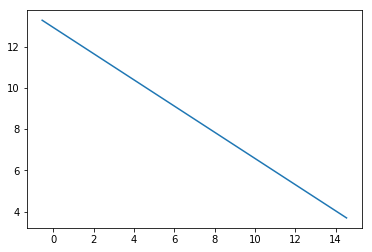

error value is [[0.16443493]]


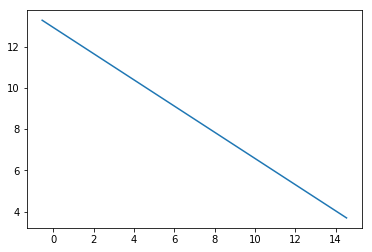

error value is [[0.16437748]]


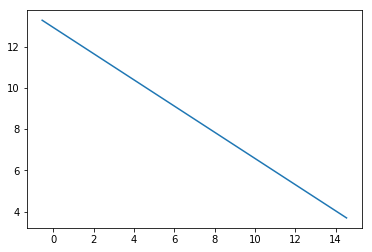

error value is [[0.16432009]]


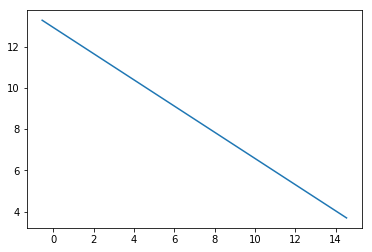

error value is [[0.16426276]]


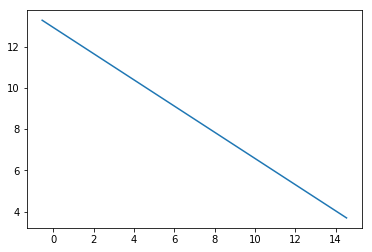

error value is [[0.16420549]]


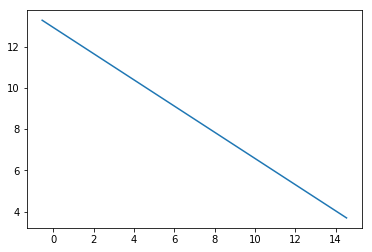

error value is [[0.16414828]]


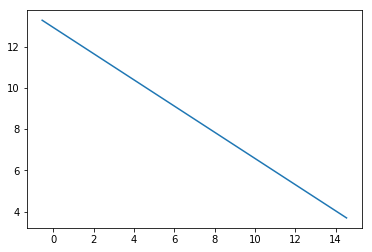

error value is [[0.16409113]]


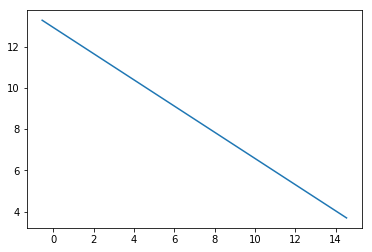

error value is [[0.16403404]]


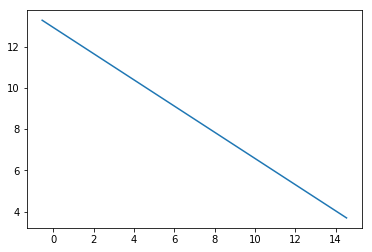

error value is [[0.16397701]]


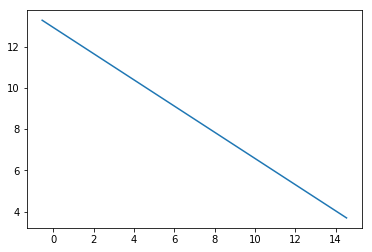

error value is [[0.16392004]]


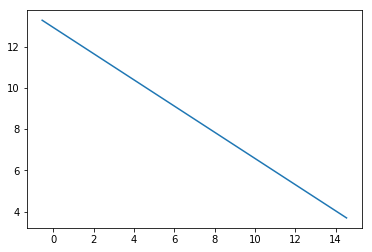

error value is [[0.16386313]]


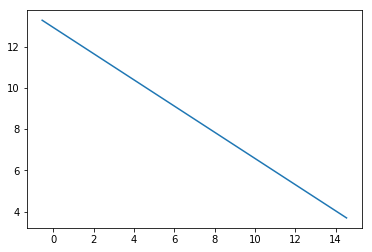

error value is [[0.16380628]]


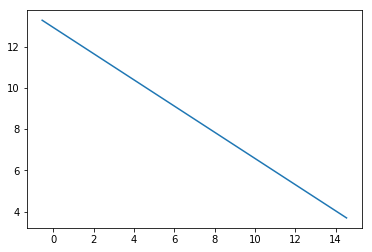

error value is [[0.16374949]]


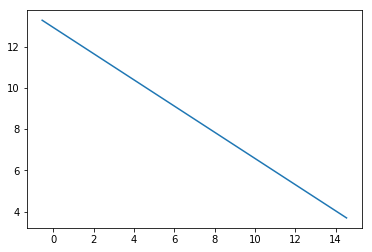

error value is [[0.16369276]]


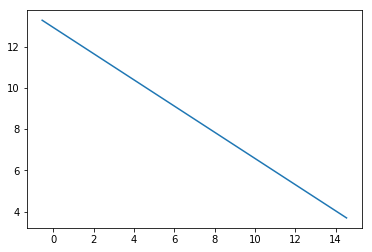

error value is [[0.16363609]]


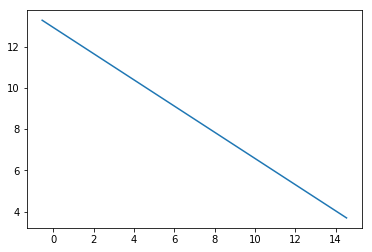

error value is [[0.16357948]]


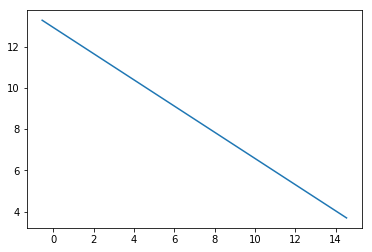

error value is [[0.16352293]]


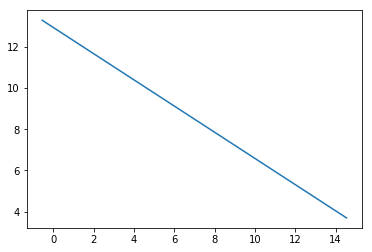

error value is [[0.16346643]]


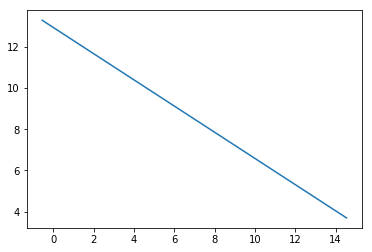

error value is [[0.16341]]


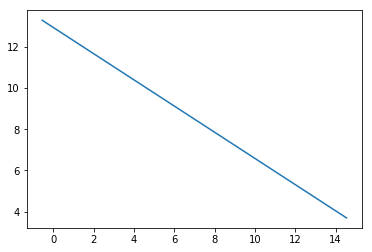

error value is [[0.16335362]]


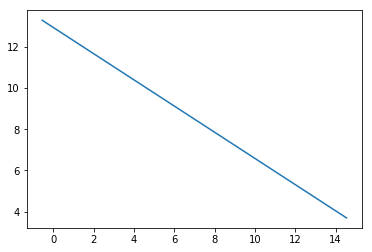

error value is [[0.16329731]]


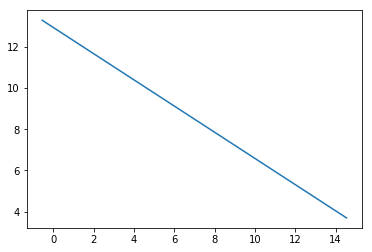

error value is [[0.16324105]]


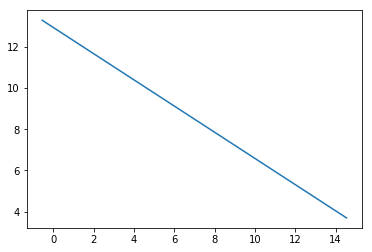

error value is [[0.16318485]]


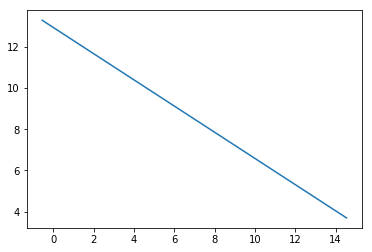

error value is [[0.16312871]]


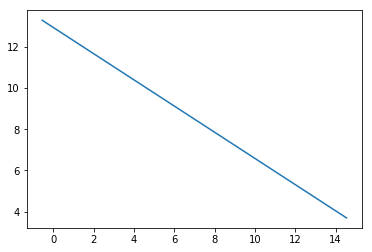

error value is [[0.16307263]]


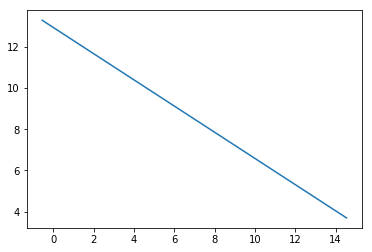

error value is [[0.1630166]]


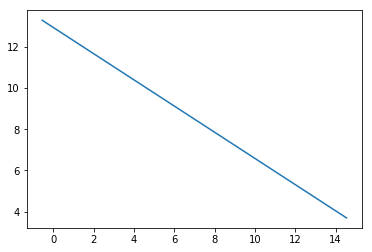

error value is [[0.16296064]]


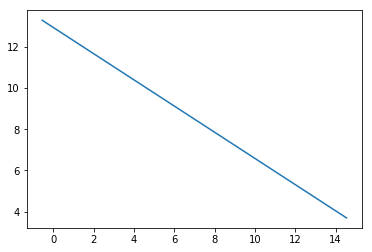

error value is [[0.16290473]]


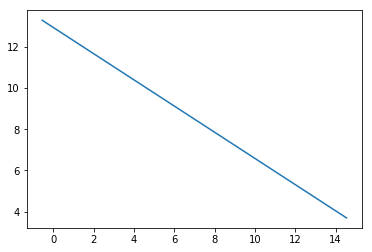

error value is [[0.16284888]]


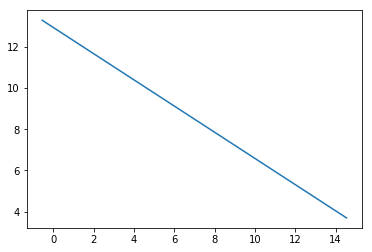

error value is [[0.16279309]]


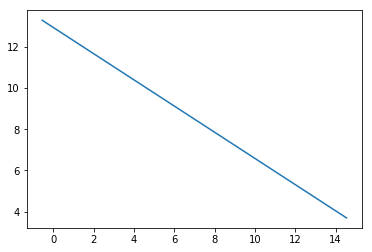

error value is [[0.16273735]]


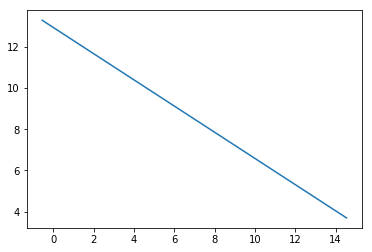

error value is [[0.16268168]]


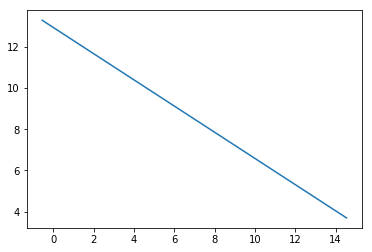

error value is [[0.16262606]]


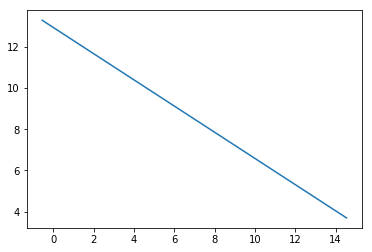

error value is [[0.1625705]]


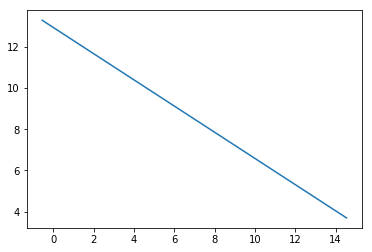

error value is [[0.162515]]


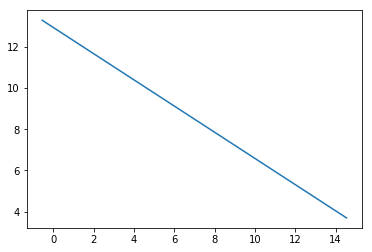

error value is [[0.16245955]]


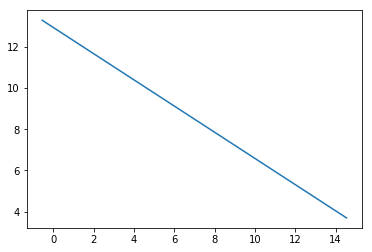

error value is [[0.16240416]]


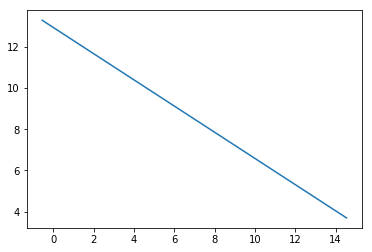

error value is [[0.16234883]]


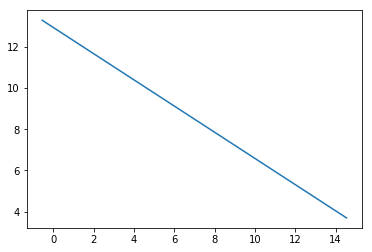

error value is [[0.16229356]]


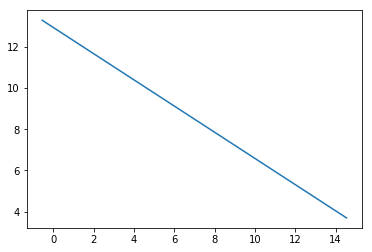

error value is [[0.16223834]]


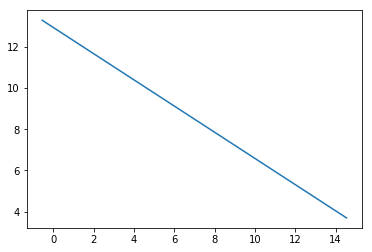

error value is [[0.16218318]]


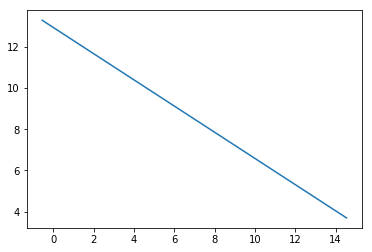

error value is [[0.16212808]]


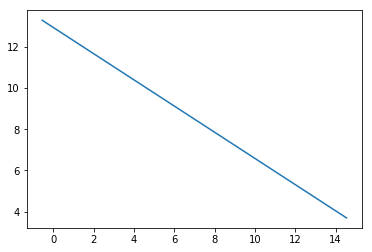

error value is [[0.16207303]]


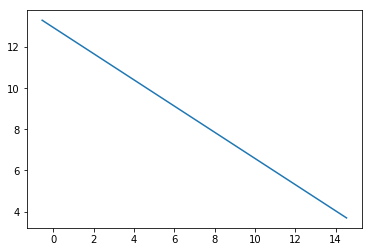

error value is [[0.16201804]]


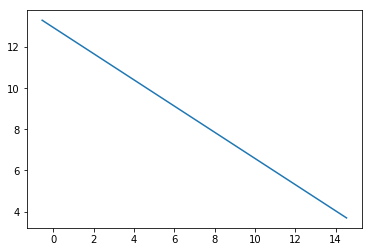

error value is [[0.16196311]]


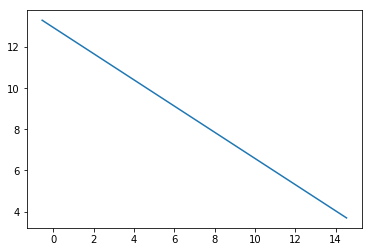

error value is [[0.16190823]]


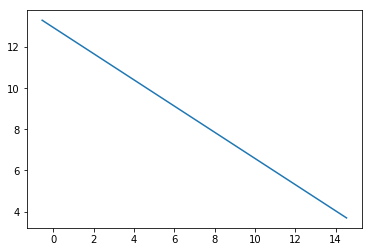

error value is [[0.16185341]]


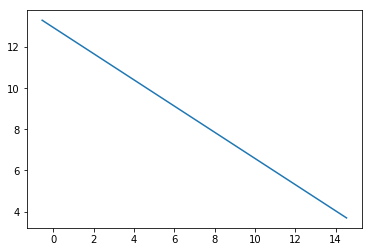

error value is [[0.16179865]]


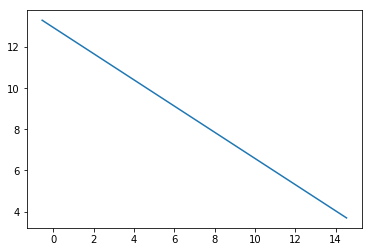

error value is [[0.16174394]]


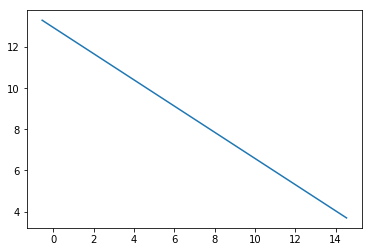

error value is [[0.16168929]]


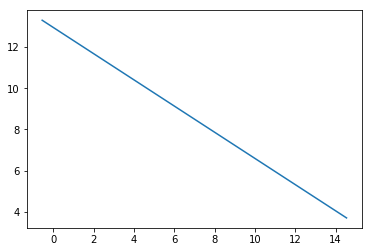

error value is [[0.1616347]]


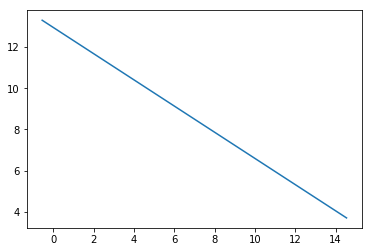

error value is [[0.16158016]]


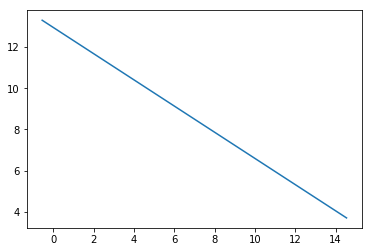

error value is [[0.16152567]]


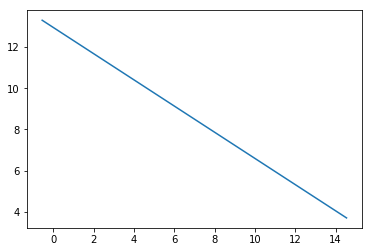

error value is [[0.16147124]]


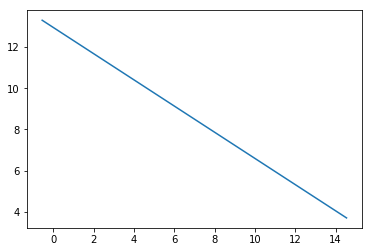

error value is [[0.16141687]]


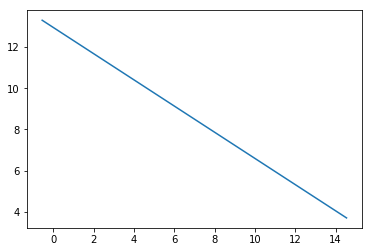

error value is [[0.16136256]]


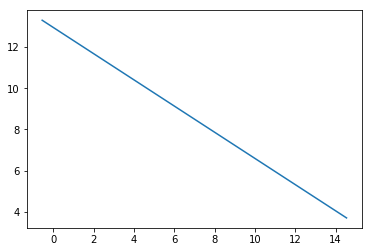

error value is [[0.1613083]]


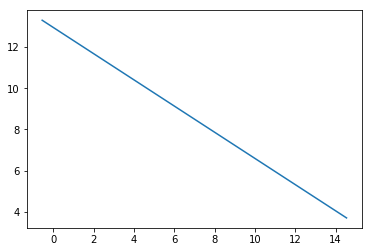

error value is [[0.16125409]]


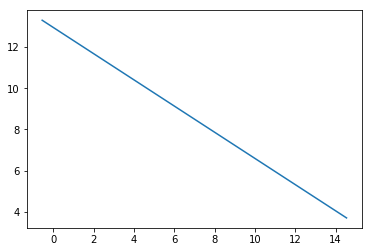

error value is [[0.16119994]]


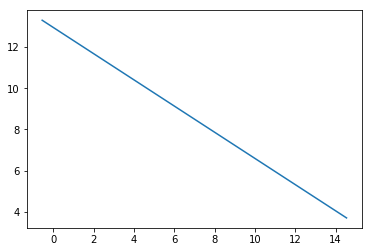

error value is [[0.16114584]]


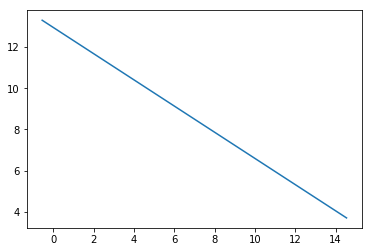

error value is [[0.16109181]]


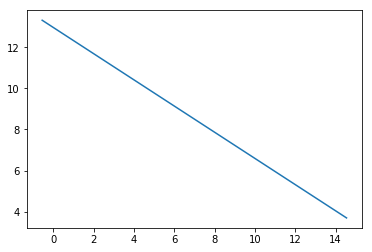

error value is [[0.16103782]]


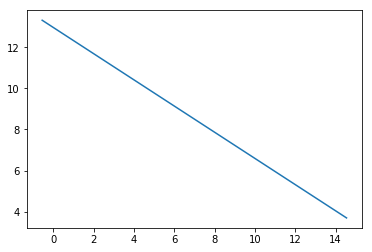

error value is [[0.16098389]]


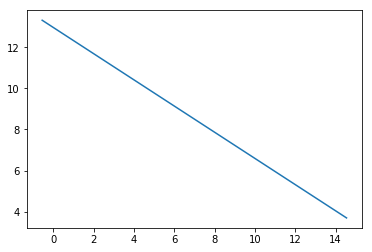

error value is [[0.16093002]]


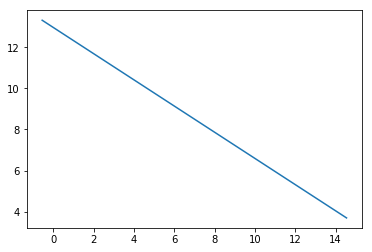

error value is [[0.1608762]]


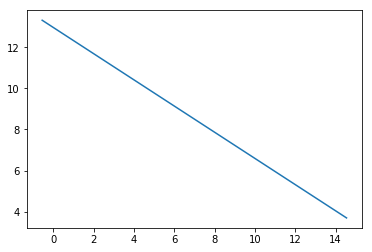

error value is [[0.16082243]]


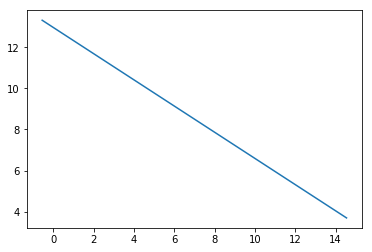

error value is [[0.16076872]]


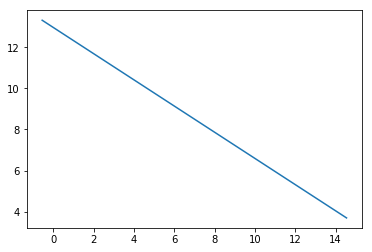

error value is [[0.16071506]]


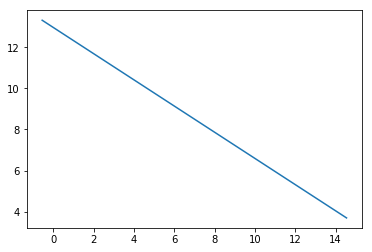

error value is [[0.16066146]]


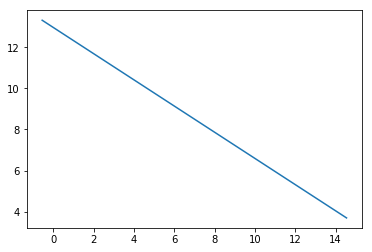

error value is [[0.16060792]]


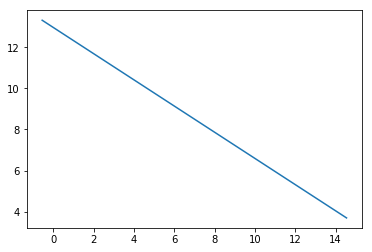

error value is [[0.16055442]]


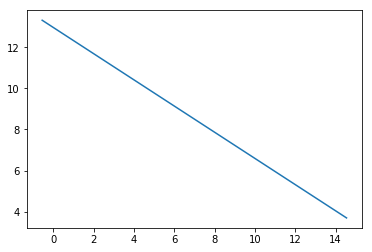

error value is [[0.16050098]]


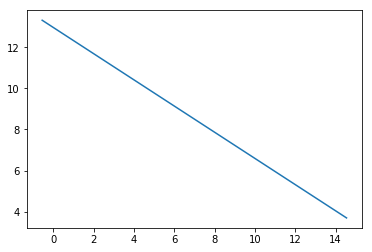

error value is [[0.1604476]]


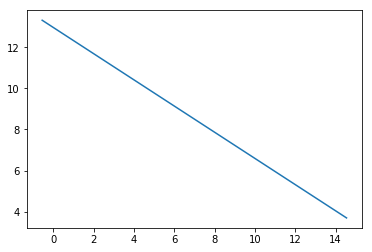

error value is [[0.16039427]]


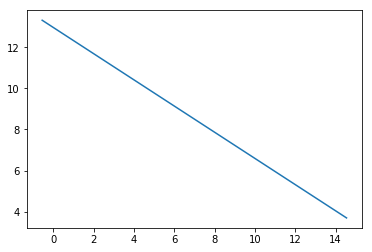

error value is [[0.16034099]]


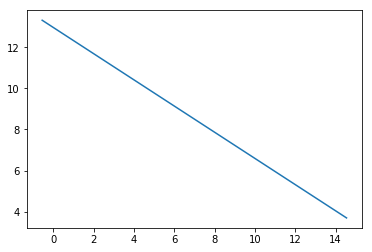

error value is [[0.16028777]]


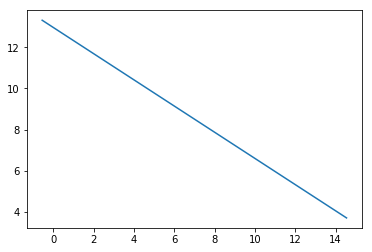

error value is [[0.1602346]]


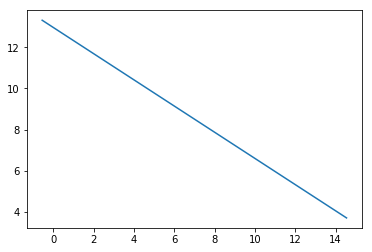

error value is [[0.16018149]]


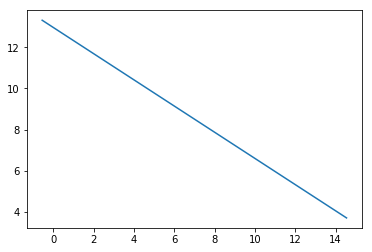

error value is [[0.16012842]]


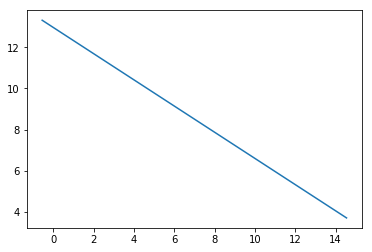

error value is [[0.16007542]]


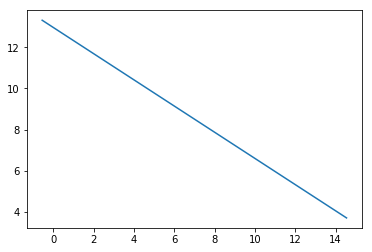

error value is [[0.16002246]]


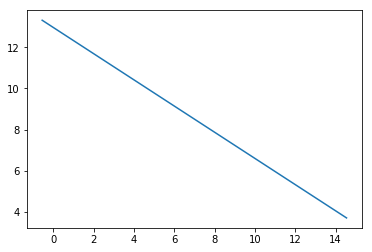

error value is [[0.15996956]]


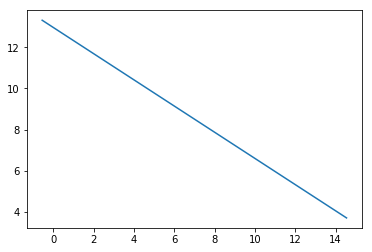

error value is [[0.15991671]]


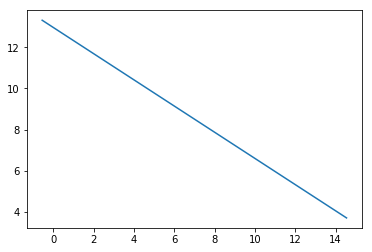

error value is [[0.15986392]]


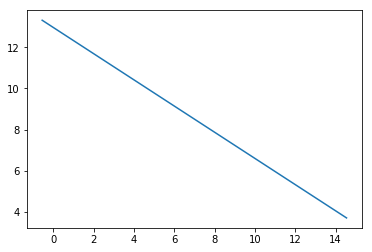

error value is [[0.15981118]]


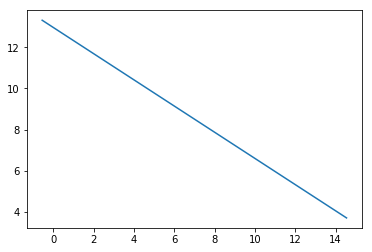

error value is [[0.15975849]]


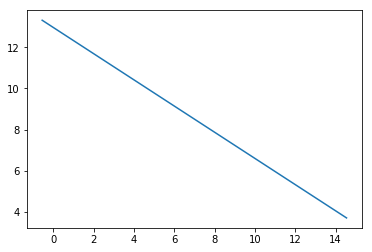

error value is [[0.15970585]]


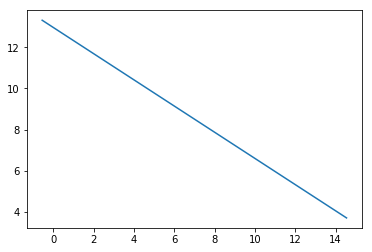

error value is [[0.15965327]]


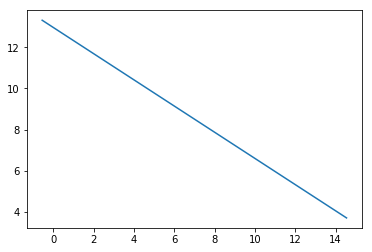

error value is [[0.15960074]]


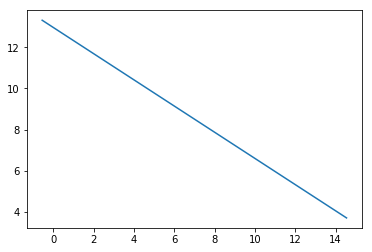

error value is [[0.15954826]]


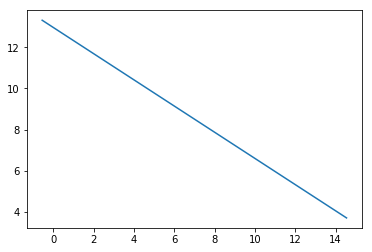

error value is [[0.15949584]]


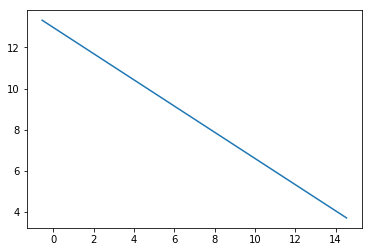

error value is [[0.15944346]]


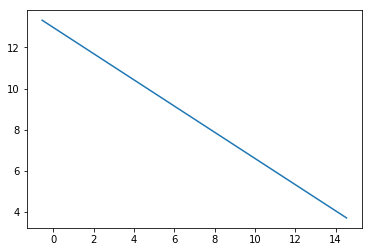

error value is [[0.15939114]]


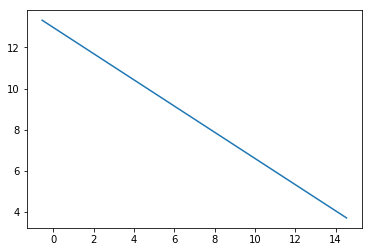

error value is [[0.15933888]]


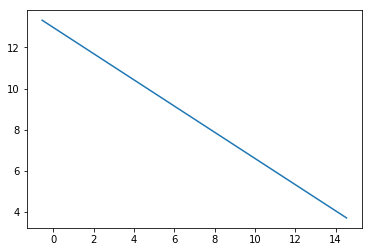

error value is [[0.15928666]]


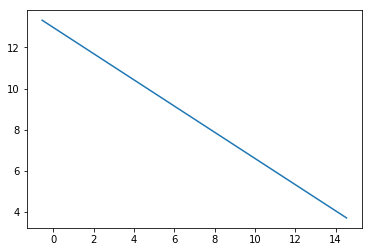

error value is [[0.1592345]]


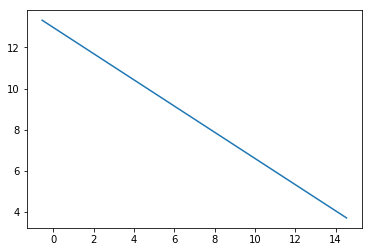

error value is [[0.15918239]]


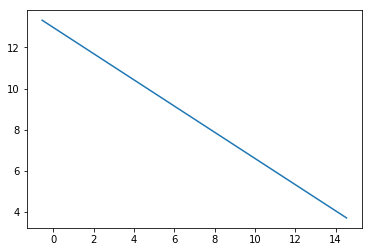

error value is [[0.15913033]]


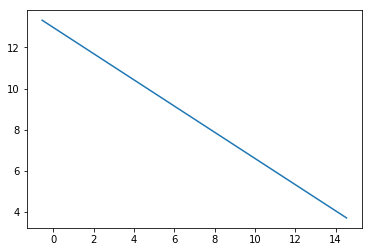

error value is [[0.15907832]]


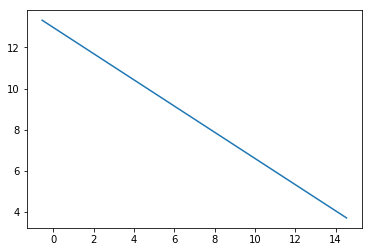

error value is [[0.15902637]]


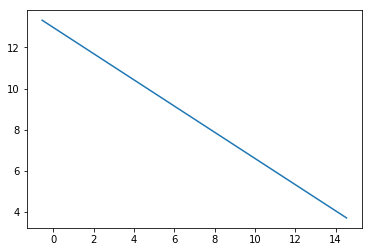

error value is [[0.15897446]]


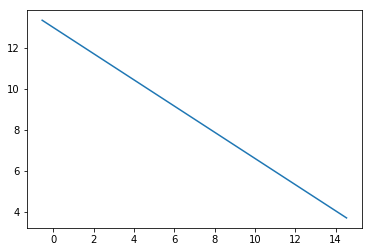

error value is [[0.15892261]]


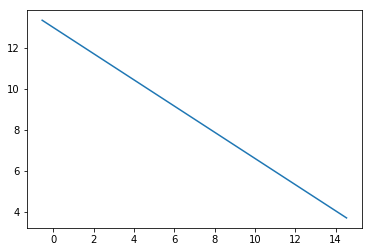

error value is [[0.15887081]]


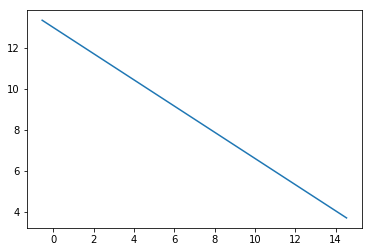

error value is [[0.15881906]]


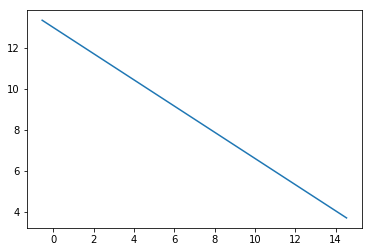

error value is [[0.15876737]]


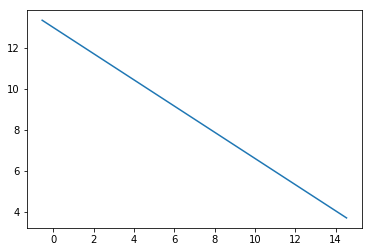

error value is [[0.15871572]]


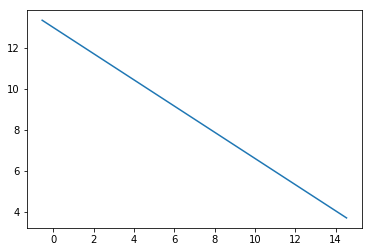

error value is [[0.15866413]]


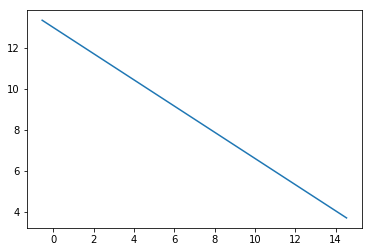

error value is [[0.15861259]]


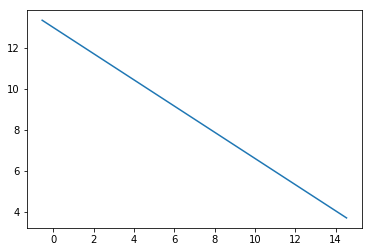

error value is [[0.15856109]]


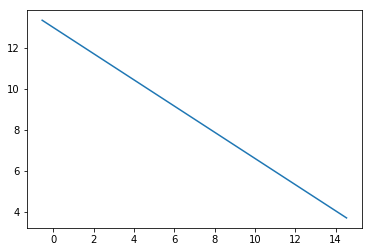

error value is [[0.15850965]]


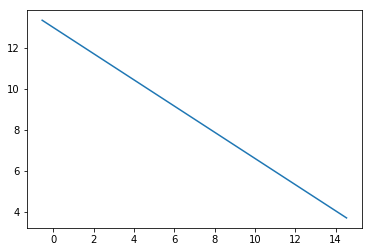

error value is [[0.15845826]]


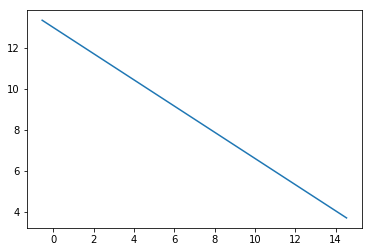

error value is [[0.15840692]]


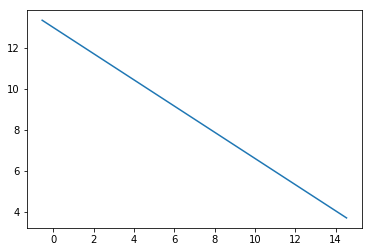

error value is [[0.15835564]]


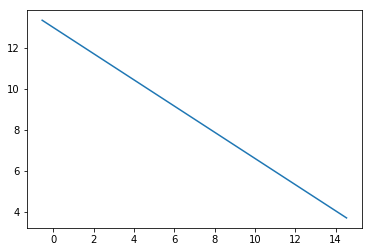

error value is [[0.1583044]]


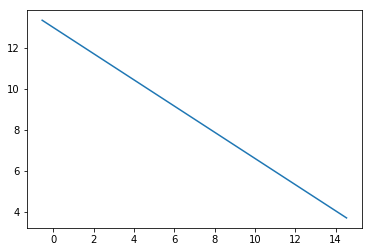

error value is [[0.15825321]]


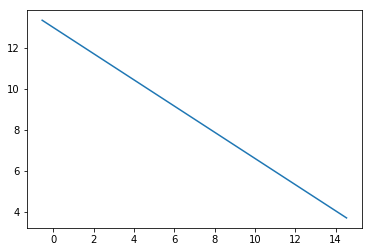

error value is [[0.15820208]]


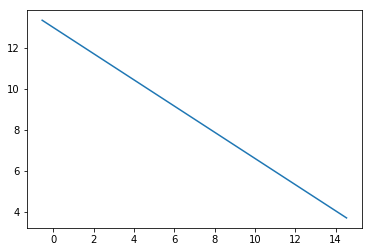

error value is [[0.15815099]]


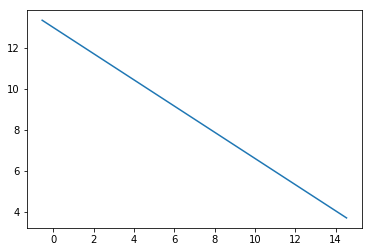

error value is [[0.15809996]]


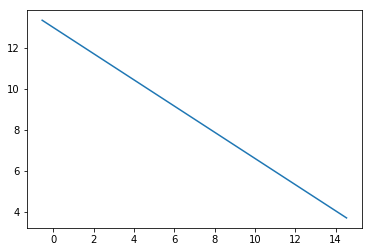

error value is [[0.15804897]]


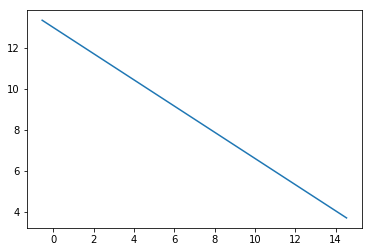

error value is [[0.15799804]]


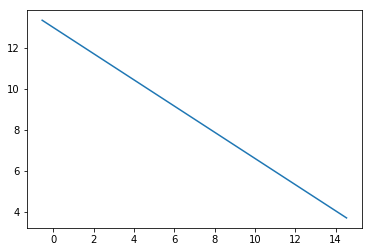

error value is [[0.15794715]]


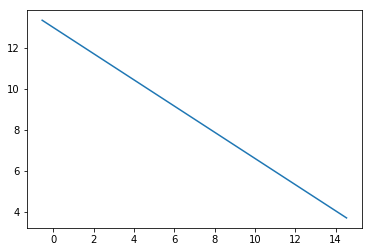

error value is [[0.15789632]]


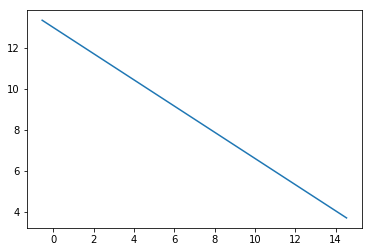

error value is [[0.15784554]]


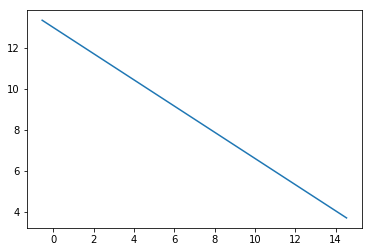

error value is [[0.1577948]]


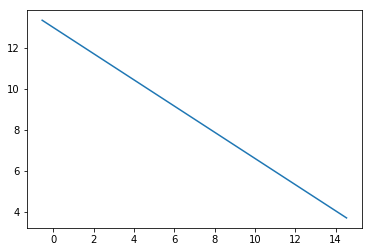

error value is [[0.15774412]]


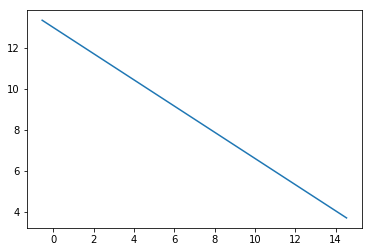

error value is [[0.15769348]]


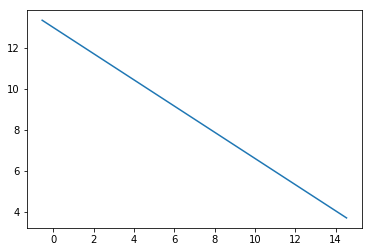

error value is [[0.1576429]]


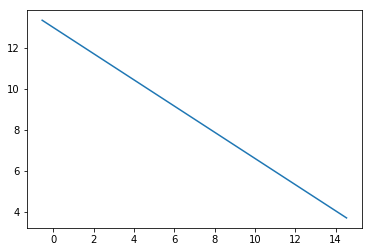

error value is [[0.15759237]]


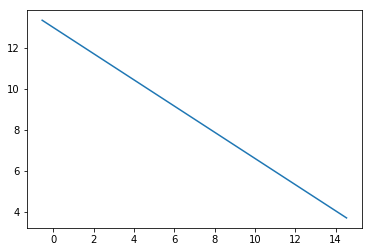

error value is [[0.15754188]]


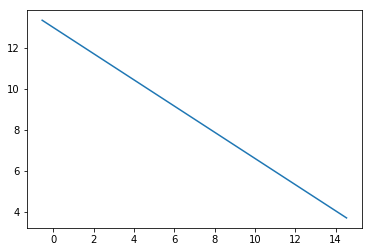

error value is [[0.15749144]]


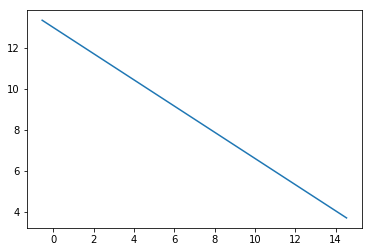

error value is [[0.15744106]]


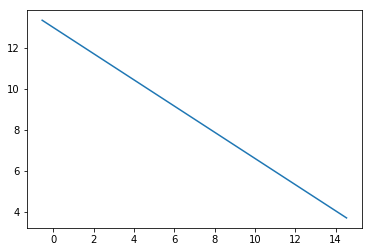

error value is [[0.15739072]]


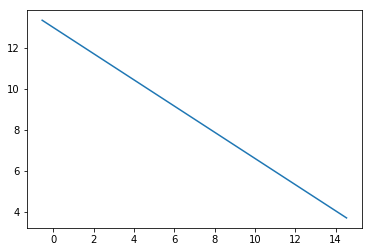

error value is [[0.15734043]]


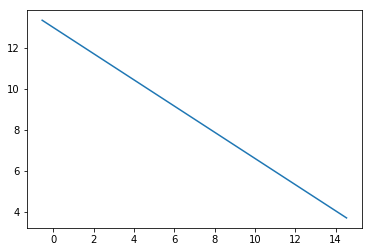

error value is [[0.1572902]]


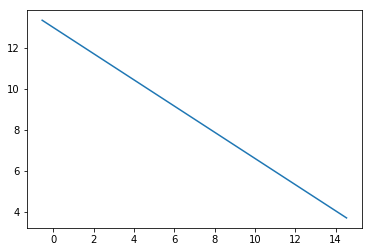

error value is [[0.15724001]]


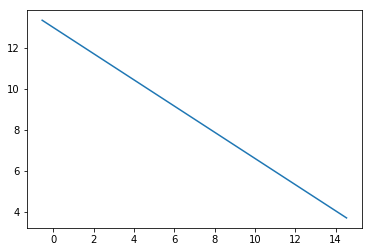

error value is [[0.15718987]]


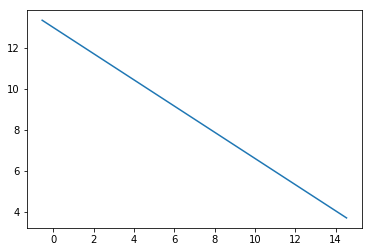

error value is [[0.15713978]]


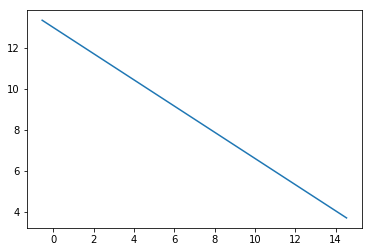

error value is [[0.15708973]]


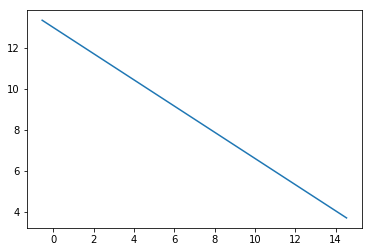

error value is [[0.15703974]]


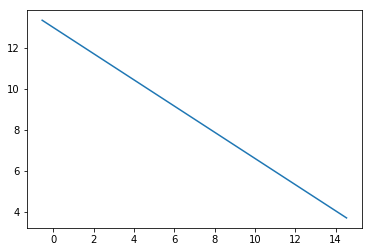

error value is [[0.1569898]]


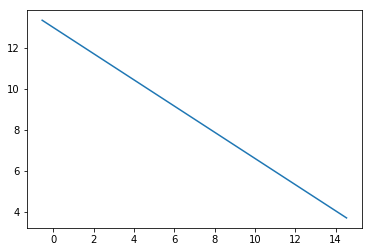

error value is [[0.1569399]]


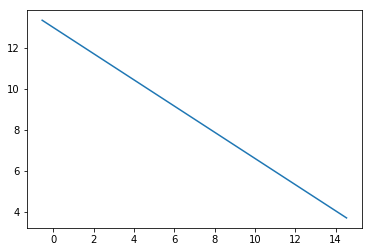

error value is [[0.15689005]]


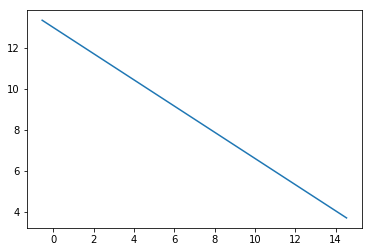

error value is [[0.15684025]]


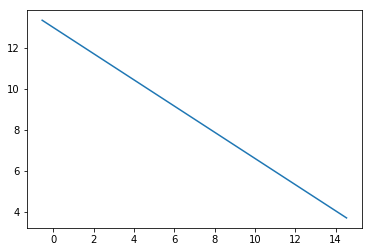

error value is [[0.1567905]]


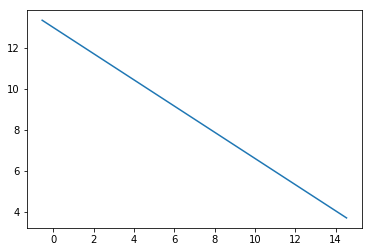

error value is [[0.1567408]]


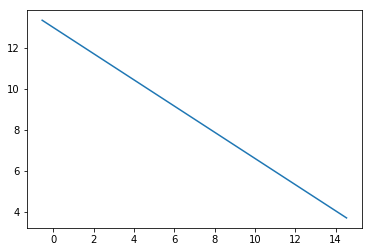

error value is [[0.15669115]]


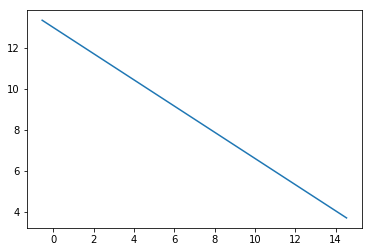

error value is [[0.15664154]]


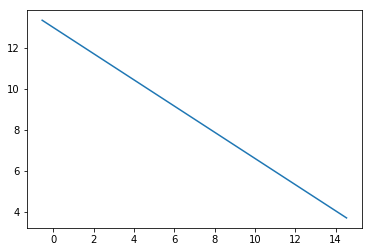

error value is [[0.15659199]]


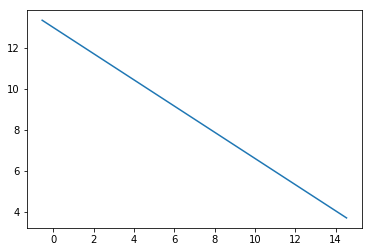

error value is [[0.15654248]]


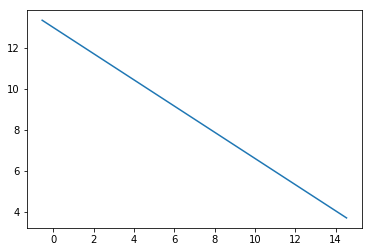

error value is [[0.15649302]]


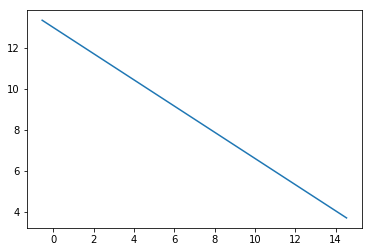

error value is [[0.1564436]]


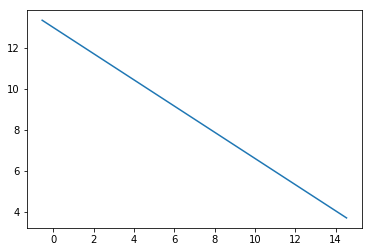

error value is [[0.15639424]]


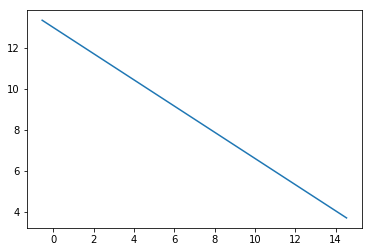

error value is [[0.15634492]]


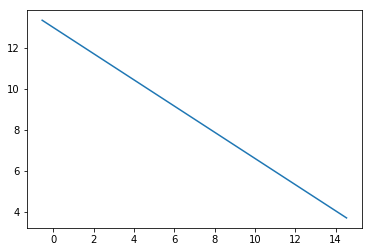

error value is [[0.15629565]]


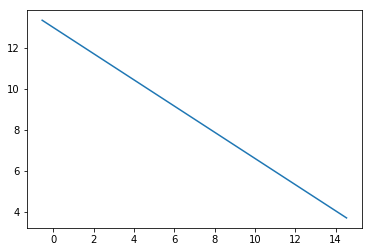

error value is [[0.15624643]]


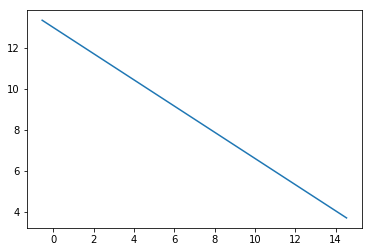

error value is [[0.15619726]]


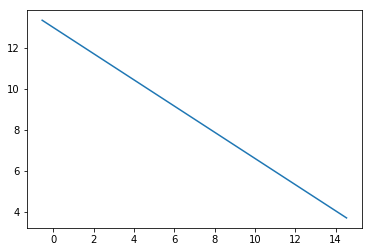

error value is [[0.15614813]]


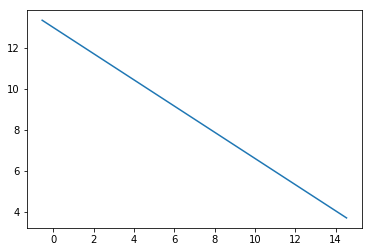

error value is [[0.15609905]]


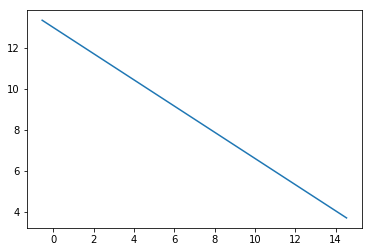

error value is [[0.15605002]]


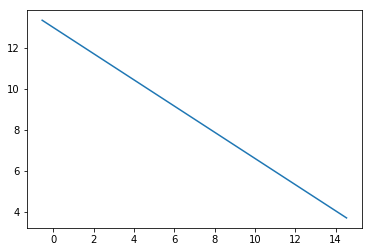

error value is [[0.15600103]]


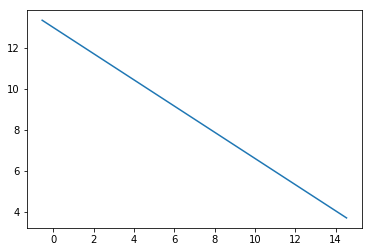

error value is [[0.1559521]]


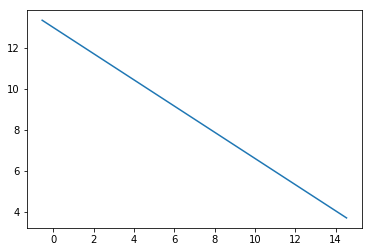

error value is [[0.15590321]]


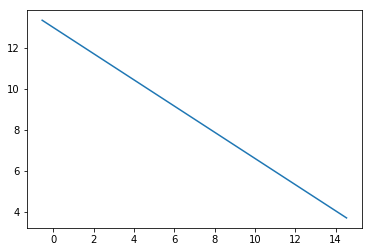

error value is [[0.15585436]]


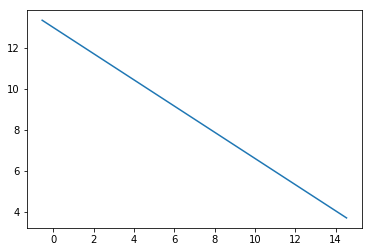

error value is [[0.15580557]]


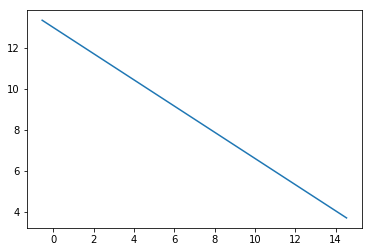

error value is [[0.15575682]]


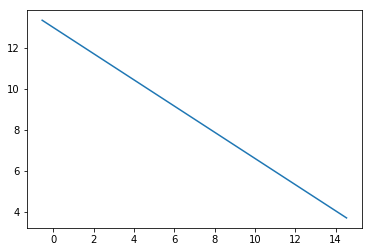

error value is [[0.15570812]]


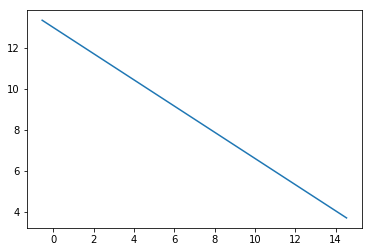

error value is [[0.15565946]]


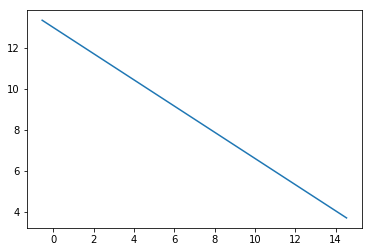

error value is [[0.15561085]]


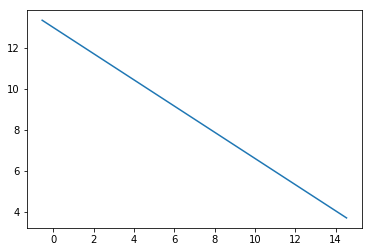

error value is [[0.15556229]]


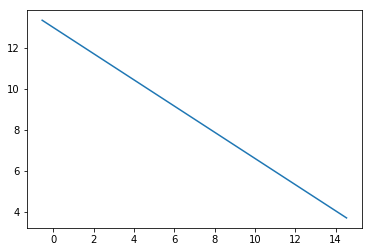

error value is [[0.15551378]]


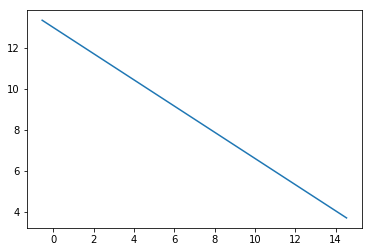

error value is [[0.15546531]]


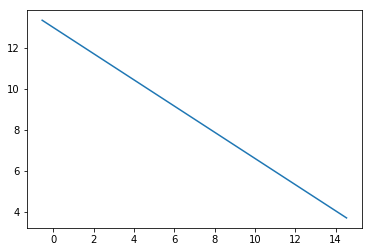

error value is [[0.15541688]]


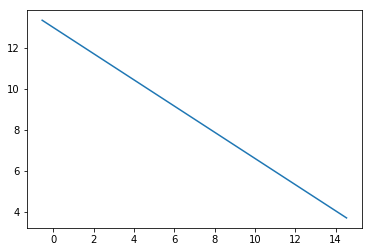

error value is [[0.15536851]]


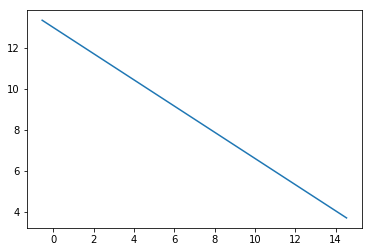

error value is [[0.15532018]]


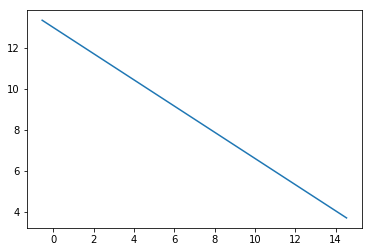

error value is [[0.1552719]]


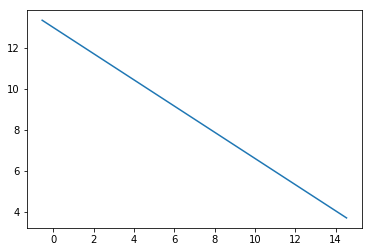

error value is [[0.15522366]]


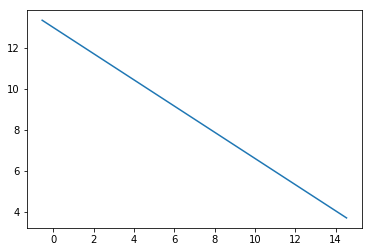

error value is [[0.15517547]]


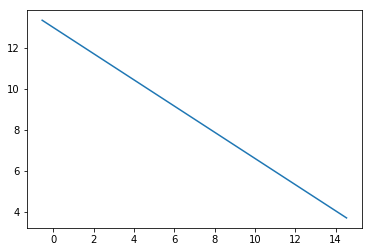

error value is [[0.15512732]]


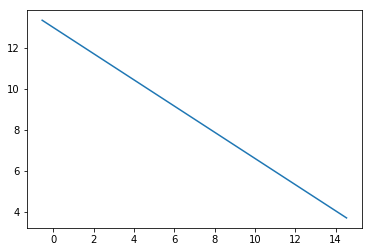

error value is [[0.15507922]]


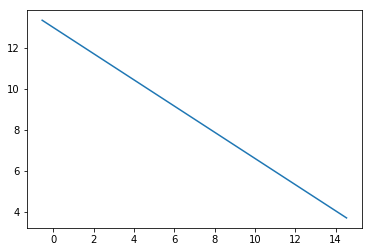

error value is [[0.15503117]]


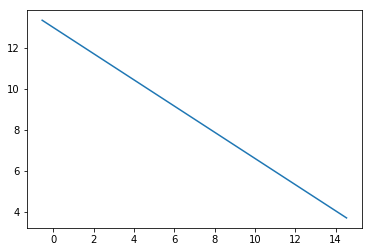

error value is [[0.15498316]]


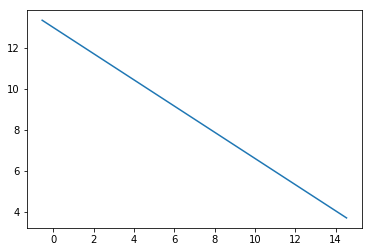

error value is [[0.1549352]]


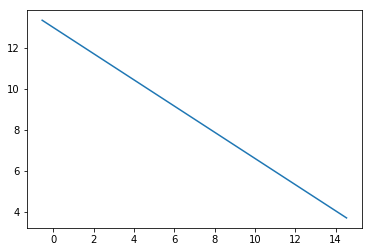

error value is [[0.15488729]]


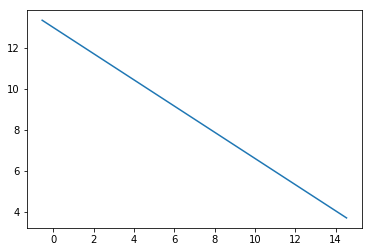

error value is [[0.15483942]]


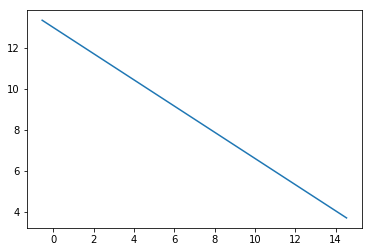

error value is [[0.15479159]]


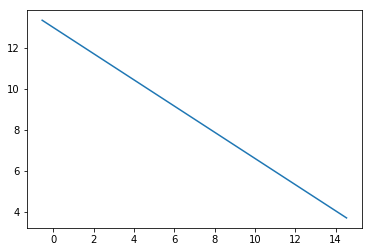

error value is [[0.15474381]]


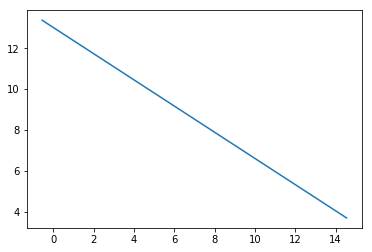

error value is [[0.15469608]]


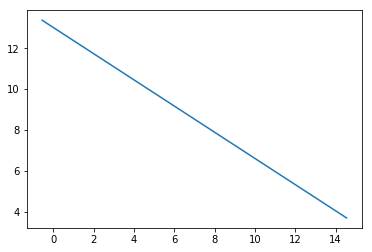

error value is [[0.15464839]]


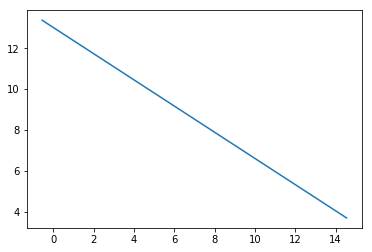

error value is [[0.15460075]]


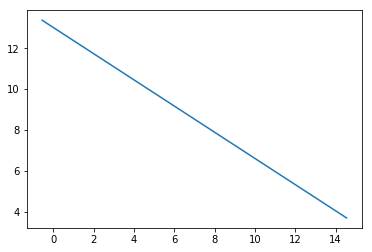

error value is [[0.15455315]]


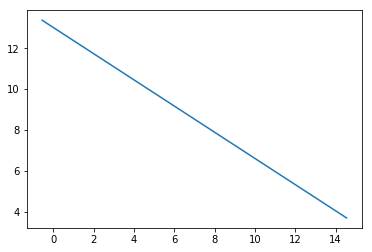

error value is [[0.1545056]]


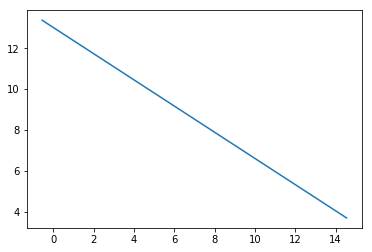

error value is [[0.15445809]]


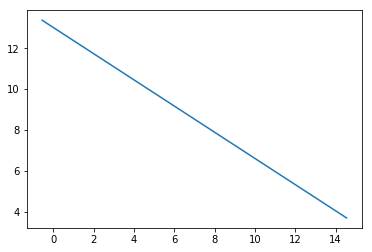

error value is [[0.15441063]]


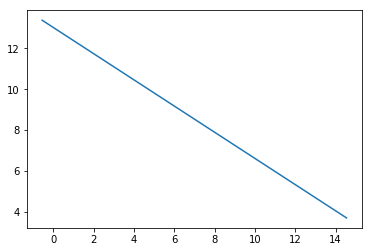

error value is [[0.15436321]]


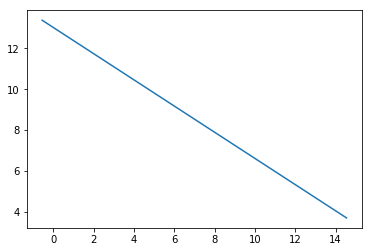

error value is [[0.15431584]]


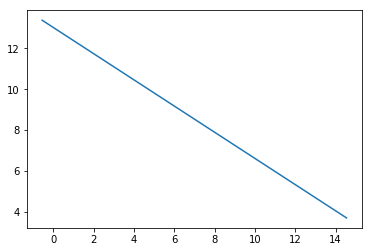

error value is [[0.15426851]]


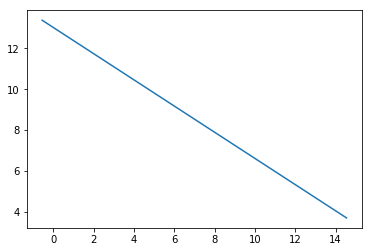

error value is [[0.15422123]]


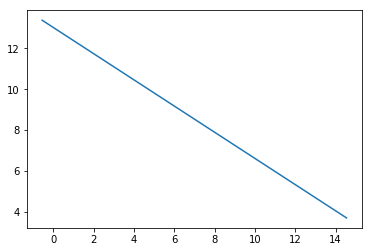

error value is [[0.15417399]]


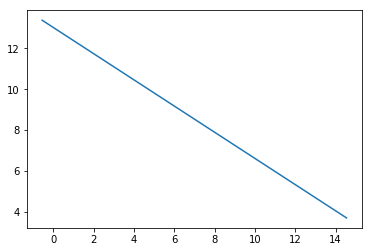

error value is [[0.15412679]]


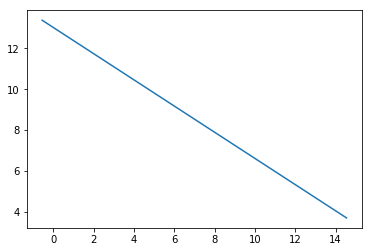

error value is [[0.15407965]]


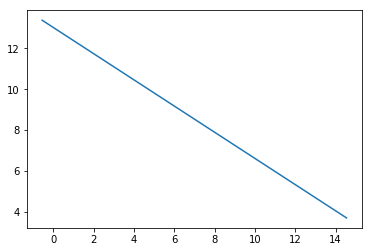

error value is [[0.15403254]]


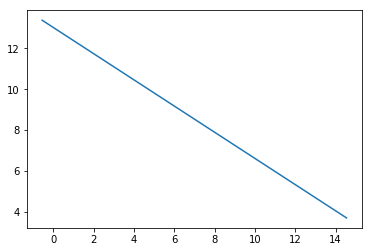

error value is [[0.15398548]]


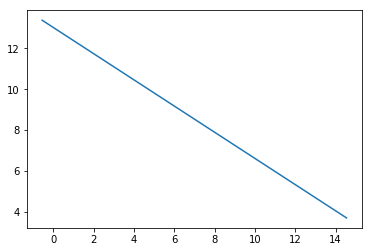

error value is [[0.15393847]]


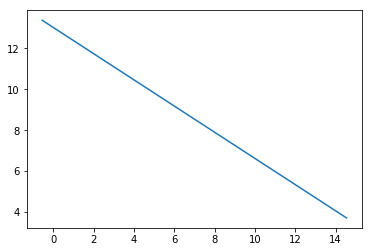

error value is [[0.15389149]]


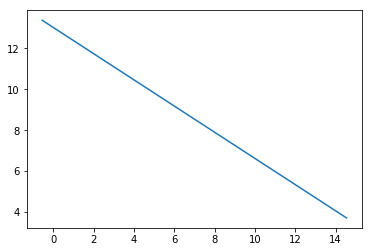

error value is [[0.15384457]]


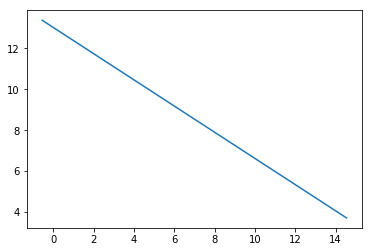

error value is [[0.15379768]]


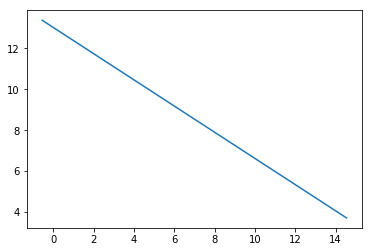

error value is [[0.15375084]]


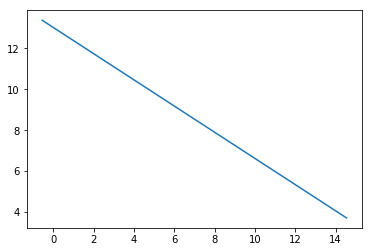

error value is [[0.15370405]]


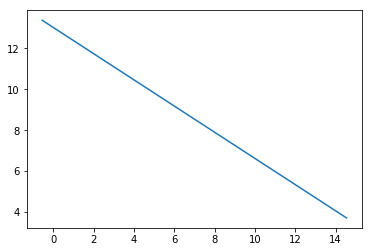

error value is [[0.1536573]]


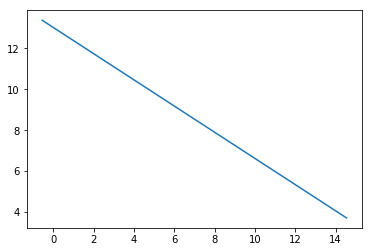

error value is [[0.15361059]]


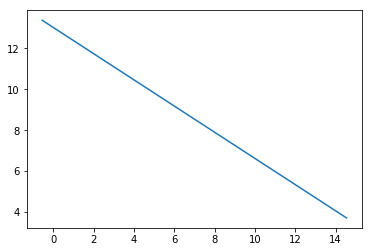

error value is [[0.15356393]]


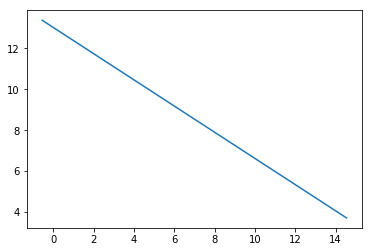

error value is [[0.15351731]]


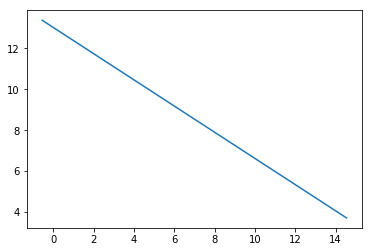

error value is [[0.15347073]]


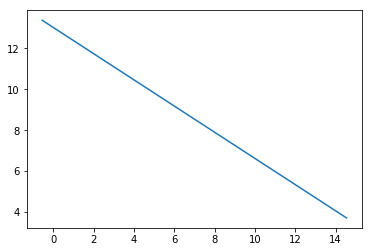

error value is [[0.1534242]]


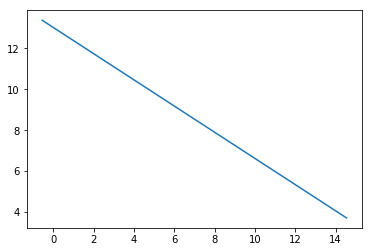

error value is [[0.15337771]]


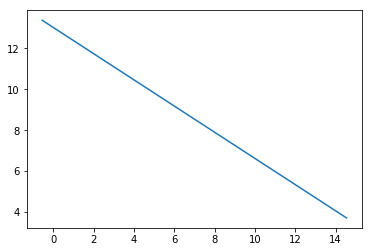

error value is [[0.15333127]]


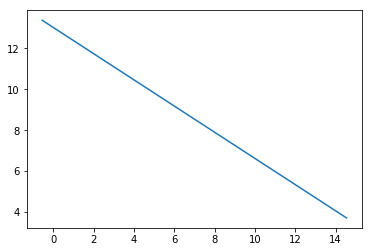

error value is [[0.15328487]]


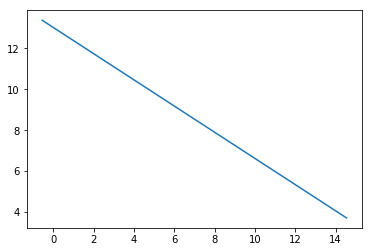

error value is [[0.15323851]]


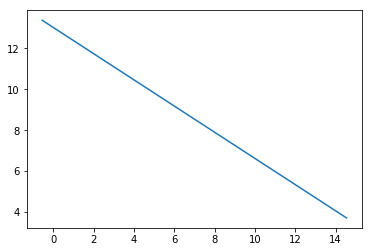

error value is [[0.15319219]]


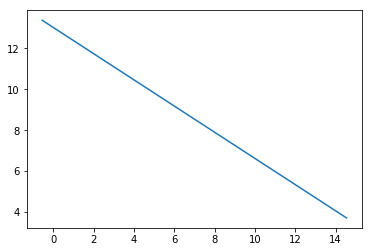

error value is [[0.15314592]]


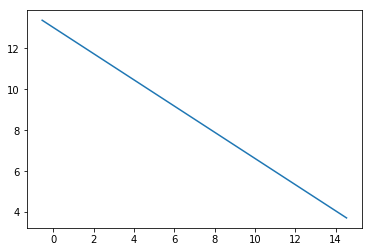

error value is [[0.1530997]]


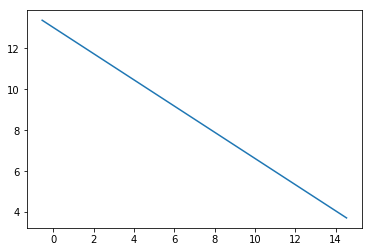

error value is [[0.15305351]]


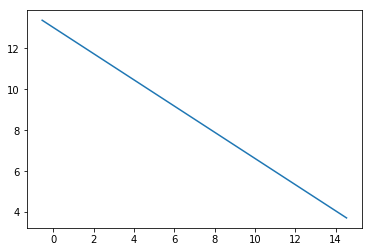

error value is [[0.15300737]]


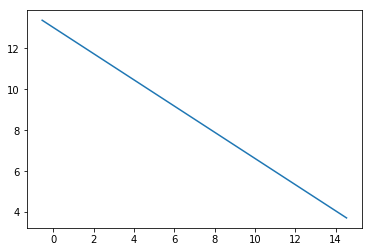

error value is [[0.15296127]]


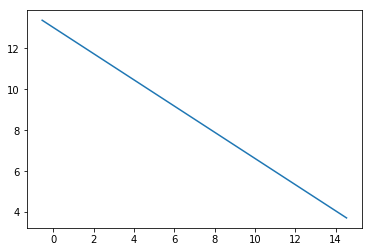

error value is [[0.15291521]]


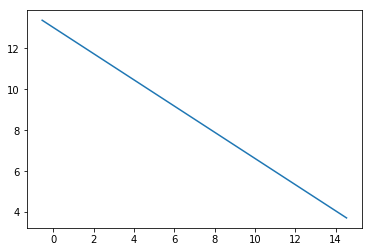

error value is [[0.1528692]]


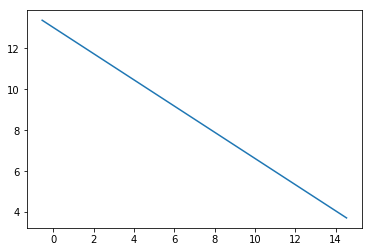

error value is [[0.15282323]]


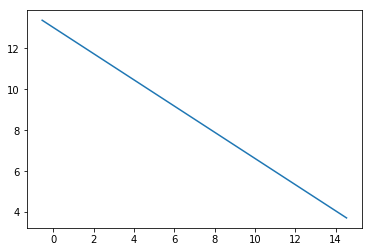

error value is [[0.1527773]]


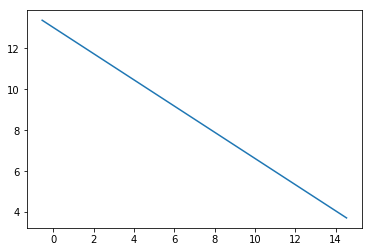

error value is [[0.15273142]]


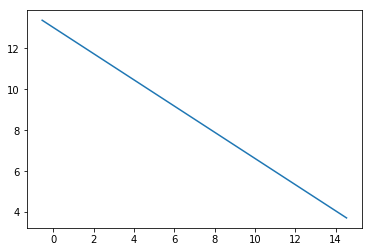

error value is [[0.15268558]]


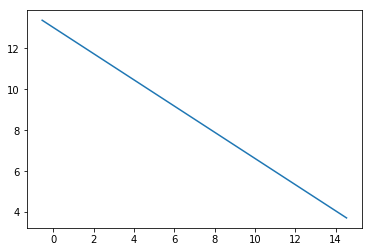

error value is [[0.15263978]]


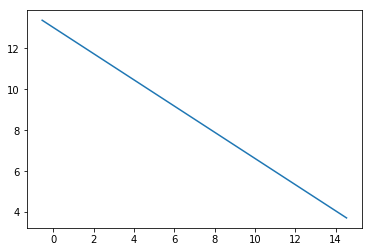

error value is [[0.15259402]]


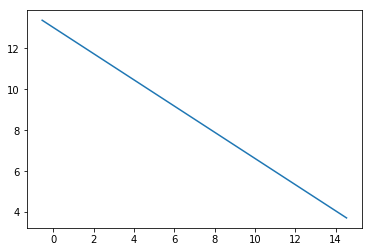

error value is [[0.15254831]]


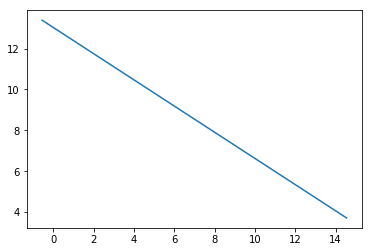

error value is [[0.15250263]]


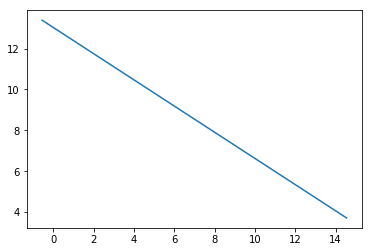

error value is [[0.152457]]


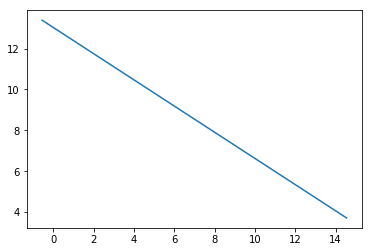

error value is [[0.15241142]]


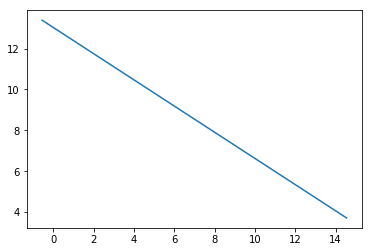

error value is [[0.15236587]]


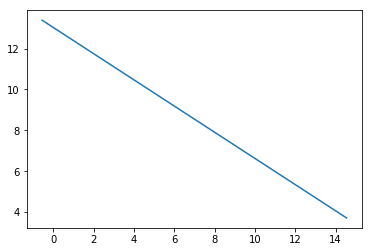

error value is [[0.15232037]]


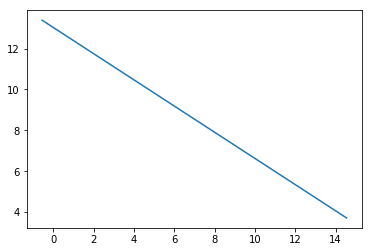

error value is [[0.15227491]]


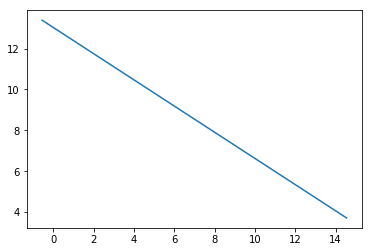

error value is [[0.15222949]]


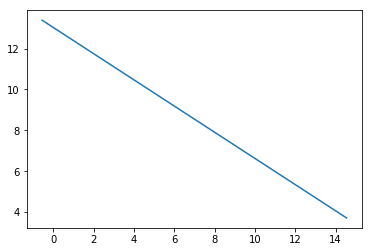

error value is [[0.15218411]]


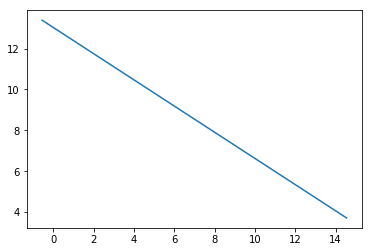

error value is [[0.15213878]]


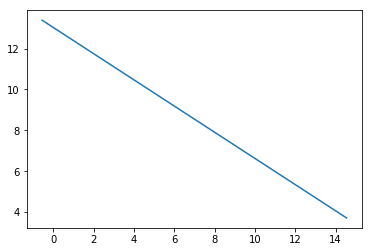

error value is [[0.15209348]]


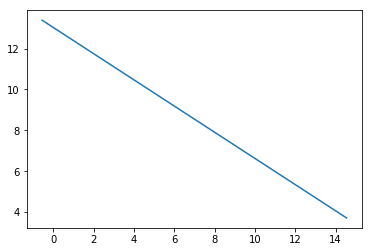

error value is [[0.15204823]]


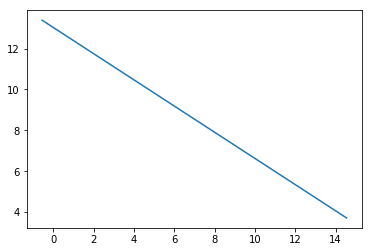

error value is [[0.15200302]]


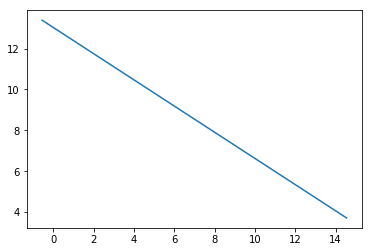

error value is [[0.15195785]]


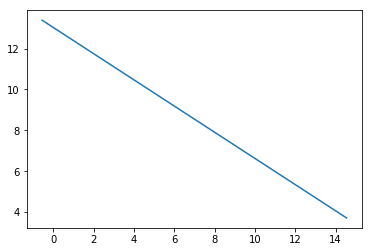

error value is [[0.15191273]]


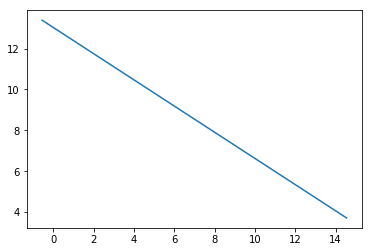

error value is [[0.15186764]]


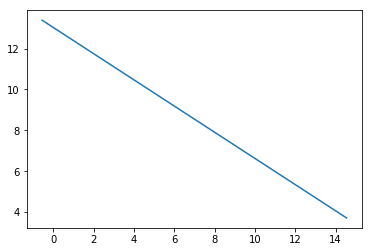

error value is [[0.1518226]]


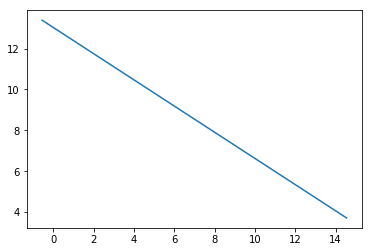

error value is [[0.1517776]]


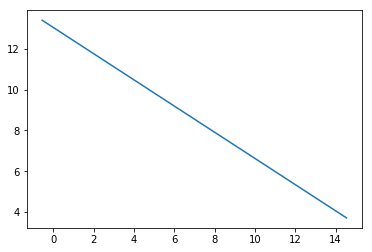

error value is [[0.15173264]]


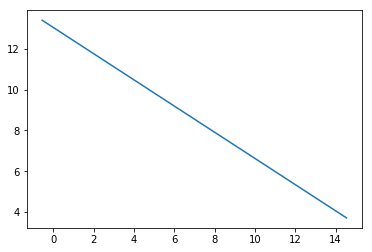

error value is [[0.15168772]]


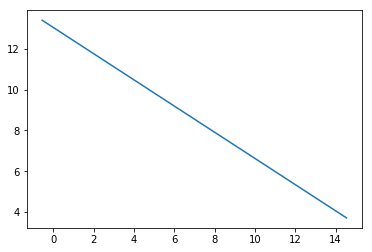

error value is [[0.15164284]]


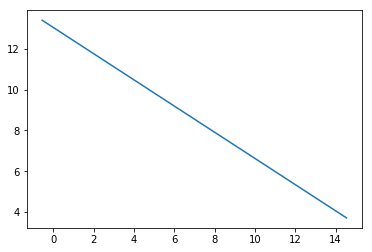

error value is [[0.151598]]


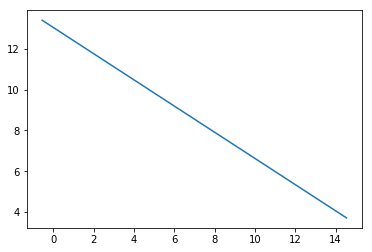

error value is [[0.15155321]]


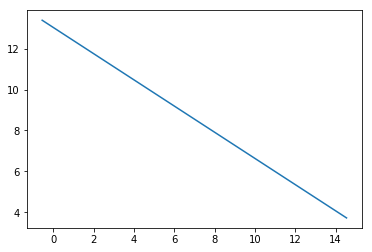

error value is [[0.15150845]]


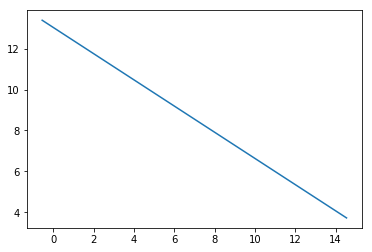

error value is [[0.15146374]]


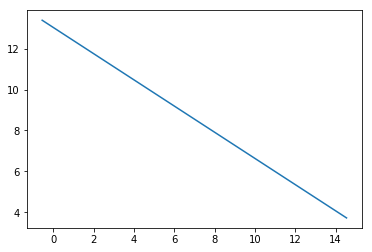

error value is [[0.15141907]]


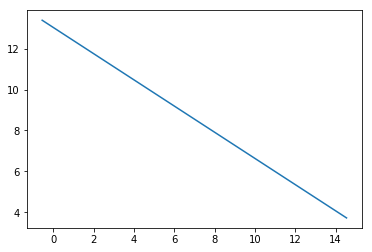

error value is [[0.15137443]]


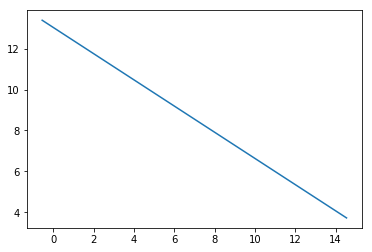

error value is [[0.15132984]]


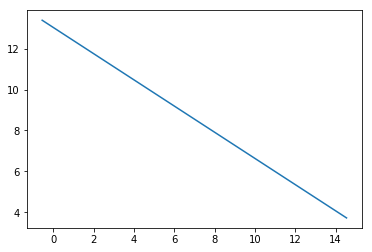

error value is [[0.15128529]]


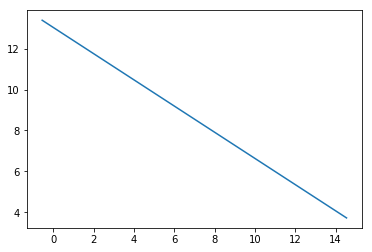

error value is [[0.15124078]]


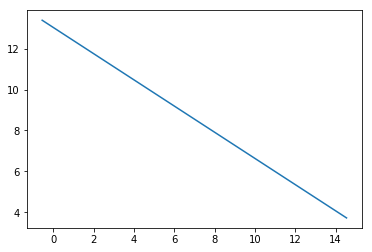

error value is [[0.15119631]]


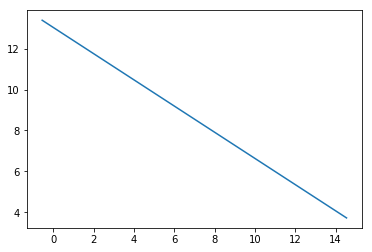

error value is [[0.15115189]]


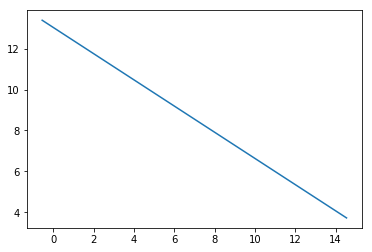

error value is [[0.1511075]]


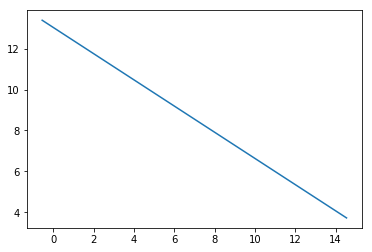

error value is [[0.15106315]]


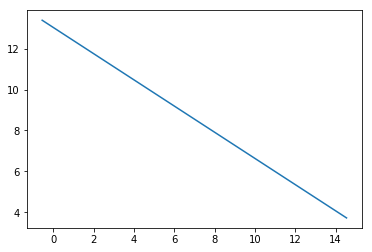

error value is [[0.15101884]]


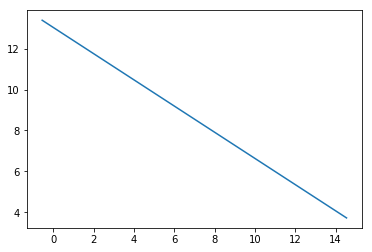

error value is [[0.15097458]]


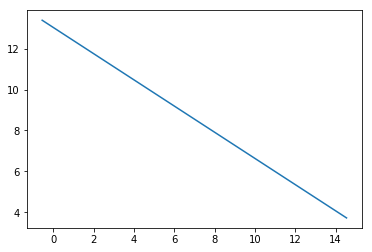

error value is [[0.15093035]]


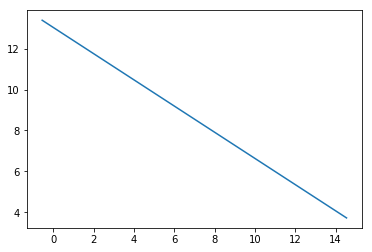

error value is [[0.15088617]]


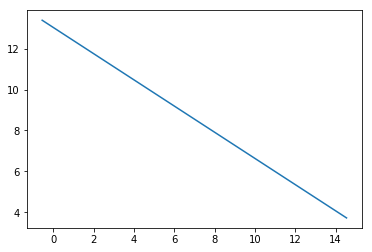

error value is [[0.15084202]]


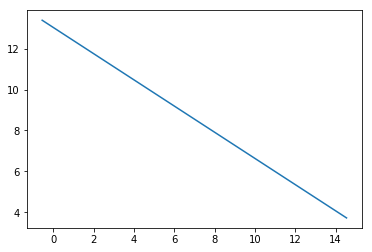

error value is [[0.15079792]]


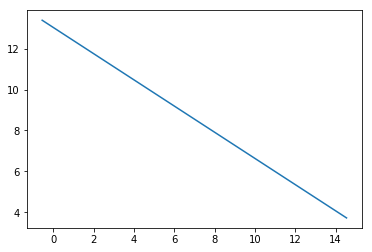

error value is [[0.15075385]]


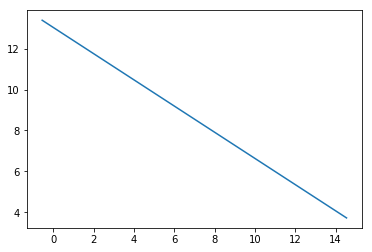

error value is [[0.15070983]]


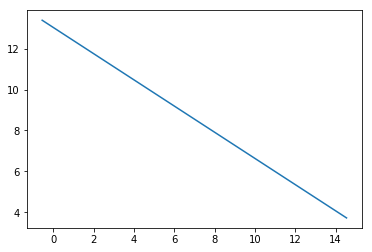

error value is [[0.15066584]]


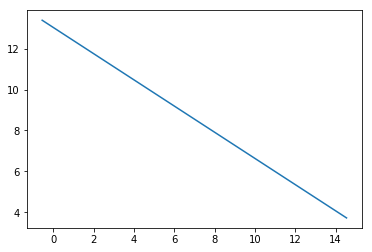

error value is [[0.15062189]]


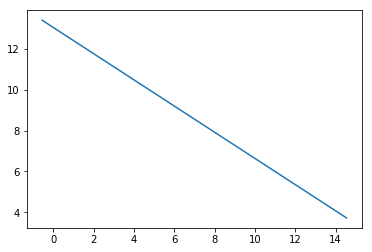

error value is [[0.15057799]]


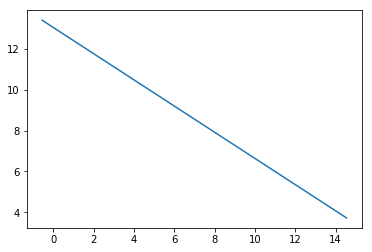

error value is [[0.15053412]]


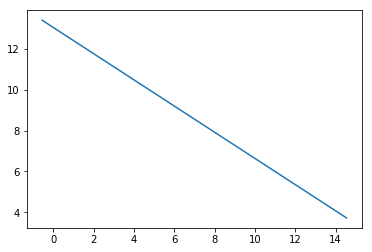

error value is [[0.1504903]]


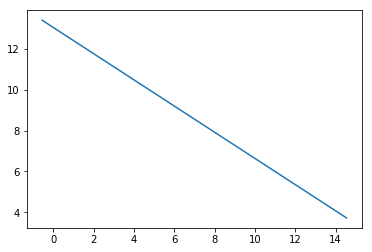

error value is [[0.15044651]]


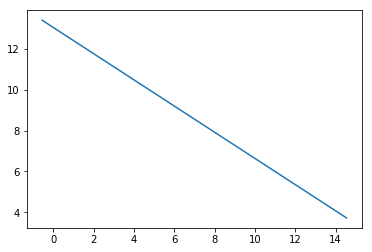

error value is [[0.15040276]]


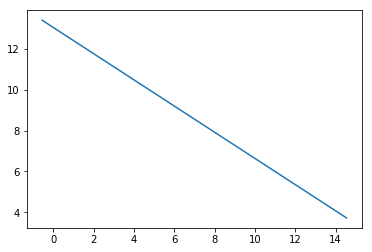

error value is [[0.15035906]]


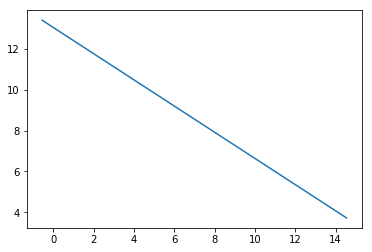

error value is [[0.15031539]]


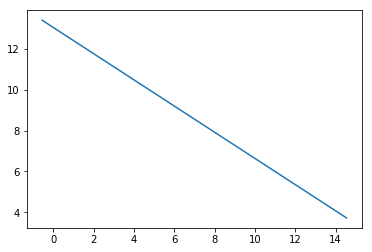

error value is [[0.15027176]]


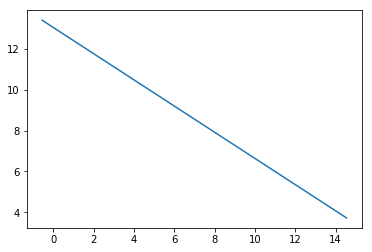

error value is [[0.15022817]]


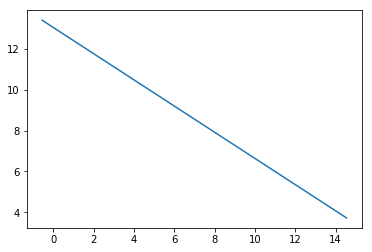

error value is [[0.15018462]]


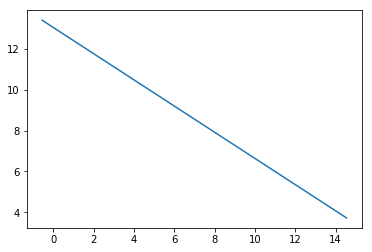

error value is [[0.15014111]]


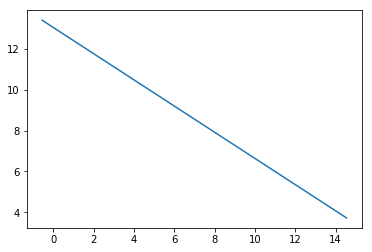

error value is [[0.15009764]]


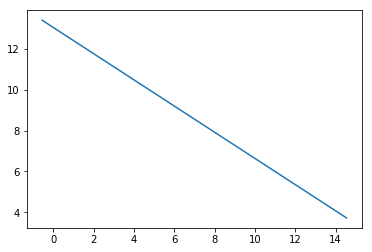

error value is [[0.15005421]]


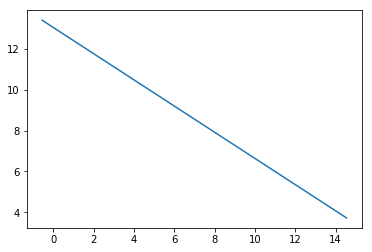

error value is [[0.15001082]]


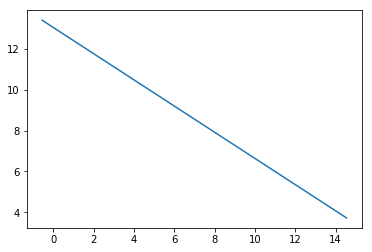

error value is [[0.14996747]]


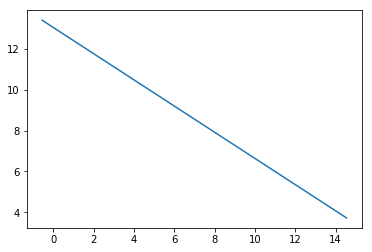

error value is [[0.14992415]]


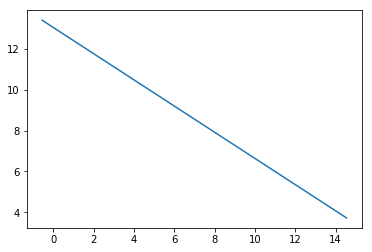

error value is [[0.14988088]]


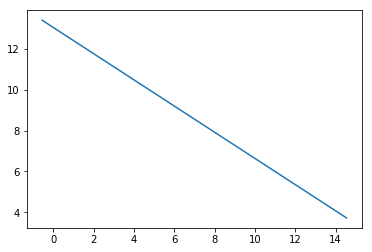

error value is [[0.14983764]]


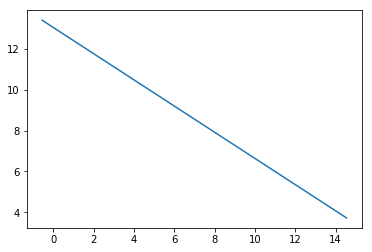

error value is [[0.14979444]]


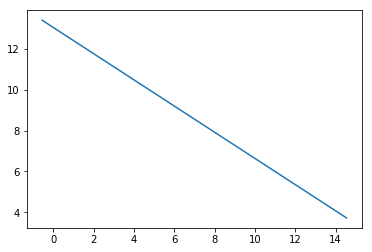

error value is [[0.14975128]]


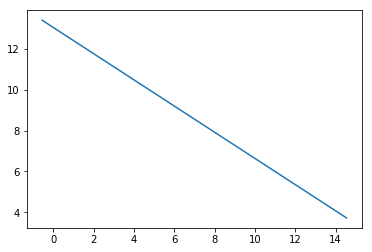

error value is [[0.14970816]]


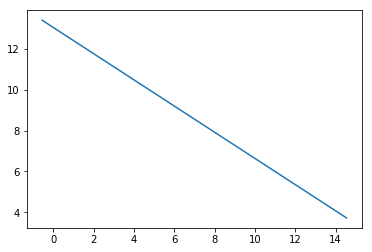

error value is [[0.14966508]]


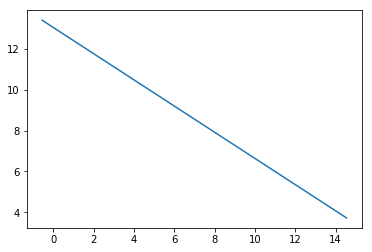

error value is [[0.14962204]]


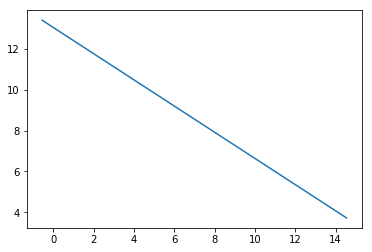

error value is [[0.14957903]]


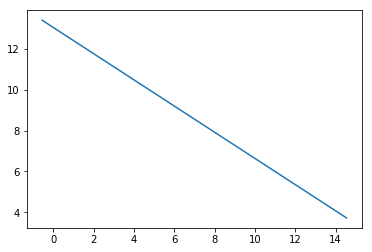

error value is [[0.14953607]]


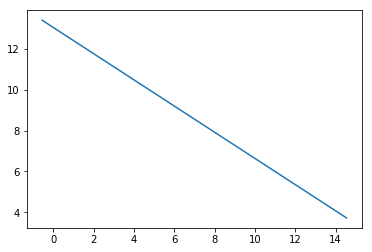

error value is [[0.14949314]]


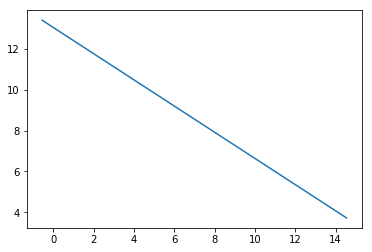

error value is [[0.14945025]]


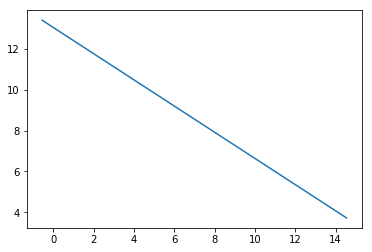

error value is [[0.1494074]]


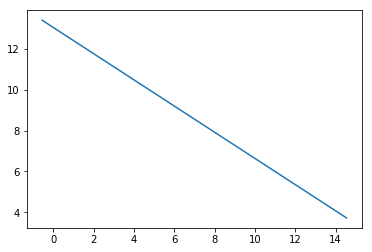

error value is [[0.14936459]]


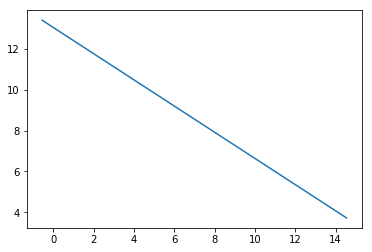

error value is [[0.14932182]]


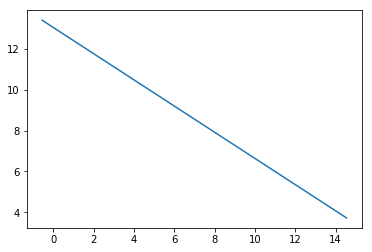

error value is [[0.14927908]]


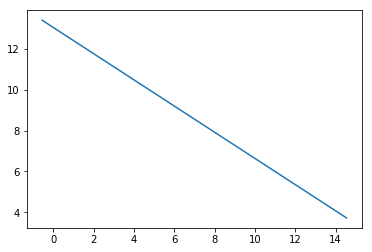

error value is [[0.14923638]]


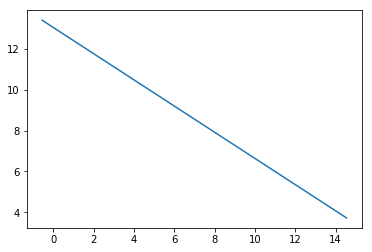

error value is [[0.14919372]]


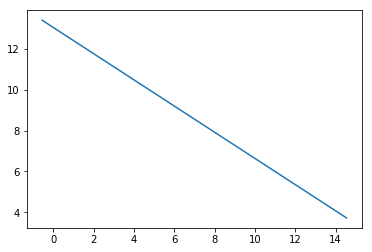

error value is [[0.1491511]]


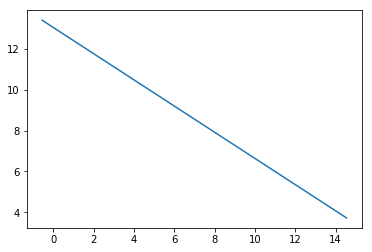

error value is [[0.14910852]]


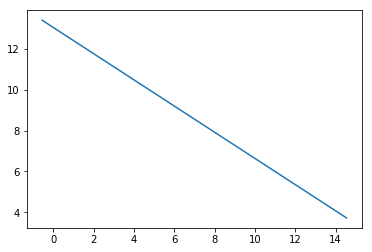

error value is [[0.14906597]]


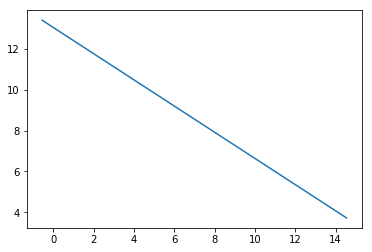

error value is [[0.14902347]]


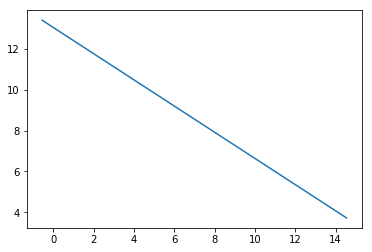

error value is [[0.148981]]


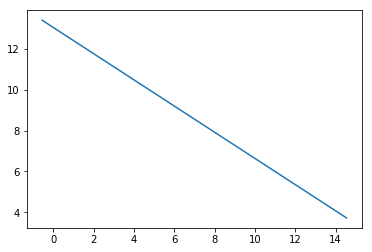

error value is [[0.14893857]]


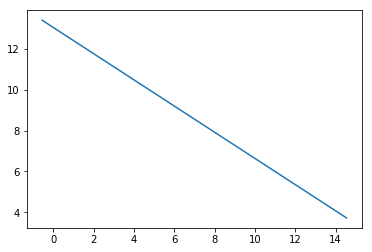

error value is [[0.14889617]]


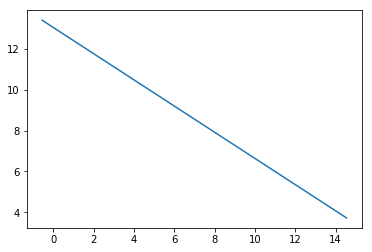

error value is [[0.14885381]]


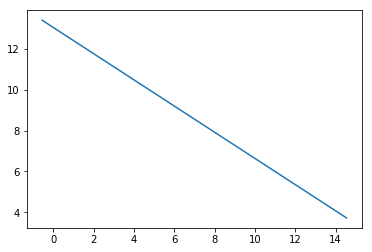

error value is [[0.1488115]]


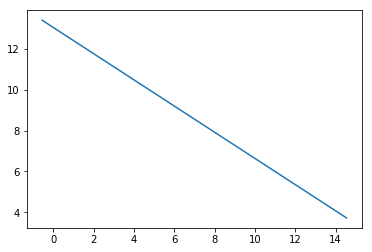

error value is [[0.14876921]]


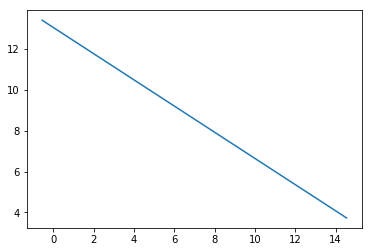

error value is [[0.14872697]]


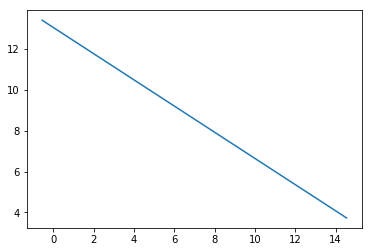

error value is [[0.14868476]]


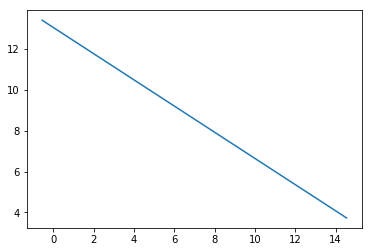

error value is [[0.1486426]]


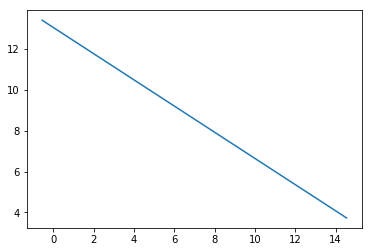

error value is [[0.14860046]]


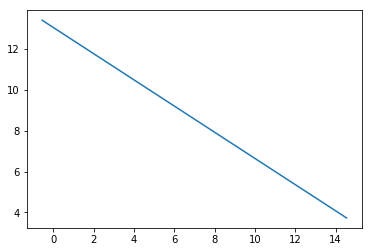

error value is [[0.14855837]]


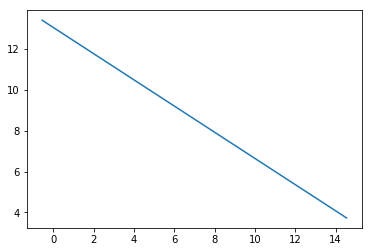

error value is [[0.14851631]]


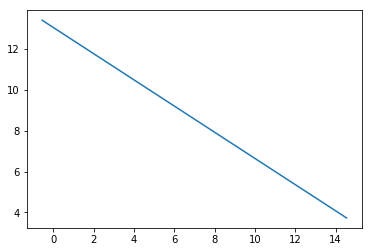

error value is [[0.14847429]]


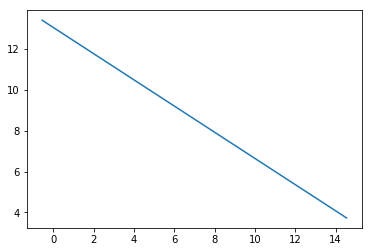

error value is [[0.14843231]]


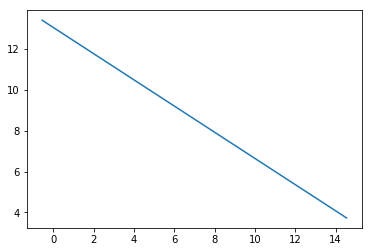

error value is [[0.14839037]]


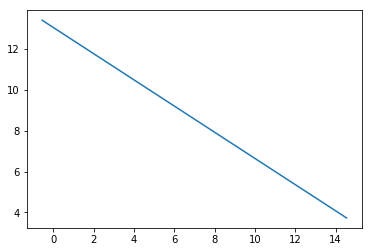

error value is [[0.14834846]]


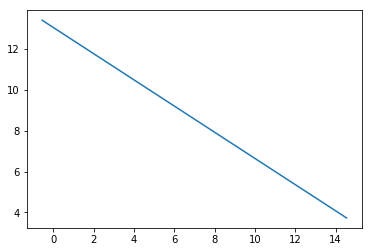

error value is [[0.14830659]]


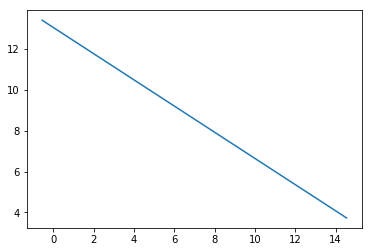

error value is [[0.14826475]]


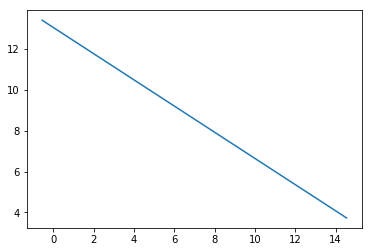

error value is [[0.14822295]]


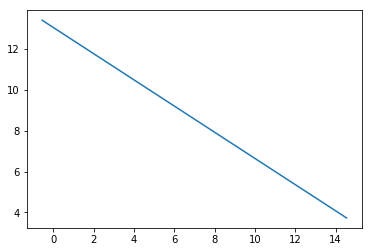

error value is [[0.14818119]]


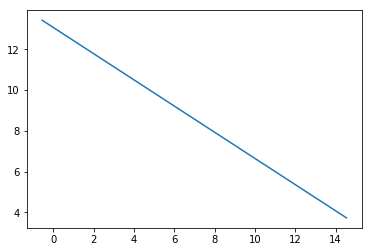

error value is [[0.14813947]]


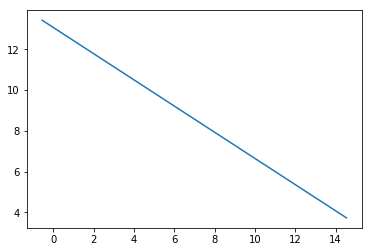

error value is [[0.14809778]]


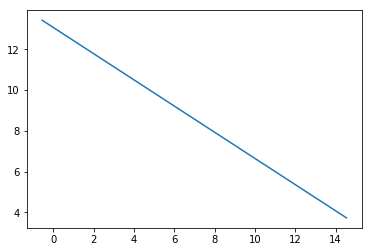

error value is [[0.14805613]]


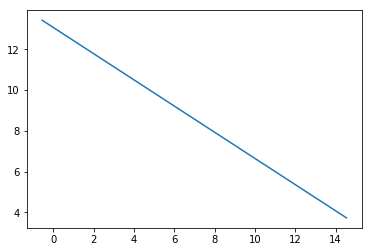

error value is [[0.14801452]]


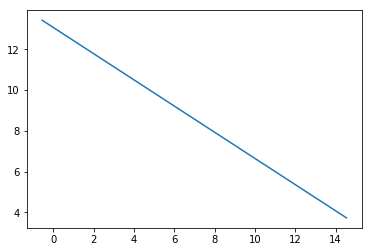

error value is [[0.14797294]]


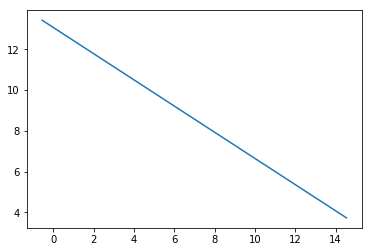

error value is [[0.1479314]]


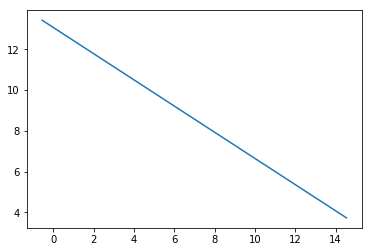

error value is [[0.1478899]]


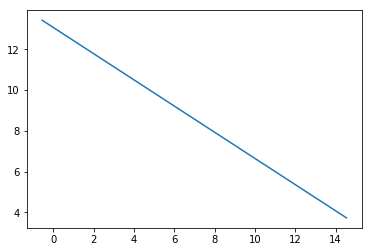

error value is [[0.14784843]]


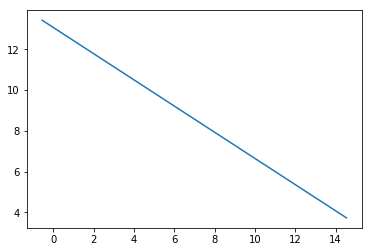

error value is [[0.147807]]


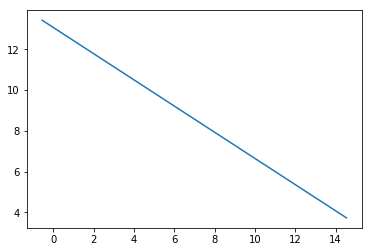

error value is [[0.1477656]]


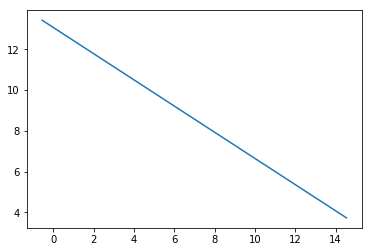

error value is [[0.14772424]]


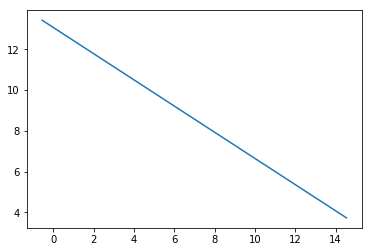

error value is [[0.14768292]]


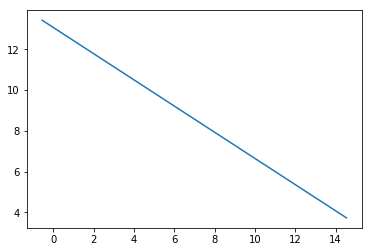

error value is [[0.14764164]]


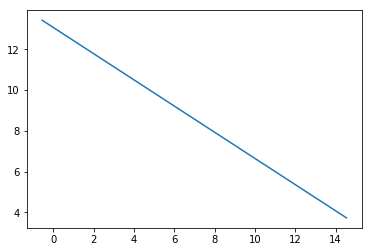

error value is [[0.14760038]]


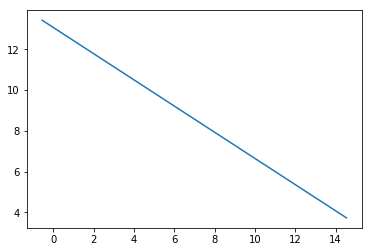

error value is [[0.14755917]]


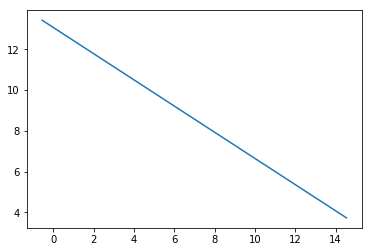

error value is [[0.14751799]]


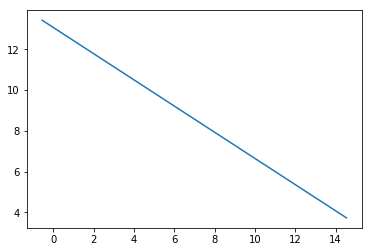

error value is [[0.14747685]]


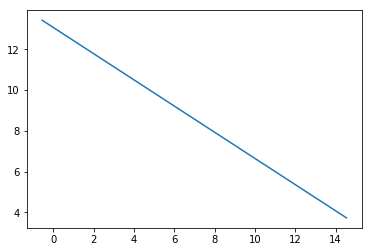

error value is [[0.14743575]]


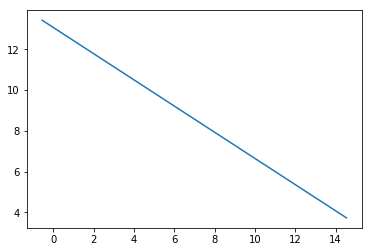

error value is [[0.14739468]]


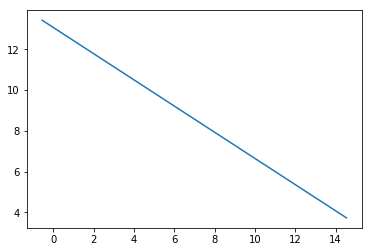

error value is [[0.14735364]]


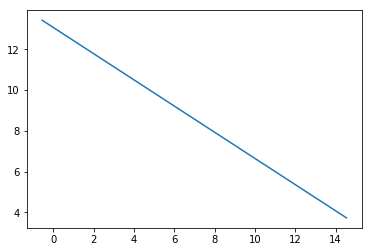

error value is [[0.14731264]]


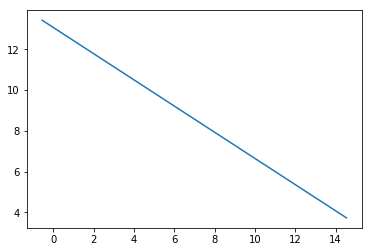

error value is [[0.14727168]]


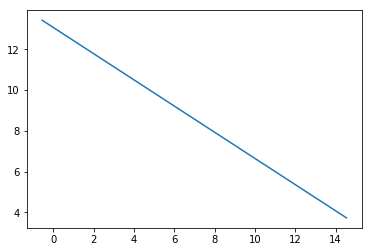

error value is [[0.14723075]]


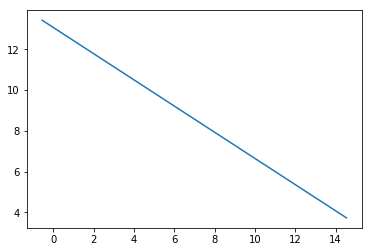

error value is [[0.14718986]]


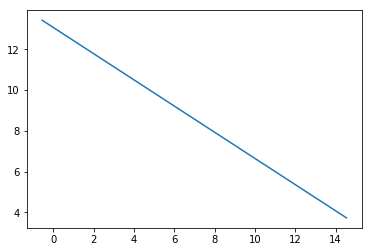

error value is [[0.14714901]]


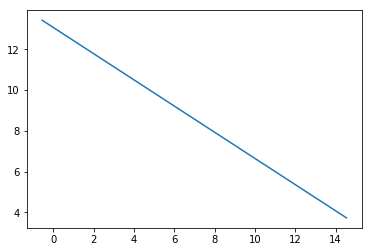

error value is [[0.14710819]]


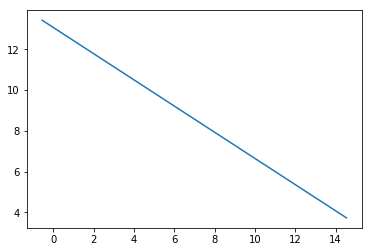

error value is [[0.1470674]]


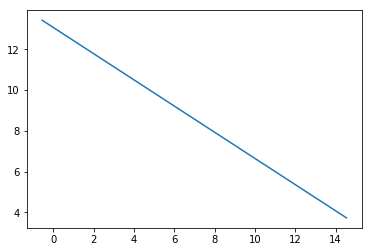

error value is [[0.14702665]]


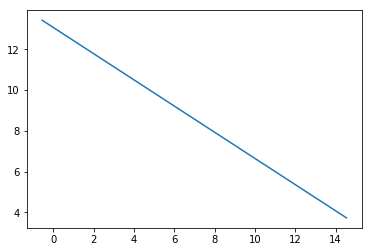

error value is [[0.14698594]]


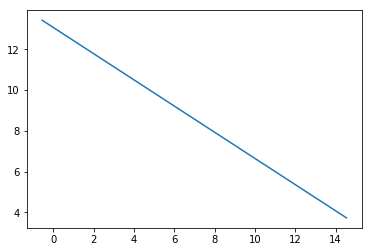

error value is [[0.14694526]]


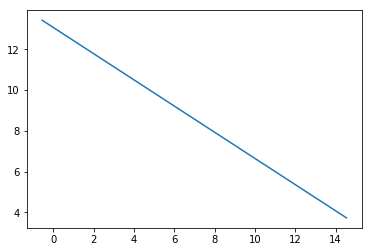

error value is [[0.14690462]]


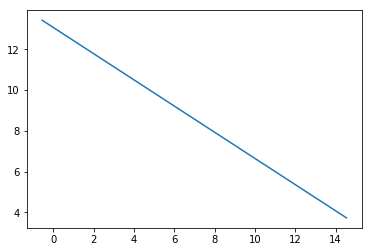

error value is [[0.14686401]]


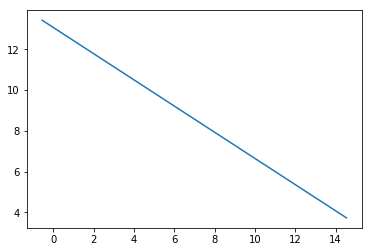

error value is [[0.14682344]]


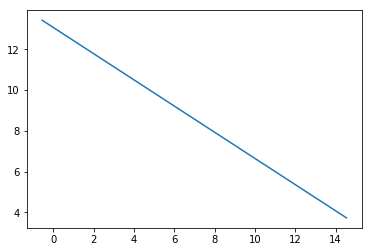

error value is [[0.1467829]]


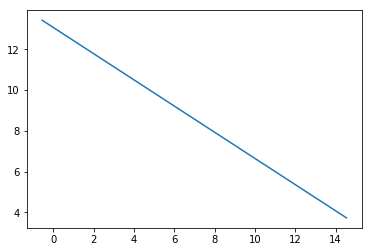

error value is [[0.1467424]]


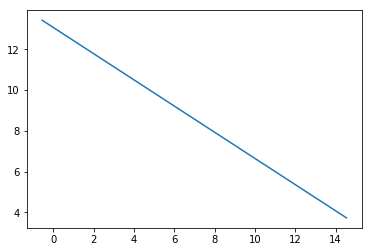

error value is [[0.14670193]]


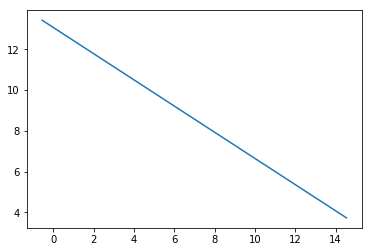

error value is [[0.1466615]]


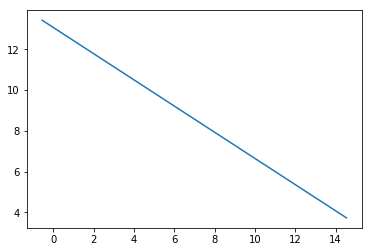

error value is [[0.1466211]]


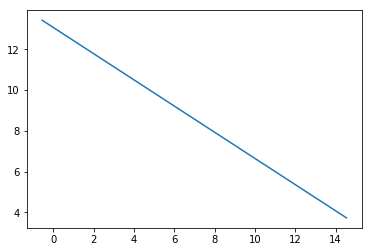

error value is [[0.14658074]]


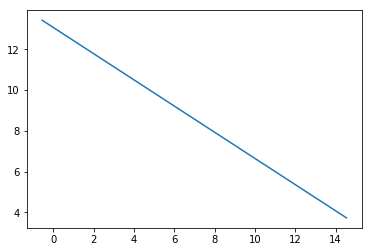

error value is [[0.14654041]]


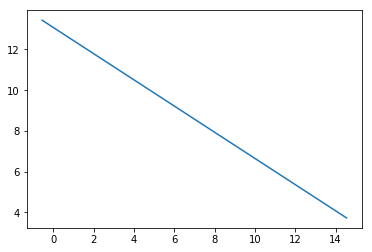

error value is [[0.14650012]]


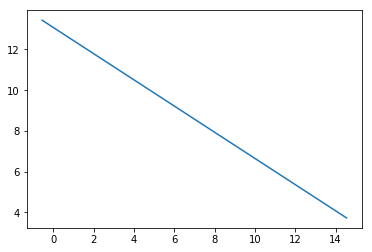

error value is [[0.14645986]]


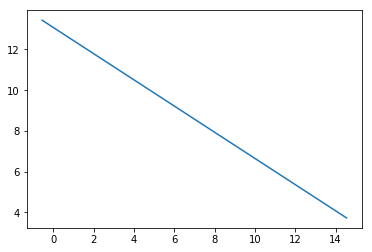

error value is [[0.14641964]]


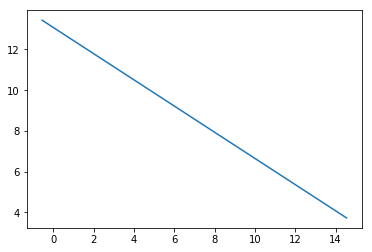

error value is [[0.14637945]]


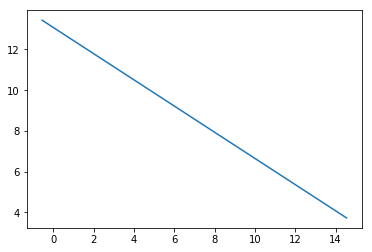

error value is [[0.14633929]]


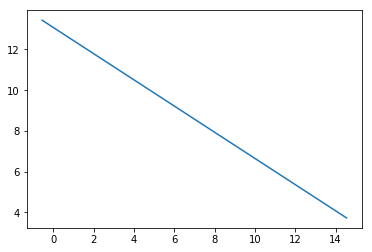

error value is [[0.14629917]]


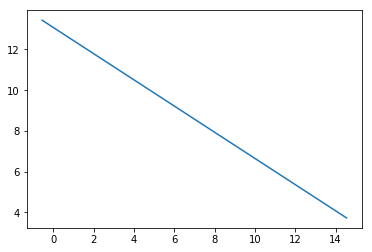

error value is [[0.14625909]]


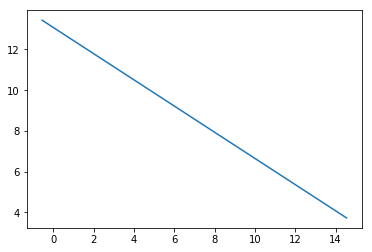

error value is [[0.14621904]]


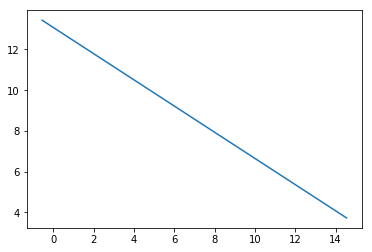

error value is [[0.14617902]]


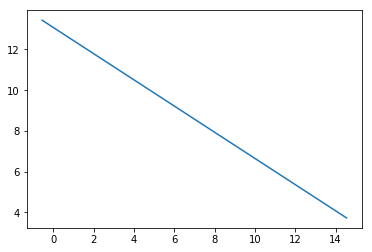

error value is [[0.14613904]]


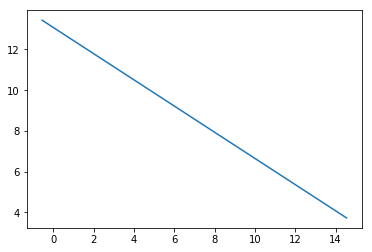

error value is [[0.1460991]]


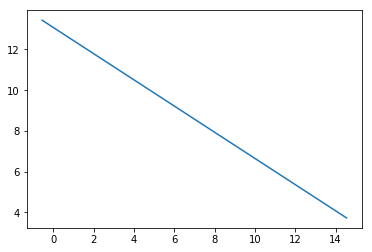

error value is [[0.14605918]]


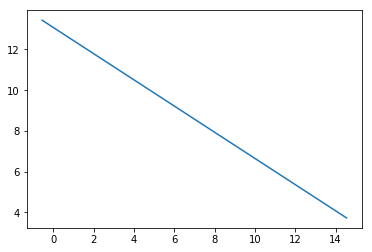

error value is [[0.14601931]]


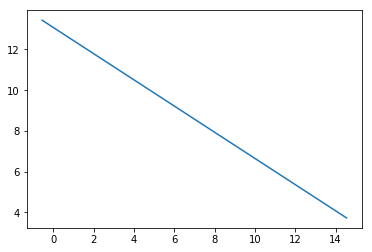

error value is [[0.14597946]]


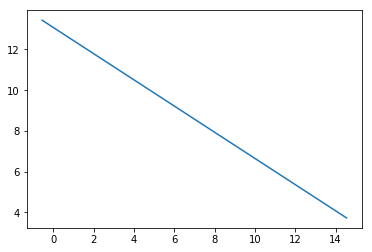

error value is [[0.14593965]]


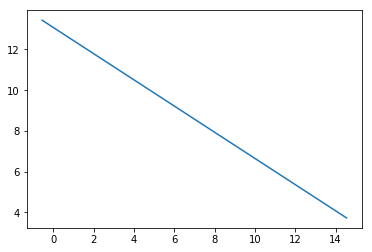

error value is [[0.14589988]]


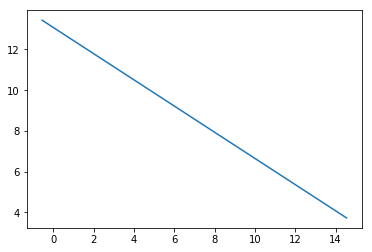

error value is [[0.14586013]]


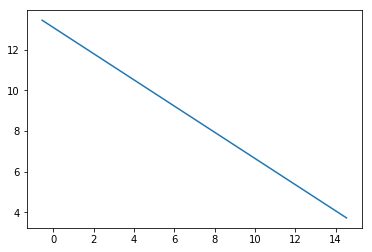

error value is [[0.14582043]]


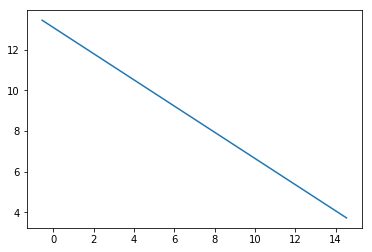

error value is [[0.14578075]]


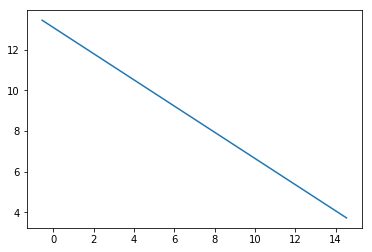

error value is [[0.14574111]]


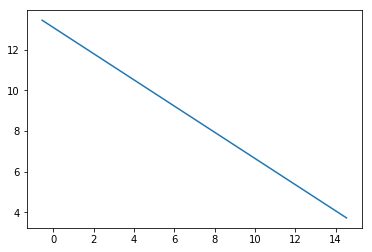

error value is [[0.14570151]]


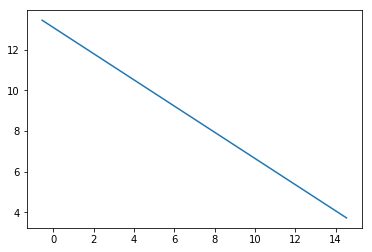

error value is [[0.14566194]]


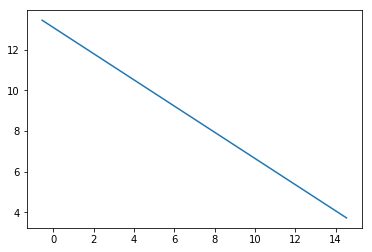

error value is [[0.1456224]]


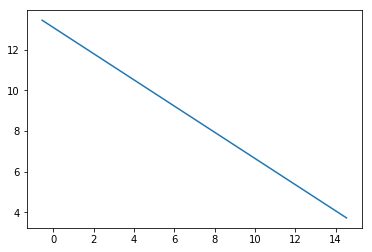

error value is [[0.14558289]]


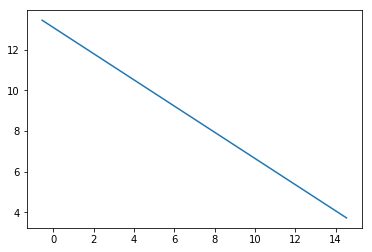

error value is [[0.14554342]]


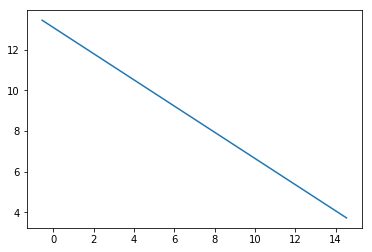

error value is [[0.14550399]]


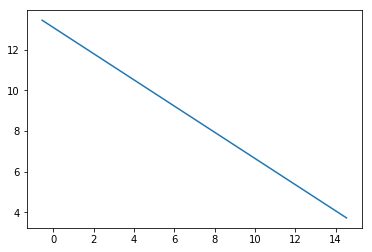

error value is [[0.14546458]]


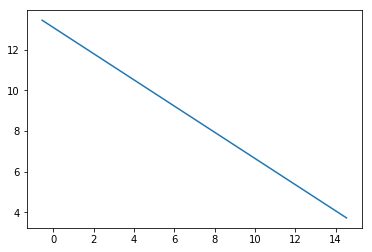

error value is [[0.14542521]]


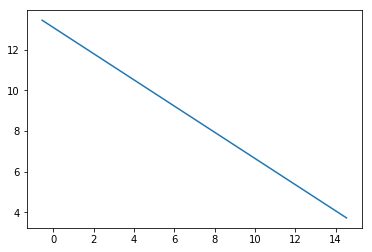

error value is [[0.14538588]]


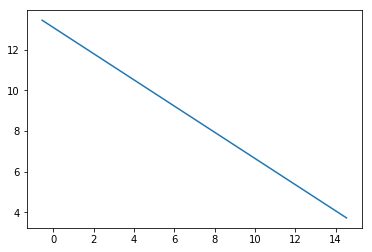

error value is [[0.14534658]]


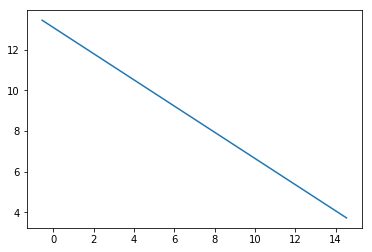

error value is [[0.14530731]]


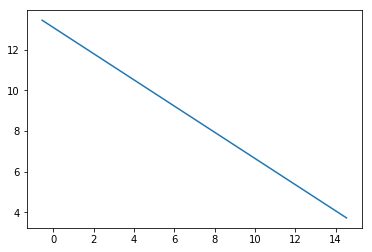

error value is [[0.14526807]]


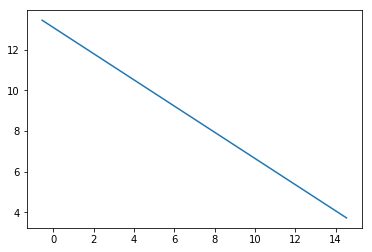

error value is [[0.14522887]]


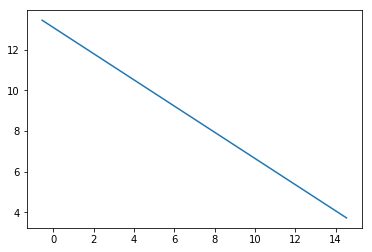

error value is [[0.1451897]]


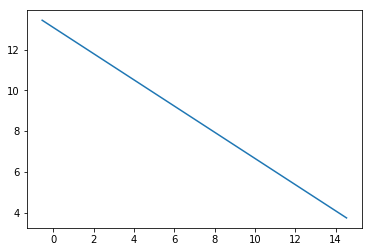

error value is [[0.14515056]]


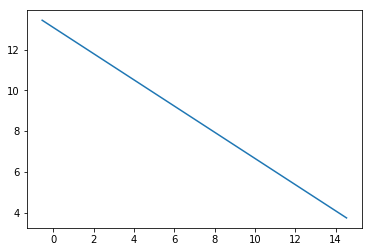

error value is [[0.14511146]]


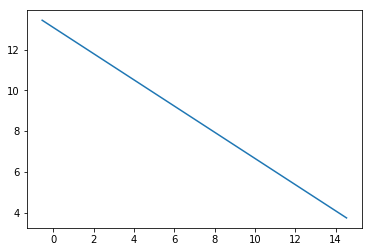

error value is [[0.14507239]]


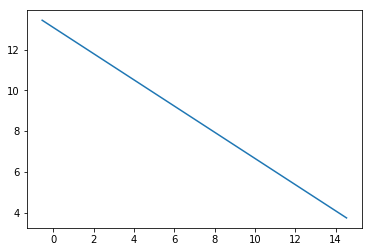

error value is [[0.14503336]]


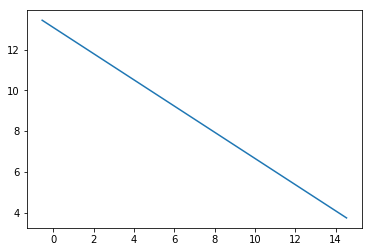

error value is [[0.14499435]]


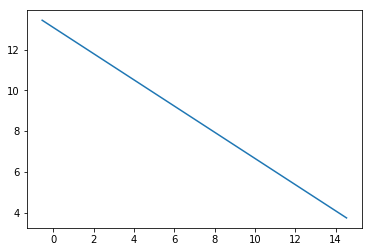

error value is [[0.14495538]]


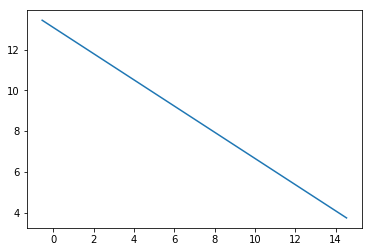

error value is [[0.14491645]]


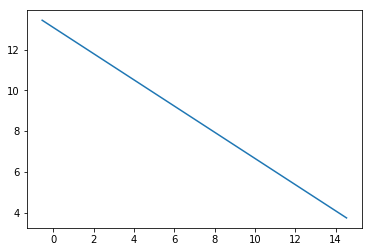

error value is [[0.14487754]]


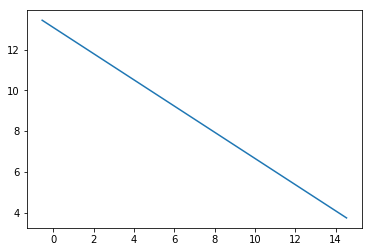

error value is [[0.14483867]]


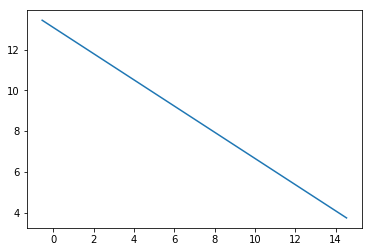

error value is [[0.14479983]]


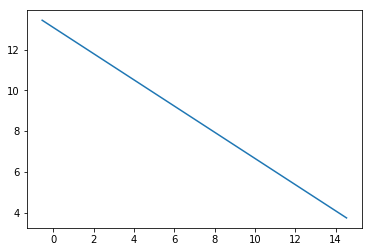

error value is [[0.14476103]]


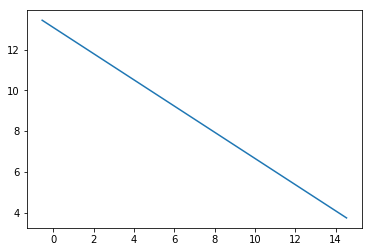

error value is [[0.14472226]]


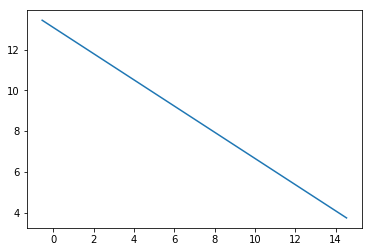

error value is [[0.14468352]]


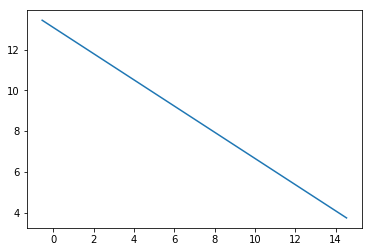

error value is [[0.14464481]]


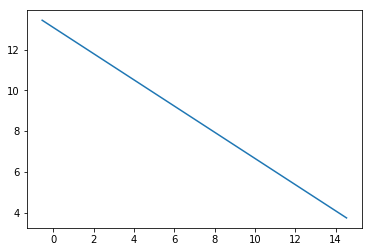

error value is [[0.14460614]]


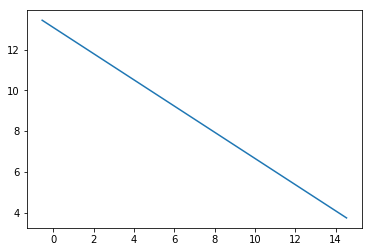

error value is [[0.14456749]]


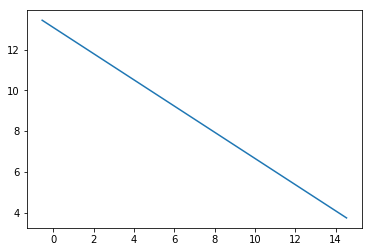

error value is [[0.14452888]]


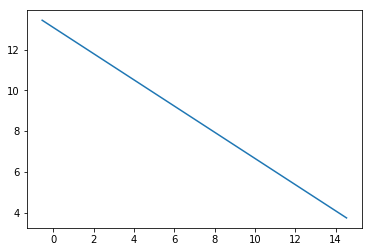

error value is [[0.14449031]]


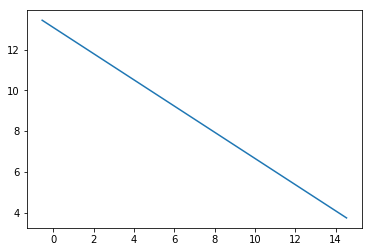

error value is [[0.14445176]]


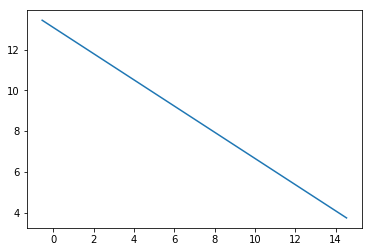

error value is [[0.14441325]]


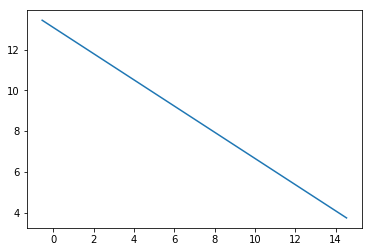

error value is [[0.14437477]]


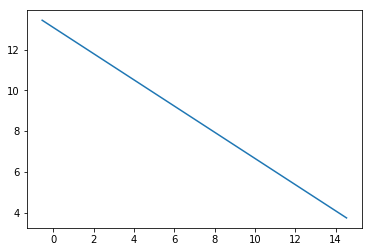

error value is [[0.14433633]]


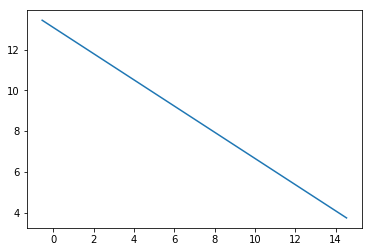

error value is [[0.14429791]]


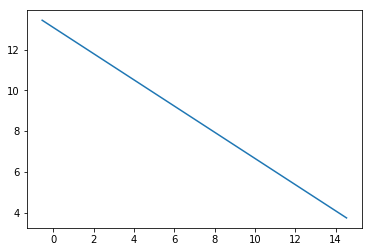

error value is [[0.14425953]]


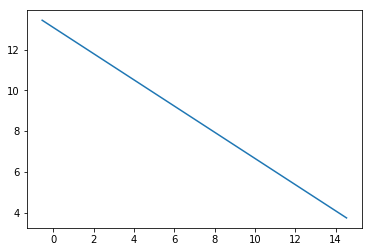

error value is [[0.14422118]]


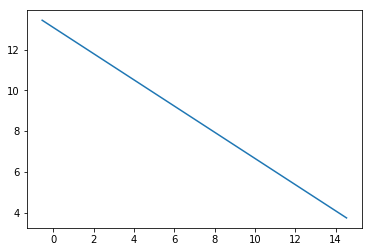

error value is [[0.14418286]]


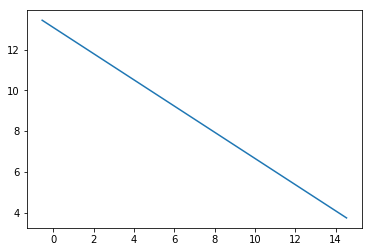

error value is [[0.14414458]]


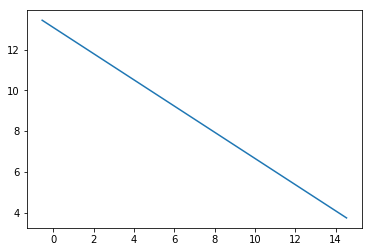

error value is [[0.14410632]]


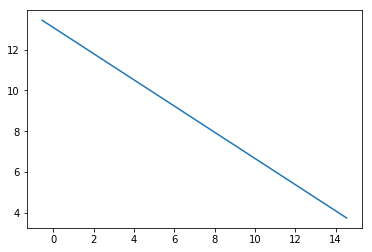

error value is [[0.1440681]]


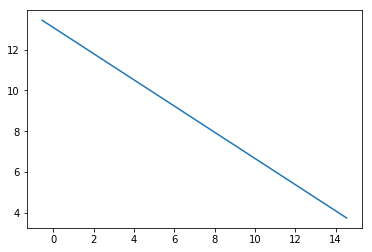

error value is [[0.14402991]]


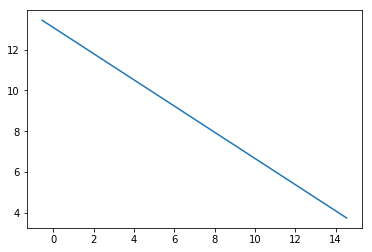

error value is [[0.14399175]]


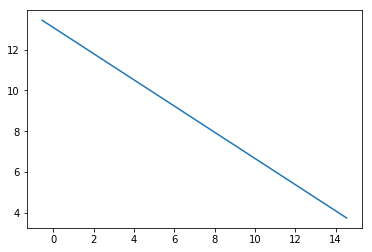

error value is [[0.14395363]]


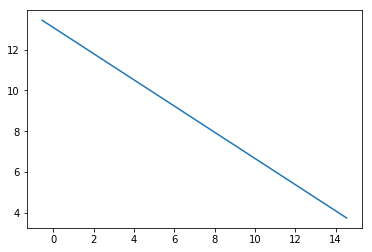

error value is [[0.14391553]]


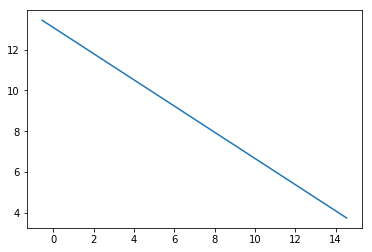

error value is [[0.14387747]]


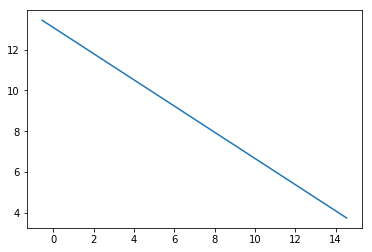

error value is [[0.14383944]]


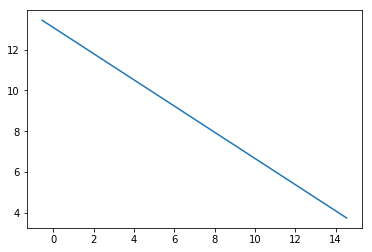

error value is [[0.14380144]]


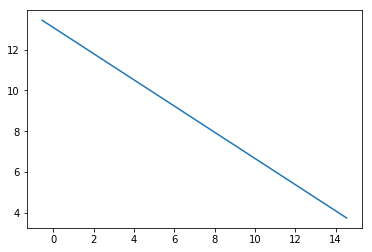

error value is [[0.14376348]]


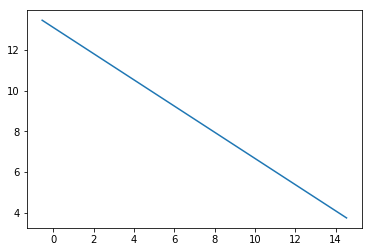

error value is [[0.14372554]]


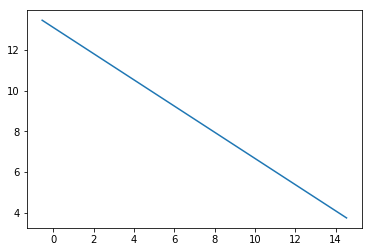

error value is [[0.14368764]]


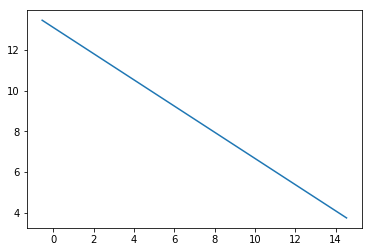

error value is [[0.14364977]]


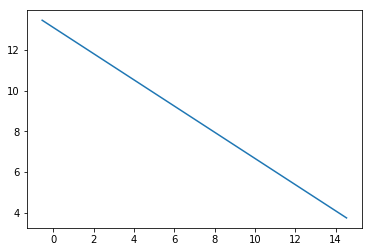

error value is [[0.14361193]]


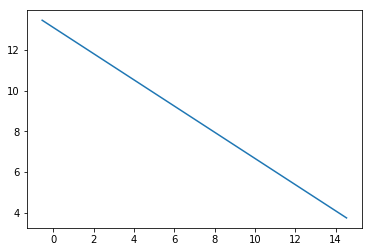

error value is [[0.14357412]]


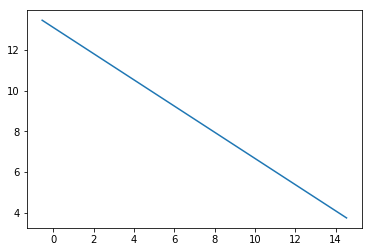

error value is [[0.14353634]]


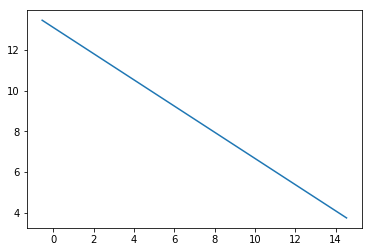

error value is [[0.1434986]]


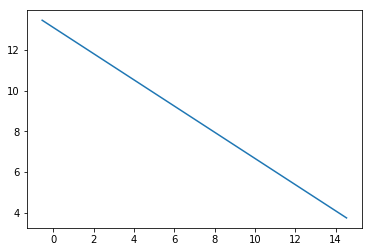

error value is [[0.14346088]]


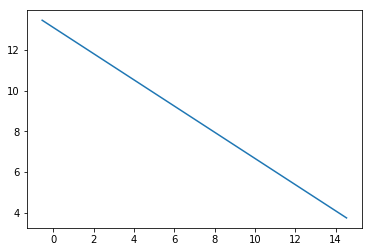

error value is [[0.1434232]]


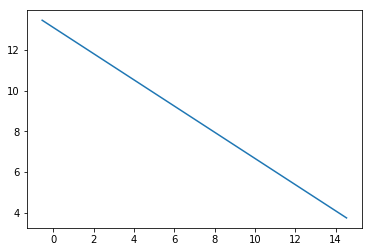

error value is [[0.14338555]]


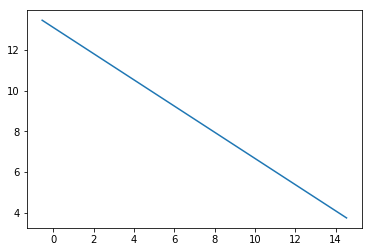

error value is [[0.14334793]]


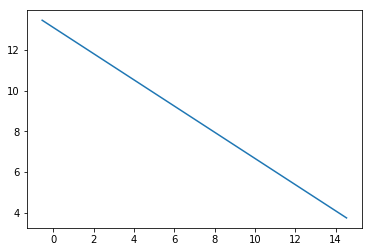

error value is [[0.14331034]]


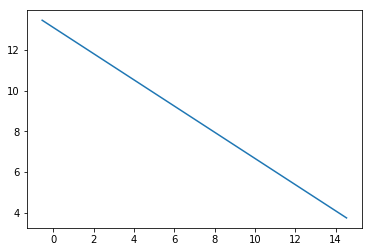

error value is [[0.14327278]]


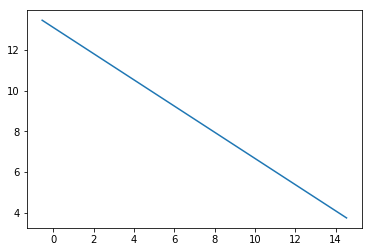

error value is [[0.14323526]]


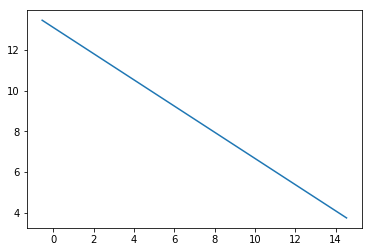

error value is [[0.14319776]]


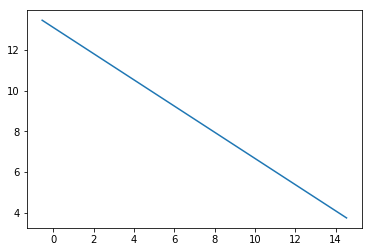

error value is [[0.1431603]]


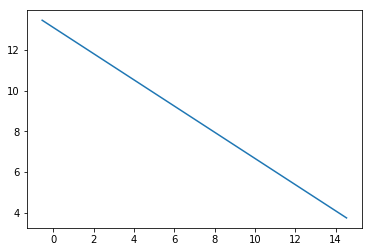

error value is [[0.14312286]]


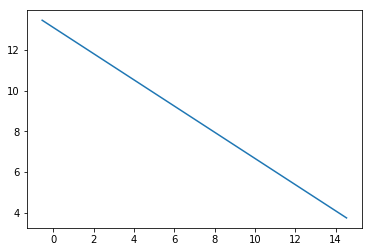

error value is [[0.14308546]]


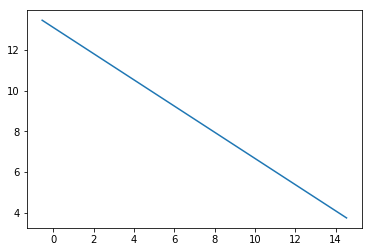

error value is [[0.14304809]]


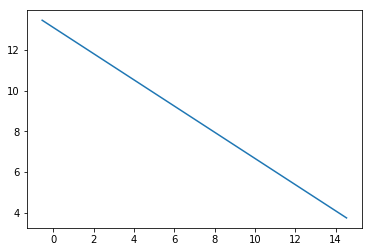

error value is [[0.14301075]]


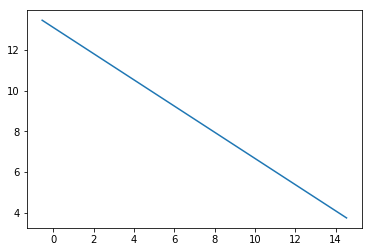

error value is [[0.14297344]]


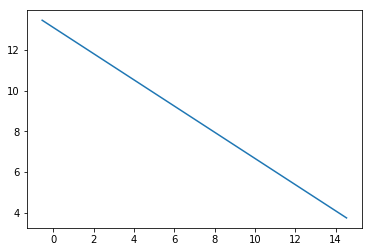

error value is [[0.14293616]]


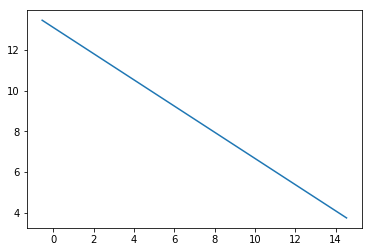

error value is [[0.14289891]]


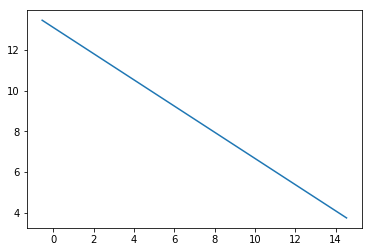

error value is [[0.1428617]]


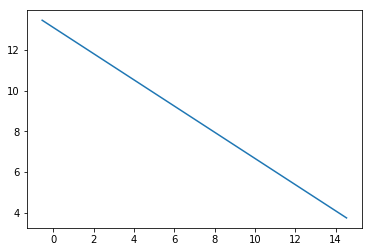

error value is [[0.14282451]]


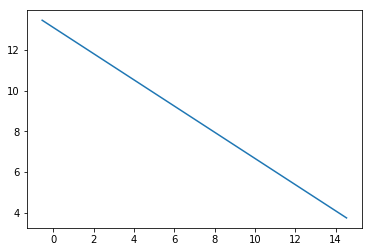

error value is [[0.14278735]]


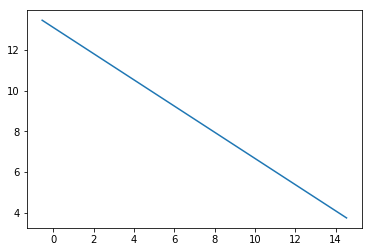

error value is [[0.14275023]]


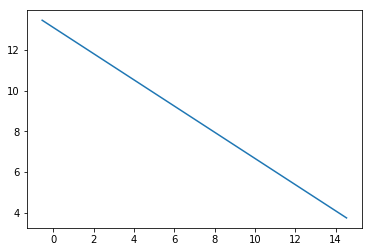

error value is [[0.14271313]]


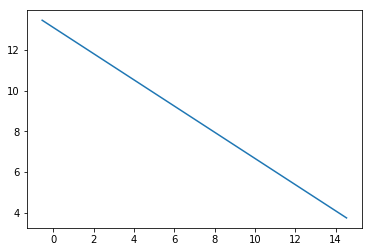

error value is [[0.14267607]]


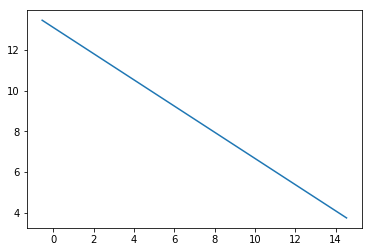

error value is [[0.14263904]]


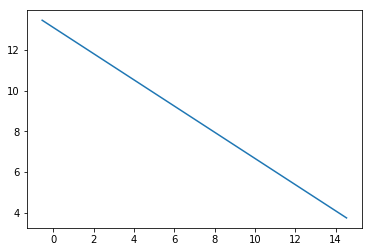

error value is [[0.14260203]]


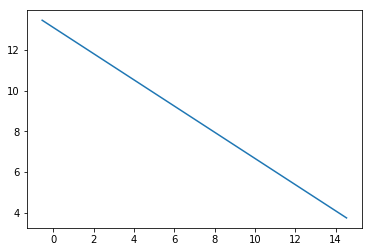

error value is [[0.14256506]]


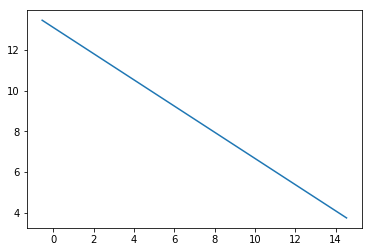

error value is [[0.14252812]]


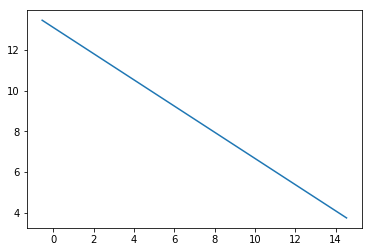

error value is [[0.14249121]]


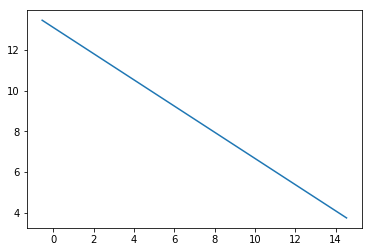

error value is [[0.14245432]]


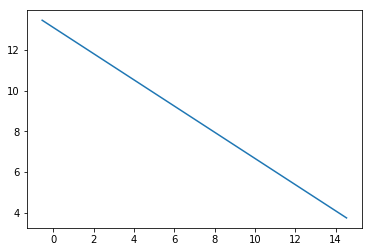

error value is [[0.14241747]]


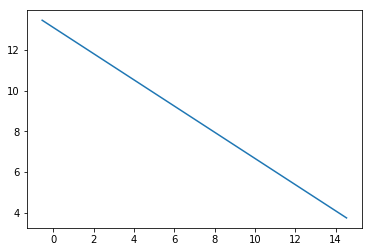

error value is [[0.14238065]]


In [14]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

#since we are draeing 200 lines, we willmake sure that whenever we are drawing a new line ,we will remove the old one that is the first line 
# that is the line at index 0 and only the new one update our plot 
def draw(x1,x2):
    ln=plt.plot(x1,x2,'-')
    plt.pause(0.0001) #in every update there will be a pause of 0.0001 second 
    ln[0].remove()
    
def sigmoid(score):
    return 1/(1+np.exp(-score))
def calculate_error(line_parameters, points , y):
    n=points.shape[0]
    p= sigmoid(points*line_parameters)
    cross_entropy=-(1/n)*(np.log(p).T*y + np.log(1-p).T*(1-y))
    return cross_entropy

#How gradient is calculated??
#The prediction for a single point ,is subtracted from the point's actual label.
#Then the result is multiplied by the point's coordinates and with a smalllearning rate(denoted by 'alpha' here)
#This is done for every single point and taking the summation of each result.
#Then dividing according to the number of points

def gradient_descent(line_parameters, points, y , alpha):
    n=points.shape[0]
    for i in range(2000):
        p=sigmoid(points*line_parameters)
        gradient= points.T*(p-y)*(alpha/n)
        line_parameters = line_parameters - gradient
    
        w1=line_parameters.item(0)
        w2=line_parameters.item(1)
        b=line_parameters.item(2)
    
        x1=np.array([points[:,0].min(), points[:,0].max()])
        x2= -b/w2 + (x1*(-w1/w2))
        draw(x1,x2) #to draw every single line in our loop
        print("error value is",(calculate_error(line_parameters, points, y))) #y is label.here it is 0 or 1
  
n_pts=100
np.random.seed(0)
bias= np.ones(n_pts)
top_region=np.array([np.random.normal(10,2,n_pts), np.random.normal(12,2,n_pts), bias]).T
bottom_region= np.array([np.random.normal(5,2, n_pts), np.random.normal(6,2, n_pts), bias]).T
all_points=np.vstack((top_region, bottom_region))
 
line_parameters = np.matrix([np.zeros(3)]).T
# x1=np.array([bottom_region[:,0].min(), top_region[:,0].max()])
# x2= -b/w2 + (x1*(-w1/w2))
y=np.array([np.zeros(n_pts), np.ones(n_pts)]).reshape(n_pts*2, 1)
 
_, ax= plt.subplots(figsize=(4,4))
ax.scatter(top_region[:,0], top_region[:,1], color='r')
ax.scatter(bottom_region[:,0], bottom_region[:,1], color='b')
gradient_descent(line_parameters, all_points, y , 0.06)
plt.show()

